# Setup

In [ ]:
! python3 -m venv .venv

In [ ]:
!./.venv/bin/python -m pip install ipykernel
!./.venv/bin/python -m ipykernel install --user --name=.venv --display-name "Python (.venv)"

In [ ]:
! pip install -U pybind11
! pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_sm-0.4.0.tar.gz  # Small model for scispacy
! pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_md-0.4.0.tar.gz  # Medium model for scispacy
! pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_lg-0.4.0.tar.gz  # Large model for scispacy

In [ ]:
! pip install git+https://github.com/nmslib/nmslib.git
! pip install scispacy
! pip install mistralai
! pip install python-dotenv
! pip install tqdm
! pip install openai
! pip install retry
! pip install matplotlib

In [1]:
from functions.trials import fetch_n_trials_v2
from functions.scispacy_models import load_nlp_models, extract_umls_code_definitions
from functions.llm_apis import call_openai, call_mistral_api
from functions.patients import prepare_patient_data
from functions.patient_trial_matcher import match_patients_to_trials, match_patients_to_trials_w_api

In [2]:
import numpy as np
import pandas as pd
import os

# Data Collection Overview

### 1. Load SciSpacy Models (Avoid runnning to use cached data)

- **Task**: Load NLP models (loading large SciSpacy models for best performance).
- **Model Sizes**: Choose from 'sm', 'md', or 'lg'.
  - 'lg' (Large): Best performance, used for this example.
  - **System Requirements**:
    - 32GB RAM: Recommended for 'lg' models (Loading two large models utilizes 70% of 32GB RAM = ~22GB).
    - 16GB RAM: Recommended to use 'md' models.
    - Less than 16GB RAM: Recommended to use 'sm' models.
- **Note**: Default model size is 'lg'.
- **Run Time**: Loading large models takes 2-3 minutes.

In [ ]:
## NOTE: Run this only if you need to reload the datasets. As in, the GitHub fork should have cached datasets from 4th October 2024.
model_size = 'lg'
nlp_umls_link, nlp_rxnorm_link = load_nlp_models(model_size=model_size)

c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\TakeHome-ML-SWE\.venv\Lib\site-packages\spacy\util.py:910: UserWarning: [W095] Model 'en_core_sci_lg' (0.4.0) was trained with spaCy v3.0.1 and may not be 100% compatible with the current version (3.7.5). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)
INFO:nmslib:Loading index from C:\Users\cx-admin\.scispacy\datasets\7e8e091ec80370b87b1652f461eae9d926e543a403a69c1f0968f71157322c25.6d801a1e14867953e36258b0e19a23723ae84b0abd2a723bdd3574c3e0c873b4.nmslib_index.bin
INFO:nmslib:Loading regular index.
INFO:nmslib:Finished loading index
INFO:nmslib:Set HNSW query-time parameters:
INFO:nmslib:ef(Search)         =20
INFO:nmslib:algoType           =2
INFO:nmslib:Set HNSW query-time parameters:
INFO:nmslib:ef(Search)         =200
INFO:nmslib:algoType        

### 2. Fetch Clinical Trials (clinicaltrials.gov)

- **Description**: Fetches clinical trials, and the run time depends on the number of trials.
- **Last Run**: 10/4/2024.
- **Run Time**: It took 438 minutes (7.3 hours) to run.
- **Optimization**:
  - Use `reload=False` to load data from cache, available on the repo fork, to avoid rerunning.

In [3]:
# df = pd.read_csv('data/trials/df_trials_processed.csv')

In [4]:
# df.Healthy_Volunteers.value_counts()

In [5]:
# df_trials.Healthy_Volunteers.value_counts()

In [6]:
if 'nlp_umls_link' in locals():
    print("nlp_umls_link is declared")
else:
    print("nlp_umls_link is not declared")
    nlp_umls_link = None
    nlp_rxnorm_link = None

nlp_umls_link is not declared


In [7]:
df_trials = fetch_n_trials_v2(
    nlp_umls_link=nlp_umls_link,
    nlp_rxnorm_link=nlp_rxnorm_link,
    n=None, 
    max_workers=8, 
    verbose=True, 
    reload=False
)

In [8]:
df_trials.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67219 entries, 0 to 67218
Data columns (total 10 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   NCTId                          67219 non-null  object
 1   Title                          67219 non-null  object
 2   Inclusion_Criteria             67219 non-null  object
 3   Exclusion_Criteria             67219 non-null  object
 4   Minimum_Age                    67219 non-null  object
 5   Maximum_Age                    67219 non-null  object
 6   Sex                            67219 non-null  object
 7   Healthy_Volunteers             67219 non-null  object
 8   Inclusion_Criteria_UMLS_Codes  67219 non-null  object
 9   Exclusion_Criteria_UMLS_Codes  67219 non-null  object
dtypes: object(10)
memory usage: 5.1+ MB


### 3. Prepare Patient Data

- **Description**: Prepares patient data; the process takes 2-3 minutes to reload and annotate data.
- **Usage**: Reload only if the synthea data has changed due to scaling.
- **Data**: Approximately 100 patient profiles are present in the cache sample.
- **Last Run**: 10/4/2024.
- **Run Time**: It took 2 minutes to run.
- **Optimization**:
  - Use `reload=False` to load data from cache, available on the repo fork.

In [9]:
patient_profiles_grouped = prepare_patient_data(nlp_umls_link, nlp_rxnorm_link, reload=False)

In [10]:
patient_profiles_grouped.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111 entries, 0 to 110
Data columns (total 11 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   PatientID                        111 non-null    object
 1   Age                              111 non-null    int64 
 2   Gender                           111 non-null    object
 3   Condition_Description            111 non-null    object
 4   Condition_Code                   111 non-null    object
 5   Condition_UMLS_CODES             111 non-null    object
 6   Condition_Code_Description_Map   111 non-null    object
 7   Medication_Description           111 non-null    object
 8   Medication_Code                  111 non-null    object
 9   Medication_UMLS_CODES            111 non-null    object
 10  Medication_Code_Description_Map  111 non-null    object
dtypes: int64(1), object(10)
memory usage: 9.7+ KB


### 4. Process Reloaded Trials

- **Description**: Converts the `codes` column in `df_trials` from a string to a dictionary.
- **Run Time**: Approximately 1 minute to process for 67,000 trials.

In [11]:
################ 4. PROCESS TRIALS ################
# df_trials load the codes column as it curr string, convert to dict
# 1 min to run for 67k trials
df_trials['Inclusion_Criteria_UMLS_Codes'] = df_trials['Inclusion_Criteria_UMLS_Codes'].apply(lambda x: eval(x))
df_trials['Exclusion_Criteria_UMLS_Codes'] = df_trials['Exclusion_Criteria_UMLS_Codes'].apply(lambda x: eval(x))
df_trials['Inclusion_Criteria'] = df_trials['Inclusion_Criteria'].apply(lambda x: eval(x))
df_trials['Exclusion_Criteria'] = df_trials['Exclusion_Criteria'].apply(lambda x: eval(x))

### 5. Extract UMLS Code Definitions (for RAG)

- **Description**: Extract UMLS code definitions by processing patient profiles and clinical trial data.
- **Step 1**: 
  - Extract patient condition and medication UMLS codes from the `patient_profiles_grouped` data.
- **Step 2**: 
  - Collect UMLS codes from the clinical trials' inclusion and exclusion criteria.
- **Step 3**: 
  - Combine all unique UMLS codes from patient conditions, medications, and trial criteria.
  - Remove any `NaN` or `None` values from the set.
- **Step 4**: 
  - Extract definitions for the UMLS codes using `extract_umls_code_definitions`.
  - **Optimization**: 
    - Use `reload=False` to load definitions from cache, available on the repo fork.

In [12]:
################ 5. EXTRACTING CODE DEFINITIONS ################
# Extract UMLS code definitions
patient_condition_codes = set(patient_profiles_grouped['Condition_UMLS_CODES'].explode())
patient_medication_codes = set(patient_profiles_grouped['Medication_UMLS_CODES'].explode())

# Collect UMLS codes from trial data
trial_inclusion_codes = set()
trial_exclusion_codes = set()

for codes_mapping in df_trials['Inclusion_Criteria_UMLS_Codes']:
    for codes in codes_mapping.values():
        trial_inclusion_codes.update(codes)

for codes_mapping in df_trials['Exclusion_Criteria_UMLS_Codes']:
    for codes in codes_mapping.values():
        trial_exclusion_codes.update(codes)

# Combine all unique codes
all_unique_codes = patient_condition_codes.union(
    patient_medication_codes,
    trial_inclusion_codes,
    trial_exclusion_codes
)

# Remove any NaN or None values
all_unique_codes.discard(np.nan)
all_unique_codes.discard(None)

In [13]:
code_definitions_df = extract_umls_code_definitions(
    unique_codes=all_unique_codes,
    nlp_umls_conditions=nlp_umls_link,
    nlp_umls_medications=nlp_rxnorm_link,
    reload=False # ****use reload=False to load from cache which is available on the repo fork****
)

In [14]:
# delete the models to free up memory
del nlp_umls_link
del nlp_rxnorm_link

import gc
gc.collect()

0

# Patient-Trial Match Algorithm

### Approach 1: Using SciSpaCy

This script matches patient data to clinical trial data using UMLS code definitions obtained from the SciSpaCy suite of NER models. The matching process can be customized by adjusting parameters such as chunk size, debug options, and API usage.

Previous Data Exploration Notebooks (.ipynb) should discuss other approaches that were tested using SNOMED CT and RxNorm codes.

  - Ran on **67,000 trials** and **100 patients**.
  - Approximate runtime: **25-30 minutes**.
  - To compare approaches we ran: 100 patients over 200 trials
  
  Note: **all .json files in 'data/output' with chunk number are from APPROACH 1**
  
##### Steps to Run
1. **Load Full or Subset Data**:
   - By default, the full datasets are used for both patients and trials.
   - Optionally, you can work with subsets of the data for testing purposes by uncommenting the relevant lines.
   
2. **Adjust Parameters**
   - **chunk_size**: Controls how many patients are processed in each chunk (default is 1000).
   - **debug**: Set to `True` if you want to save detailed match logs.
   - **verbose**: Set to `True` to print progress updates during execution.
   - **max_api_workers**: Define how many workers are used for API calls (api not enabled).
   - **output_json_format**: Choose between `'match'`, `'no_match'`, or `'both'` to control the format of output data.
   - **patient_start_chunk**: Start processing from a specific chunk of patients (useful for large datasets).

In [15]:
results = match_patients_to_trials(
    # patient_profiles_grouped,
    patient_profiles_grouped.iloc[0:100], # use a subset of the patient data
    # df_trials,
    df_trials.iloc[:200], # use a subset of the trial data
    code_definitions_df,
    chunk_size=1000,
    debug=False,
    verbose=True, 
    output_json_format='match', 
    patient_start_chunk=0 
)

c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\TakeHome-ML-SWE\functions\patient_trial_matcher.py:928: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_trials['Minimum_Age'] = df_trials['Minimum_Age'].apply(convert_age)
c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\TakeHome-ML-SWE\functions\patient_trial_matcher.py:929: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_trials['Maximum_Age'] = df_trials['Maximum_Age'].apply(convert_age)
c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\T



100%|██████████| 2000/2000 [00:00<00:00, 6429.85it/s]


MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MAT

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_0.json.
Patient Chunks:  10%|█         | 1/10 [00:00<00:04,  1.81it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 10
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0




100%|██████████| 2000/2000 [00:00<00:00, 6215.19it/s]


MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH 

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_10.json.
Patient Chunks:  20%|██        | 2/10 [00:01<00:04,  1.74it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 20
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0



100%|██████████| 2000/2000 [00:00<00:00, 7109.06it/s]


MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: Tr

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_20.json.
Patient Chunks:  30%|███       | 3/10 [00:01<00:03,  1.78it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 30
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0




100%|██████████| 2000/2000 [00:00<00:00, 5999.16it/s]


MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_30.json.
Patient Chunks:  40%|████      | 4/10 [00:02<00:03,  1.62it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 40
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0




100%|██████████| 2000/2000 [00:00<00:00, 5333.06it/s]



MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH

Patient Chunks:  50%|█████     | 5/10 [00:03<00:03,  1.58it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 50
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0



100%|██████████| 2000/2000 [00:00<00:00, 6775.43it/s]


MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATC

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_50.json.
Patient Chunks:  60%|██████    | 6/10 [00:03<00:02,  1.51it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 60
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0



100%|██████████| 2000/2000 [00:00<00:00, 6318.17it/s]


MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: Tr

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_60.json.
Patient Chunks:  70%|███████   | 7/10 [00:04<00:01,  1.59it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 70
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0



100%|██████████| 2000/2000 [00:00<00:00, 6840.75it/s]


MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: Tr

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_70.json.
Patient Chunks:  80%|████████  | 8/10 [00:04<00:01,  1.65it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 80
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0




100%|██████████| 2000/2000 [00:00<00:00, 6073.37it/s]


MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: Tr

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_80.json.
Patient Chunks:  90%|█████████ | 9/10 [00:05<00:00,  1.70it/s]INFO:match_patients_to_trials_w_api:Processing patient chunk starting at index 90
INFO:match_patients_to_trials_w_api:Processing trial chunk starting at index 0



100%|██████████| 2000/2000 [00:00<00:00, 6801.01it/s]


MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: True
MATCH RESULT: True
MATCH RESULT: False
MATCH RESULT: False
M

INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches_chunk_90.json.
Patient Chunks: 100%|██████████| 10/10 [00:05<00:00,  1.68it/s]
INFO:match_patients_to_trials_w_api:All patient chunks processed. Returning final results.


In [16]:
# Ran this approach on 67K trials and 100 patients
# took around 25-30 mins
# Results are stored at data/output/patient_trial_matches_chunk_{n}.json
# all files with chunk number are from APPROACH 1
len(results)

1

### Approach 2: Using SciSpaCy + RAG (OpenAI/AzureOpenAI/Mistral)

In this approach, we integrate a Retrieval-Augmented Generation (RAG) workflow to fact-check the patient-trial matching done by our algorithm in combination with SciSpacy NER.

#### Key Highlights:
- **RAG Workflow**: Activated under the following conditions:
  1. **Patient-Trial Match**: Double-check matches to verify accuracy.
  2. **Patient Exclusion with < 2 Reasons**: If a patient is excluded from a trial and there are fewer than two reasons, we double-check this to ensure correctness.

- **Efficiency**: Since RAG is resource-intensive (both in terms of time and cost), we ran this approach on **100 patients** over **200 selected trials**. (20K API calls)

- **Results**: Even with this small subset, the combination of **RAG** (to retrieve UMLS code definitions) and **Prompting** (using our algorithm logs from the `logs` folder) significantly reduced both:
  - **False Positives**: Cases where a match should not occur, but the algorithm indicates a match.
  - **False Negatives**: Cases where a match should occur, but the algorithm does not indicate one.

- **Intermediate Approach**: An intermediate approach (without RAG, i.e., not sharing definitions) was also tested. Using RAG improved consistency by reducing hallucinations.

- **Conclusion**: Using LLMs for fact-checking is highly effective and could be a powerful tool for generating synthetic training sets quickly.

#### Performance:
- **Data**: Processed **67,000 trials** and **100 patients**.
- **Runtime**: Approximately **25-30 minutes**.

#### Steps to Run:

1. **Load Full or Subset Data**:
   - By default, full datasets are used for both patients and trials.
   - For testing, you can work with subsets by uncommenting the relevant lines.

2. **Adjust Parameters**:
   - **`chunk_size`**: Controls how many patients are processed per chunk (default: 1000).
   - **`debug`**: Set to `True` if you want to save detailed match logs.
   - **`verbose`**: Set to `True` to print progress updates during execution.
   - **`max_api_workers`**: Define the number of workers used for API calls. It's recommended to set this to `os.cpu_count() - 1` to balance efficiency and safety.
   - **`output_json_format`**: Choose between `'match'`, `'no_match'`, or `'both'` to define the output format.
   - **`patient_start_chunk`**: Start processing from a specific patient chunk, useful for large datasets.

3. **Set API Keys**:
   - Ensure you have either **OpenAI**, **AzureOpenAI**, or **Mistral** API keys configured in your `.env` file.
   - **Mistral API** currently offers a free tier, but note that its performance for this task isn't as reliable compared to OpenAI.
   - **OpenAI** is recommended for consistent performance.

#### Example `.env` setup:
```bash
OPENAI_API_KEY=your_openai_key_here
AZURE_OPENAI_API_KEY=your_azure_openai_key_here
MISTRAL_API_KEY=your_mistral_key_here
```

In [17]:
results = match_patients_to_trials_w_api(
    patient_profiles_grouped, #.iloc[0:100], # use a subset of the patient data
    df_trials.iloc[0:200], # use a subset of the trial data
    code_definitions_df,
    chunk_size=1000,
    debug=False,
    verbose=True,
    max_api_workers=os.cpu_count() - 1,
    output_json_format='match'
)

c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\TakeHome-ML-SWE\functions\patient_trial_matcher.py:928: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_trials['Minimum_Age'] = df_trials['Minimum_Age'].apply(convert_age)
c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\TakeHome-ML-SWE\functions\patient_trial_matcher.py:929: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_trials['Maximum_Age'] = df_trials['Maximum_Age'].apply(convert_age)
c:\Users\cx-admin\Documents\cx-ag\ag_job_apps\Turmerik\T

	- An error occurred: Unterminated string starting at: line 1 column 2169 (char 2168)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT02907827 with result False
API Calls:   0%|          | 65/22200 [00:24<3:17:35,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT06291727 with result False
API Calls:   0%|          | 66/22200 [00:24<2:48:32,  2.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2169 (char 2168)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT05442827 with result False
API Calls:   0%|          | 86/22200 [01:07<6:16:16,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT06026527 with result False
API Calls:   0%|          | 87/22200 [01:07<4:49:11,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2212)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT06144476 with result False
API Calls:   0%|          | 88/22200 [01:08<5:18:01,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT03317327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and tria

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT03916627 with result False
API Calls:   0%|          | 105/22200 [01:16<2:47:43,  2.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT04504227 with result True
API Calls:   0%|          | 106/22200 [01:16<2:43:36,  2.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 28.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2605)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT03146676 with result True
API Calls:   1%|          | 152/22200 [02:08<6:32:49,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT06074276 with result False
API Calls:   1%|          | 153/22200 [02:08<5:33:33,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2587)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT04280627 with result False
API Calls:   1%|          | 167/22200 [02:15<2:42:58,  2.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and trial NCT05747027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 03f12f9e-fd3e-b845-502a-3a12511d9e48 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT04820127 with result True
API Calls:   1%|          | 222/22200 [03:08<4:23:39,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05780827 with result False
API Calls:   1

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05706376 with result True
API Calls:   1%|          | 233/22200 [03:13<3:09:13,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT06111027 with result True
API Calls:   1%|          | 234/22200 [03:14<2:39:08,  2.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05078476 with result True
API Calls:   1%|          | 257/22200 [03:25<3:39:59,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05826327 with result True
API Calls:   1%|          | 258/22200 [03:26<3:21:09,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2511 (char 2510)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT04349527 with result False
API Calls:   1%|▏         | 289/22200 [04:07<5:33:58,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT03317327 with result True
API Calls:   1%|▏         | 290/22200 [04:07<4:18:29,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2632)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05518227 with result True
API Calls:   1%|▏         | 297/22200 [04:11<2:45:18,  2.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05900427 with result True
API Calls:   1%|▏         | 314/22200 [04:21<3:37:53,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05057676 with result True
API Calls:   1%|▏         | 315/22200 [04:22<3:14:28,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05695027 with result True
API Calls:   1%|▏         | 321/22200 [04:25<4:14:34,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05525676 with result True
API Calls:   1%|▏         | 322/22200 [04:25<3:11:05,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT03712527 with result False
API Calls:   1%|▏         | 330/22200 [04:29<3:21:06,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT06187727 with result True
API Calls:   1

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT04816227 with result True
API Calls:   2%|▏         | 333/22200 [04:32<4:29:40,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT02488876 with result True
API Calls:   2%|▏         | 334/22200 [04:32<3:52:41,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying 

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 21.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT03131427 with result True
API Calls:   2%|▏         | 339/22200 [05:02<43:34:57,  7.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT02288676 with result False
API Calls:   2%|▏         | 343/22200 [05:04<16:58:11,  2.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05272176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and tri

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05505227 with result True
API Calls:   2%|▏         | 351/22200 [05:07<4:18:28,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT03146676 with result True
API Calls:   2%|▏         | 356/22200 [05:09<3:11:35,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05537376 with result True
API Calls:   2%|▏         | 357/22200 [05:11<4:13:39,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT04280627 with result True
API Calls:   2%|▏         | 368/22200 [05:16<3:39:06,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and tria

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05357027 with result True
API Calls:   2%|▏         | 381/22200 [05:24<5:03:29,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 068d2ed4-b12c-e380-fe78-3d99eab488c2 and trial NCT05427227 with result True
API Calls:   2%|▏         | 382/22200 [05:25<4:24:59,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 27.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 27.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 27.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT06507527 with result False
API Calls:   2%|▏         | 414/22200 [06:05<11:19:14,  1.87s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05731427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and tri

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04216927 with result False
API Calls:   2%|▏         | 419/22200 [06:07<4:57:16,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05840276 with result True
API Calls:   2%|▏         | 432/22200 [06:14<4:00:20,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05706376 with result True
API Calls:   2%|▏         | 433/22200 [06:14<3:28:58,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03947827 with result True
API Calls:   2%|▏         | 434/22200 [06:15<3:49:23,  1.58it/s]INFO:httpx:HTTP Reque

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05826327 with result False
API Calls:   2%|▏         | 459/22200 [06:27<3:43:13,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT01341327 with result True
API Calls:   2%|▏         | 460/22200 [06:27<3:13:56,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05000827 with result False
API Calls:   2%|▏         | 483/22200 [07:04<23:53:33,  3.96s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05245227 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05649176 with result True
API Calls:   2%|▏         | 508/22200 [07:16<3:34:42,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03916627 with result True
API Calls:   2%|▏         | 509/22200 [07:17<2:47:40,  2.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying 

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03712527 with result True
API Calls:   2%|▏         | 520/22200 [07:23<3:47:44,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05525676 with result True
API Calls:   2%|▏         | 521/22200 [07:24<3:19:43,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2545 (char 2544)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05780476 with result True
API Calls:   2%|▏         | 526/22200 [07:26<2:41:44,  2.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05266976 with result False
API Calls:   2

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05721027 with result True
API Calls:   2%|▏         | 529/22200 [07:27<2:39:38,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for p

	- An error occurred: Unterminated string starting at: line 1 column 2441 (char 2440)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03131427 with result True
API Calls:   2%|▏         | 536/22200 [07:34<5:45:05,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2477 (char 2476)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03050476 with result True
API Calls:   2%|▏         | 537/22200 [07:34<4:46:50,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2278 (char 2277)
API Calls:   2%|▏         | 538/22200 [07:35<4:08:33,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2278 (char 2277)
	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2328)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04167527 with result True
API Calls:   2%|▏         | 539/22200 [07:35<4:07:26,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05500027 with result True
API Calls:   2%|▏         | 540/22200 [07:36<3:18:34,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying 

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2584 (char 2583)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 19.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 19.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03146676 with result True
API Calls:   2%|▎         | 555/22200 [08:10<3:37:10,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-previ

	- An error occurred: Unterminated string starting at: line 1 column 2567 (char 2566)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT06524427 with result True
API Calls:   3%|▎         | 556/22200 [08:12<5:37:22,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2284)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT06447727 with result True
API Calls:   3%|▎         | 563/22200 [08:16<4:26:33,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04760327 with result True
INFO:httpx:HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04987476 with result True
API Calls:   3%|▎         | 571/22200 [08:21<3:40:20,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05747027 with result False
API Calls:   3

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2298)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05264727 with result True
API Calls:   3%|▎         | 576/22200 [08:24<4:03:22,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2625)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04620876 with result True
API Calls:   3%|▎         | 583/22200 [08:28<4:03:25,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT04557527 with result True
API Calls:   3%

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2209)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT05312827 with result True
API Calls:   3%|▎         | 596/22200 [08:35<2:14:04,  2.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 06a2cf9c-d766-72ef-8869-449dd2b18534 and trial NCT03529227 with result True
API Calls:   3%|▎         | 597/22200 [08:36<2:29:38,  2.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=202

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06597227 with result False
API Calls:   3%|▎         | 614/22200 [09:07<4:55:50,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT04216927 with result False
API Calls:   3%|▎         | 615/22200 [09:07<4:05:51,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05309876 with result False
API Calls:   3%|▎         | 651/22200 [09:26<4:20:28,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06552676 with result True
API Calls:   3%|▎         | 652/22200 [09:26<3:20:49,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05650827 with result True
API Calls:   3%|▎         | 673/22200 [09:36<2:27:32,  2.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 26.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06072976 with result False
API Calls:   

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05442827 with result False
API Calls:   3%|▎         | 687/22200 [10:09<7:26:49,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06144476 with result True
API Calls:   3%|▎         | 688/22200 [10:10<6:02:15,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2216)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06253676 with result False
API Calls:   3%|▎         | 718/22200 [10:25<3:06:15,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT04772027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT04816227 with result True
API Calls:   3%|▎         | 732/22200 [10:32<3:19:08,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT02488876 with result True
API Calls:   3%|▎         | 733/22200 [10:33<4:20:50,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06187727 with result False
API Calls:   3%|▎         | 734/22200 [10:33<3:40:43,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT03622827 with result False
API Calls:   3%|▎         | 737/22200 [10:34<2:21:36,  2.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06218576 with result True
API Calls:   3%|▎         | 738/22200 [10:35<2:25:48,  2.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 26 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 25.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 25.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06034327 with result False
API Calls:   3%|▎         | 744/22200 [10:39<4:44:44,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05782127 with result True
API Calls:   3%|▎         | 755/22200 [11:08<5:29:04,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06074276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05537376 with result False
API Calls:   3%|▎         | 758/22200 [11:09<4:34:12,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05553327 with result False
API Calls:   3%|▎         | 759/22200 [11:10<3:41:35,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT04760327 with result False
API Calls:   3%|▎         | 762/22200 [11:11<3:28:04,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06447727 with result False
API Calls:   3%|▎         | 763/22200 [11:12<2:54:37,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06304727 with result False
API Calls:   3%|▎         | 770/22200 [11:16<2:47:33,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT03969927 with result False
API Calls:   3%|▎         | 771/22200 [11:16<2:36:06,  2.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05763927 with result False
API Calls:   4%|▎         | 780/22200 [11:22<4:09:13,  1.43it/s]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT05555576 with result True
API Calls:   4%|▎         | 781/22200 [11:22<4:07:28,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT06186427 with result False
API Calls:   4%|▎         | 791/22200 [11:27<2:51:56,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08123544-5a97-8592-a7b7-f66e0aba6d5f and trial NCT04838327 with result True
API Calls:   4%|▎         | 792/22200 [11:27<2:32:32,  2.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04886427 with result True
API Calls:   4%|▍         | 837/22200 [12:12<2:48:21,  2.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03460327 with result True
API Calls:   4%|▍         | 838/22200 [12:13<2:21:13,  2.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03150576 with result True
API Calls:   4%|▍         | 847/22200 [12:19<4:08:04,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06281327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06319027 with result True
API Calls:   4%|▍         | 865/22200 [12:27<3:53:15,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05650827 with result True
API Calls:   4%|▍         | 866/22200 [12:28<4:22:37,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04349527 with result False
API Calls:   4%|▍         | 885/22200 [12:37<3:28:18,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05364827 with result True
API Calls:   4%|▍         | 886/22200 [12:37<2:41:15,  2.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05956327 with result True
API Calls:   4%|▍         | 901/22200 [13:08<8:43:13,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2518)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05676476 with result False
API Calls:   4%|▍         | 912/22200 [13:16<6:36:18,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05900427 with result True
API Calls:   4

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2352)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03955627 with result False
API Calls:   4%|▍         | 919/22200 [13:21<4:35:54,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05525676 with result True
API Calls:   4%|▍         | 920/22200 [13:21<3:52:54,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 1 column 2565 (char 2564)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04772027 with result True
API Calls:   4%|▍         | 927/22200 [13:24<2:01:48,  2.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05266976 with result False
API Calls:   4%|▍         | 928/22200 [13:25<2:50:23,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06187727 with result True
API Calls:   4%|▍         | 933/22200 [13:27<3:18:03,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03622827 with result False
API Calls:   4%|▍         | 934/22200 [13:28<3:00:51,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05272176 with result True
API Calls:   4%|▍         | 942/22200 [13:33<3:46:57,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03050476 with result True
API Calls:   4%

	- An error occurred: Unterminated string starting at: line 37 column 5 (char 2343)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05582876 with result False
API Calls:   4%|▍         | 944/22200 [13:34<4:42:15,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT02288676 with result False
API Calls:   4%|▍         | 945/22200 [13:34<3:35:42,  1.64it/s]INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05755776 with result True
API Calls:   4%|▍         | 950/22200 [13:38<4:53:58,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04802876 with result True
API Calls:   4%|▍         | 951/22200 [13:38<4:10:38,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- An error occurred: Unterminated string starting at: line 1 column 2974 (char 2973)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 21.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06304727 with result False
API Calls:   4%|▍         | 958/22200 [14:05<41:11:39,  6.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04760327 with result False
API Calls:   4%|▍         | 964/22200 [14:07<7:48:21,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04280627 with result True
API Calls:   4%|▍         | 966/22200 [14:08<5:24:31,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-ea

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05584527 with result True
API Calls:   4%|▍         | 968/22200 [14:11<6:56:24,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06309927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2547)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05264727 with result True
API Calls:   4%|▍         | 977/22200 [14:17<3:59:04,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05357027 with result False
API Calls:   4%|▍         | 978/22200 [14:18<5:04:35,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call com

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2511)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT06435676 with result False
API Calls:   4%|▍         | 982/22200 [14:20<3:52:46,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT00001727 with result True
API Calls:   4%|▍         | 987/22200 [14:24<4:58:17,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT05775627 with result True
INFO:httpx:HTTP

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2581)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT04709276 with result True
API Calls:   4%|▍         | 995/22200 [14:27<2:42:23,  2.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 08230260-e919-5227-1ee9-cccc39648a34 and trial NCT03921827 with result True
API Calls:   4%|▍         | 996/22200 [14:28<3:15:26,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05862727 with result False
API Calls:   5%|▍         | 1009/22200 [14:34<3:04:20,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06579027 with result False
API Calls:   5%|▍         | 1010/22200 [14:34<2:59:18,  1.97it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04216927 with result True
API Calls:   5%|▍         | 1019/22200 [14:38<2:04:01,  2.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05809427 with result True
API Calls:   5%|▍         | 1032/22200 [15:08<11:48:45,  2.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04030676 with result True
API Calls:   5%|▍         | 1054/22200 [15:21<3:19:44,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT03269227 with result True
API Calls:   5

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2428)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06087627 with result True
API Calls:   5%|▍         | 1058/22200 [15:24<4:01:22,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04560127 with result True
API Calls:   5%|▍         | 1059/22200 [15:24<3:34:16,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06598176 with result True
API Calls:   5%|▍         | 1086/22200 [15:36<2:56:11,  2.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06026527 with result False
API Calls:   5%|▍         | 1087/22200 [15:36<2:27:54,  2.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 25 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 24.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06624527 with result False
API Calls:   5%|▍         | 1097/22200 [15:41<2:49:53,  2.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 24.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05285527 with result False
API Calls:   5%|▍         | 1103/22200 [16:08<17:27:48,  2.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06010927 with result False
API Calls:   5%|▍         | 1104/22200 [16:08<12:45:54,  2.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05649176 with result False
API Calls:   5%|▌         | 1111/22200 [16:13<5:29:13,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05900427 with result True
API Calls:   

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05695027 with result False
API Calls:   5%|▌         | 1121/22200 [16:19<4:13:27,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05525676 with result True
API Calls:   5%|▌         | 1122/22200 [16:19<3:40:51,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2493)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT03990727 with result True
API Calls:   5%|▌         | 1124/22200 [16:21<5:06:35,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05780476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04921527 with result False
API Calls:   5%|▌         | 1133/22200 [16:26<3:55:25,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT03622827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and tr

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2502)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05505227 with result True
API Calls:   5%|▌         | 1152/22200 [16:34<1:59:39,  2.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT06222827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTT

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2296)


INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04643327 with result True
API Calls:   5%|▌         | 1162/22200 [16:40<2:39:10,  2.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 24.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04280627 with result True
API Calls:   5%|▌         | 1170/22200 [17:08<17:40:30,  3.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT03969927 with result True
API Calls:   

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2226)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05264727 with result True
API Calls:   5%|▌         | 1175/22200 [17:13<8:11:15,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05775627 with result True
API Calls:   5

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04620876 with result True
API Calls:   5%|▌         | 1182/22200 [17:18<4:27:50,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05357027 with result False
API Calls:   

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2465)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT05628376 with result True
API Calls:   5%|▌         | 1187/22200 [17:21<3:23:19,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT03344276 with result True
API Calls:   5%|▌         | 1189/22200 [17:22<3:33:28,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 0d74120f-5a80-be1b-a91d-09bde798b179 and trial NCT04709276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT04666727 with result False
API Calls:   5%|▌         | 1204/22200 [17:30<3:11:49,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06100276 with result True
API Calls:   5%|▌         | 1205/22200 [17:30<2:31:50,  2.30it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT04484727 with result True
API Calls:   5%|▌         | 1206/22200 [17:30<2:35:02,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06113276 with result True
API Calls:   5%|▌         | 1207/22200 [17:30<2:04:22,  2.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05286827 with result True
API Calls:   6%|▌         | 1228/22200 [17:40<3:26:14,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03947827 with result True
API Calls:   6%|▌         | 1229/22200 [17:41<3:05:16,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT04998227 with result True
API Calls:   6%|▌         | 1243/22200 [18:11<11:00:39,  1.89s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05072327 with result True
API Calls:   

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05038527 with result True
API Calls:   6%|▌         | 1287/22200 [18:34<4:35:49,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06144476 with result True
API Calls:   6%|▌         | 1288/22200 [18:35<4:24:24,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2470)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06190327 with result False
API Calls:   6%|▌         | 1290/22200 [18:37<4:58:05,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03317327 with result True
API Calls:   6%|▌         | 1291/22200 [18:37<3:40:56,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2391)


INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03072927 with result True
API Calls:   6%|▌         | 1293/22200 [18:38<3:55:26,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05322876 with result True
API Calls:   6%|▌         | 1294/22200 [18:39<3:52:23,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT04349527 with result True
API Calls:   6%|▌         | 1295/22200 [18:40<3:37:04,  1.61it/s]INFO:httpx:HTTP Re

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2497)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03868527 with result True
API Calls:   6%|▌         | 1308/22200 [19:09<15:28:17,  2.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2495)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05284227 with result True
API Calls:   6%|▌         | 1313/22200 [19:13<6:21:20,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05057676 with result True
API Calls:   6

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2374)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05763576 with result True
API Calls:   6%|▌         | 1327/22200 [19:22<4:49:29,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06550427 with result True
API Calls:   6%|▌         | 1328/22200 [19:22<4:08:22,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06187727 with result True
API Calls:   6%|▌         | 1333/22200 [19:25<3:02:14,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 33 column 1 (char 2601)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT02488876 with result True
API Calls:   6%|▌         | 1334/22200 [19:26<4:28:12,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06218576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and tria

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2374)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05272176 with result True
API Calls:   6%|▌         | 1342/22200 [19:31<4:26:47,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2621 (char 2620)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06034327 with result False
API Calls:   6%|▌         | 1350/22200 [19:36<4:13:36,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06074276 with result False
API Calls:   6%|▌         | 1352/22200 [19:37<4:08:49,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03146676 with result True
API Calls:   

	- An error occurred: Unterminated string starting at: line 40 column 5 (char 2391)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05537376 with result True
API Calls:   6%|▌         | 1356/22200 [19:40<3:06:09,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 2294)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05189327 with result True
API Calls:   6%|▌         | 1360/22200 [19:44<4:44:54,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 22.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06447727 with result True
API Calls:   

	- An error occurred: Unterminated string starting at: line 1 column 2589 (char 2588)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 21.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 21.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2172)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06524427 with result True
API Calls:   6%|▌         | 1363/22200 [19:47<5:38:43,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 19.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT04280627 with result True
API Calls:   6%|▌         | 1364/22200 [20:07<39:38:02,  6.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06176027 with result True
API Calls:   6%|▌         | 1365/22200 [20:07<28:08:04,  4.86s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2131)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05747027 with result False
API Calls:   6%|▌         | 1371/22200 [20:12<7:15:30,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT03851627 with result False
API Calls:   6%|▌         | 1375/22200 [20:14<4:40:21,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05264727 with result True
API Calls:   6%|▌         | 1377/22200 [20:18<8:22:14,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05763927 with result True
API Calls:   6

	- An error occurred: Unterminated string starting at: line 16 column 9 (char 2025)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT05318976 with result False
API Calls:   6%|▌         | 1385/22200 [20:22<3:03:11,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06420427 with result True
API Calls:   6%|▋         | 1395/22200 [20:27<2:46:04,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1057debe-fd90-c813-fad8-0353ca3d8e6d and trial NCT06186427 with result True
API Calls:   6

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05690776 with result True
API Calls:   6%|▋         | 1403/22200 [20:30<2:48:29,  2.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT04666727 with result True
API Calls:   6

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06100276 with result True
API Calls:   6%|▋         | 1406/22200 [20:31<2:18:08,  2.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05731427 with result True
API Calls:   6%|▋         | 1418/22200 [20:38<3:55:48,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05398627 with result False
API Calls:   6%|▋         | 1419/22200 [20:38<3:04:22,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06111027 with result True
API Calls:   6%|▋         | 1435/22200 [21:07<24:39:25,  4.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT04886427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05840276 with result True
API Calls:   6%|▋         | 1437/22200 [21:08<14:16:34,  2.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT04448327 with result False
API Calls:   6%|▋         | 1439/22200 [21:10<12:00:21,  2.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11780

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06356376 with result True
API Calls:   7%|▋         | 1448/22200 [21:15<4:21:51,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06552676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT01521676 with result True
API Calls:   7%|▋         | 1453/22200 [21:17<2:37:40,  2.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05826327 with result False
API Calls:   7%|▋         | 1456/22200 [21:20<4:32:47,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05078476 with result True
API Calls:   

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT04560127 with result True
API Calls:   7%|▋         | 1458/22200 [21:21<3:55:34,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06312176 with result True
API Calls:   7%|▋         | 1463/22200 [21:25<3:47:39,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT02907827 with result True
API Calls:   7%|▋         | 1466/22200 [21:27<3:35:57,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06319027 with result True
API Calls:   7%|▋         | 1467/22200 [21:27<3:33:11,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03511976 with result True
API Calls:   7%|▋         | 1474/22200 [21:32<3:40:58,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06072976 with result False
API Calls:   7%|▋         | 1475/22200 [21:33<3:45:55,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05038527 with result True
API Calls:   7%|▋         | 1481/22200 [21:35<2:22:44,  2.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05000827 with result True
API Calls:   7%|▋         | 1482/22200 [21:35<2:22:00,  2.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03317327 with result True
API Calls:   7%|▋         | 1490/22200 [21:40<3:47:52,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06190327 with result True
INFO:httpx:HTT

	- An error occurred: Unterminated string starting at: line 20 column 5 (char 2261)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05601427 with result True
API Calls:   7%|▋         | 1497/22200 [21:43<2:38:18,  2.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 16.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05649176 with result True
API Calls:   7%|▋         | 1503/22200 [22:09<29:31:49,  5.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2419)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03868527 with result True
API Calls:   7%|▋         | 1506/22200 [22:11<12:35:51,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2220)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03916627 with result True
API Calls:   7%|▋         | 1511/22200 [22:15<5:21:33,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06253676 with result False
API Calls:   7%|▋         | 1519/22200 [22:19<3:12:28,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03990727 with result True
API Calls:   7%|▋         | 1522/22200 [22:24<7:10:59,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05763576 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2220)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05695027 with result True
API Calls:   7%|▋         | 1524/22200 [22:26<6:42:17,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05780476 with result True
API Calls:   7%|▋         | 1525/22200 [22:26<5:12:57,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 1 column 2558 (char 2557)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06550427 with result True
API Calls:   7%|▋         | 1529/22200 [22:27<3:31:46,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06218576 with result True
API Calls:   7%|▋         | 1539/22200 [22:33<2:02:19,  2.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT02288676 with result False
API Calls:   7%|▋         | 1544/22200 [22:36<3:16:49,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05500027 with result True
API Calls:   7%|▋         | 1545/22200 [22:36<2:31:09,  2.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT06304727 with result False
API Calls:   7%|▋         | 1557/22200 [22:43<4:39:11,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05553327 with result True
API Calls:   7%|▋         | 1558/22200 [22:43<3:41:07,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05318976 with result True
API Calls:   7%|▋         | 1575/22200 [23:13<10:10:49,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05427227 with result True
API Calls:   7%|▋         | 1584/22200 [23:19<6:10:48,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT00001727 with result True
API Calls:   7%|▋         | 1585/22200 [23:20<4:50:52,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your curr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT03921827 with result True
API Calls:   7%|▋         | 1595/22200 [23:25<3:35:30,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 117809db-9ede-b25e-f2e3-7f830939c0da and trial NCT05312827 with result True
API Calls:   7%|▋         | 1596/22200 [23:25<2:56:39,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06100276 with result True
API Calls:   7%|▋         | 1608/22200 [23:30<2:18:07,  2.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04808427 with result False
API Calls:   7%|▋         | 1611/22200 [23:33<3:46:23,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04216927 with result False
API Calls:   7%|▋         | 1616/22200 [23:35<3:09:07,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04998227 with result True
API Calls:   7%|▋         | 1647/22200 [24:12<11:15:10,  1.97s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06281327 with result False
API Calls:   7%|▋         | 1648/22200 [24:12<8:49:36,  1.55s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06356376 with result True
API Calls:   7%|▋         | 1649/22200 [24:13<7:47:29,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT02907827 with result True
API Calls:   7%|▋         | 1663/22200 [24:21<4:07:11,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05078476 with result True
API Calls:   7

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06337227 with result True
API Calls:   8%|▊         | 1666/22200 [24:24<4:18:16,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05650827 with result True
API Calls:   8%|▊         | 1667/22200 [24:24<3:16:45,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06040827 with result True
API Calls:   8%|▊         | 1685/22200 [24:34<4:28:26,  1.27it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04349527 with result False
API Calls:   8%|▊         | 1686/22200 [24:34<3:46:31,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06144476 with result True
API Calls:   8%|▊         | 1687/22200 [24:34<2:52:37,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 21 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05900427 with result True
API Calls:   8%|▊         | 1712/22200 [24:48<3:35:13,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2545 (char 2544)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04772027 with result True
API Calls:   8%|▊         | 1719/22200 [25:13<12:47:17,  2.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT03955627 with result False
API Calls:   8%|▊         | 1720/22200 [25:13<9:43:35,  1.71s/it] 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05525676 with result True
API Calls:   8%|▊         | 1721/22200 [25:14<7:17:47,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06253676 with result False
API Calls:   8%|▊         | 1722/22200 [25:14<5:51:12,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT02488876 with result True
API Calls:   8%|▊         | 1732/22200 [25:22<4:02:44,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06049927 with result False
API Calls:   8%|▊         | 1733/22200 [25:22<3:48:36,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completio

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2518)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06218576 with result True
API Calls:   8%|▊         | 1736/22200 [25:24<3:07:15,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05233527 with result False
API Calls:   8%|▊         | 1745/22200 [25:30<4:15:04,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06034327 with result False
API Calls:   8%|▊         | 1746/22200 [25:30<3:17:42,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2445)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05968976 with result True
API Calls:   8%|▊         | 1748/22200 [25:31<3:24:50,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05505227 with result True
API Calls:   8

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06074276 with result False
API Calls:   8%|▊         | 1753/22200 [25:34<2:59:28,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06524427 with result True
API Calls:   8%|▊         | 1757/22200 [25:37<4:36:20,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04643327 with result True
API Calls:   8

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2197)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05884827 with result False
API Calls:   8%|▊         | 1765/22200 [25:41<2:02:19,  2.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06176027 with result True
API Calls:   

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04987476 with result True
API Calls:   8%|▊         | 1771/22200 [25:44<4:07:37,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT03969927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 22 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05318976 with result False
API Calls:   8%|▊         | 1775/22200 [25:47<3:31:40,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 21.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT04652076 with result False
API Calls:   8%|▊         | 1780/22200 [26:09<24:27:38,  4.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT05555576 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06309927 with result False
API Calls:   8%|▊         | 1786/22200 [26:14<7:01:53,  1.24s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT03344276 with result True
API Calls:   8%|▊         | 1789/22200 [26:16<5:20:28,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT06186427 with result True
API Calls:   8%|▊         | 1791/22200 [26:16<3:37:14,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT03529227 with result True
API Calls:   8%|▊         | 1798/22200 [26:21<2:56:14,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 11f5a32b-599b-eecb-003b-86f255a57ea1 and trial NCT03921827 with result True
API Calls:   8%|▊         | 1799/22200 [26:21<2:40:56,  2.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05862727 with result False
API Calls:   8%|▊         | 1809/22200 [26:27<3:17:18,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT02665676 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05626127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04820127 with result True
API Calls:   8%|▊         | 1823/22200 [26:33<2:22:13,  2.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_pat

	- An error occurred: Unterminated string starting at: line 1 column 2113 (char 2112)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04998227 with result True
API Calls:   8%|▊         | 1844/22200 [26:45<3:39:54,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06265727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and tria

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2402)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05248776 with result True
API Calls:   8%|▊         | 1851/22200 [26:52<8:40:43,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 15.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 13.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03269227 with result True
API Calls:   8%|▊         | 1854/22200 [27:10<18:10:46,  3.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06337227 with result True
API Calls:   8%|▊         | 1862/22200 [27:17<5:39:43,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06312176 with result True
API Calls:   8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05536427 with result True
API Calls:   8%|▊         | 1872/22200 [27:22<3:46:08,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06330727 with result False
API Calls:   8%|▊         | 1873/22200 [27:23<3:34:14,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06026527 with result False
API Calls:   8%|▊         | 1884/22200 [27:29<4:41:10,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06144476 with result True
API Calls:   8%|▊         | 1885/22200 [27:31<6:30:36,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 26 column 1 (char 2572)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04349527 with result True
API Calls:   8%|▊         | 1886/22200 [27:32<6:17:27,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03317327 with result True
API Calls:   8%|▊         | 1887/22200 [27:32<4:52:30,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2400)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05518227 with result True
API Calls:   9%|▊         | 1897/22200 [27:39<3:03:15,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 27 column 36 (char 2505)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06624527 with result False
API Calls:   9%|▊         | 1898/22200 [27:39<2:46:15,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2646)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03916627 with result True
API Calls:   9%|▊         | 1904/22200 [27:44<3:53:51,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04504227 with result True
API Calls:   9%|▊         | 1905/22200 [27:44<3:01:55,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05900427 with result True
API Calls:   9%|▊         | 1911/22200 [27:48<3:27:14,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05284227 with result True
API Calls:   9%|▊         | 1912/22200 [27:48<3:11:54,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2425)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 18.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05422027 with result True
API Calls:   9%|▊         | 1916/22200 [27:52<5:14:48,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 16.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03955627 with result True
API Calls:   9%|▊         | 1919/22200 [28:10<18:09:56,  3.22s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06253676 with result False
API Calls:   9%|▊         | 1920/22200 [28:10<14:04:28,  2.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2382)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05695027 with result True
API Calls:   9%|▊         | 1922/22200 [28:13<10:22:39,  1.84s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04921527 with result False
API Calls:   9%|▊         | 1930/22200 [28:19<5:22:27,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06187727 with result True
API Calls:   

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04816227 with result True
API Calls:   9%|▊         | 1932/22200 [28:20<5:36:06,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT02488876 with result True
API Calls:   9%|▊         | 1933/22200 [28:21<4:27:50,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04167527 with result True
API Calls:   9%|▊         | 1936/22200 [28:24<5:19:48,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03131427 with result True
API Calls:   9%|▊         | 1937/22200 [28:24<4:57:04,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05755776 with result True
API Calls:   9%|▉         | 1950/22200 [28:31<3:08:20,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06182527 with result True
API Calls:   9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03146676 with result True
API Calls:   9%|▉         | 1953/22200 [28:33<3:40:17,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06309927 with result False
API Calls:   9%|▉         | 1972/22200 [28:43<2:55:07,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06627127 with result True
API Calls:   9%|▉         | 1973/22200 [28:44<3:07:20,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04280627 with result True
API Calls:   9%|▉         | 1975/22200 [28:46<4:04:52,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05775627 with result False
API Calls:   9%|▉         | 1976/22200 [28:47<3:57:04,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- An error occurred: Unterminated string starting at: line 1 column 2054 (char 2053)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05555576 with result True
API Calls:   9%|▉         | 1980/22200 [28:49<3:13:45,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 20.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04709276 with result False
API Calls:   9%|▉         | 1986/22200 [29:10<17:21:07,  3.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05427227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT06339827 with result True
API Calls:   9%|▉         | 1991/22200 [29:16<9:50:38,  1.75s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2164 (char 2163)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT05757076 with result True
API Calls:   9%|▉         | 1993/22200 [29:18<7:24:49,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT03921827 with result True
API Calls:   9%|▉         | 1994/22200 [29:18<6:02:04,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 12c3795b-c935-f4d5-8a2c-2c2b381b90f7 and trial NCT04695327 with result True
API Calls:   9%|▉         | 2009/22200 [29:26<3:02:09,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06579027 with result True
API Calls:   9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04808427 with result False
API Calls:   9%|▉         | 2011/22200 [29:28<4:39:35,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06597227 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06525376 with result False
API Calls:   9%|▉         | 2019/22200 [29:31<3:01:58,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04820127 with result False
API Calls:   9%|▉         | 2020/22200 [29:32<2:58:10,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05377827 with result False
API Calls:   9%|▉         | 2048/22200 [

	- An error occurred: Unterminated string starting at: line 1 column 2280 (char 2279)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds


	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2332)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 16.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 15.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05826327 with result False
API Calls:   9%|▉         | 2058/22200 [30:10<22:38:37,  4.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT01341327 with result False
API Calls:   9%|▉         | 2059/22200 [30:11<17:14:13,  3.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04853576 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06312176 with result False
API Calls:   9%|▉         | 2063/22200 [30:15<8:06:57,  1.45s/it] 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03150576 with result False
API Calls:   9%|▉         | 2064/22200 [30:16<8:16:31,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06146127 with result False
API Calls:   9%|▉         | 2073/22200 [30:21<4:24:01,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05752227 with result False
API Calls:   9%|▉         | 2074/22200 [30:22<4:12:59,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06190327 with result False
API Calls:   9%|▉         | 2092/22200 [30:33<3:50:55,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03072927 with result False
API Calls:   9%|▉         | 2093/22200 [30:33<3:12:41,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05676476 with result False
API Calls:   9%|▉         | 2108/22200 [30:42<3:18:26,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03868527 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2534 (char 2533)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03955627 with result False
API Calls:  10%|▉         | 2121/22200 [30:49<2:44:08,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05695027 with result False
API Calls:  10%|▉         | 2122/22200 [30:49<2:18:44,  2.41it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05525676 with result False
API Calls:  10%|▉         | 2123/22200 [30:49<2:22:43,  2.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 17 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03990727 with result True
API Calls:  10%|▉         | 2127/22200 [30:52<2:52:46,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04921527 with result False
API Calls:  10%|▉         | 2130/22200 [31:11<17:45:50,  3.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06187727 with result False
API Calls:  10%|▉         | 2133/22200 [31:16<11:27:23,  2.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06218576 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2074)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04167527 with result False
API Calls:  10%|▉         | 2136/22200 [31:18<7:05:55,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03131427 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04652076 with result False
API Calls:  10%|▉         | 2154/22200 [31:30<3:34:26,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04643327 with result True
API Calls:  10%|▉         | 2155/22200 [31:32<6:45:47,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06627127 with result False
API Calls:  10%|▉         | 2174/22200 [31:41<2:30:11,  2.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05264727 with result False
API Calls:  10%|▉         | 2175/22200 [31:43<3:52:04,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05357027 with result False
API Calls:  10%|▉         | 2180/22200 [31:47<3:24:14,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05775627 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2795 (char 2794)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06435676 with result False
API Calls:  10%|▉         | 2182/22200 [31:48<3:47:48,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT04620876 with result False
API Calls:  10%|▉         | 2183/22200 [31:49<3:28:12,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 17 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 16.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 16.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT05763927 with result False
API Calls:  10%|▉         | 2188/22200 [31:55<7:49:29,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 13.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03344276 with result False
API Calls:  10%|▉         | 2190/22200 [32:10<21:34:59,  3.88s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 2136)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Expecting value: line 29 column 1 (char 2477)
API Calls:  10%|▉         | 2191/22200 [32:14<21:04:32,  3.79s/it]

	- An error occurred: Expecting value: line 29 column 1 (char 2477)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT06186427 with result False
API Calls:  10%|▉         | 2192/22200 [32:14<15:06:23,  2.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04484727 with result True
API Calls:  10%|▉         | 2201/22200 [32:20<4:57:26,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1415b79b-ec25-3728-027e-d9a8f4048441 and trial NCT03529227 with result False
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03869476 with result True
API Calls:  10%|▉         | 2204/22200 [32:21<2:56:16,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04666727 with result True
API Calls:  10%|▉         | 2205/22200 [32:22<3:38:32,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04253327 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05666076 with result True
API Calls:  10%|▉         | 2217/22200 [32:28<4:07:56,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06525376 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05780827 with result False
API Calls:  10%|█         | 2220/22200 [32:31<5:19:49,  1.04it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04820127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05890027 with result True
API Calls:  10%|█         | 2227/22200 [32:35<4:06:32,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05004727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and tria

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06504927 with result True
API Calls:  10%|█         | 2242/22200 [32:44<4:18:44,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04448327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT01521676 with result True
API Calls:  10%|█         | 2252/22200 [32:50<3:50:12,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03269227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and tria

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2337)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05078476 with result True
API Calls:  10%|█         | 2256/22200 [32:52<3:36:41,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 17.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06312176 with result True
API Calls:  10%|█         | 2263/22200 [33:16<14:40:05,  2.65s/it]ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2431)
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06061627 with result 

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT02907827 with result True
API Calls:  10%|█         | 2266/22200 [33:17<7:37:53,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06291727 with result True
API Calls:  10

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2376)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 178157

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2394)


API Calls:  10%|█         | 2283/22200 [33:26<2:00:57,  2.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05245227 with result True
API Calls:  10%|█         | 2284/22200 [33:28<4:23:36,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2348 (char 2347)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04349527 with result False
API Calls:  10%|█         | 2285/22200 [33:30<5:25:13,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06026527 with result False
API Calls:  10%|█         | 2286/22200 [33:30<4:17:12,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03317327 with result True
API Calls:  10%|█         | 2287/22200 [33:31<4:09:04,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completio

	- An error occurred: Unterminated string starting at: line 1 column 2348 (char 2347)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06624527 with result False
API Calls:  10%|█         | 2299/22200 [33:39<3:28:19,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05956327 with result False
API Calls:  10%|█         | 2300/22200 [33:39<2:40:04,  2.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06508827 with result True
API Calls:  10%|█         | 2310/22200 [33:49<6:43:26,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05900427 with result True
API Calls:  10%|█         | 2311/22200 [33:50<6:31:07,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 1 column 2389 (char 2388)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06199076 with result False
API Calls:  10%|█         | 2313/22200 [33:51<5:22:47,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05422027 with result True
API Calls:  10%|█         | 2314/22200 [33:52<5:12:24,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2610 (char 2609)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05057676 with result True
API Calls:  10%|█         | 2316/22200 [33:53<3:42:59,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04772027 with result True
API Calls:  10%|█         | 2317/22200 [33:53<3:41:37,  1.50it/s]INFO:openai._base_client:Retryin

	- An error occurred: Expecting value: line 30 column 33 (char 2299)


	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 10.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  10%|█         | 2321/22200 [34:15<27:12:18,  4.93s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05780476 with result True
API Calls:  10%|█         | 2322/22200 [34:16<20:44:11,  3.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05525676 with result True
API Calls:  1

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06550427 with result True
API Calls:  10%|█         | 2328/22200 [34:20<6:55:47,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2491 (char 2490)
API Calls:  10%|█         | 2330/22200 [34:22<6:06:49,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03622827 with result False


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04816227 with result True
API Calls:  11%|█         | 2332/22200 [34:23<4:19:30,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 5 (char 2143)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04995627 with result True
API Calls:  11%|█         | 2333/22200 [34:25<5:35:22,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT02488876 with result True
API Calls:  11

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03131427 with result True
API Calls:  11%|█         | 2337/22200 [34:28<4:29:23,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04167527 with result True
API Calls:  11%|█         | 2338/22200 [34:28<3:26:22,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2459)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05782127 with result True
API Calls:  11%|█         | 2358/22200 [34:40<2:16:17,  2.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04652076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTT

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2459)


INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03969927 with result True
API Calls:  11%|█         | 2369/22200 [34:47<3:45:25,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05775627 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05318976 with result True
API Calls:  11%|█         | 2373/22200 [34:52<6:59:48,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04987476 with result True
API Calls:  11%|█         | 2374/22200 [34:54<6:59:41,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06627127 with result True
API Calls:  11%|█         | 2379/22200 [34:57<4:50:37,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05264727 with result False
API Calls:  11%|█         | 2380/22200 [35:11<23:42:50,  4.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT06435676 with result False
API Calls:  11%|█         | 2385/22200 [35:16<11:07:44,  2.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT00001727 with result True
API Calls:  11%|█         | 2386/22200 [35:18<9:40:40,  1.76s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05757076 with result False
API Calls:  11%|█         | 2387/22200 [35:18<7:24:58,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT05628376 with result True
API Calls:  11%|█         | 2390/22200 [35:19<4:18:32,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT04620876 with result True
API Calls:  11%|█         | 2393/22200 [35:22<4:44:36,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 17815732-cb25-a735-8c1c-5a417466856b and trial NCT03921827 with result True
API Calls:  11%|█         | 2394/22200 [35:22<3:56:57,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05286827 with result True
API Calls:  11%|█         | 2428/22200 [35:42<3:35:45,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03015727 with result True
API Calls:  11

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05072327 with result True
API Calls:  11%|█         | 2447/22200 [35:52<3:50:38,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04998227 with result True
API Calls:  11%|█         | 2448/22200 [35:52<3:07:20,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 15 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05309876 with result True
API Calls:  11%|█         | 2450/22200 [35:56<5:46:50,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06356376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06087627 with result True
API Calls:  11%|█         | 2463/22200 [36:19<6:23:55,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06061627 with result True
API Calls:  11%|█         | 2464/22200 [36:19<5:29:57,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06093776 with result True
API Calls:  11%|█         | 2467/22200 [36:21<5:01:09,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06291727 with result True
API Calls:  11

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06337227 with result True
API Calls:  11%|█         | 2470/22200 [36:24<4:43:01,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06190327 with result False
API Calls:  11%|█         | 2491/22200 [36:36<3:36:15,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05601427 with result True
API Calls:  11%|█         | 2497/22200 [36:40<3:37:03,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06585527 with result True
API Calls:  11%|█▏        | 2499/22200 [36:41<3:36:16,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06624527 with result False
API Calls:  11%|█▏        | 2500/22200 [36:41<2:56:04,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2378)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04554927 with result False
API Calls:  11%|█▏        | 2507/22200 [36:47<3:42:01,  1.48it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04519476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05525676 with result True
API Calls:  11%|█▏        | 2519/22200 [36:56<5:49:28,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03955627 with result False
API Calls:  1

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2463)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05721027 with result True
API Calls:  11%|█▏        | 2528/22200 [37:18<20:36:30,  3.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03622827 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2531)


INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04921527 with result False
API Calls:  11%|█▏        | 2531/22200 [37:19<9:24:18,  1.72s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05780476 with result True
API Calls:  11%|█▏        | 2532/22200 [37:20<7:44:43,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04816227 with result True
API Calls:  11%|█▏        | 2535/22200 [37:22<5:31:02,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT02488876 with result True
API Calls:  11

	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2523)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03050476 with result True
API Calls:  11%|█▏        | 2542/22200 [37:28<5:35:19,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT02288676 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT04652076 with result False
API Calls:  12%|█▏        | 2553/22200 [37:34<4:22:57,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06074276 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06447727 with result True
API Calls:  12%|█▏        | 2567/22200 [37:41<2:52:12,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03969927 with result True
API Calls:  12%|█▏        | 2569/22200 [37:43<3:21:16,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05747027 with result False
API Calls:  12%|█▏        | 2570/22200 [37:44<3:26:21,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05357027 with result False
API Calls:  12%|█▏        | 2578/22200 [37:49<4:06:59,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2491)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06435676 with result True
API Calls:  12%|█▏        | 2579/22200 [37:50<5:43:41,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06441227 with result True
API Calls:  12%|█▏        | 2580/22200 [37:51<4:49:13,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT00001727 with result True
API Calls:  12%|█▏        | 2585/22200 [37:55<4:08:50,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05757076 with result True
API Calls:  12%|█▏        | 2588/22200 [37:57<4:40:38,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 13 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03344276 with result True
API Calls:  12%|█▏        | 2590/22200 [37:59<4:39:34,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT06339827 with result True
API Calls:  12%|█▏        | 2592/22200 [38:12<18:24:21,  3.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT03921827 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04995276 with result False
API Calls:  12%|█▏        | 2596/22200 [38:17<9:10:26,  1.68s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 190e0fc9-d354-8cee-a7c8-e602a424f2e2 and trial NCT05312827 with result True
API Calls:  12%|█▏        | 2598/22200 [38:19<6:53:18,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03668327 with result True
API Calls:  12%|█▏        | 2599/22200 [38:19<5:09:32,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Expecting value: line 21 column 8 (char 2658)


INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06113276 with result True
API Calls:  12%|█▏        | 2604/22200 [38:22<3:13:28,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05690776 with result True
API Calls:  12%|█▏        | 2605/22200 [38:22<2:40:15,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completion

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05731427 with result True
API Calls:  12%|█▏        | 2615/22200 [38:29<5:42:51,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT02665676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06525376 with result False
API Calls:  12%|█▏        | 2617/22200 [38:29<4:01:04,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06597227 with result True
API Calls:  12%|█▏        | 2618/22200 [38:30<3:55:11,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03015727 with result True
API Calls:  12%|█▏        | 2630/22200 [38:37<2:56:36,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06265727 with result True
API Calls:  12%|█▏        | 2640/22200 [38:43<3:24:15,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04998227 with result True
API Calls:  12%|█▏        | 2641/22200 [38:45<4:45:39,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06087627 with result True
API Calls:  12%|█▏        | 2657/22200 [38:53<3:16:17,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05078476 with result True
API Calls:  12%|█▏        | 2658/22200 [38:53<2:32:34,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- An error occurred: Unterminated string starting at: line 1 column 2381 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04560127 with result True
API Calls:  12%|█▏        | 2660/22200 [38:54<3:05:10,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT01341327 with result True
API Calls:  12%|█▏        | 2661/22200 [38:56<5:46:41,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 14 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com

	- An error occurred: Unterminated string starting at: line 1 column 2219 (char 2218)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06061627 with result True
API Calls:  12%|█▏        | 2663/22200 [39:03<11:06:22,  2.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06146127 with result True
API Calls:  12%|█▏        | 2669/22200 [39:17<9:43:26,  1.79s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05650827 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06291727 with result True
API Calls:  12%|█▏        | 2674/22200 [39:21<5:08:21,  1.06it/s]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03739827 with result True
API Calls:  12

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06144476 with result True
API Calls:  12%|█▏        | 2685/22200 [39:29<6:25:28,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06026527 with result False
API Calls:  12%|█▏        | 2686/22200 [39:30<5:44:06,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05518227 with result True
API Calls:  12%|█▏        | 2699/22200 [39:37<3:11:28,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05956327 with result True
API Calls:  12%|█▏        | 2700/22200 [39:38<3:52:43,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05601427 with result True
API Calls:  12%|█▏        | 2701/22200 [39:39<4:27:23,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03868527 with result True
API Calls:  12%|█▏        | 2712/22200 [39:45<2:35:13,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06508827 with result True
API Calls:  12%|█▏        | 2713/22200 [39:46<2:02:01,  2.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06049927 with result False
API Calls:  12%|█▏        | 2720/22200 [39:50<3:24:10,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05525676 with result True
API Calls:  12%|█▏        | 2721/22200 [39:50<2:47:12,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- An error occurred: Expecting value: line 24 column 4 (char 2494)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05266976 with result False
API Calls:  12%|█▏        | 2727/22200 [39:54<2:45:50,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 14 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 14 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT02488876 with result True
API Calls:  12%|█▏        | 2732/22200 [39:58<4:15:30,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06187727 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06218576 with result True
API Calls:  12%|█▏        | 2735/22200 [40:12<20:22:09,  3.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04921527 with result False
API Calls:  12%|█▏        | 2736/22200 [40:12<15:14:48,  2.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04995627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03131427 with result True
API Calls:  12%|█▏        | 2739/22200 [40:16<11:20:10,  2.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04816227 with result True
API Calls:  12%|█▏        | 2743/22200 [40:20<6:24:57,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05755776 with result True
API Calls:  12

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT02288676 with result False
API Calls:  12%|█▏        | 2745/22200 [40:20<4:27:51,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05968976 with result True
API Calls:  1

	- An error occurred: Unterminated string starting at: line 1 column 2351 (char 2350)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT03146676 with result True
API Calls:  12%|█▏        | 2757/22200 [40:30<3:49:24,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06304727 with result False
API Calls:  12%|█▏        | 2758/22200 [40:31<4:04:59,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04643327 with result True
API Calls:  1

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2473)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05775627 with result False
API Calls:  12%|█▏        | 2771/22200 [40:39<4:29:13,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT04987476 with result True
API Calls:  12%|█▏        | 2772/22200 [40:39<3:34:38,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06627127 with result True
API Calls:  12%|█▏        | 2773/22200 [40:41<5:11:47,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2250)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06435676 with result True
API Calls:  13%|█▎        | 2779/22200 [40:47<6:32:15,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05357027 with result False
API Calls:  13%|█▎        | 2780/22200 [40:48<6:15:04,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT06339827 with result True
API Calls:  13%|█▎        | 2795/22200 [40:55<2:42:49,  1.99it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 193dcff9-773e-88c7-d29d-73fc0a9590c2 and trial NCT05312827 with result True
API Calls:  13%|█▎        | 2798/22200 [40:58<4:59:37,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT03668327 with result True
API Calls:  13%|█▎        | 2802/22200 [41:13<22:43:27,  4.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  13%|█▎        | 2803/22200 [41:13<16:20:48,  3.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT03869476 with result False
API Calls:  13%|█▎        | 2804/22200 [41:13<12:15:10,  2.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06507527 with result False
API Calls:  13%|█▎        | 2811/22200 [41:20<5:46:04,  1.07s/it]INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04808427 with result False
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05731427 with result False
API Calls:  13%|█▎        | 2813/22200 [41:22<5:18:37,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04253327 with result False
API Calls:  13%|█▎        | 2814/22200 [41:24<6:18:50,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04216927 with result True
API Calls:  13%|█▎        | 2815/22200 [41:24<4:53:46,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06191627 with result False
API Calls:  13%|█▎        | 2826/22200 [41:32<5:28:45,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06001827 with result False
API Calls:  13%|█▎        | 2827/22200 [41:32<4:52:35,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06480227 with result False
API Calls:  13%|█▎        | 2844/22200 [41:41<3:26:38,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05072327 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT01341327 with result False
API Calls:  13%|█▎        | 2861/22200 [41:51<2:41:35,  1.99it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06337227 with result False
API Calls:  13%|█▎        | 2862/22200 [41:51<2:04:33,  2.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2510)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05364827 with result False
API Calls:  13%|█▎        | 2877/22200 [42:13<21:23:03,  3.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05000827 with result False
API Calls:  13%|█▎        | 2879/22200 [42:14<12:54:31,  2.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06598176 with result False
API Calls:  13%|█▎        | 2882/22200 [42:18<7:58:59,  1.49s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT03511976 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 18 column 5 (char 2339)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06026527 with result False
API Calls:  13%|█▎        | 2884/22200 [42:21<8:15:21,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT03317327 with result False
API Calls:  13%|█▎        | 2885/22200 [42:22<8:00:47,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05245227 with result False
API Calls:  13%|█▎        | 2892/22200 [42:26<2:59:55,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06221176 with result False
API Calls:  13%|█▎        | 2893/22200 [42:27<2:39:07,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06585527 with result False
API Calls:  13%|█▎        | 2898/22200 [42:31<4:30:08,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05285527 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05956327 with result False
API Calls:  13%|█▎        | 2900/22200 [42:33<5:34:55,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2467)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06624527 with result True
API Calls:  13%|█▎        | 2902/22200 [42:35<4:59:38,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05649176 with result False
API Calls:  13%|█▎        | 2903/22200 [42:36<4:17:11,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05676476 with result False
API Calls:  13%|█▎        | 2914/22200 [42:42<2:47:59,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06199076 with result False
API Calls:  13%|█▎        | 2915/22200 [42:43<2:56:55,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05057676 with result False
API Calls:  13%|█▎        | 2916/22200 [42:43<2:25:08,  2.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05695027 with result False
API Calls:  13%|█▎        | 2922/22200 [42:46<2:53:53,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2369)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05763576 with result False
API Calls:  13%|█▎        | 2923/22200 [42:47<3:51:29,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05780476 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06187727 with result False
API Calls:  13%|█▎        | 2931/22200 [42:53<4:18:26,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04167527 with result False
API Calls:  13%|█▎        | 2932/22200 [42:54<3:41:56,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2586 (char 2585)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04995627 with result False
API Calls:  13%|█▎        | 2935/22200 [42:56<3:41:15,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 14 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 14.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05500027 with result False
API Calls:  13%|█▎        | 2941/22200 [42:59<2:52:15,  1.86it/s]

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2152)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 13.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 13.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT02288676 with result False
API Calls:  13%|█▎        | 2947/22200 [43:18<9:19:43,  1.74s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pr

	- An error occurred: Unterminated string starting at: line 1 column 2565 (char 2564)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06182527 with result False
API Calls:  13%|█▎        | 2949/22200 [43:19<5:57:23,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05505227 with result False
API Calls:  13%|█▎        | 2951/22200 [43:21<6:32:34,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06074276 with result False
API Calls:  13%|█▎        | 2953/22200 [43:24<7:00:02,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2586 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05537376 with result False
API Calls:  13%|█▎        | 2955/22200 [43:26<5:34:46,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06524427 with result False
API Calls:  13%|█▎        | 2956/22200 [43:26<4:36:31,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1926)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06304727 with result False
API Calls:  13%|█▎        | 2957/22200 [43:27<4:53:16,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05553327 with result False
API Calls:  13%|█▎        | 2958/22200 [43:28<5:04:25,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04643327 with result True
API Calls:  1

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2279)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05884827 with result False
API Calls:  13%|█▎        | 2963/22200 [43:33<5:56:05,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04280627 with result False
API Calls:  13%|█▎        | 2964/22200 [43:34<6:22:57,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1923)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05747027 with result False
API Calls:  13%|█▎        | 2965/22200 [43:36<8:24:27,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06176027 with result False
API Calls:  13%|█▎        | 2966/22200 [43:37<7:12:39,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2127)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06309927 with result False
API Calls:  13%|█▎        | 2973/22200 [43:41<2:58:13,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06627127 with result False
API Calls:  13%|█▎        | 2974/22200 [43:41<2:27:27,  2.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1924)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05318976 with result False
API Calls:  13%|█▎        | 2977/22200 [43:44<4:20:03,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05427227 with result False
API Calls:  13%|█▎        | 2981/22200 [43:46<3:53:04,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2349 (char 2348)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06435676 with result False
API Calls:  13%|█▎        | 2984/22200 [43:50<4:14:40,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04620876 with result False
API Calls:  13%|█▎        | 2985/22200 [43:50<3:36:10,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2343 (char 2342)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT05312827 with result False
API Calls:  13%|█▎        | 2993/22200 [43:55<4:39:58,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT04695327 with result False
API Calls:  13%|█▎        | 2994/22200 [43:55<3:30:40,  1.52it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT06339827 with result False
API Calls:  13%|█▎        | 2995/22200 [43:56<3:35:58,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1a654b50-5c1d-ec96-1d56-8d7c12140983 and trial NCT03921827 with result False
API Calls:  13%|█▎        | 2996/22200 [43:57<3:17:25,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05690776 with result True
API Calls:  14%|█▎        | 3006/22200 [44:14<13:38:38,  2.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06100276 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2334 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06597227 with result True
API Calls:  14%|█▎        | 3014/22200 [44:23<5:48:53,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2343 (char 2342)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03015727 with result True
API Calls:  14%|█▎        | 3026/22200 [44:31<3:50:09,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06001827 with result True
API Calls:  14%|█▎        | 3029/22200 [44:34<5:34:51,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06111027 with result True
API Calls:  14%|█▎        | 3030/22200 [44:34<4:49:11,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03947827 with result True
API Calls:  14%|█▎        | 3031/22200 [44:35<4:19:40,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06552676 with result True
API Calls:  14%|█▎        | 3049/22200 [44:45<3:15:58,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06281327 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05248776 with result True
API Calls:  14%|█▍        | 3056/22200 [44:49<3:34:57,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06146127 with result True
API Calls:  14%|█▍        | 3069/22200 [44:56<3:17:27,  1.61it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06319027 with result True
API Calls:  14%|█▍        | 3070/22200 [44:57<3:29:33,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06093776 with result True
API Calls:  14

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 14 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06061627 with result True
API Calls:  14%|█▍        | 3075/22200 [45:00<3:54:19,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05752227 with result True
API Calls:  14%|█▍        | 3076/22200 [45:01<3:07:53,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05364827 with result True
API Calls:  14%|█▍        | 3079/22200 [45:14<14:49:12,  2.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05000827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06144476 with result True
API Calls:  14%|█▍        | 3089/22200 [45:23<6:25:52,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03317327 with result True
API Calls:  14

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06190327 with result False
API Calls:  14%|█▍        | 3091/22200 [45:24<4:49:41,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04257227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05601427 with result True
API Calls:  14%|█▍        | 3096/22200 [45:28<5:14:42,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 27 column 3 (char 2507)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05518227 with result True
API Calls:  14%|█▍        | 3101/22200 [45:32<4:38:37,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  14%|█▍        | 3104/22200 [45:36<6:44:22,  1.27s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04504227 with result True
API Calls:  14%|█▍        | 3105/22200 [45:37<5:24:46,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04554927 with result False
API Calls:  14%|█▍        | 3106/22200 [45:37<4:14:17,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2288)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06550427 with result True
API Calls:  14%|█▍        | 3127/22200 [45:50<3:20:46,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04816227 with result True
API Calls:  14%|█▍        | 3131/22200 [45:53<3:41:47,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04167527 with result True
API Calls:  14%|█▍        | 3136/22200 [45:57<4:09:27,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2555)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06049927 with result False
API Calls:  14%|█▍        | 3139/22200 [46:00<5:12:18,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05272176 with result True
API Calls:  14%|█▍        | 3143/22200 [46:14<22:17:03,  4.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05233527 with result False
API Calls:  14%|█▍        | 3145/22200 [46:19<18:40:51,  3.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05582876 with result False
API Calls:  14%|█▍        | 3146/22200 [46:19<13:39:24,  2.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2487)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03146676 with result True
API Calls:  14%|█▍        | 3154/22200 [46:25<6:53:02,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06524427 with result True
API Calls:  14

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2443)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06447727 with result True
API Calls:  14%|█▍        | 3166/22200 [46:32<2:46:37,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04280627 with result True
API Calls:  14%|█▍        | 3169/22200 [46:38<7:45:22,  1.47s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03969927 with result True
API Calls:  14%|█▍        | 3170/22200 [46:38<5:46:45,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05747027 with result False
API Calls:  14%|█▍        | 3171/22200 [46:39<4:54:06,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06627127 with result True
API Calls:  14%|█▍        | 3177/22200 [46:43<3:29:01,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05264727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and tria

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2583)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06435676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT03344276 with result True
API Calls:  14%|█▍        | 3189/22200 [46:50<2:57:16,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT04838327 with result True
API Calls:  14

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT06339827 with result True
API Calls:  14%|█▍        | 3193/22200 [46:52<2:51:15,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1db29fb5-b3e3-d7bd-2b1e-1de97ab1976d and trial NCT05312827 with result True
API Calls:  14%|█▍        | 3194/22200 [46:53<2:49:40,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06100276 with result True
API Calls:  14%|█▍        | 3207/22200 [46:59<2:56:55,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 12 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05862727 with result False
API Calls:  14%|█▍        | 3211/22200 [47:02<3:41:18,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT04253327 with result False
API Calls:  14%|█▍        | 3217/22200 [47:15<6:11:00,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06191627 with result True
API Calls:  15%|█▍        | 3226/22200 [47:25<6:13:45,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05814627 with result True
API Calls:  15%|█▍        | 3227/22200 [47:26<5:08:08,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST ht

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05286827 with result True
API Calls:  15%|█▍        | 3228/22200 [47:27<5:16:32,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT04998227 with result True
API Calls:  15%|█▍        | 3242/22200 [47:39<5:43:14,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06504927 with result True
API Calls:  15

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2337)
	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Expecting value: line 22 column 1 (char 2371)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT03150576 with result True
API Calls:  15%|█▍        | 3270/22200 [47:56<3:24:23,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06146127 with result True
INFO:httpx:HTT

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 10.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06598176 with result False
API Calls:  15%|█▍        | 3286/22200 [48:15<7:46:49,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT04257227 with result True
API Calls:  15%|█▍        | 3290/22200 [48:21<7:52:34,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06144476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05322876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05601427 with result True
API Calls:  15%|█▍        | 3296/22200 [48:24<3:24:59,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06624527 with result False
API Calls:  15%|█▍        | 3300/22200 [48:28<4:40:50,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05956327 with result False
API Calls:  15%|█▍        | 3301/22200 [48:28<3:37:10,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT04519476 with result True
API Calls:  15%|█▍        | 3308/22200 [48:34<4:09:49,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06508827 with result True
API Calls:  15

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2594)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05284227 with result True
API Calls:  15%|█▍        | 3311/22200 [48:39<8:18:43,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05422027 with result True
API Calls:  15%|█▍        | 3312/22200 [48:39<6:09:14,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 30 column 33 (char 2299)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05518227 with result True
API Calls:  15%|█▍        | 3313/22200 [48:40<5:06:57,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05900427 with result True
API Calls:  15%|█▍        | 3314/22200 [48:40<4:04:13,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT03990727 with result True
API Calls:  15%|█▍        | 3324/22200 [48:47<3:10:01,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05780476 with result True
API Calls:  15%|█▍        | 3325/22200 [48:47<2:38:58,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05721027 with result True
API Calls:  15%|█▍        | 3326/22200 [48:49<3:36:38,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06550427 with result True
API Calls:  15%|█▍        | 3327/22200 [48:50<4:35:09,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT04921527 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT02488876 with result True
API Calls:  15%|█▌        | 3332/22200 [48:54<5:14:18,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06187727 with result True
API Calls:  15

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT03131427 with result True
API Calls:  15%|█▌        | 3336/22200 [48:58<5:08:17,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT02288676 with result False
API Calls:  15%|█▌        | 3346/22200 [49:14<17:52:54,  3.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05968976 with result True
API Calls:  15%|█▌        | 3350/22200 [49:15<6:59:10,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06182527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06034327 with result False
API Calls:  15%|█▌        | 3355/22200 [49:20<4:53:03,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05553327 with result False
API Calls:  15%|█▌        | 3361/22200 [49:27<5:09:16,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05884827 with result False
API Calls:  15%|█▌        | 3362/22200 [49:29<6:03:58,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06074276 with result True
API Calls:  15%|█▌        | 3363/22200 [49:30<6:03:07,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05584527 with result False
API Calls:  15%|█▌        | 3372/22200 [49:34<1:55:21,  2.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT03969927 with result True
API Calls:  15%|█▌        | 3373/22200 [49:34<1:48:17,  2.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05264727 with result False
API Calls:  15%|█▌        | 3376/22200 [49:39<5:39:02,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05555576 with result True
API Calls:  15%|█▌        | 3377/22200 [49:40<5:44:22,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06627127 with result True
API Calls:  15%|█▌        | 3382/22200 [49:45<4:27:09,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05427227 with result True
API Calls:  15%|█▌        | 3383/22200 [49:46<4:23:35,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT06420427 with result True
API Calls:  15%|█▌        | 3393/22200 [49:51<4:26:20,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT05312827 with result True
API Calls:  15%|█▌        | 3394/22200 [49:52<5:09:49,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 1e27f678-220f-8359-d925-5531615fee8f and trial NCT03529227 with result True
API Calls:  15%|█▌        | 3395/22200 [49:52<4:06:07,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03869476 with result True
API Calls:  15%|█▌        | 3403/22200 [49:57<3:59:44,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05690776 with result True
API Calls:  15%|█▌        | 3404/22200 [49:58<3:36:24,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 12 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05666076 with result True
API Calls:  15%|█▌        | 3417/22200 [50:03<2:24:34,  2.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05398627 with result False
API Calls:  15%|█▌        | 3418/22200 [50:15<18:07:45,  3.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06525376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04216927 with result False
API Calls:  15%|█▌        | 3421/22200 [50:16<9:15:35,  1.78s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05626127 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05004727 with result True
API Calls:  15%|█▌        | 3426/22200 [50:21<5:54:37,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05814627 with result True
API Calls:  15%|█▌        | 3432/22200 [50:27<5:31:06,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04886427 with result True
API Calls:  15%|█▌        | 3435/22200 [50:30<5:10:04,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04998227 with result True
API Calls:  16%|█▌        | 3448/22200 [50:39<5:23:33,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05377827 with result True
API Calls:  16

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05072327 with result True
API Calls:  16%|█▌        | 3451/22200 [50:43<5:33:59,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03269227 with result True
API Calls:  16

	- An error occurred: Unterminated string starting at: line 1 column 2246 (char 2245)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 13 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06144476 with result True
API Calls:  16%|█▌        | 3486/22200 [51:03<3:39:40,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03317327 with result True
API Calls:  16%|█▌        | 3491/22200 [51:16<14:28:30,  2.79s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06221176 with result False
API Calls:  16%|█▌        | 3492/22200 [51:17<12:07:07,  2.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06624527 with result False
API Calls:  16%|█▌        | 3497/22200 [51:21<5:15:19,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05518227 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 27 column 1 (char 2550)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05649176 with result True
API Calls:  16%|█▌        | 3503/22200 [51:27<6:50:27,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04504227 with result True
API Calls:  16%|█▌        | 3504/22200 [51:28<5:48:03,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03712527 with result False
API Calls:  16%|█▌        | 3511/22200 [51:34<4:54:57,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05900427 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05695027 with result True
API Calls:  16%|█▌        | 3523/22200 [51:43<4:03:13,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03990727 with result True
API Calls:  16%|█▌        | 3524/22200 [51:43<3:34:03,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04816227 with result True
API Calls:  16%|█▌        | 3531/22200 [51:48<4:05:32,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05525676 with result True
API Calls:  16

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03131427 with result True
API Calls:  16%|█▌        | 3542/22200 [51:52<1:34:38,  3.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05887076 with result True
API Calls:  16%|█▌        | 3543/22200 [51:53<1:38:44,  3.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completion

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06074276 with result False
API Calls:  16%|█▌        | 3550/22200 [51:57<3:19:27,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05505227 with result True
API Calls:  16%|█▌        | 3551/22200 [51:57<2:37:55,  1.97it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05782127 with result True
API Calls:  16%|█▌        | 3553/22200 [51:58<2:48:06,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05884827 with result False
API Calls:  16%|█▌        | 3565/22200 [52:16<7:44:58,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04280627 with result True
API Calls:  16%|█▌        | 3566/22200 [52:17<6:54:42,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT06309927 with result False
API Calls:  16%|█▌        | 3572/22200 [52:22<3:27:30,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 200310

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05318976 with result True
API Calls:  16%|█▌        | 3575/22200 [52:25<4:49:43,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT03851627 with result True
API Calls:  16%|█▌        | 3576/22200 [52:26<5:30:17,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT04557527 with result True
API Calls:  16%|█▌        | 3580/22200 [52:33<9:18:23,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05763927 with result True
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05264727 with result True
API Calls:  16%|█▌        | 3582/22200 [52:33<5:48:38,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05427227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20031069-a1df-c1cf-1188-b2de5855eef6 and trial NCT05757076 with result True
API Calls:  16%|█▌        | 3594/22200 [52:40<2:26:10,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT03668327 with result True
API Calls:  16%|█▌        | 3599/22200 [52:44<3:18:30,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT04253327 with result False
API Calls:  16%|█▋        | 3610/22200 [52:50<2:47:50,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06507527 with result False
API Calls:  16%|█▋        | 3611/22200 [52:51<3:28:27,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pre

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06525376 with result False
API Calls:  16%|█▋        | 3619/22200 [52:56<3:31:19,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05731427 with result True
API Calls:  16%|█▋        | 3620/22200 [52:56<2:58:28,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT02665676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05809427 with result True
API Calls:  16%|█▋        | 3639/22200 [53:17<6:57:24,  1.35s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT04448327 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05309876 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  16%|█▋        | 3650/22200 [53:26<4:18:03,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05072327 with result True
API Calls:  16%|█▋        | 3651/22200 [53:26<3:31:44,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT01341327 with result True
API Calls:  16%|█▋        | 3658/22200 [53:35<7:20:44,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT04853576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and tria

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06291727 with result True
API Calls:  17%|█▋        | 3667/22200 [53:40<3:26:33,  1.50it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06087627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT03511976 with result True
API Calls:  17%|█▋        | 3677/22200 [53:44<2:24:08,  2.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06026527 with result False
API Calls:  17%|█▋        | 3687/22200 [53:50<3:25:32,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06144476 with result True
API Calls:  17%|█▋        | 3688/22200 [53:51<3:59:48,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT03317327 with result True
API Calls:  17%|█▋        | 3689/22200 [53:53<5:11:08,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06200376 with result True
API Calls:  17%|█▋        | 3697/22200 [53:57<2:09:18,  2.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05601427 with result True
API Calls:  17%|█▋        | 3698/22200 [53:57<2:16:35,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST ht

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05518227 with result True
API Calls:  17%|█▋        | 3699/22200 [53:58<2:35:18,  1.99it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06049927 with result False
API Calls:  17%|█▋        | 3712/22200 [54:17<14:09:20,  2.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06199076 with result False
API Calls:  17%|█▋        | 3713/22200 [54:19<13:33:51,  2.64s/it]INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT04921527 with result False
API Calls:  17%|█▋        | 3727/22200 [54:30<6:21:07,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06550427 with result True
API Calls:  17%|█▋        | 3728/22200 [54:31<5:33:50,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05721027 with result True
API Calls:  17

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05266976 with result False
API Calls:  17%|█▋        | 3733/22200 [54:35<3:58:14,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT02488876 with result True
API Calls:  17%|█▋        | 3737/22200 [54:38<3:56:39,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT03050476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05887076 with result True
API Calls:  17%|█▋        | 3743/22200 [54:41<2:15:29,  2.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06034327 with result False
API Calls:  17%|█▋        | 3747/22200 [54:44<3:11:48,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT02288676 with result False
API Calls:  17%|█▋        | 3748/22200 [54:44<2:53:22,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05505227 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05968976 with result True
API Calls:  17%|█▋        | 3752/22200 [54:48<3:49:40,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05582876 with result True
API Calls:  17%|█▋        | 3755/22200 [54:50<4:30:09,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06304727 with result False
API Calls:  17%|█▋        | 3763/22200 [54:54<3:06:16,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05884827 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05553327 with result True
API Calls:  17%|█▋        | 3765/22200 [54:55<2:55:04,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06176027 with result True
API Calls:  17%|█▋        | 3766/22200 [54:56<2:33:45,  2.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06222827 with result True
API Calls:  17%|█▋        | 3774/22200 [55:02<4:11:58,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT05264727 with result True
API Calls:  17%|█▋        | 3780/22200 [55:17<14:56:00,  2.92s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06435676 with result True
API Calls:  17%|█▋        | 3781/22200 [55:18<11:43:52,  2.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT06420427 with result False
API Calls:  17%|█▋        | 3796/22200 [55:31<4:48:58,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2004b31b-42fb-ece9-d6b3-77f073846e6c and trial NCT03529227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04995276 with result False
API Calls:  17%|█▋        | 3806/22200 [55:38<3:40:33,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05398627 with result True
API Calls:  17%|█▋        | 3821/22200 [55:47<3:53:19,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06191627 with result True
API Calls:  17%|█▋        | 3822/22200 [55:48<3:52:23,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05840276 with result True
API Calls:  17%|█▋        | 3834/22200 [55:54<2:05:49,  2.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04886427 with result True
API Calls:  17

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04448327 with result False
API Calls:  17%|█▋        | 3839/22200 [55:58<3:20:58,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06527027 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04998227 with result True
API Calls:  17%|█▋        | 3843/22200 [56:00<3:04:46,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05309876 with result True
API Calls:  17%|█▋        | 3854/22200 [56:16<16:06:43,  3.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT01521676 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05072327 with result True
API Calls:  17%|█▋        | 3856/22200 [56:17<10:09:08,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04030676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06072976 with result True
API Calls:  17%|█▋        | 3875/22200 [56:32<4:09:31,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT03739827 with result True
API Calls:  17%|█▋        | 3877/22200 [56:34<4:51:15,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05752227 with result True
API Calls:  17%|█▋        | 3878/22200 [56:35<4:48:59,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05364827 with result True
INFO:httpx:HTT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT03511976 with result True
API Calls:  17%|█▋        | 3883/22200 [56:39<4:21:02,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06221176 with result False
API Calls:  18%|█▊        | 3890/22200 [56:45<5:26:11,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06190327 with result False
API Calls:  18%|█▊        | 3891/22200 [56:46<4:12:11,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2524)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06010927 with result False
API Calls:  18%|█▊        | 3898/22200 [56:50<3:39:56,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06585527 with result True
API Calls:  1

	- An error occurred: Unterminated string starting at: line 1 column 2381 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05956327 with result True
API Calls:  18%|█▊        | 3902/22200 [56:53<3:09:55,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05285527 with result False
API Calls:  18%|█▊        | 3903/22200 [56:53<2:49:40,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT03712527 with result True
API Calls:  18%|█▊        | 3911/22200 [56:59<3:12:50,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05284227 with result True
API Calls:  18%|█▊        | 3912/22200 [57:00<3:42:14,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06049927 with result False
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05057676 with result True
API Calls:  18%|█▊        | 3914/22200 [57:02<3:40:32,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04772027 with result True
API Calls:  18

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2308)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06253676 with result False
API Calls:  18%|█▊        | 3916/22200 [57:04<4:58:10,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05900427 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2429)
	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2480)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06199076 with result False
API Calls:  18%|█▊        | 3920/22200 [57:08<5:19:40,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05676476 with result True
API Calls:  18%|█▊        | 3923/22200 [57:21<14:23:32,  2.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 40 column 5 (char 2391)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04816227 with result True
API Calls:  18%|█▊        | 3936/22200 [57:32<4:23:39,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT02488876 with result True
API Calls:  18

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05233527 with result True
API Calls:  18%|█▊        | 3946/22200 [57:39<4:46:52,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06182527 with result True
API Calls:  18%|█▊        | 3947/22200 [57:39<3:59:30,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06222827 with result True
API Calls:  18

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2616 (char 2615)
API Calls:  18%|█▊        | 3954/22200 [57:45<3:30:44,  1.44it/s]

	- An error occurred: Unterminated string starting at: line 1 column 2616 (char 2615)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06074276 with result True
API Calls:  18%|█▊        | 3955/22200 [57:47<4:46:50,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05189327 with result True
API Calls:  18%|█▊        | 3960/22200 [57:50<3:22:49,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06524427 with result True
API Calls:  18%|█▊        | 3961/22200 [57:50<2:35:07,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05584527 with result False
API Calls:  18%|█▊        | 3971/22200 [57:57<2:37:33,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06309927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and tr

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2495)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT06627127 with result True
API Calls:  18%|█▊        | 3977/22200 [58:00<3:02:05,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05555576 with result True
API Calls:  18%|█▊        | 3978/22200 [58:01<4:06:55,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT03851627 with result False
API Calls:  18%|█▊        | 3979/22200 [58:02<3:27:31,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 11 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05427227 with result True
API Calls:  18%|█▊        | 3981/22200 [58:05<6:18:31,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04557527 with result True
API Calls:  18%|█▊        | 3982/22200 [58:06<4:55:22,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2263)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT04838327 with result True
API Calls:  18%|█▊        | 3989/22200 [58:18<9:36:54,  1.90s/it] INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 20bcef21-1d0a-b1f3-e5cf-013400d73614 and trial NCT05757076 with result True
API Calls:  18%|█▊        | 3990/22200 [58:18<7:21:11,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06027827 with result True
API Calls:  18%|█▊        | 4011/22200 [58:35<6:02:44,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06507527 with result False
API Calls:  18%|█▊        | 4012/22200 [58:36<5:08:31,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04666727 with result False
API Calls:  18%|█▊        | 4016/22200 [58:39<4:59:18,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04820127 with result False
API Calls:  18%|█▊        | 4017/22200 [58:41<5:40:46,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06597227 with result True
API Calls:  18%|█▊        | 4018/22200 [58:41<4:22:35,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06504927 with result True
API Calls:  18%|█▊        | 4043/22200 [58:56<3:03:08,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04998227 with result True
API Calls:  18

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05377827 with result True
API Calls:  18%|█▊        | 4049/22200 [58:59<4:02:15,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06281327 with result False
API Calls:  18%|█▊        | 4050/22200 [59:00<3:59:53,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT01521676 with result True
API Calls:  18%|█▊        | 4051/22200 [59:01<4:46:46,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06552676 with result True
API Calls:  18%|█▊        | 4052/22200 [59:02<3:45:21,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2328)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04030676 with result True
API Calls:  18%|█▊        | 4055/22200 [59:04<4:15:03,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbb

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04560127 with result True
API Calls:  18%|█▊        | 4057/22200 [59:06<3:56:24,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03269227 with result True
API Calls:  1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05078476 with result True
API Calls:  18%|█▊        | 4064/22200 [59:18<10:06:40,  2.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06291727 with result True
API Calls:  18%|█▊        | 4065/22200 [59:19<7:42:50,  1.53s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04855227 with result True
API Calls:  18%|█▊        | 4080/22200 [59:30<1:32:06,  3.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05364827 with result True
API Calls:  18%|█▊        | 4081/22200 [59:30<1:23:56,  3.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retryin

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05000827 with result False
API Calls:  18%|█▊        | 4085/22200 [59:36<4:41:12,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06144476 with result True
API Calls:  18%|█▊        | 4086/22200 [59:37<5:32:07,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03317327 with result True
API Calls:  18

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03072927 with result True
API Calls:  18%|█▊        | 4091/22200 [59:41<4:43:29,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06221176 with result False
API Calls:  18%|█▊        | 4092/22200 [59:43<6:36:39,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05601427 with result True
API Calls:  18%|█▊        | 4098/22200 [59:45<2:20:26,  2.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04504227 with result True
API Calls:  18%|█▊        | 4104/22200 [59:52<4:46:45,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-e

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2456)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03712527 with result True
API Calls:  19%|█▊        | 4110/22200 [59:55<3:52:39,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06508827 with result True
API Calls:  19%|█▊        | 4111/22200 [59:55<3:23:33,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- An error occurred: Expecting value: line 25 column 33 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06049927 with result True
API Calls:  19%|█▊        | 4114/22200 [59:58<4:26:43,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04519476 with result True
API Calls:  19%|█▊        | 4115/22200 [59:58<3:16:59,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05525676 with result True
API Calls:  19%|█▊        | 4123/22200 [1:00:03<3:43:42,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 34 column 1 (char 2543)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05266976 with result False
API Calls:  19%|█▊        | 4124/22200 [1:00:05<5:25:34,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05763576 with result True
API Calls:  19%|█▊        | 4125/22200 [1:00:05<4:13:42,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2408)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04167527 with result True
API Calls:  19%|█▊        | 4134/22200 [1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2792 (char 2791)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04995627 with result True
API Calls:  19%|█▊        | 4135/22200 [1:00:26<14:10:30,  2.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT02488876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and t

	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2467)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04921527 with result True
API Calls:  19%|█▊        | 4142/22200 [1:00:30<4:23:06,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT02288676 with result False
API Calls:  19%|█▊        | 4143/22200 [1:00:31<4:30:46,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04802876 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06182527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05782127 with result True
API Calls:  19%|█▊        | 4152/22200 [1:00:37<3:48:44,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03146676 with result True
API Calls:  19%|█▊        | 4154/22200 [1:00:41<6:40:51,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04760327 with result True
API Calls:  19%|█▊        | 4161/22200 [1:00:45<3:57:21,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06176027 with result True
API Calls:  19%|█▉        | 4163/22200 [1:00:46<4:14:42,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT04643327 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06309927 with result True
API Calls:  19%|█▉        | 4170/22200 [1:00:52<3:08:01,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2371)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06627127 with result True
API Calls:  19%|█▉        | 4174/22200 [1:00:54<3:04:49,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT05264727 with result True
API Calls:  19%|█▉        | 4177/22200 [1:00:56<3:49:15,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03344276 with result True
API Calls:  19%|█▉        | 4191/22200 [1:01:05<2:47:15,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT06186427 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 10.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 29c2fbbe-6ed1-4622-a935-a630b382410e and trial NCT03529227 with result True
API Calls:  19%|█▉        | 4196/22200 [1:01:08<3:00:12,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04484727 with result True
API Calls:  19%|█▉        | 4201/22200 [1:01:19<5:57:54,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03869476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05666076 with result True
API Calls:  19%|█▉        | 4217/22200 [1:01:31<2:18:17,  2.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04216927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05398627 with result False
API Calls:  19%|█▉        | 4219/22200 [1:01:33<3:58:26,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04820127 with result True
API Calls:  19%|█▉        | 4220/22200 [1:01:33<3:22:53,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05780827 with result False
API Calls:  19%|█▉        | 4222/22200 [1:01:36<4:58:20,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05890027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05004727 with result True
API Calls:  19%|█▉        | 4224/22200 [1:01:41<8:26:50,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03947827 with result True
API Calls:  19%|█▉        | 4225/22200 [1:01:41<6:37:03,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06597227 with result True
API Calls:  19%|█▉        | 4237/22200 [1:01:47<2:23:31,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05706376 with result True
API Calls:  19%|█▉        | 4242/22200 [1:01:50<2:35:11,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05072327 with result True
API Calls:  19%|█▉        | 4244/22200 [1:01:52<3:59:35,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05555927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03269227 with result True
API Calls:  19%|█▉        | 4251/22200 [1:01:56<3:00:11,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05309876 with result True
API Calls:  19%|█▉        | 4252/22200 [1:01:57<2:41:52,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT01521676 with result True
API Calls:  19%|█▉        | 4253/22200 [1:01:57<2:13:56,  2.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04030676 with result True
API Calls:  19%|█▉        | 4259/22200 [1:02:01<3:20:31,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT01341327 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05650827 with result True
API Calls:  19%|█▉        | 4268/22200 [1:02:08<4:23:16,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06093776 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05536427 with result True
API Calls:  19%|█▉        | 4270/22200 [1:02:09<4:29:24,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2391 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06291727 with result True
API Calls:  19%|█▉        | 4274/22200 [1:02:18<8:09:46,  1.64s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05752227 with result True
API Calls:  19%|█▉        | 4275/22200 [1:02:19<6:10:08,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03739827 with result True
API Calls:  19%|█▉        | 4277/22200 [1:02:19<3:50:14,  1.30it/s]INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05364827 with result True
API Calls:  19%|█▉        | 4278/22200 [1:02:26<13:28:46,  2.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05000827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03072927 with result True
API Calls:  19%|█▉        | 4292/22200 [1:02:33<2:43:39,  1.82it/s]

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2419)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06221176 with result False
API Calls:  19%|█▉        | 4293/22200 [1:02:36<6:28:59,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06624527 with result False
API Calls:  19%|█▉        | 4295/22200 [1:02:37<4:37:55,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06010927 with result False
API Calls:  19%|█▉        | 4297/22200 [1:02:41<7:05:26,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06585527 with result False
API Calls:  19%|█▉        | 4298/22200 [1:02:41<5:20:09,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04257227 with result True
API Calls:  19%|█▉        | 4299/22200 [1:02:43<6:16:07,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05956327 with result False
API Calls:  19%|█▉        | 4300/22200 [1:02:43<5:13:41,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05518227 with result True
API Calls:  19%|█▉        | 4303/22200 [1:02:46<5:13:42,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04504227 with result True
API Calls:  19%|█▉        | 4304/22200 [1:02:46<3:59:54,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04554927 with result True
API Calls:  19%|█▉        | 4306/22200 [1:02:47<3:18:35,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03868527 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05159427 with result False
API Calls:  19%|█▉        | 4320/22200 [1:02:57<3:20:45,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05763576 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT02488876 with result True
API Calls:  20%|█▉        | 4332/22200 [1:03:07<6:36:17,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT03622827 with result True
API Calls:  20%|█▉        | 4333/22200 [1:03:07<5:26:56,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05500027 with result True
API Calls:  20%|█▉        | 4342/22200 [1:03:20<6:57:54,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05272176 with result True
API Calls:  20%|█▉        | 4344/22200 [1:03:26<12:09:12,  2.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT02288676 with result False
API Calls:  20%|█▉        | 4345/22200 [1:03:26<8:56:04,  1.80s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04802876 with result True
API Calls:  20%|█▉        | 4357/22200 [1:03:33<3:48:05,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05553327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/dep

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05537376 with result True
API Calls:  20%|█▉        | 4362/22200 [1:03:37<4:07:35,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06447727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04280627 with result True
API Calls:  20%|█▉        | 4364/22200 [1:03:40<6:14:10,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT04760327 with result True
API Calls:  20%|█▉        | 4365/22200 [1:03:41<6:00:39,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06176027 with result True
API Calls:  20%|█▉        | 4367/22200 [1:03:43<5:58:45,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05884827 with result False
API Calls:  20%|█▉        | 4368/22200 [1:03:44<5:45:25,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05747027 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2346)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06309927 with result False
API Calls:  20%|█▉        | 4373/22200 [1:03:48<3:47:05,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06627127 with result True
API Calls:  20%|█▉        | 4374/22200 [1:03:48<3:22:57,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05318976 with result True
API Calls:  20%|█▉        | 4377/22200 [1:03:52<5:01:15,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05427227 with result True
API Calls:  20%|█▉        | 4385/22200 [1:03:56<2:46:14,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05628376 with result True
API Calls:  20%|█▉        | 4386/22200 [1:03:56<2:17:07,  2.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT05312827 with result True
API Calls:  20%|█▉        | 4393/22200 [1:04:00<2:45:55,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 2a19ac8c-076b-857f-48f9-5776d28cd7f8 and trial NCT06420427 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04484727 with result False
API Calls:  20%|█▉        | 4404/22200 [1:04:06<1:57:09,  2.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05862727 with result False
API Calls:  20%|█▉        | 4408/22200 [1:04:10<4:42:21,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05731427 with result False
API Calls:  20%|█▉        | 4419/22200 [1:04:29<6:13:09,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05840276 with result False
API Calls:  20%|█▉        | 4431/22200 [1:04:34<2:23:24,  2.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06480227 with result False
API Calls:  20%|██        | 4441/22200 [1:04:43<4:40:36,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06504927 with result False
API Calls:  20%|██        | 4444/22200 [1:04:45<3:23:28,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05377827 with result False
API Calls:  20%|██        | 4447/22200 [1:04:49<6:32:14,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT03150576 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06552676 with result False
API Calls:  20%|██        | 4451/22200 [1:04:52<3:59:29,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT01521676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT03739827 with result True
API Calls:  20%|██        | 4477/22200 [1:05:05<3:44:55,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05245227 with result False
API Calls:  20%|██        | 4478/22200 [1:05:05<2:52:10,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06026527 with result False
API Calls:  20%|██        | 4484/22200 [1:05:10<5:29:19,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06144476 with result False
API Calls:  20%|██        | 4487/22200 [1:05:19<11:24:22,  2.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06190327 with result False
API Calls:  20%|██        | 4492/22200 [1:05:27<9:06:56,  1.85s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05442827 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06199076 with result False
API Calls:  20%|██        | 4508/22200 [1:05:37<4:36:22,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05159427 with result False
API Calls:  20%|██        | 4517/22200 [1:05:45<5:12:33,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT03955627 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2352)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05780476 with result False
API Calls:  20%|██        | 4521/22200 [1:05:49<5:25:58,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05695027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05057676 with result False
API Calls:  20%|██        | 4523/22200 [1:05:50<3:48:46,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2308)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04816227 with result False
API Calls:  20%|██        | 4529/22200 [1:05:56<5:01:38,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-08

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2504)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04921527 with result False
API Calls:  20%|██        | 4532/22200 [1:05:59<6:06:26,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06187727 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2176)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 24 column 9 (char 2347)
API Calls:  20%|██        | 4541/22200 [1:06:05<4:42:18,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05887076 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2347)


ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 9 (char 2308)
API Calls:  20%|██        | 4543/22200 [1:06:06<2:47:58,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05272176 with result False


	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2308)


API Calls:  20%|██        | 4544/22200 [1:06:06<2:20:17,  2.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06034327 with result False
API Calls:  20%|██        | 4545/22200 [1:06:06<2:24:15,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  21%|██        | 4553/22200 [1:06:18<10:10:34,  2.08s/it]INFO:httpx:HTTP Request: POST https:/

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06222827 with result False
API Calls:  21%|██        | 4554/22200 [1:06:19<7:44:04,  1.58s/it] 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05537376 with result False
API Calls:  21%|██        | 4558/22200 [1:06:28<9:46:02,  1.99s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05189327 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05318976 with result False
API Calls:  21%|██        | 4574/22200 [1:06:39<4:59:06,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05747027 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04987476 with result True
API Calls:  21%|██        | 4576/22200 [1:06:41<5:15:01,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05264727 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04557527 with result False
API Calls:  21%|██        | 4581/22200 [1:06:44<3:31:10,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT04620876 with result False
API Calls:  21%|██        | 4582/22200 [1:06:45<4:41:00,  1.04it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05427227 with result False
API Calls:  21%|██        | 4583/22200 [1:06:46<3:36:48,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05763927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06186427 with result False
API Calls:  21%|██        | 4588/22200 [1:06:51<6:20:34,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05757076 with result False
API Calls:  21%|██        | 4589/22200 [1:06:52<5:27:09,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT06339827 with result False
API Calls:  21%|██        | 4593/22200 [1:06:55<4:21:50,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and trial NCT05357027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 310d55af-c5c1-5bd6-0887-b945a8f5b9c0 and 

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2373)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03668327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06507527 with result False
API Calls:  21%|██        | 4614/22200 [1:07:06<2:04:53,  2.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06579027 with result True
API Calls:  21%|██        | 4615/22200 [1:07:06<2:07:00,  2.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04820127 with result False
API Calls:  21%|██        | 4619/22200 [1:07:10<3:47:44,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06597227 with result False
API Calls:  21%|██        | 4620/22200 [1:07:18<15:09:14,  3.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05626127 with result False
API Calls:  21%|██        | 4621/22200 [1:07:19<11:21:51,  2.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05398627 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05004727 with result False
API Calls:  21%|██        | 4625/22200 [1:07:27<13:51:14,  2.84s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05780827 with result False
API Calls:  21%|██        | 4626/22200 [1:07:28<10:48:44,  2.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03015727 with result False
API Calls:  21%|██        | 4627/22200 [1:07:28<8:14:03,  1.69s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04448327 with result False
API Calls:  21%|██        | 4640/22200 [1:07:35<3:38:44,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06265727 with result False
API Calls:  21%|██        | 4641/22200 [1:07:35<3:02:27,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06527027 with result False
API Calls:  21%|██        | 4645/22200 [1:07:41<7:38:01,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06504927 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05309876 with result False
API Calls:  21%|██        | 4652/22200 [1:07:46<5:16:24,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04030676 with result False
API Calls:  21%|██        | 4653/22200 [1:07:46<4:57:57,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06552676 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2295)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03269227 with result False
API Calls:  21%|██        | 4655/22200 [1:07:49<5:36:21,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03150576 with result False
API Calls:  21%|██        | 4657/22200 [

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2324)


INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04560127 with result False
API Calls:  21%|██        | 4664/22200 [1:07:55<4:03:05,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06291727 with result False
API Calls:  21%|██        | 4665/22200 [1:07:56<3:59:46,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06330727 with result False
API Calls:  21%|██        | 4671/22200 [1:08:00<3:41:23,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06146127 with result False
API Calls:  21%|██        | 4674/22200 [1:08:01<2:45:10,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03739827 with result True
API Calls:  21%|██        | 4675/22200 [1:08:01<3:01:53,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03072927 with result False
API Calls:  21%|██        | 4693/22200 [1:08:19<14:04:19,  2.89s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06585527 with result False
API Calls:  21%|██        | 4696/22200 [1:08:27<15:04:09,  3.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05518227 with result True
API Calls:  21%|██        | 4697/22200 [1:08:27<11:04:40,  2.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05322876 with result False
API Calls:  21%|██        | 4698/22200 [1:08:29<9:28:03,  1.95s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2483)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05900427 with result False
API Calls:  21%|██        | 4712/22200 [1:08:38<3:51:26,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2388 (char 2387)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05525676 with result False
API Calls:  21%|██▏       | 4719/22200 [1:08:45<4:59:00,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05695027 with result False
API Calls:  21%|██▏       | 4721/22200 [1:08:47<4:17:35,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06049927 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2371 (char 2370)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05721027 with result False
API Calls:  21%|██▏       | 4730/22200 [1:08:53<3:13:45,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04802876 with result False
API Calls:  21%|██▏       | 4731/22200 [1:08:54<3:11:31,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04816227 with result False
API Calls:  21%|██▏       | 4732/22200 [1:08:55<3:20:19,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06218576 with result False
API Calls:  21%|██▏       | 4738/22200 [1:08:58<2:57:05,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05159427 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03131427 with result True
API Calls:  21%|██▏       | 4743/22200 [1:09:01<2:49:55,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT02288676 with result False
API Calls:  21%|██▏       | 4744/22200 [1:09:02<2:30:46,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 18 column 9 (char 2488)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05233527 with result False
API Calls:  21%|██▏       | 4746/22200 [1:09:03<3:05:37,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06182527 with result False
API Calls:  21%|██▏       | 4749/22200 [1:09:05<2:57:00,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05500027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05582876 with result False
API Calls:  21%|██▏       | 4755/22200 [1:09:10<4:53:17,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05782127 with result False
API Calls:  21%|██▏       | 4756/22200 [1:09:10<3:41:36,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2361)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 16 column 9 (char 2101)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06304727 with result False
API Calls:  21%|██▏       | 4760/22200 [1:09:27<13:20:42,  2.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04652076 with result False
API Calls:  21%|██▏       | 4763/22200 [1:09:31<8:16:47,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05555576 with result False
API Calls:  22%|██▏       | 4778/22200 [1:09:43<6:25:55,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06435676 with result False
API Calls:  22%|██▏       | 4779/22200 [1:09:43<5:12:29,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT05264727 with result False
API Calls:  22%|██▏       | 4782/22200 [1:09:45<4:07:02,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT04838327 with result False
API Calls:  22%|██▏       | 4788/22200 [1:09:49<3:09:49,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06186427 with result False
API Calls:  22%|██▏       | 4790/22200 [1:09:52<5:38:38,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT06339827 with result False
API Calls:  22%|██▏       | 4791/22200 [1:09:52<4:41:59,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 32b2c1c6-8fb8-58e5-f610-0cd74a680126 and trial NCT03529227 with result False
API Calls:  22%|██▏       | 4796/22200 [1:09:55<2:43:09,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT02665676 with result True
API Calls:  22%|██▏       | 4811/22200 [1:10:03<2:15:59,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05666076 with result True
API Calls:  22%|██▏       | 4817/22200 [1:10:07<2:56:05,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06579027 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05890027 with result True
API Calls:  22%|██▏       | 4824/22200 [1:10:10<2:56:24,  1.64it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06191627 with result True
API Calls:  22%|██▏       | 4825/22200 [1:10:10<2:22:20,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05840276 with result True
API Calls:  22%|██▏       | 4830/22200 [1:10:28<12:20:20,  2.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05626127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06265727 with result True
API Calls:  22%|██▏       | 4835/22200 [1:10:32<6:27:36,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05706376 with result True
API Calls:  22%|██▏       | 4836/22200 [1:10:32<4:56:48,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03269227 with result True
API Calls:  22%|██▏       | 4849/22200 [1:10:39<3:59:44,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT01521676 with result True
API Calls:  22%|██▏       | 4852/22200 [1:10:43<5:01:13,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05309876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT01341327 with result True
API Calls:  22%|██▏       | 4860/22200 [1:10:48<3:50:16,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06337227 with result True
API Calls:  22%|██▏       | 4861/22200 [1:10:48<3:29:23,  1.38it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT04560127 with result True
API Calls:  22%|██▏       | 4862/22200 [1:10:50<4:39:51,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06312176 with result True
API Calls:  22%|██▏       | 4864/22200 [1:10:52<5:12:28,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06291727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT04855227 with result True
API Calls:  22%|██▏       | 4882/22200 [1:11:02<3:08:38,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2618)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05601427 with result True
API Calls:  22%|██▏       | 4895/22200 [1:11:10<3:12:43,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06624527 with result False
API Calls:  22%|██▏       | 4896/22200 [1:11:10<2:39:44,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05956327 with result True
API Calls:  22%|██▏       | 4906/22200 [1:11:29<8:25:03,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03868527 with result True
API Calls:  22%|██▏       | 4907/22200 [1:11:32<9:20:33,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT04519476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06049927 with result False
API Calls:  22%|██▏       | 4918/22200 [1:11:42<3:49:47,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03712527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03622827 with result False
API Calls:  22%|██▏       | 4928/22200 [1:11:50<7:09:52,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT04816227 with result True
API Calls:  22%|██▏       | 4931/22200 [1:11:53<4:52:47,  1.02s/it]

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05780476 with result True
API Calls:  22%|██▏       | 4932/22200 [1:11:53<3:47:40,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05266976 with result False
API Calls:  22%|██▏       | 4937/22200 [1:11:57<3:25:17,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06074276 with result False
API Calls:  22%|██▏       | 4952/22200 [1:12:06<4:42:21,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05782127 with result True
API Calls:  22%|██▏       | 4953/22200 [1:12:07<4:41:45,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05233527 with result True
API Calls:  22%|██▏       | 4954/22200 [1:12:08<4:26:46,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05537376 with result True
API Calls:  22%|██▏       | 4955/22200 [1:12:09<4:36:14,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2308)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2416)
API Calls:  22%|██▏       | 4961/22200 [1:12:16<7:45:38,  1.62s/it]

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT04760327 with result False
API Calls:  22%|██▏       | 4966/22200 [1:12:29<12:10:45,  2.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05747027 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06176027 with result True
API Calls:  22%|██▏       | 4969/22200 [1:12:34<9:59:41,  2.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06222827 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06309927 with result False
API Calls:  22%|██▏       | 4975/22200 [1:12:38<4:47:43,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05318976 with result True
API Calls:  22%|██▏       | 4976/22200 [1:12:38<4:08:45,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2522)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05555576 with result True
API Calls:  22%|██▏       | 4980/22200 [1:12:42<5:22:46,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05584527 with result False
API Calls:  22%|██▏       | 4982/22200 [1:12:43<4:30:43,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT05763927 with result True
API Calls:  22%|██▏       | 4989/22200 [1:12:48<3:15:45,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03344276 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT06420427 with result True
API Calls:  23%|██▎       | 4996/22200 [1:12:53<3:05:52,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3590b25f-c5a2-5645-b300-5b0a0e5e8b10 and trial NCT03529227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04995276 with result False
API Calls:  23%|██▎       | 4998/22200 [1:12:56<4:18:56,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT03668327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04216927 with result False
API Calls:  23%|██▎       | 5018/22200 [1:13:07<3:41:48,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05398627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06111027 with result True
API Calls:  23%|██▎       | 5035/22200 [1:13:28<14:12:14,  2.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06480227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05706376 with result True
API Calls:  23%|██▎       | 5038/22200 [1:13:29<6:01:31,  1.26s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06527027 with result True
API Calls:  23%|██▎       | 5039/22200 [1:13:32<8:05:09,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04448327 with result False
API Calls:  23%|██▎       | 5040/22200 [1:13:34<8:38:56,  1.81s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05555927 with result True
API Calls:  23%|██▎       | 5041/22200 [1:13:34<6:28:02,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT03269227 with result True
API Calls:  23%|██▎       | 5055/22200 [1:13:43<4:51:00,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05826327 with result False
API Calls:  23%|██▎       | 5056/22200 [1:13:44<4:14:36,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT01521676 with result True
API Calls:  23%|██▎       | 5063/22200 [1:13:47<2:27:06,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT02907827 with result True
API Calls:  23%|██▎       | 5064/22200 [1:13:49<4:04:42,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05752227 with result True
API Calls:  23%|██▎       | 5074/22200 [1:13:56<4:15:48,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06200376 with result True
API Calls:  23%|██▎       | 5085/22200 [1:14:04<4:39:17,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05536427 with result True
API Calls:  23%|██▎       | 5086/22200 [1:14:05<4:36:26,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05601427 with result True
API Calls:  23%|██▎       | 5099/22200 [1:14:10<2:30:00,  1.90it/s]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05676476 with result False
API Calls:  23%|██▎       | 5108/22200 [1:14:29<11:41:11,  2.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  23%|██▎       | 5111/22200 [1:14:33<10:15:32,  2.16s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04554927 with result False
API Calls:  23%|██▎       | 5112/22200 [1:14:33<7:33:16,  1.59s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05900427 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06049927 with result False
API Calls:  23%|██▎       | 5117/22200 [1:14:38<6:01:10,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT03955627 with result False
API Calls:  23%|██▎       | 5118/22200 [1:14:39<5:16:52,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2522)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05780476 with result True
API Calls:  23%|██▎       | 5124/22200 [1:14:42<3:49:50,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05755776 with result True
API Calls:  23%|██▎       | 5143/22200 [1:14:56<4:09:10,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05968976 with result True
API Calls:  23%|██▎       | 5144/22200 [1:14:57<4:58:23,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05272176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05782127 with result True
API Calls:  23%|██▎       | 5156/22200 [1:15:03<2:50:00,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05537376 with result True
API Calls:  23%|██▎       | 5157/22200 [1:15:04<3:45:04,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04643327 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04652076 with result False
API Calls:  23%|██▎       | 5159/22200 [1:15:06<4:06:08,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05189327 with result True
API Calls:  23%|██▎       | 5160/22200 [1:15:07<3:55:43,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06304727 with result False
API Calls:  23%|██▎       | 5167/22200 [1:15:10<2:32:26,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT03851627 with result True
API Calls:  23%|██▎       | 5176/22200 [1:15:29<15:04:03,  3.19s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04987476 with result True
API Calls:  23%|██▎       | 5177/22200 [1:15:29<10:53:46,  2.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT05264727 with result True
API Calls:  23%|██▎       | 5178/22200 [1:15:29<8:07:28,  1.72s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06627127 with result True
API Calls:  23%|██▎       | 5180/22200 [1:15:35<11:17:10,  2.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT06435676 with result False
API Calls:  23%|██▎       | 5181/22200 [1:15:35<8:54:34,  1.88s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT04695327 with result True
API Calls:  23%|██▎       | 5195/22200 [1:15:44<3:20:54,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 385b2a26-c739-ceb7-633b-6f43fd3e5779 and trial NCT03921827 with result True
API Calls:  23%|██▎       | 5196/22200 [1:15:44<2:37:51,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT02665676 with result True
API Calls:  23%|██▎       | 5212/22200 [1:15:54<2:38:04,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06579027 with result True
API Calls:  23%|██▎       | 5213/22200 [1:15:54<2:22:38,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05666076 with result False
API Calls:  24%|██▎       | 5217/22200 [1:15:58<3:54:38,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06525376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05398627 with result False
API Calls:  24%|██▎       | 5220/22200 [1:16:00<3:31:10,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05626127 with result False
API Calls:  24%|██▎       | 5221/22200 [1:16:00<2:54:29,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06111027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03947827 with result False
API Calls:  24%|██▎       | 5232/22200 [1:16:07<3:02:50,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06356376 with result False
API Calls:  24%|██▎       | 5247/22200 [1:16:21<8:06:38,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2130 (char 2129)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05555927 with result False
API Calls:  24%|██▎       | 5249/22200 [1:16:31<16:19:18,  3.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03269227 with result False
API Calls:  24%|██▎       | 5250/22200 [1:16:31<12:20:03,  2.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06552676 with result False
API Calls:  24%|██▎       | 5252/22200 [1:16:32<7:49:16,  1.66s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT01521676 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05248776 with result False
API Calls:  24%|██▎       | 5254/22200 [1:16:36<9:04:51,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05826327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06040827 with result False
API Calls:  24%|██▍       | 5284/22200 [1:16:54<3:41:13,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06200376 with result False
API Calls:  24%|██▍       | 5285/22200 [1:16:54<2:55:54,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04349527 with result False
API Calls:  24%|██▍       | 5286/22200 [1:16:55<3:47:41,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06190327 with result False
API Calls:  24%|██▍       | 5291/22200 [1:16:59<4:05:07,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03072927 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03916627 with result False
API Calls:  24%|██▍       | 5303/22200 [1:17:07<3:31:08,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05649176 with result False
API Calls:  24%|██▍       | 5304/22200 [1:17:08<3:27:04,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- An error occurred: Expecting value: line 31 column 1 (char 2545)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04554927 with result False
API Calls:  24%|██▍       | 5306/22200 [1:17:09<3:32:41,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03868527 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2379)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2173)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05422027 with result False
API Calls:  24%|██▍       | 5315/22200 [1:17:21<8:29:16,  1.81s/it] 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04772027 with result False
API Calls:  24%|██▍       | 5316/22200 [1:17:22<6:11:55,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05780476 with result False
API Calls:  24%|██▍       | 5322/22200 [1:17:33<6:13:26,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05525676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03990727 with result True
API Calls:  24%|██▍       | 5324/22200 [1:17:34<5:12:55,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05057676 with result False
API Calls:  24%|██▍       | 5325/22200 [1:17:37<7:15:07,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06550427 with result False
API Calls:  24%|██▍       | 5326/22200 [1:17:37<5:19:55,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-ver

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04816227 with result False
API Calls:  24%|██▍       | 5332/22200 [1:17:41<3:45:11,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06187727 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT02288676 with result False
API Calls:  24%|██▍       | 5343/22200 [1:17:48<4:20:50,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05500027 with result False
API Calls:  24%|██▍       | 5344/22200 [1:17:48<3:17:59,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05755776 with result False
API Calls:  24%|██▍       | 5345/22200 [1:17:49<3:27:33,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05233527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05505227 with result False
API Calls:  24%|██▍       | 5353/22200 [1:17:55<2:50:19,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06074276 with result False
API Calls:  24%|██▍       | 5354/22200 [1:17:55<2:18:58,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2322)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05782127 with result False
API Calls:  24%|██▍       | 5355/22200 [1:17:58<5:55:58,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05537376 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06447727 with result False
API Calls:  24%|██▍       | 5365/22200 [1:18:04<2:57:36,  1.58it/s]

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2193)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04280627 with result False
API Calls:  24%|██▍       | 5366/22200 [1:18:05<2:42:38,  1.73it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06176027 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06627127 with result False
API Calls:  24%|██▍       | 5373/22200 [1:18:11<4:50:53,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Expecting ',' delimiter: line 24 column 39 (char 2415)


	- An error occurred: Expecting ',' delimiter: line 24 column 39 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05318976 with result False
API Calls:  24%|██▍       | 5375/22200 [1:18:12<3:43:29,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05264727 with result False
API Calls:  24%|██▍       | 5376/22200 [1:18:12<3:31:45,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds


	- An error occurred: Unterminated string starting at: line 1 column 2244 (char 2243)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05555576 with result False
API Calls:  24%|██▍       | 5377/22200 [1:18:15<6:30:32,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04557527 with result False
API Calls:  24%|██▍       | 5379/22200 [1:18:21<9:21:07,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2279)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05628376 with result False
API Calls:  24%|██▍       | 5384/22200 [1:18:30<6:58:46,  1.49s/it] 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT00001727 with result True
API Calls:  24%|██▍       | 5385/22200 [1:18:34<10:01:53,  2.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT06441227 with result False
API Calls:  24%|██▍       | 5386/22200 [1:18:36<8:57:17,  1.92s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2244 (char 2243)
API Calls:  24%|██▍       | 5388/22200 [1:18:38<7:02:14,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT05757076 with result False


	- An error occurred: Unterminated string starting at: line 1 column 2244 (char 2243)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04838327 with result False
API Calls:  24%|██▍       | 5390/22200 [1:18:38<4:19:01,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03344276 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 15 column 5 (char 2050)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03529227 with result False
API Calls:  24%|██▍       | 5395/22200 [1:18:41<3:30:31,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT03921827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04808427 with result False
API Calls:  24%|██▍       | 5411/22200 [1:18:50<3:16:51,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 38d1c87e-1aa7-f721-ffd2-1372f96307de and trial NCT04709276 with result False
API Calls:  24%|██▍       | 5412/22200 [1:18:50<2:56:58,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06507527 with result False
API Calls:  24%|██▍       | 5414/22200 [1:18:52<3:16:37,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04216927 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05286827 with result True
API Calls:  24%|██▍       | 5429/22200 [1:19:03<3:56:14,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03015727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03150576 with result True
API Calls:  25%|██▍       | 5452/22200 [1:19:21<10:22:57,  2.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06552676 with result True
API Calls:  25%|██▍       | 5453/22200 [1:19:22<7:58:30,  1.71s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05309876 with result True
API Calls:  25%|██▍       | 5455/22200 [1:19:22<4:40:57,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT01521676 with result True
API Calls:  25%|██▍       | 5458/22200 [1:19:31<9:46:42,  2.10s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05078476 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2220 (char 2219)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06312176 with result True
API Calls:  25%|██▍       | 5461/22200 [1:19:36<9:18:31,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06087627 with result True
API Calls:  25%|██▍       | 5462/22200 [1:19:38<9:08:09,  1.96s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06061627 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2436 (char 2435)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03511976 with result True
API Calls:  25%|██▍       | 5479/22200 [1:19:46<1:36:27,  2.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04855227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04349527 with result True
API Calls:  25%|██▍       | 5485/22200 [1:19:52<5:53:23,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03317327 with result True
API Calls:  25%|██▍       | 5486/22200 [1:19:53<5:16:21,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06010927 with result False
API Calls:  25%|██▍       | 5499/22200 [1:20:01<3:23:31,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05956327 with result True
API Calls:  25%|██▍       | 5501/22200 [1:20:02<2:24:48,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06585527 with result True
API Calls:  25%|██▍       | 5503/22200 [1:20:05<5:06:16,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03868527 with result True
API Calls:  25%|██▍       | 5504/22200 [1:20:07<5:36:02,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05285527 with result False
API Calls:  25%|██▍       | 5505/22200 [1:20:07<4:11:55,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05159427 with result False
API Calls:  25%|██▍       | 5518/22200 [1:20:15<3:48:21,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05422027 with result True
API Calls:  25%|██▍       | 5519/22200 [1:20:15<2:55:12,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05525676 with result True
API Calls:  25%|██▍       | 5520/22200 [1:20:15<2:48:33,  1.65it/s]INFO:httpx:

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05780476 with result True
API Calls:  25%|██▍       | 5521/22200 [1:20:24<13:21:59,  2.89s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05763576 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03955627 with result True
API Calls:  25%|██▍       | 5526/22200 [1:20:31<6:56:02,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05721027 with result True
API Calls:  25%|██▍       | 5527/22200 [1:20:32<5:40:33,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06187727 with result True
API Calls:  25%|██▍       | 5530/22200 [1:20:38<8:20:20,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05266976 with result True
API Calls:  25%|██▍       | 5531/22200 [1:20:40<9:15:53,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06550427 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06218576 with result True
API Calls:  25%|██▍       | 5537/22200 [1:20:44<2:56:49,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04995627 with result True
API Calls:  25%|██▍       | 5538/22200 [1:20:44<2:15:25,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03131427 with result True
API Calls:  25%|██▍       | 5539/22200 [1:20:44<2:19:16,  1.99it/s]INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 1 column 2557 (char 2556)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT02288676 with result True
API Calls:  25%|██▍       | 5545/22200 [1:20:47<2:22:36,  1.95it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03146676 with result True
API Calls:  25%|██▌       | 5553/22200 [1:20:54<6:26:29,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06524427 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2587 (char 2586)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06176027 with result True
API Calls:  25%|██▌       | 5563/22200 [1:21:03<4:16:51,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06222827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06309927 with result False
API Calls:  25%|██▌       | 5569/22200 [1:21:06<3:36:05,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2499)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05264727 with result True
API Calls:  25%|██▌       | 5579/22200 [1:21:13<2:52:13,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2335)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05357027 with result False
API Calls:  25%|██▌       | 5583/22200 [1:21:18<5:03:32,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT00001727 with result True
API Calls:  25%|██▌       | 5585/22200 [1:21:23<7:16:00,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT03851627 with result False
API Calls:  25%|██▌       | 5586/22200 [1:21:23<5:24:49,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT05757076 with result True
API Calls:  25%|██▌       | 5587/22200 [1:21:24<5:30:30,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT04838327 with result True
API Calls:  25%|██▌       | 5590/22200 [1:21:32<7:18:37,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04995276 with result False
API Calls:  25%|██▌       | 5595/22200 [1:21:40<7:40:41,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a2df2e8-81d3-d474-ac3e-d217c75be94b and trial NCT06420427 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06286527 with result True
API Calls:  25%|██▌       | 5599/22200 [1:21:42<3:55:56,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03668327 with result True
API Calls:  25%|██▌       | 5600/22200 [1:21:42<3:21:20,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06027827 with result True
API Calls:  25%|██▌       | 5612/22200 [1:21:47<1:50:20,  2.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05398627 with result True
API Calls:  25%|██▌       | 5624/22200 [1:21:56<3:37:15,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05862727 with result False
API Calls:  25%|██▌       | 5625/22200 [1:21:56<2:42:58,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04998227 with result True
API Calls:  25%|██▌       | 5642/22200 [1:22:07<2:48:35,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05072327 with result True
API Calls:  25%|██▌       | 5643/22200 [1:22:09<5:01:26,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05377827 with result True
API Calls:  25%|██▌       | 5644/22200 [1:22:11<5:47:09,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05826327 with result True
API Calls:  25%|██▌       | 5659/22200 [1:22:23<6:51:09,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06337227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05078476 with result True
API Calls:  26%|██▌       | 5665/22200 [1:22:32<8:13:53,  1.79s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06061627 with result True
API Calls:  26%|██▌       | 5666/22200 [1:22:32<6:07:44,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06291727 with result True
API Calls:  26%|██▌       | 5669/22200 [1:22:36<6:26:03,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT02907827 with result True
API Calls:  26%|██▌       | 5670/22200 [1:22:40<8:51:04,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT01341327 with result True
API Calls:  26%|██▌       | 5671/22200 [1:22:40<6:41:06,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06026527 with result False
API Calls:  26%|██▌       | 5687/22200 [1:22:50<4:35:02,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04349527 with result False
API Calls:  26%|██▌       | 5688/22200 [1:22:50<3:34:17,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2463)
	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04257227 with result True
API Calls:  26%|██▌       | 5690/22200 [1:22:52<4:22:25,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06190327 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03317327 with result True
API Calls:  26%|██▌       | 5694/22200 [1:22:57<4:48:37,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2357)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05518227 with result True
API Calls:  26%|██▌       | 5696/22200 [1:23:00<5:35:07,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06624527 with result False
API Calls:  26%|██▌       | 5697/22200 [1:23:00<4:38:22,  1.01s/it]WARNING:retry.api:Unterminated string star

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2421)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05322876 with result True
API Calls:  26%|██▌       | 5698/22200 [1:23:01<3:59:40,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06585527 with result True
API Calls:  26%|██▌       | 5699/22200 [1:23:01<3:10:18,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  26%|██▌       | 5704/22200 [1:23:05<4:35:15,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03916627 with result True
API Calls:  26%|██▌       | 5705/22200 [1:23:06<3:45:17,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03868527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/depl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04554927 with result True
API Calls:  26%|██▌       | 5710/22200 [1:23:11<4:30:28,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04504227 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2363)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05422027 with result True
API Calls:  26%|██▌       | 5716/22200 [1:23:15<3:09:56,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05057676 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03955627 with result False
API Calls:  26%|██▌       | 5719/22200 [1:23:17<2:53:39,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06253676 with result False
API Calls:  26%|██▌       | 5720/22200 [1:23:17<2:41:22,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT02488876 with result True
API Calls:  26%|██▌       | 5733/22200 [1:23:36<10:04:01,  2.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04995627 with result True
API Calls:  26%|██▌       | 5734/22200 [1:23:37<8:03:20,  1.76s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- An error occurred: Unterminated string starting at: line 34 column 5 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06187727 with result True
API Calls:  26%|██▌       | 5735/22200 [1:23:40<10:25:42,  2.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03050476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03131427 with result True
API Calls:  26%|██▌       | 5738/22200 [1:23:42<5:52:36,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05500027 with result True
API Calls:  26%|██▌       | 5739/22200 [1:23:42<4:45:24,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- An error occurred: Unterminated string starting at: line 32 column 5 (char 2485)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05233527 with result True
API Calls:  26%|██▌       | 5747/22200 [1:23:47<2:25:13,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05582876 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and t

	- An error occurred: Unterminated string starting at: line 1 column 2600 (char 2599)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06074276 with result False
API Calls:  26%|██▌       | 5753/22200 [1:23:52<3:20:24,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03146676 with result True
API Calls:  26%|██▌       | 5754/22200 [1:23:52<2:33:10,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06304727 with result False
API Calls:  26%|██▌       | 5756/22200 [1:23:56<6:17:33,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05537376 with result True
API Calls:  26%|██▌       | 5758/22200 [1:23:57<4:00:24,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2284)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04643327 with result True
API Calls:  26%|██▌       | 5759/22200 [1:23:59<6:19:27,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04760327 with result True
API Calls:  26%|██▌       | 5768/22200 [1:24:03<2:15:17,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05747027 with result False
API Calls:  26%|██▌       | 5769/22200 [1:24:04<2:16:28,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06309927 with result True
API Calls:  26%|██▌       | 5770/22200 [1:24:04<2:30:07,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03969927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  26%|██▌       | 5773/22200 [1:24:08<5:16:21,  1.16s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT06627127 with result True
API Calls:  26%|██▌       | 5774/22200 [1:24:08<4:03:00,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05318976 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05264727 with result False
API Calls:  26%|██▌       | 5777/22200 [1:24:10<3:09:42,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05775627 with result True
API Calls:  26%|██▌       | 5780/22200 [1:24:12<3:13:50,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT05427227 with result True
API Calls:  26%|██▌       | 5781/22200 [1:24:14<4:55:38,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04557527 with result True
API Calls:  26%|██▌       | 5782/22200 [1:24:15<4:25:19,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT04620876 with result True
API Calls:  26%|██▌       | 5783/22200 [1:24:16<4:25:21,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3a6042a1-9925-d320-3208-b7750f54f940 and trial NCT03344276 with result True
API Calls:  26%|██▌       | 5793/22200 [1:24:25<4:17:03,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06286527 with result True
API Calls:  26%|██▌       | 5802/22200 [1:24:40<6:36:50,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05690776 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04808427 with result False
API Calls:  26%|██▌       | 5812/22200 [1:24:45<2:25:01,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06027827 with result False
API Calls:  26%|██▌       | 5814/22200 [1:24:46<2:00:51,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06597227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05809427 with result True
API Calls:  26%|██▋       | 5833/22200 [1:24:57<3:16:30,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05286827 with result True
API Calls:  26%|██▋       | 5834/22200 [1:24:57<2:26:55,  1.86it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT03460327 with result False
API Calls:  26%|██▋       | 5835/22200 [1:24:57<2:05:41,  2.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05133076 with result True
API Calls:  26%|██▋       | 5839/22200 [1:25:01<3:51:55,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05706376 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06356376 with result False
API Calls:  26%|██▋       | 5849/22200 [1:25:08<2:45:50,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06281327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT01341327 with result True
API Calls:  26%|██▋       | 5858/22200 [1:25:16<4:34:59,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04560127 with result True
API Calls:  26%|██▋       | 5859/22200 [1:25:17<5:05:12,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT02907827 with result True
API Calls:  26%|██▋       | 5867/22200 [1:25:24<4:48:21,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06061627 with result False
API Calls:  26%|██▋       | 5868/22200 [1:25:24<3:37:43,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05245227 with result False
API Calls:  26%|██▋       | 5877/22200 [1:25:37<8:12:33,  1.81s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT03739827 with result True
API Calls:  26%|██▋       | 5878/22200 [1:25:37<6:29:19,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06026527 with result False
API Calls:  27%|██▋       | 5886/22200 [1:25:44<3:08:03,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04349527 with result False
API Calls:  27%|██▋       | 5889/22200 [1:25:47<3:48:34,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04257227 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2507)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05601427 with result True
API Calls:  27%|██▋       | 5895/22200 [1:25:51<3:43:39,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05518227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04554927 with result False
API Calls:  27%|██▋       | 5909/22200 [1:26:02<4:19:08,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2391)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05422027 with result True
API Calls:  27%|██▋       | 5910/22200 [1:26:04<5:33:44,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pr

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2404)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05676476 with result False
API Calls:  27%|██▋       | 5912/22200 [1:26:05<4:21:24,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05284227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06253676 with result False
API Calls:  27%|██▋       | 5917/22200 [1:26:08<3:31:53,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04772027 with result False
API Calls:  27%|██▋       | 5918/22200 [1:26:09<3:21:56,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2329)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05525676 with result True
API Calls:  27%|██▋       | 5919/22200 [1:26:11<5:21:14,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05763576 with result False
API Calls:  27%|██▋       | 5920/22200 [1:26:11<4:05:18,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT03990727 with result False
API Calls:  27%|██▋       | 5923/22200 [1:26:13<3:10:10,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting ',' delimiter: line 1 column 2547 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06550427 with result True
API Calls:  27%|██▋       | 5926/22200 [1:26:16<4:10:42,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05266976 with result True
API Calls:  27%|██▋       | 5927/22200 [1:26:18<4:46:31,  1.06s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05159427 with result False
API Calls:  27%|██▋       | 5928/22200 [1:26:19<5:19:53,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 30 column 33 (char 2299)


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Expecting ',' delimiter: line 1 column 2547 (char 2546)
API Calls:  27%|██▋       | 5930/22200 [1:26:23<6:51:40,  1.52s/it]

	- An error occurred: Expecting ',' delimiter: line 1 column 2547 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Expecting value: line 1 column 2625 (char 2624)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05721027 with result False
API Calls:  27%|██▋       | 5931/22200 [1:26:24<5:55:57,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06187727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  27%|██▋       | 5941/22200 [1:26:37<7:57:53,  1.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05887076 with resul

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT02288676 with result False
API Calls:  27%|██▋       | 5944/22200 [1:26:41<6:44:48,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06074276 with result False
API Calls:  27%|██▋       | 5955/22200 [1:26:46<2:24:06,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2297)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05537376 with result True
API Calls:  27%|██▋       | 5956/22200 [1:26:48<3:21:22,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05553327 with result False
API Calls:  27%|██▋       | 5957/22200 [1:26:50<4:41:08,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 15 column 9 (char 1746)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT03969927 with result False
API Calls:  27%|██▋       | 5969/22200 [1:26:57<4:16:22,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT04987476 with result True
API Calls:  27%|██▋       | 5970/22200 [1:26:57<3:16:23,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05584527 with result False
API Calls:  27%|██▋       | 5971/22200 [1:26:58<3:30:11,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06441227 with result False
API Calls:  27%|██▋       | 5976/22200 [1:27:02<2:31:33,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05357027 with result False
API Calls:  27%|██▋       | 5979/22200 [1:27:03<2:28:46,  1.82it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05427227 with result False
API Calls:  27%|██▋       | 5980/22200 [1:27:05<3:52:10,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06435676 with result False
API Calls:  27%|██▋       | 5981/22200 [1:27:06<3:49:29,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT00001727 with result True
API Calls:  27%|██▋       | 5987/22200 [1:27:10<3:11:24,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT05757076 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '42

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  27%|██▋       | 5990/22200 [1:27:10<1:41:50,  2.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT03344276 with result True
API Calls:  27%|██▋       | 5991/22200 [1:27:12<2:28:40,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 3cd46ba4-0a11-1c66-8525-3f4230e65ba3 and trial NCT06186427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reques

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06286527 with result False
API Calls:  27%|██▋       | 5998/22200 [1:27:20<6:12:55,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04484727 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 1 column 2396 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT02665676 with result True
API Calls:  27%|██▋       | 6007/22200 [1:27:27<4:45:29,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06113276 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06507527 with result False
API Calls:  27%|██▋       | 6012/22200 [1:27:32<5:07:14,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05862727 with result False
API Calls:  27%|██▋       | 6013/22200 [1:27:33<3:54:48,  1.15it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03460327 with result False
API Calls:  27%|██▋       | 6036/22200 [1:27:51<2:22:13,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05706376 with result False
API Calls:  27%|██▋       | 6037/22200 [1:27:52<2:02:32,  2.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06527027 with result False
API Calls:  27%|██▋       | 6042/22200 [1:27:55<3:34:44,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05377827 with result False
API Calls:  27%|██▋       | 6051/22200 [1:28:02<3:36:36,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06356376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04560127 with result False
API Calls:  27%|██▋       | 6058/22200 [1:28:06<3:08:44,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06087627 with result False
API Calls:  27%|██▋       | 6059/22200 [1:28:07<3:14:55,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT01341327 with result False
API Calls:  27%|██▋       | 6060/22200 [1:28:08<3:16:59,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  27%|██▋       | 6065/22200 [1:28:12<3:53:28,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06319027 with result

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06291727 with result False
API Calls:  27%|██▋       | 6068/22200 [1:28:13<1:59:06,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05650827 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05752227 with result False
API Calls:  27%|██▋       | 6074/22200 [1:28:17<3:23:05,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03511976 with result True
API Calls:  27%|██▋       | 6075/22200 [1:28:17<2:49:08,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06093776 with result False
API Calls:  27%|██▋       | 6076/22200 [1:28:22<7:58:03,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06072976 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06040827 with result False
API Calls:  27%|██▋       | 6086/22200 [1:28:27<2:50:47,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04257227 with result False
API Calls:  27%|██▋       | 6088/22200 [1:28:29<3:40:31,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06190327 with result False
API Calls:  27%|██▋       | 6089/22200 [1:28:32<7:27:08,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2368)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05601427 with result False
API Calls:  27%|██▋       | 6090/22200 [1:28:40<14:43:55,  3.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03072927 with result False
API Calls:  27%|██▋       | 6092/22200 [1:28:42<9:11:59,  2.06s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06144476 with result False
API Calls:  27%|██▋       | 6093/22200 [1:28:43<8:51:06,  1.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2660)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06010927 with result False
API Calls:  27%|██▋       | 6101/22200 [1:28:50<5:25:47,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04504227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and t

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2592)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05422027 with result False
API Calls:  28%|██▊       | 6116/22200 [1:28:58<2:29:47,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05525676 with result False
API Calls:  28%|██▊       | 6123/22200 [1:29:01<2:18:51,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05763576 with result False
API Calls:  28%|██▊       | 6124/22200 [1:29:02<3:25:48,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05721027 with result False
API Calls:  28%|██▊       | 6127/22200 [1:29:06<5:13:31,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03955627 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2347)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04816227 with result False
API Calls:  28%|██▊       | 6130/22200 [1:29:09<4:40:10,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06550427 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04167527 with result False
INFO:match_patients_to_trials_w_api:Saving results after 6000 API calls.
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-0

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04921527 with result False
API Calls:  28%|██▊       | 6136/22200 [1:29:13<3:24:11,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05272176 with result False
API Calls:  28%|██▊       | 6142/22200 [1:29:17<3:33:47,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting ',' delimiter: line 21 column 1 (char 2479)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  28%|██▊       | 6143/22200 [1:29:20<6:03:38,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05968976 with result False
API Calls:  28%|██▊       | 6144/22200 [1:29:21<5:19:38,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04995627 with result False
API Calls:  28%|██▊       | 6145/22200 [1:29:21<3:58:43,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05505227 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05537376 with result False
API Calls:  28%|██▊       | 6157/22200 [1:29:35<8:39:43,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2387)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06304727 with result False
API Calls:  28%|██▊       | 6158/22200 [1:29:37<8:59:13,  2.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06447727 with result False
API Calls:  28%|██▊       | 6160/22200 [1:29:42<8:56:11,  2.01s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06524427 with result False
API Calls:  28%|██▊       | 6161/22200 [1:29:42<7:07:13,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05747027 with result False
API Calls:  28%|██▊       | 6166/22200 [1:29:45<3:37:44,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04643327 with result True
API Calls:  28%|██▊       | 6169/22200 [1:29:47<3:29:42,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT06435676 with result False
API Calls:  28%|██▊       | 6180/22200 [1:29:57<6:11:27,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05357027 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05757076 with result False
API Calls:  28%|██▊       | 6187/22200 [1:30:02<3:28:14,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04838327 with result False
API Calls:  28%|██▊       | 6188/22200 [1:30:03<3:40:43,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05628376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  28%|██▊       | 6193/22200 [1:30:08<5:06:19,  1.15s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT04695327 with result False
API Calls:  28%|██▊       | 6194/22200 [1:30:09<4:48:25,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03529227 with result False
API Calls:  28%|██▊       | 6195/22200 [1:30:10<4:13:13,  1.05it/s]

	- An error occurred: Unterminated string starting at: line 22 column 5 (char 2364)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT05312827 with result False
API Calls:  28%|██▊       | 6196/22200 [1:30:11<4:39:39,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT04995276 with result False
API Calls:  28%|██▊       | 6197/22200 [1:30:11<3:44:13,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2484)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06286527 with result True
API Calls:  28%|██▊       | 6199/22200 [1:30:13<3:28:40,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 422eb795-6eb4-4a51-0b89-d2af5c89ea94 and trial NCT03921827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 5 (char 2340)
API Calls:  28%|██▊       | 6208/22200 [1:30:17<2:44:10,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT04253327 with result False
API Calls:  28%|██▊       | 6209/22200 [1:30:18<2:09:24,  2.06it/s]

	- An error occurred: Unterminated string starting at: line 22 column 5 (char 2340)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06579027 with result False
API Calls:  28%|██▊       | 6210/22200 [1:30:18<1:52:01,  2.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05666076 with result True
API Calls:  28%|██▊       | 6215/22200 [1:30:24<4:20:52,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05626127 with result True
API Calls:  28%|██▊       | 6221/22200 [1:30:30<5:39:58,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05398627 with result True
API Calls:  28%|██▊       | 6222/22200 [1:30:31<5:14:40,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06191627 with result True
API Calls:  28%|██▊       | 6223/22200 [1:30:34<7:09:09,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05004727 with result True
API Calls:  28%|██▊       | 6228/22200 [1:30:43<7:30:26,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05286827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05133076 with result True
API Calls:  28%|██▊       | 6241/22200 [1:30:49<2:12:21,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06527027 with result True
API Calls:  28%|██▊       | 6242/22200 [1:30:49<2:01:52,  2.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03150576 with result True
API Calls:  28%|██▊       | 6252/22200 [1:30:58<5:14:01,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06552676 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06337227 with result True
API Calls:  28%|██▊       | 6263/22200 [1:31:05<3:57:41,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06291727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06093776 with result True
API Calls:  28%|██▊       | 6272/22200 [1:31:12<5:23:54,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT04855227 with result True
API Calls:  28%|██▊       | 6273/22200 [1:31:13<5:25:03,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06026527 with result False
API Calls:  28%|██▊       | 6289/22200 [1:31:22<2:38:44,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2388)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06010927 with result False
API Calls:  28%|██▊       | 6297/22200 [1:31:34<6:23:26,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06585527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06200376 with result True
API Calls:  28%|██▊       | 6302/22200 [1:31:45<8:51:08,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03916627 with result True
API Calls:  28%|██▊       | 6303/22200 [1:31:46<6:51:34,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2315)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03868527 with result True
API Calls:  28%|██▊       | 6306/22200 [1:31:47<3:55:14,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05518227 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05422027 with result True
API Calls:  28%|██▊       | 6320/22200 [1:31:58<3:51:03,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05525676 with result True
API Calls:  28%|██▊       | 6321/22200 [1:31:58<3:19:59,  1.32it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 24 column 5 (char 2449)
API Calls:  28%|██▊       | 6322/22200 [1:31:58<2:43:16,  1.62it/s]

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05763576 with result True
API Calls:  28%|██▊       | 6323/22200 [1:31:59<2:38:32,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03990727 with result True
API Calls:  28%|██▊       | 6324/22200 [1:32:00<2:49:48,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06187727 with result True
API Calls:  29%|██▊       | 6330/22200 [1:32:04<5:11:35,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT04167527 with result True
API Calls:  29%|██▊       | 6333/22200 [1:32:06<3:33:27,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06049927 with result False
API Calls:  29%|██▊       | 6339/22200 [1:32:12<4:05:48,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05887076 with result True
API Calls:  29%|██▊       | 6340/22200 [1:32:12<3:07:34,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 31 column 5 (char 2526)
API Calls:  29%|██▊       | 6342/22200 [1:32:15<5:11:25,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05272176 with result True


	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT02288676 with result False
API Calls:  29%|██▊       | 6344/22200 [1:32:16<3:10:51,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03050476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05233527 with result False
API Calls:  29%|██▊       | 6351/22200 [1:32:21<3:37:14,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03146676 with result True
API Calls:  29%|██▊       | 6352/22200 [1:32:23<4:39:30,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2428 (char 2427)
API Calls:  29%|██▊       | 6353/22200 [1:32:23<3:28:41,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4

	- An error occurred: Unterminated string starting at: line 1 column 2428 (char 2427)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05537376 with result True
API Calls:  29%|██▊       | 6355/22200 [1:32:25<3:51:12,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06182527 with result True
API Calls:  29%|██▊       | 6356/22200 [1:32:26<3:40:48,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT04652076 with result False
API Calls:  29%|██▊       | 6360/22200 [1:32:30<5:21:59,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06304727 with result False
API Calls:  29%|██▊       | 6361/22200 [1:32:33<8:00:24,  1.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05553327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT05775627 with result False
API Calls:  29%|██▊       | 6374/22200 [1:32:49<4:29:39,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03851627 with result True
API Calls:  29%|██▊       | 6375/22200 [1:32:50<4:05:16,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06186427 with result True
API Calls:  29%|██▉       | 6389/22200 [1:32:58<3:05:53,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT06420427 with result False
API Calls:  29%|██▉       | 6395/22200 [1:33:01<2:25:23,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and trial NCT03529227 with result True
API Calls:  29%|██▉       | 6396/22200 [1:33:01<2:36:22,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03869476 with result True
API Calls:  29%|██▉       | 6400/22200 [1:33:06<5:24:37,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04484727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4631b8dc-ae56-9af4-754a-caf632af8c29 and tr

	- An error occurred: Expecting value: line 29 column 33 (char 2663)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06100276 with result True
API Calls:  29%|██▉       | 6407/22200 [1:33:10<2:28:37,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06579027 with result False
API Calls:  29%|██▉       | 6408/22200 [1:33:11<3:12:52,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05398627 with result False
API Calls:  29%|██▉       | 6421/22200 [1:33:19<2:13:14,  1.97it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05626127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05666076 with result True
API Calls:  29%|██▉       | 6426/22200 [1:33:23<3:03:47,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06265727 with result True
API Calls:  29%|██▉       | 6435/22200 [1:33:35<7:06:26,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06111027 with result True
API Calls:  29%|██▉       | 6436/22200 [1:33:42<14:15:47,  3.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05706376 with result True
API Calls:  29%|██▉       | 6437/22200 [1:33:42<10:09:59,  2.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04886427 with result True
API Calls:  29%|██▉       | 6443/22200 [1:33:46<4:05:43,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04998227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5e

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05078476 with result True
API Calls:  29%|██▉       | 6457/22200 [1:33:55<2:47:08,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05826327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and tr

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2389)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05536427 with result True
API Calls:  29%|██▉       | 6472/22200 [1:34:05<3:59:07,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06072976 with result False
API Calls:  29%|██▉       | 6473/22200 [1:34:06<4:14:35,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06146127 with result True
API Calls:  29%|██▉       | 6474/22200 [1:34:06<3:23:57,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05752227 with result True
API Calls:  29%|██▉       | 6475/22200 [1:34:07<3:19:26,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03739827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05000827 with result False
API Calls:  29%|██▉       | 6479/22200 [1:34:11<3:36:16,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05245227 with result True
API Calls:  29%|██▉       | 6480/22200 [1:34:11<3:13:09,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: PO

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06040827 with result True
API Calls:  29%|██▉       | 6481/22200 [1:34:12<3:55:20,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06598176 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2393)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03511976 with result True
API Calls:  29%|██▉       | 6485/22200 [1:34:15<3:24:29,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2258 (char 2257)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04257227 with result True
API Calls:  29%|██▉       | 6496/22200 [1:34:26<6:00:06,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05518227 with result True
API Calls:  29%|██▉       | 6497/22200 [1:34:26<4:28:52,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06624527 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03868527 with result True
API Calls:  29%|██▉       | 6506/22200 [1:34:42<10:28:42,  2.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06508827 with result True
API Calls:  29%|██▉       | 6507/22200 [1:34:43<8:23:48,  1.93s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06199076 with result False
API Calls:  29%|██▉       | 6513/22200 [1:34:48<4:56:29,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05284227 with result True
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06253676 with result False
API Calls:  29%|██▉       | 6516/22200 [1:34:51<4:05:47,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04772027 with result False
API Calls:  29%|██▉       | 6517/22200 [1:34:51<3:26:53,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- An error occurred: Unterminated string starting at: line 1 column 2410 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 1 column 2547 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03955627 with result False
API Calls:  29%|██▉       | 6518/22200 [1:34:54<5:43:42,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05525676 with result True
API Calls:  29%|██▉       | 6519/22200 [1:34:54<4:43:04,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05721027 with result False
API Calls:  29%|██▉       | 6527/22200 [1:35:01<4:06:32,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06550427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and t

	- An error occurred: Expecting ',' delimiter: line 1 column 2549 (char 2548)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04816227 with result True
API Calls:  29%|██▉       | 6530/22200 [1:35:03<3:26:17,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT02488876 with result True
API Calls:  29%|██▉       | 6533/22200 [1:35:05<3:55:24,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- An error occurred: Expecting value: line 1 column 2634 (char 2633)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06218576 with result True
API Calls:  29%|██▉       | 6535/22200 [1:35:10<7:23:46,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Expecting ',' delimiter: line 1 column 2571 (char 2570)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03131427 with result True
API Calls:  29%|██▉       | 6537/22200 [1:35:11<5:06:41,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03050476 with result True
API Calls:  29%|██▉       | 6539/22200 [1:35:13<3:57:22,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2398)
API Calls:  29%|██▉       | 6540/22200 [1:35:13<3:43:41,  1.17it/s]

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05500027 with result True
API Calls:  29%|██▉       | 6541/22200 [1:35:14<3:03:10,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/depl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05189327 with result True
API Calls:  30%|██▉       | 6562/22200 [1:35:27<3:13:57,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06447727 with result True
API Calls:  30%|██▉       | 6563/22200 [1:35:27<2:33:32,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03969927 with result True
API Calls:  30%|██▉       | 6570/22200 [1:35:42<11:34:28,  2.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04987476 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT04643327 with result True
API Calls:  30%|██▉       | 6575/22200 [1:35:49<5:51:00,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05763927 with result True
API Calls:  30%|██▉       | 6576/22200 [1:35:49<4:31:18,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT05628376 with result True
API Calls:  30%|██▉       | 6587/22200 [1:35:56<2:55:56,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT00001727 with result True
API Calls:  30%|██▉       | 6588/22200 [1:35:56<2:17:47,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT03529227 with result True
API Calls:  30%|██▉       | 6600/22200 [1:36:02<2:22:41,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 466df3cc-4a2e-70a8-5ebb-29f1ce64763f and trial NCT06339827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06579027 with result False
API Calls:  30%|██▉       | 6614/22200 [1:36:11<3:12:46,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04808427 with result False
API Calls:  30%|██▉       | 6615/22200 [1:36:12<3:42:53,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05398627 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06027827 with result False
API Calls:  30%|██▉       | 6620/22200 [1:36:16<3:27:30,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04886427 with result True
API Calls:  30%|██▉       | 6635/22200 [1:36:26<2:22:58,  1.81it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05840276 with result True
API Calls:  30%|██▉       | 6636/22200 [1:36:27<2:40:08,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05072327 with result True
API Calls:  30%|██▉       | 6643/22200 [1:36:43<11:08:45,  2.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06281327 with result False
API Calls:  30%|██▉       | 6644/22200 [1:36:45<10:30:00,  2.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05555927 with result False
API Calls:  30%|██▉       | 6645/22200 [1:36:45<7:42:59,  1.79s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05826327 with result False
API Calls:  30%|███       | 6662/22200 [1:36:55<2:18:54,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05752227 with result True
API Calls:  30%|███       | 6675/22200 [1:37:02<2:23:01,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT03739827 with result True
API Calls:  30%|███       | 6676/22200 [1:37:03<2:48:31,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06200376 with result True
API Calls:  30%|███       | 6687/22200 [1:37:11<4:28:38,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04257227 with result True
API Calls:  30%|███       | 6688/22200 [1:37:12<4:48:07,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2484)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06040827 with result True
API Calls:  30%|███       | 6690/22200 [1:37:15<5:36:09,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04349527 with result False
API Calls:  30%|███       | 6691/22200 [1:37:15<4:13:58,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06010927 with result False
API Calls:  30%|███       | 6699/22200 [1:37:22<4:21:38,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06221176 with result False
API Calls:  30%|███       | 6700/22200 [1:37:22<3:20:49,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2520)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05956327 with result True
API Calls:  30%|███       | 6701/22200 [1:37:23<4:01:35,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05649176 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04504227 with result True
API Calls:  30%|███       | 6705/22200 [1:37:27<4:07:18,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04519476 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05442827 with result False
API Calls:  30%|███       | 6710/22200 [1:37:34<8:41:11,  2.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05900427 with result True
API Calls:  30%|███       | 6711/22200 [1:37:36<7:41:54,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05284227 with result True
API Calls:  30%|███       | 6712/22200 [1:37:36<5:50:57,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06508827 with result True
API Calls:  30%|███       | 6713/22200 [1:37:44<14:08:13,  3.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04772027 with result True
API Calls:  30%|███       | 6717/22200 [1:37:48<6:59:31,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05159427 with result False
API Calls:  30%|███       | 6718/22200 [1:37:49<5:52:47,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05525676 with result True
API Calls:  30%|███       | 6721/22200 [1:37:50<3:37:18,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05695027 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT03990727 with result True
API Calls:  30%|███       | 6725/22200 [1:37:54<4:13:12,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06550427 with result True
API Calls:  30%|███       | 6726/22200 [1:37:54<3:06:17,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2553 (char 2552)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06187727 with result True
API Calls:  30%|███       | 6732/22200 [1:37:58<3:17:48,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT02488876 with result True
API Calls:  30%|███       | 6733/22200 [1:37:59<3:03:02,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05500027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05887076 with result True
API Calls:  30%|███       | 6742/22200 [1:38:03<1:39:17,  2.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT04652076 with result False
API Calls:  30%|███       | 6755/22200 [1:38:11<2:39:00,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT03146676 with result True
API Calls:  30%|███       | 6756/22200 [1:38:12<3:29:21,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05537376 with result True
API Calls:  30%|███       | 6761/22200 [1:38:16<3:27:01,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05747027 with result False
API Calls:  30%|███       | 6771/22200 [1:38:23<2:59:55,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT03969927 with result True
API Calls:  31%|███       | 6773/22200 [1:38:24<2:30:17,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05318976 with result True
API Calls:  31%|███       | 6774/22200 [1:38:28<6:23:55,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2551)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06309927 with result False
API Calls:  31%|███       | 6778/22200 [1:38:31<4:36:48,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05357027 with result False
API Calls:  31%|███       | 6779/22200 [1:38:36<9:15:40,  2.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.00000

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2433)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05763927 with result True
API Calls:  31%|███       | 6781/22200 [1:38:46<14:16:12,  3.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT05427227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06339827 with result True
API Calls:  31%|███       | 6793/22200 [1:38:54<2:37:40,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 473ff9e1-b1b8-36fc-0759-88dd9e3f3ad5 and trial NCT06186427 with result True
API Calls:  31%|███       | 6794/22200 [1:38:54<2:06:38,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03668327 with result True
API Calls:  31%|███       | 6803/22200 [1:38:59<2:43:42,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04484727 with result True
API Calls:  31%|███       | 6804/22200 [1:38:59<2:17:59,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POS

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06113276 with result True
API Calls:  31%|███       | 6805/22200 [1:39:00<2:16:07,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04666727 with result True
API Calls:  31%|███       | 6806/22200 [1:39:00<2:02:36,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05731427 with result True
API Calls:  31%|███       | 6816/22200 [1:39:05<1:40:14,  2.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05004727 with result True
API Calls:  31%|███       | 6825/22200 [1:39:12<4:35:52,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03015727 with result True
API Calls:  31%|███       | 6826/22200 [1:39:13<3:58:49,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04886427 with result True
API Calls:  31%|███       | 6834/22200 [1:39:19<3:34:40,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05809427 with result True
API Calls:  31%|███       | 6835/22200 [1:39:19<2:47:55,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06504927 with result True
API Calls:  31%|███       | 6841/22200 [1:39:24<3:20:19,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05840276 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05133076 with result True
API Calls:  31%|███       | 6844/22200 [1:39:27<3:25:44,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04998227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2315)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05309876 with result True
API Calls:  31%|███       | 6850/22200 [1:39:35<8:14:30,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT01521676 with result True
API Calls:  31%|███       | 6851/22200 [1:39:37<7:38:29,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05078476 with result True
API Calls:  31%|███       | 6856/22200 [1:39:46<7:14:09,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05555927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06087627 with result True
API Calls:  31%|███       | 6858/22200 [1:39:49<6:37:42,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06312176 with result True
API Calls:  31%|███       | 6863/22200 [1:39:52<3:43:32,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05826327 with result True
API Calls:  31%|███       | 6864/22200 [1:39:53<2:52:44,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2340)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06319027 with result True
API Calls:  31%|███       | 6867/22200 [1:39:55<3:40:39,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06330727 with result True
API Calls:  31%|███       | 6873/22200 [1:39:58<2:47:41,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03511976 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05956327 with result True
API Calls:  31%|███       | 6901/22200 [1:40:16<4:53:43,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06624527 with result False
API Calls:  31%|███       | 6902/22200 [1:40:17<3:50:15,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03916627 with result True
API Calls:  31%|███       | 6905/22200 [1:40:20<4:53:08,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04554927 with result False
API Calls:  31%|███       | 6906/22200 [1:40:20<3:48:31,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06508827 with result True
API Calls:  31%|███       | 6910/22200 [1:40:24<5:23:19,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06585527 with result True
API Calls:  31%|███       | 6911/22200 [1:40:25<4:34:09,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03712527 with result True
API Calls:  31%|███       | 6912/22200 [1:40:25<3:24:17,  1.25it/s]INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 1 column 2541 (char 2540)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05422027 with result True
API Calls:  31%|███       | 6920/22200 [1:40:34<7:15:59,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03990727 with result True
API Calls:  31%|███       | 6922/22200 [1:40:37<6:49:43,  1.61s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05780476 with result True
API Calls:  31%|███       | 6924/22200 [1:40:46<13:18:58,  3.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05721027 with result True
API Calls:  31%|███       | 6925/22200 [1:40:47<10:52:15,  2.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03955627 with result False
API Calls:  31%|███       | 6927/22200 [1:40:49<7:04:02,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04921527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06218576 with result True
API Calls:  31%|███       | 6935/22200 [1:40:54<3:44:49,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2553 (char 2552)


	- An error occurred: Unterminated string starting at: line 1 column 2553 (char 2552)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04995627 with result True
API Calls:  31%|███       | 6937/22200 [1:40:55<2:26:13,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06187727 with result True
API Calls:  31%|███▏      | 6938/22200 [1:40:55<2:21:51,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05233527 with result True
API Calls:  31%|███▏      | 6949/22200 [1:41:01<2:34:31,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06182527 with result True
API Calls:  31%|███▏      | 6951/22200 [1:41:03<3:35:41,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05782127 with result True
API Calls:  31%|███▏      | 6952/22200 [1:41:04<3:19:33,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 2314)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05189327 with result True
API Calls:  31%|███▏      | 6960/22200 [1:41:09<2:54:09,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05553327 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2484)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06176027 with result True
API Calls:  31%|███▏      | 6966/22200 [1:41:13<2:25:30,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04280627 with result True
API Calls:  31%|███▏      | 6967/22200 [1:41:16<6:09:43,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04987476 with result True
API Calls:  31%|███▏      | 6973/22200 [1:41:21<4:09:07,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comple

	- An error occurred: Unterminated string starting at: line 16 column 9 (char 1794)


INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05775627 with result False
API Calls:  31%|███▏      | 6978/22200 [1:41:26<3:13:51,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06435676 with result False
API Calls:  31%|███▏      | 6982/22200 [1:41:30<3:41:42,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT04620876 with result True
API Calls:  31%|███▏      | 6983/22200 [1:41:30<3:24:52,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05628376 with result True
API Calls:  31%|███▏      | 6984/22200 [1:41:31<3:31:59,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  31%|███▏      | 6987/22200 [1:41:37<7:01:10,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call complete

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05757076 with result True
API Calls:  31%|███▏      | 6989/22200 [1:41:37<4:02:14,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT05427227 with result True
API Calls:  31%|███▏      | 6990/22200 [1:41:44<10:11:28,  2.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06186427 with result True
API Calls:  31%|███▏      | 6991/22200 [1:41:44<7:56:21,  1.88s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  32%|███▏      | 6993/22200 [1:41:49<8:49:54,  2.09s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT03921827 with result True
API Calls:  32%|███▏      | 6994/22200 [1:41:49<6:42:09,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48ba2eae-3079-92c7-82e3-31b7993958e8 and trial NCT06420427 with result True
API Calls:  32%|███▏      | 6995/22200 [1:41:50<6:15:17,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05626127 with result False
API Calls:  32%|███▏      | 7019/22200 [1:42:02<2:39:53,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05780827 with result True
API Calls:  32%|███▏      | 7020/22200 [1:42:02<2:18:39,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06525376 with result False
API Calls:  32%|███▏      | 7021/22200 [1:42:04<2:46:42,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04820127 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04886427 with result False
API Calls:  32%|███▏      | 7039/22200 [1:42:13<2:34:58,  1.63it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06527027 with result False
API Calls:  32%|███▏      | 7040/22200 [1:42:13<2:16:14,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04998227 with result False
API Calls:  32%|███▏      | 7041/22200 [1:42:16<4:56:39,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04448327 with result False
API Calls:  32%|███▏      | 7043/22200 [1:42:19<6:04:41,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT01521676 with result False
API Calls:  32%|███▏      | 7053/22200 [1:42:24<2:04:41,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06552676 with result False
API Calls:  32%|███▏      | 7054/22200 [1:42:24<1:44:24,  2.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06312176 with result False
API Calls:  32%|███▏      | 7062/22200 [1:42:32<4:21:39,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06061627 with result False
API Calls:  32%|███▏      | 7063/22200 [1:42:33<3:46:54,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06337227 with result False
API Calls:  32%|███▏      | 7065/22200 [1:42:37<6:10:51,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06087627 with result False
API Calls:  32%|███▏      | 7066/22200 [1:42:38<5:06:57,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06093776 with result False
API Calls:  32%|███▏      | 7071/22200 [1:42:45<4:37:53,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06330727 with result False
API Calls:  32%|███▏      | 7072/22200 [1:42:47<6:06:32,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05752227 with result False
API Calls:  32%|███▏      | 7073/22200 [1:42:49<6:15:08,  1.49s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05650827 with result False
API Calls:  32%|███▏      | 7074/22200 [1:42:50<6:06:49,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT03739827 with result True
API Calls:  32%|███▏      | 7075/22200 [1:42:51<4:50:10,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06190327 with result False
API Calls:  32%|███▏      | 7094/22200 [1:43:01<2:18:55,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05322876 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05518227 with result True
API Calls:  32%|███▏      | 7096/22200 [1:43:02<2:14:58,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2402)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04554927 with result False
API Calls:  32%|███▏      | 7108/22200 [1:43:11<3:06:22,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06508827 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05676476 with result False
API Calls:  32%|███▏      | 7110/22200 [1:43:12<3:13:09,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05422027 with result False
API Calls:  32%|███▏      | 7111/22200 [1:43:13<4:02:33,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05900427 with result False
API Calls:  32%|███▏      | 7112/22200 [1:43:14<3:43:27,  1.13it/s]

	- An error occurred: Expecting value: line 30 column 33 (char 2299)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06049927 with result True
API Calls:  32%|███▏      | 7115/22200 [1:43:17<3:21:40,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06253676 with result False
API Calls:  32%|███▏      | 7116/22200 [1:43:19<4:17:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04772027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04519476 with result False
API Calls:  32%|███▏      | 7118/22200 [1:43:20<3:57:17,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT03955627 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2483)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05695027 with result False
API Calls:  32%|███▏      | 7121/22200 [1:43:22<3:21:07,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2220)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05266976 with result False
API Calls:  32%|███▏      | 7129/22200 [1:43:29<3:41:43,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04167527 with result False
API Calls:  32%|███▏      | 7132/22200 [1:43:32<3:20:02,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05159427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2073)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  32%|███▏      | 7136/22200 [1:43:47<12:19:30,  2.95s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT03131427 with resu

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2430)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05500027 with result False
API Calls:  32%|███▏      | 7138/22200 [1:43:50<9:40:25,  2.31s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05755776 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2319)
API Calls:  32%|███▏      | 7151/22200 [1:43:56<2:18:08,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2319)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06074276 with result False
API Calls:  32%|███▏      | 7152/22200 [1:43:57<2:42:28,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05782127 with result False
API Calls:  32%|███▏      | 7153/22200 [1:43:58<2:44:57,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2361)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06447727 with result False
API Calls:  32%|███▏      | 7162/22200 [1:44:04<2:10:41,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06176027 with result False
API Calls:  32%|███▏      | 7164/22200 [1:44:06<3:03:21,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT03851627 with result False
API Calls:  32%|███▏      | 7177/22200 [1:44:14<3:56:38,  1.06it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05357027 with result False
API Calls:  32%|███▏      | 7178/22200 [1:44:14<2:57:23,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2238 (char 2237)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT04557527 with result False
API Calls:  32%|███▏      | 7181/22200 [1:44:19<4:53:25,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT05628376 with result False
API Calls:  32%|███▏      | 7184/22200 [1:44:23<5:49:31,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2238 (char 2237)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT03344276 with result False
API Calls:  32%|███▏      | 7190/22200 [1:44:26<2:32:59,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2424)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 48e55523-3280-079c-249d-c8d408a2876c and trial NCT06420427 with result False
API Calls:  32%|███▏      | 7193/22200 [1:44:28<3:29:51,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03668327 with result True
API Calls:  32%|███▏      | 7200/22200 [1:44:36<4:45:17,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03869476 with result True
API Calls:  32%|███▏      | 7201/22200 [1:44:38<5:17:03,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04484727 with result True
API Calls:  32%|███▏      | 7202/22200 [1:44:38<4:15:54,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06286527 with result True
API Calls:  32%|███▏      | 7203/22200 [1:44:45<10:35:08,  2.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06100276 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04253327 with result False
API Calls:  32%|███▏      | 7206/22200 [1:44:48<6:55:47,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT02665676 with result False
API Calls:  32%|███▏      | 7208/22200 [1:44:50<5:54:26,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04666727 with result True
API Calls:  32%|███▏      | 7211/22200 [1:44:51<2:58:52,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05690776 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05626127 with result True
API Calls:  33%|███▎      | 7222/22200 [1:44:58<3:22:08,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05890027 with result True
API Calls:  33%|███▎      | 7223/22200 [1:44:58<2:50:39,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05398627 with result False
API Calls:  33%|███▎      | 7224/22200 [1:44:58<2:23:35,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05862727 with result False
API Calls:  33%|███▎      | 7225/22200 [1:44:59<2:17:03,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06265727 with result True
API Calls:  33%|███▎      | 7238/22200 [1:45:07<3:29:44,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4e

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2382)
	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT01521676 with result True
API Calls:  33%|███▎      | 7254/22200 [1:45:18<5:16:58,  1.27s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05078476 with result True
API Calls:  33%|███▎      | 7255/22200 [1:45:19<4:48:41,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04560127 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06552676 with result True
API Calls:  33%|███▎      | 7259/22200 [1:45:24<4:25:47,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04030676 with result True
API Calls:  33%|███▎      | 7260/22200 [1:45:25<4:10:33,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2361)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06312176 with result True
API Calls:  33%|███▎      | 7263/22200 [1:45:26<3:34:38,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06330727 with result False
API Calls:  33%|███▎      | 7273/22200 [1:45:32<3:11:38,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05752227 with result True
API Calls:  33%|███▎      | 7275/22200 [1:45:36<4:49:12,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05364827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05038527 with result True
API Calls:  33%|███▎      | 7280/22200 [1:45:47<8:38:32,  2.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03511976 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06040827 with result True
API Calls:  33%|███▎      | 7282/22200 [1:45:51<8:40:09,  2.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06072976 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06598176 with result False
API Calls:  33%|███▎      | 7284/22200 [1:45:52<5:47:36,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06026527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06190327 with result True
API Calls:  33%|███▎      | 7293/22200 [1:45:58<3:27:27,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04855227 with result True
API Calls:  33%|███▎      | 7294/22200 [1:45:59<3:18:35,  1.25it/s]INFO:httpx:HTTP Request: POST https://caree

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2592)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05322876 with result True
API Calls:  33%|███▎      | 7296/22200 [1:45:59<2:08:21,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05518227 with result True
API Calls:  33%|███▎      | 7297/22200 [1:46:00<2:19:48,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03868527 with result True
API Calls:  33%|███▎      | 7307/22200 [1:46:06<2:42:23,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04519476 with result True
API Calls:  33%|███▎      | 7308/22200 [1:46:07<3:36:49,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05900427 with result True
API Calls:  33%|███▎      | 7310/22200 [1:46:10<5:02:53,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05284227 with result True
API Calls:  33%|███▎      | 7312/22200 [1:46:12<4:07:17,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pr

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03916627 with result True
API Calls:  33%|███▎      | 7314/22200 [1:46:13<3:22:08,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05057676 with result True
API Calls:  33%|███▎      | 7315/22200 [1:46:14<2:59:09,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2278 (char 2277)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05780476 with result True
API Calls:  33%|███▎      | 7321/22200 [1:46:20<5:10:33,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05525676 with result True
API Calls:  33%|███▎      | 7322/22200 [1:46:20<3:59:06,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2276 (char 2275)
API Calls:  33%|███▎      | 7330/22200 [1:46:26<2:36:06,  1.59it/s]

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06187727 with result True
API Calls:  33%|███▎      | 7331/22200 [1:46:27<3:55:51,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04816227 with result True
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04167527 with result True
API Calls:  33%|███▎      | 7334/22200 [1:46:32<6:15:52,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT02488876 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2594 (char 2593)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03131427 with result True
API Calls:  33%|███▎      | 7336/22200 [1:46:36<7:25:03,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05755776 with result False
API Calls:  33%|███▎      | 7338/22200 [1:46:38<5:59:59,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05272176 with result True
API Calls:  33%|███▎      | 7342/22200 [1:46:45<9:42:52,  2.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate lim

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06034327 with result False
API Calls:  33%|███▎      | 7346/22200 [1:46:46<4:19:50,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05505227 with result True
API Calls:  33%|███▎      | 7352/22200 [1:46:54<3:45:44,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06304727 with result False
API Calls:  33%|███▎      | 7358/22200 [1:46:57<2:35:58,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04643327 with result True
API Calls:  33%|███▎      | 7360/22200 [1:46:59<2:30:31,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06074276 with result True
API Calls:  33%|███▎      | 7361/22200 [1:46:59<2:09:26,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03969927 with result True
API Calls:  33%|███▎      | 7368/22200 [1:47:04<2:55:19,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05584527 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT04987476 with result True
API Calls:  33%|███▎      | 7371/22200 [1:47:05<2:26:10,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05747027 with result True
API Calls:  33%|███▎      | 7373/22200 [1:47:07<2:57:23,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT06441227 with result False
API Calls:  33%|███▎      | 7374/22200 [1:47:08<3:53:26,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT03851627 with result False
API Calls:  33%|███▎      | 7375/22200 [1:47:09<4:07:08,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 49f4ef1c-b11d-e9ae-721d-14afe29f7e3c and trial NCT05318976 with result True
API Calls:  33%|███▎      | 7376/22200 [1:47:09<3:08:38,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04995276 with result False
API Calls:  33%|███▎      | 7396/22200 [1:47:25<4:10:50,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03668327 with result True
API Calls:  33%|███▎      | 7397/22200 [1:47:25<3:30:47,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04808427 with result False
API Calls:  33%|███▎      | 7409/22200 [1:47:32<3:47:40,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06027827 with result True
API Calls:  33%|███▎      | 7410/22200 [1:47:37<8:10:29,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06507527 with result False
API Calls:  33%|███▎      | 7415/22200 [1:47:46<10:11:26,  2.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06100276 with result True
API Calls:  33%|███▎      | 7416/22200 [1:47:46<7:27:08,  1.81s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05780827 with result False
API Calls:  33%|███▎      | 7424/22200 [1:47:54<3:00:04,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05890027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04448327 with result False
API Calls:  34%|███▎      | 7442/22200 [1:48:03<1:56:46,  2.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05133076 with result True
API Calls:  34%|███▎      | 7446/22200 [1:48:06<2:28:42,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06527027 with result True
API Calls:  34%|███▎      | 7447/22200 [1:48:07<2:44:37,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05377827 with result True
API Calls:  34%|███▎      | 7448/22200 [1:48:08<2:44:39,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06356376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2410)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04853576 with result True
API Calls:  34%|███▎      | 7457/22200 [1:48:15<3:51:53,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04560127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06146127 with result True
API Calls:  34%|███▎      | 7470/22200 [1:48:23<3:15:28,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06291727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03511976 with result True
API Calls:  34%|███▎      | 7475/22200 [1:48:26<2:58:42,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06040827 with result True
API Calls:  34%|███▎      | 7483/22200 [1:48:32<4:51:28,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04349527 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06144476 with result True
API Calls:  34%|███▎      | 7486/22200 [1:48:37<7:02:03,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04257227 with result True
API Calls:  34%|███▎      | 7490/22200 [1:48:41<4:49:11,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04855227 with result True
API Calls:  34%|███▎      | 7492/22200 [1:48:46<7:04:02,  1.73s/it]INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05518227 with result None
API Calls:  34%|███▍      | 7497/22200 [1:48:54<6:30:28,  1.59s/it]INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05285527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_tri

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2442)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04554927 with result True
API Calls:  34%|███▍      | 7507/22200 [1:49:01<2:24:20,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03868527 with result True
API Calls:  34%|███▍      | 7508/22200 [1:49:01<2:16:17,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06199076 with result False
API Calls:  34%|███▍      | 7514/22200 [1:49:04<2:20:12,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05780476 with result True
API Calls:  34%|███▍      | 7525/22200 [1:49:13<2:47:12,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05676476 with result False
API Calls:  34%|███▍      | 7526/22200 [1:49:14<3:03:16,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT02488876 with result True
API Calls:  34%|███▍      | 7534/22200 [1:49:19<2:42:43,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06218576 with result True
API Calls:  34%|███▍      | 7535/22200 [1:49:20<2:36:03,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03050476 with result True
API Calls:  34%|███▍      | 7537/22200 [1:49:22<4:02:23,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2322)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04802876 with result True
API Calls:  34%|███▍      | 7542/22200 [1:49:26<3:57:44,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06034327 with result False
API Calls:  34%|███▍      | 7543/22200 [1:49:29<5:30:12,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Expecting ',' delimiter: line 1 column 2550 (char 2549)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05755776 with result True
API Calls:  34%|███▍      | 7547/22200 [1:49:30<2:26:03,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06182527 with result True
API Calls:  34%|███▍      | 7552/22200 [1:49:38<7:32:32,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03146676 with result True
API Calls:  34%|███▍      | 7553/22200 [1:49:39<6:24:55,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 12.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2545)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT04652076 with result False
API Calls:  34%|███▍      | 7555/22200 [1:49:43<8:15:28,  2.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05537376 with result True
API Calls:  34%|███▍      | 7558/22200 [1:49:51<8:53:34,  2.19s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05553327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03969927 with result True
API Calls:  34%|███▍      | 7570/22200 [1:50:00<2:46:15,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06309927 with result False
API Calls:  34%|███▍      | 7571/22200 [1:50:00<2:25:12,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2090)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06627127 with result True
API Calls:  34%|███▍      | 7572/22200 [1:50:03<4:36:56,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2472)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT05427227 with result True
API Calls:  34%|███▍      | 7580/22200 [1:50:09<3:08:18,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03344276 with result True
API Calls:  34%|███▍      | 7590/22200 [1:50:15<2:06:46,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06339827 with result True
API Calls:  34%|███▍      | 7594/22200 [1:50:17<2:26:08,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT06420427 with result False
API Calls:  34%|███▍      | 7595/22200 [1:50:18<2:08:00,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06286527 with result True
API Calls:  34%|███▍      | 7600/22200 [1:50:20<1:45:07,  2.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04484727 with result True
API Calls:  34%|███▍      | 7602/22200 [1:50:24<4:16:03,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4c5e17b6-caa4-f116-205b-31aca46953ed and trial NCT03921827 with result True
API Calls:  34%|███▍      | 7603/22200 [1:50:24<3:23:26,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04820127 with result False
API Calls:  34%|███▍      | 7619/22200 [1:50:39<7:18:46,  1.81s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04808427 with result False
API Calls:  34%|███▍      | 7620/22200 [1:50:40<6:03:11,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05814627 with result True
API Calls:  34%|███▍      | 7626/22200 [1:50:52<11:22:56,  2.81s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03015727 with result True
API Calls:  34%|███▍      | 7627/22200 [1:50:52<8:20:38,  2.06s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06527027 with result True
API Calls:  34%|███▍      | 7640/22200 [1:51:01<2:30:04,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06265727 with result True
API Calls:  34%|███▍      | 7641/22200 [1:51:02<2:29:41,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06356376 with result True
API Calls:  34%|███▍      | 7652/22200 [1:51:08<2:47:40,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04030676 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06087627 with result True
API Calls:  34%|███▍      | 7659/22200 [1:51:12<2:38:10,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03269227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05248776 with result True
API Calls:  35%|███▍      | 7663/22200 [1:51:15<3:06:10,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06061627 with result True
API Calls:  35%|███▍      | 7664/22200 [1:51:15<2:45:29,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT02907827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04855227 with result True
API Calls:  35%|███▍      | 7674/22200 [1:51:22<2:39:21,  1.52it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03739827 with result True
API Calls:  35%|███▍      | 7675/22200 [1:51:22<2:38:17,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06072976 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05038527 with result True
API Calls:  35%|███▍      | 7682/22200 [1:51:28<4:13:17,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04349527 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2546 (char 2545)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2372)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03072927 with result True
API Calls:  35%|███▍      | 7691/22200 [1:51:39<7:08:23,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 11.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 11 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05322876 with result True
API Calls:  35%|███▍      | 7692/22200 [1:51:40<6:51:00,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06221176 with result False
API Calls:  35%|███▍      | 7693/22200 [1:51:42<6:25:47,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06624527 with result False
API Calls:  35%|███▍      | 7695/22200 [1:51:49<11:11:17,  2.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05518227 with result True
API Calls:  35%|███▍      | 7696/22200 [1:51:52<12:11:00,  3.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 30 column 9 (char 2523)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03868527 with result True
API Calls:  35%|███▍      | 7706/22200 [1:52:01<2:41:51,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05649176 with result True
API Calls:  35%|███▍      | 7707/22200 [1:52:01<2:04:57,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05422027 with result True
API Calls:  35%|███▍      | 7718/22200 [1:52:08<2:43:49,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2530)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05780476 with result True
API Calls:  35%|███▍      | 7726/22200 [1:52:14<2:20:12,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2553 (char 2552)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06550427 with result True
API Calls:  35%|███▍      | 7728/22200 [1:52:16<3:14:17,  1.24it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03622827 with result False
API Calls:  35%|███▍      | 7729/22200 [1:52:16<2:26:28,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05266976 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT02488876 with result True
API Calls:  35%|███▍      | 7733/22200 [1:52:20<3:16:53,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04921527 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2271)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04167527 with result True
API Calls:  35%|███▍      | 7735/22200 [1:52:22<4:03:35,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2537 (char 2536)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06034327 with result False
API Calls:  35%|███▍      | 7744/22200 [1:52:28<2:24:20,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2326)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05968976 with result True
API Calls:  35%|███▍      | 7747/22200 [1:52:30<2:23:53,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT02288676 with result False
API Calls:  35%|███▍      | 7749/22200 [1:52:31<2:31:04,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daf

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04652076 with result False
API Calls:  35%|███▍      | 7752/22200 [1:52:33<2:48:35,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2331)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06074276 with result False
API Calls:  35%|███▍      | 7753/22200 [1:52:36<4:51:54,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05782127 with result True
API Calls:  35%|███▍      | 7755/22200 [1:52:41<7:21:46,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05505227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06309927 with result False
API Calls:  35%|███▍      | 7769/22200 [1:52:58<2:50:52,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05747027 with result False
API Calls:  35%|███▌      | 7770/22200 [1:53:00<3:44:55,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04760327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05555576 with result True
API Calls:  35%|███▌      | 7779/22200 [1:53:06<3:09:11,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05357027 with result False
API Calls:  35%|███▌      | 7780/22200 [1:53:06<3:12:15,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT05763927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT04620876 with result True
API Calls:  35%|███▌      | 7787/22200 [1:53:10<2:19:54,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT06186427 with result True
API Calls:  35%|███▌      | 7790/22200 [1:53:12<2:29:45,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03344276 with result True
API Calls:  35%|███▌      | 7791/22200 [1:53:12<1:53:37,  2.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04484727 with result False
API Calls:  35%|███▌      | 7800/22200 [1:53:17<1:44:22,  2.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04995276 with result False
API Calls:  35%|███▌      | 7801/22200 [1:53:18<2:39:07,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 4daff133-9c6f-d305-b0d0-514495ae3b85 and trial NCT03921827 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT02665676 with result True
API Calls:  35%|███▌      | 7813/22200 [1:53:25<2:35:15,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06579027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06507527 with result False
API Calls:  35%|███▌      | 7821/22200 [1:53:31<2:19:57,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05780827 with result False
API Calls:  35%|███▌      | 7822/22200 [1:53:31<1:56:56,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06480227 with result False
API Calls:  35%|███▌      | 7841/22200 [1:53:58<7:26:14,  1.86s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05309876 with result False
API Calls:  35%|███▌      | 7851/22200 [1:54:05<3:24:07,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 25 column 31 (char 2323)


INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06552676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT01521676 with result False
API Calls:  35%|███▌      | 7854/22200 [1:54:07<2:43:14,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 22 column 1 (char 2304)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06356376 with result False
API Calls:  35%|███▌      | 7855/22200 [1:54:08<3:07:20,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06337227 with result False
API Calls:  35%|███▌      | 7863/22200 [1:54:13<2:24:17,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06061627 with result False
API Calls:  35%|███▌      | 7864/22200 [1:54:14<2:51:29,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2360)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06319027 with result False
API Calls:  35%|███▌      | 7867/22200 [1:54:15<2:41:24,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06330727 with result False
API Calls:  35%|███▌      | 7872/22200 [1:54:18<2:11:11,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05536427 with result False
API Calls:  35%|███▌      | 7873/22200 [1:54:18<1:48:25,  2.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06026527 with result False
API Calls:  36%|███▌      | 7887/22200 [1:54:25<1:42:20,  2.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2216)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03072927 with result False
API Calls:  36%|███▌      | 7893/22200 [1:54:34<4:23:19,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05322876 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05649176 with result False
API Calls:  36%|███▌      | 7901/22200 [1:54:42<4:05:29,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2412)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06585527 with result False
API Calls:  36%|███▌      | 7902/22200 [1:54:49<10:50:39,  2.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04519476 with result False
API Calls:  36%|███▌      | 7905/22200 [1:54:54<9:26:28,  2.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2216)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03868527 with result False
API Calls:  36%|███▌      | 7907/22200 [1:54:58<8:18:06,  2.09s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04554927 with result False
API Calls:  36%|███▌      | 7908/22200 [1:54:59<6:47:27,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04504227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06049927 with result True
API Calls:  36%|███▌      | 7914/22200 [1:55:02<3:03:36,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05057676 with result False
API Calls:  36%|███▌      | 7915/22200 [1:55:02<2:27:01,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06253676 with result False
API Calls:  36%|███▌      | 7922/22200 [1:55:07<3:09:29,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03955627 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05721027 with result False
API Calls:  36%|███▌      | 7928/22200 [1:55:11<2:55:34,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05266976 with result False
API Calls:  36%|███▌      | 7932/22200 [1:55:13<2:20:29,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06187727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04995627 with result False
API Calls:  36%|███▌      | 7937/22200 [1:55:17<3:21:06,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03131427 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT02288676 with result False
API Calls:  36%|███▌      | 7944/22200 [1:55:21<2:29:10,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03050476 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03146676 with result True
API Calls:  36%|███▌      | 7952/22200 [1:55:28<5:15:42,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06182527 with result False
API Calls:  36%|███▌      | 7953/22200 [1:55:29<3:58:20,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 21 column 10 (char 2050)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06304727 with result False
API Calls:  36%|███▌      | 7958/22200 [1:55:33<3:33:06,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04652076 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06176027 with result False
API Calls:  36%|███▌      | 7964/22200 [1:55:40<6:32:34,  1.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05584527 with result False
API Calls:  36%|███▌      | 7972/22200 [1:55:50<4:05:10,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05189327 with result False
API Calls:  36%|███▌      | 7973/22200 [1:55:53<6:55:15,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06441227 with result False
API Calls:  36%|███▌      | 7974/22200 [1:55:55<7:10:51,  1.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05264727 with result False
API Calls:  36%|███▌      | 7975/22200 [1:55:58<8:17:57,  2.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT05763927 with result False
API Calls:  36%|███▌      | 7976/22200 [1:55:59<6:54:05,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2484)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04557527 with result False
API Calls:  36%|███▌      | 7982/22200 [1:56:04<3:09:03,  1.25it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06627127 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04838327 with result False
API Calls:  36%|███▌      | 7987/22200 [1:56:08<3:52:09,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03344276 with result False
API Calls:  36%|███▌      | 7988/22200 [1:56:09<3:44:35,  1.05it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT06186427 with result False
API Calls:  36%|███▌      | 7989/22200 [1:56:09<3:10:24,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT04709276 with result False
API Calls:  36%|███▌      | 7990/22200 [1:56:09<2:39:38,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03921827 with result False
API Calls:  36%|███▌      | 7998/22200 [1:56:14<1:38:49,  2.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 52d81738-5ddb-209d-d07a-addb700acb34 and trial NCT03529227 with result False
API Calls:  36%|███▌      | 7999/22200 [1:56:14<1:31:33,  2.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03869476 with result True
API Calls:  36%|███▌      | 8006/22200 [1:56:18<2:31:52,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT02665676 with result False
API Calls:  36%|███▌      | 8011/22200 [1:56:20<1:43:10,  2.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05814627 with result True
API Calls:  36%|███▌      | 8026/22200 [1:56:32<6:06:30,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05398627 with result False
API Calls:  36%|███▌      | 8027/22200 [1:56:32<4:47:52,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05809427 with result True
API Calls:  36%|███▌      | 8036/22200 [1:56:41<6:04:41,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04886427 with result True
API Calls:  36%|███▌      | 8037/22200 [1:56:41<4:41:18,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05706376 with result False
API Calls:  36%|███▌      | 8039/22200 [1:56:42<3:02:40,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04448327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06356376 with result False
API Calls:  36%|███▌      | 8046/22200 [1:56:58<9:49:44,  2.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06504927 with result True
API Calls:  36%|███▌      | 8047/22200 [1:56:59<8:00:10,  2.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06281327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and t

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2164)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06337227 with result True
API Calls:  36%|███▋      | 8060/22200 [1:57:07<2:45:56,  1.42it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT01341327 with result True
API Calls:  36%|███▋      | 8061/22200 [1:57:07<2:56:17,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06312176 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2260)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05536427 with result False
API Calls:  36%|███▋      | 8072/22200 [1:57:15<1:46:21,  2.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06330727 with result False
API Calls:  36%|███▋      | 8073/22200 [1:57:15<1:31:43,  2.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04349527 with result False
API Calls:  36%|███▋      | 8086/22200 [1:57:21<1:26:50,  2.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05442827 with result False
API Calls:  36%|███▋      | 8087/22200 [1:57:22<2:43:37,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03317327 with result True
API Calls:  36%|███▋      | 8088/22200 [1:57:23<2:44:59,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06221176 with result False
API Calls:  36%|███▋      | 8094/22200 [1:57:27<2:19:54,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05956327 with result False
API Calls:  36%|███▋      | 8101/22200 [1:57:34<4:05:27,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04504227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06200376 with result False
API Calls:  37%|███▋      | 8107/22200 [1:57:42<6:13:56,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06199076 with result False
API Calls:  37%|███▋      | 8108/22200 [1:57:43<5:36:44,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04772027 with result False
API Calls:  37%|███▋      | 8115/22200 [1:57:58<11:34:12,  2.96s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06253676 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05057676 with result True
API Calls:  37%|███▋      | 8117/22200 [1:58:00<7:08:58,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03955627 with result True
API Calls:  37%|███▋      | 8119/22200 [1:58:02<5:47:19,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05525676 with result True
API Calls:  37%|███▋      | 8120/22200 [1:58:03<5:07:17,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05763576 with result False
API Calls:  37%|███▋      | 8121/22200 [1:58:03<3:54:39,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06550427 with result True
API Calls:  37%|███▋      | 8127/22200 [1:58:07<2:21:21,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05721027 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05159427 with result False
API Calls:  37%|███▋      | 8131/22200 [1:58:10<2:45:56,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04816227 with result True
API Calls:  37%|███▋      | 8132/22200 [1:58:10<2:07:52,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: PO

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06187727 with result False
API Calls:  37%|███▋      | 8133/22200 [1:58:11<2:26:03,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03131427 with result True
API Calls:  37%|███▋      | 8137/22200 [1:58:14<2:57:11,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05887076 with result True
API Calls:  37%|███▋      | 8142/22200 [1:58:17<2:26:43,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05272176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05782127 with result True
API Calls:  37%|███▋      | 8153/22200 [1:58:22<1:24:29,  2.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05537376 with result True
API Calls:  37%|███▋      | 8155/22200 [1:58:23<2:05:21,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05505227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03146676 with result True
API Calls:  37%|███▋      | 8157/22200 [1:58:24<1:50:14,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04280627 with result False
API Calls:  37%|███▋      | 8167/22200 [1:58:33<3:19:31,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05584527 with result False
API Calls:  37%|███▋      | 8168/22200 [1:58:35<4:46:23,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03969927 with result False
API Calls:  37%|███▋      | 8169/22200 [1:58:35<3:48:58,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06441227 with result False
API Calls:  37%|███▋      | 8174/22200 [1:58:43<7:44:15,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05775627 with result False
API Calls:  37%|███▋      | 8175/22200 [1:58:44<7:01:35,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2577 (char 2576)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04760327 with result True
API Calls:  37%|███▋      | 8176/22200 [1:58:49<10:20:54,  2.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05264727 with result False
API Calls:  37%|███▋      | 8177/22200 [1:58:49<7:52:04,  2.02s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06435676 with result False
API Calls:  37%|███▋      | 8181/22200 [1:59:01<10:36:47,  2.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2282)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05427227 with result False
API Calls:  37%|███▋      | 8182/22200 [1:59:02<9:15:05,  2.38s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT04620876 with result True
API Calls:  37%|███▋      | 8183/22200 [1:59:03<6:45:52,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT05312827 with result True
API Calls:  37%|███▋      | 8193/22200 [1:59:08<3:22:11,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT03921827 with result True
API Calls:  37%|███▋      | 8194/22200 [1:59:10<4:30:57,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2282)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04995276 with result False
API Calls:  37%|███▋      | 8199/22200 [1:59:12<2:02:43,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 536ca078-e7a9-5a9e-d414-8bb84d25318f and trial NCT06339827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06027827 with result True
API Calls:  37%|███▋      | 8208/22200 [1:59:18<3:11:31,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05690776 with result True
API Calls:  37%|███▋      | 8209/22200 [1:59:18<2:38:28,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05626127 with result True
API Calls:  37%|███▋      | 8220/22200 [1:59:23<1:52:15,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04820127 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06113276 with result True
API Calls:  37%|███▋      | 8225/22200 [1:59:26<3:07:33,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT03015727 with result True
API Calls:  37%|███▋      | 8226/22200 [1:59:27<2:53:04,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05004727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04886427 with result True
API Calls:  37%|███▋      | 8236/22200 [1:59:34<2:40:58,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06504927 with result True
API Calls:  37%|███▋      | 8245/22200 [1:59:43<2:46:58,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT03150576 with result True
API Calls:  37%|███▋      | 8248/22200 [1:59:50<7:55:59,  2.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT01521676 with result True
API Calls:  37%|███▋      | 8252/22200 [1:59:59<9:30:00,  2.45s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06281327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05078476 with result True
API Calls:  37%|███▋      | 8257/22200 [2:00:03<4:05:17,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04853576 with result False
API Calls:  37%|███▋      | 8258/22200 [2:00:04<4:12:39,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05650827 with result True
API Calls:  37%|███▋      | 8273/22200 [2:00:12<2:38:12,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT03511976 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06144476 with result True
API Calls:  37%|███▋      | 8285/22200 [2:00:19<3:45:43,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2432)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06040827 with result True
API Calls:  37%|███▋      | 8288/22200 [2:00:21<3:21:54,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 54973

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2517)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05601427 with result True
API Calls:  37%|███▋      | 8295/22200 [2:00:27<3:33:34,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04504227 with result True
API Calls:  37%|███▋      | 8301/22200 [2:00:33<5:29:05,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05649176 with result True
API Calls:  37%|███▋      | 8302/22200 [2:00:33<4:44:09,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT03868527 with result True
API Calls:  37%|███▋      | 8304/22200 [2:00:36<5:00:34,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04554927 with result False
API Calls:  37%|███▋      | 8305/22200 [2:00:36<3:42:14,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 25 column 5 (char 2418)


	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  37%|███▋      | 8307/22200 [2:00:37<2:33:12,  1.51it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05057676 with result True
API Calls:  37%|███▋      | 8317/22200 [2:00:50<8:22:44,  2.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06253676 with result False
API Calls:  37%|███▋      | 8318/22200 [2:00:50<6:29:23,  1.68s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2435)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05695027 with result True
API Calls:  37%|███▋      | 8320/22200 [2:00:59<11:34:34,  3.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04772027 with result True
API Calls:  37%|███▋      | 8321/22200 [2:01:00<9:40:14,  2.51s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04816227 with result True
API Calls:  38%|███▊      | 8332/22200 [2:01:07<2:22:57,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06187727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/depl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04995627 with result True
API Calls:  38%|███▊      | 8334/22200 [2:01:09<2:41:47,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06218576 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04167527 with result True
API Calls:  38%|███▊      | 8337/22200 [2:01:11<3:03:16,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06074276 with result False
API Calls:  38%|███▊      | 8353/22200 [2:01:20<2:48:57,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04652076 with result False
API Calls:  38%|███▊      | 8354/22200 [2:01:21<2:56:08,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2506)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05537376 with result True
API Calls:  38%|███▊      | 8355/22200 [2:01:22<3:24:19,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT03146676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05884827 with result False
API Calls:  38%|███▊      | 8365/22200 [2:01:28<3:40:38,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04760327 with result False
API Calls:  38%|███▊      | 8370/22200 [2:01:33<3:52:19,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06309927 with result False
API Calls:  38%|███▊      | 8371/22200 [2:01:33<3:09:23,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06627127 with result True
API Calls:  38%|███▊      | 8374/22200 [2:01:37<4:08:43,  1.08s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05747027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05264727 with result True
API Calls:  38%|███▊      | 8377/22200 [2:01:41<4:37:50,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05357027 with result False
API Calls:  38%|███▊      | 8378/22200 [2:01:41<4:01:44,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2586)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04620876 with result True
API Calls:  38%|███▊      | 8382/22200 [2:01:50<8:35:08,  2.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT00001727 with result True
API Calls:  38%|███▊      | 8385/22200 [2:01:59<11:34:38,  3.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT05757076 with result True
API Calls:  38%|███▊      | 8386/22200 [2:02:00<9:13:08,  2.40s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06441227 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT06420427 with result False
API Calls:  38%|███▊      | 8394/22200 [2:02:05<2:59:12,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 549735c8-ce2c-f286-6afb-006b97566eff and trial NCT04695327 with result True
API Calls:  38%|███▊      | 8395/22200 [2:02:06<3:03:29,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04253327 with result True
API Calls:  38%|███▊      | 8407/22200 [2:02:12<2:25:31,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT02665676 with result True
API Calls:  38%|███▊      | 8412/22200 [2:02:14<1:25:08,  2.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06027827 with result True
API Calls:  38%|███▊      | 8413/22200 [2:02:14<1:19:08,  2.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05666076 with result True
API Calls:  38%|███▊      | 8418/22200 [2:02:17<2:06:14,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04666727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05004727 with result True
API Calls:  38%|███▊      | 8428/22200 [2:02:23<1:58:07,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05072327 with result True
API Calls:  38%|███▊      | 8445/22200 [2:02:34<2:53:59,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04998227 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06356376 with result True
API Calls:  38%|███▊      | 8447/22200 [2:02:36<3:25:43,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT01341327 with result True
API Calls:  38%|███▊      | 8458/22200 [2:02:50<6:46:10,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06146127 with result True
API Calls:  38%|███▊      | 8468/22200 [2:03:03<4:01:14,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06072976 with result True
API Calls:  38%|███▊      | 8474/22200 [2:03:07<3:06:13,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05752227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05038527 with result True
API Calls:  38%|███▊      | 8485/22200 [2:03:14<2:44:41,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03072927 with result True
API Calls:  38%|███▊      | 8495/22200 [2:03:19<2:08:57,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06221176 with result False
API Calls:  38%|███▊      | 8496/22200 [2:03:20<1:47:14,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05956327 with result True
API Calls:  38%|███▊      | 8506/22200 [2:03:25<1:33:03,  2.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04554927 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03712527 with result True
API Calls:  38%|███▊      | 8512/22200 [2:03:28<1:57:41,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2278 (char 2277)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05763576 with result True
API Calls:  38%|███▊      | 8522/22200 [2:03:39<3:28:13,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03955627 with result False
API Calls:  38%|███▊      | 8526/22200 [2:03:43<3:05:46,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 36 column 5 (char 2506)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2338 (char 2337)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05721027 with result True
API Calls:  38%|███▊      | 8528/22200 [2:03:51<10:13:26,  2.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2323)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06550427 with result True
API Calls:  38%|███▊      | 8530/22200 [2:04:00<14:10:46,  3.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04816227 with result True
API Calls:  38%|███▊      | 8531/22200 [2:04:00<10:04:47,  2.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT02488876 with result True
API Calls:  38%|███▊      | 8535/22200 [2:04:05<5:39:05,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03622827 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03131427 with result True
API Calls:  38%|███▊      | 8538/22200 [2:04:07<4:09:00,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05500027 with result True
API Calls:  38%|███▊      | 8539/22200 [2:04:08<3:20:16,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 29 column 5 (char 2538)
API Calls:  38%|███▊      | 8540/22200 [2:04:08<2:45:55,  1.37it/s]

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05887076 with result True
API Calls:  38%|███▊      | 8541/22200 [2:04:09<3:17:53,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05272176 with result True
API Calls:  38%|███▊      | 8542/22200 [2:04:09<2:31:56,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05233527 with result False
API Calls:  38%|███▊      | 8547/22200 [2:04:13<3:05:28,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06182527 with result True
API Calls:  39%|███▊      | 8548/22200 [2:04:14<2:49:21,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05505227 with result True
API Calls:  39%|███▊      | 8549/22200 [2:04:14<2:57:46,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT04167527 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05553327 with result False
API Calls:  39%|███▊      | 8560/22200 [2:04:20<1:48:21,  2.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05747027 with result False
API Calls:  39%|███▊      | 8569/22200 [2:04:25<3:12:36,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03969927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT06435676 with result False
API Calls:  39%|███▊      | 8579/22200 [2:04:32<3:41:45,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05357027 with result True
API Calls:  39%|███▊      | 8580/22200 [2:04:35<5:07:30,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05628376 with result True
API Calls:  39%|███▊      | 8584/22200 [2:04:38<3:44:15,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05757076 with result True
API Calls:  39%|███▊      | 8590/22200 [2:04:43<2:11:35,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT05555576 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04995276 with result False
API Calls:  39%|███▊      | 8596/22200 [2:04:51<6:02:11,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03529227 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03344276 with result True
API Calls:  39%|███▊      | 8601/22200 [2:05:01<7:41:13,  2.03s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04484727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 560e92c9-69d8-6434-7271-f2d611d44cc3 and trial NCT03921827 with result True
API Calls:  39%|███▉      | 8603/22200 [2:05:01<5:00:35,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03869476 with result True
API Calls:  39%|███▉      | 8607/22200 [2:05:06<4:19:47,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT02665676 with result True
API Calls:  39%|███▉      | 8610/22200 [2:05:07<3:09:57,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04808427 with result False
API Calls:  39%|███▉      | 8611/22200 [2:05:08<2:36:34,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05666076 with result True
API Calls:  39%|███▉      | 8617/22200 [2:05:11<2:24:29,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05731427 with result True
API Calls:  39%|███▉      | 8620/22200 [2:05:13<2:23:30,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06504927 with result False
API Calls:  39%|███▉      | 8642/22200 [2:05:26<2:11:47,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06356376 with result True
API Calls:  39%|███▉      | 8650/22200 [2:05:30<1:46:09,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed fo

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04030676 with result True
API Calls:  39%|███▉      | 8654/22200 [2:05:34<2:34:10,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06552676 with result True
API Calls:  39%|███▉      | 8655/22200 [2:05:35<3:27:24,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05078476 with result True
API Calls:  39%|███▉      | 8656/22200 [2:05:36<3:30:53,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04853576 with result True
API Calls:  39%|███▉      | 8658/22200 [2:05:41<6:10:50,  1.64s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05826327 with result False
API Calls:  39%|███▉      | 8659/22200 [2:05:42<5:50:35,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06072976 with result True
API Calls:  39%|███▉      | 8680/22200 [2:06:05<3:30:05,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03739827 with result True
API Calls:  39%|███▉      | 8681/22200 [2:06:05<2:39:37,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06040827 with result True
API Calls:  39%|███▉      | 8684/22200 [2:06:08<2:31:21,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05364827 with result True
API Calls:  39%|███▉      | 8685/22200 [2:06:09<2:45:36,  1.36it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06026527 with result False
API Calls:  39%|███▉      | 8686/22200 [2:06:09<2:36:00,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06144476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06190327 with result False
API Calls:  39%|███▉      | 8691/22200 [2:06:13<3:26:13,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03072927 with result True
API Calls:  39%|███▉      | 8693/22200 [2:06:14<2:41:27,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04349527 with result False
API Calls:  39%|███▉      | 8694/22200 [2:06:14<2:07:40,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06585527 with result True
API Calls:  39%|███▉      | 8699/22200 [2:06:19<3:58:26,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06010927 with result False
API Calls:  39%|███▉      | 8700/22200 [2:06:19<3:10:21,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06199076 with result False
API Calls:  39%|███▉      | 8709/22200 [2:06:23<2:16:38,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06508827 with result True
API Calls:  39%|███▉      | 8710/22200 [2:06:24<2:03:38,  1.82it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03712527 with result True
API Calls:  39%|███▉      | 8711/22200 [2:06:25<2:39:04,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05695027 with result False
API Calls:  39%|███▉      | 8720/22200 [2:06:30<2:43:24,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05525676 with result True
API Calls:  39%|███▉      | 8721/22200 [2:06:30<2:24:10,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2436)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03955627 with result False
API Calls:  39%|███▉      | 8722/22200 [2:06:31<2:15:27,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2336)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04816227 with result True
API Calls:  39%|███▉      | 8731/22200 [2:06:43<6:29:34,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06187727 with result True
API Calls:  39%|███▉      | 8732/22200 [2:06:43<4:56:21,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2706 (char 2705)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2679 (char 2678)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT02288676 with result False
API Calls:  39%|███▉      | 8743/22200 [2:07:01<8:14:41,  2.21s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06182527 with result True
API Calls:  39%|███▉      | 8748/22200 [2:07:05<4:07:51,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06074276 with result False
API Calls:  39%|███▉      | 8752/22200 [2:07:08<2:53:13,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06222827 with result True
API Calls:  39%|███▉      | 8753/22200 [2:07:08<2:13:35,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05537376 with result True
API Calls:  39%|███▉      | 8757/22200 [2:07:11<2:31:21,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06304727 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06524427 with result True
API Calls:  39%|███▉      | 8759/22200 [2:07:12<2:23:07,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05189327 with result True
API Calls:  39%|███▉      | 8765/22200 [2:07:15<1:38:07,  2.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT04280627 with result True
API Calls:  39%|███▉      | 8767/22200 [2:07:17<2:57:00,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06627127 with result True
API Calls:  40%|███▉      | 8777/22200 [2:07:22<2:21:47,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05357027 with result False
API Calls:  40%|███▉      | 8778/22200 [2:07:23<2:37:58,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT05555576 with result True
API Calls:  40%|███▉      | 8779/22200 [2:07:25<4:08:09,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2532)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT06339827 with result True
API Calls:  40%|███▉      | 8792/22200 [2:07:36<4:47:33,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 56c7fc10-632f-3760-e98f-4b270c87360e and trial NCT03921827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06286527 with result True
API Calls:  40%|███▉      | 8800/22200 [2:07:43<4:49:51,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06100276 with result True
API Calls:  40%|███▉      | 8803/22200 [2:07:45<4:09:55,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04666727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05731427 with result True
API Calls:  40%|███▉      | 8814/22200 [2:08:01<7:14:26,  1.95s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04808427 with result False
API Calls:  40%|███▉      | 8815/22200 [2:08:02<5:26:19,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05666076 with result False
API Calls:  40%|███▉      | 8820/22200 [2:08:05<3:54:37,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05780827 with result False
API Calls:  40%|███▉      | 8821/22200 [2:08:07<4:24:20,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06525376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05814627 with result True
API Calls:  40%|███▉      | 8831/22200 [2:08:14<2:11:19,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06001827 with result True
API Calls:  40%|███▉      | 8832/22200 [2:08:14<2:08:14,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06265727 with result True
API Calls:  40%|███▉      | 8840/22200 [2:08:19<3:10:02,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05072327 with result True
API Calls:  40%|███▉      | 8850/22200 [2:08:25<2:17:25,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06552676 with result True
API Calls:  40%|███▉      | 8851/22200 [2:08:25<1:55:58,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05650827 with result True
API Calls:  40%|███▉      | 8868/22200 [2:08:36<3:12:37,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06291727 with result True
API Calls:  40%|███▉      | 8872/22200 [2:08:39<3:13:53,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06330727 with result False
API Calls:  40%|███▉      | 8873/22200 [2:08:39<2:36:17,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06312176 with result True
API Calls:  40%|███▉      | 8874/22200 [2:08:41<3:54:13,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06146127 with result True
API Calls:  40%|███▉      | 8879/22200 [2:08:43<1:54:42,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 10.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06072976 with result False
API Calls:  40%|████      | 8884/22200 [2:08:53<8:05:44,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06144476 with result True
API Calls:  40%|████      | 8886/22200 [2:08:53<5:06:26,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04257227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05322876 with result True
API Calls:  40%|████      | 8894/22200 [2:09:05<3:55:45,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06624527 with result False
API Calls:  40%|████      | 8895/22200 [2:09:07<4:41:39,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT03317327 with result True
API Calls:  40%|████      | 8896/22200 [2:09:10<6:00:22,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05518227 with result True
API Calls:  40%|████      | 8897/22200 [2:09:10<4:28:55,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05649176 with result False
API Calls:  40%|████      | 8903/22200 [2:09:13<2:16:11,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 30 column 9 (char 2504)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT03868527 with result True
API Calls:  40%|████      | 8904/22200 [2:09:15<3:10:35,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04554927 with result False
API Calls:  40%|████      | 8906/22200 [2:09:16<2:44:50,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06508827 with result True
API Calls:  40%|████      | 8910/22200 [2:09:19<3:13:30,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT03712527 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06550427 with result True
API Calls:  40%|████      | 8927/22200 [2:09:29<2:18:55,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05763576 with result False
API Calls:  40%|████      | 8932/22200 [2:09:32<2:18:36,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04816227 with result True
API Calls:  40%|████      | 8933/22200 [2:09:32<1:50:15,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2302)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT03050476 with result True
API Calls:  40%|████      | 8938/22200 [2:09:38<3:33:46,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT03131427 with result True
API Calls:  40%|████      | 8939/22200 [2:09:39<3:30:30,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05887076 with result True
API Calls:  40%|████      | 8940/22200 [2:09:40<4:21:57,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05272176 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05582876 with result False
API Calls:  40%|████      | 8948/22200 [2:09:47<3:42:08,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04802876 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2191)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05505227 with result True
API Calls:  40%|████      | 8953/22200 [2:09:54<4:05:01,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2373)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05782127 with result True
API Calls:  40%|████      | 8958/22200 [2:10:05<5:52:05,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed fo

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 1956)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05189327 with result True
API Calls:  40%|████      | 8960/22200 [2:10:08<5:36:07,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04760327 with result False
API Calls:  40%|████      | 8964/22200 [2:10:11<3:28:01,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04643327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05747027 with result False
API Calls:  40%|████      | 8969/22200 [2:10:13<1:43:54,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04987476 with result True
API Calls:  40%|████      | 8972/22200 [2:10:15<2:11:27,  1.68it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05318976 with result False
API Calls:  40%|████      | 8977/22200 [2:10:21<3:55:52,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2236)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05763927 with result False
API Calls:  40%|████      | 8980/22200 [2:10:23<2:40:31,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05628376 with result True
API Calls:  40%|████      | 8984/22200 [2:10:26<2:45:05,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT05357027 with result False
API Calls:  40%|████      | 8985/22200 [2:10:26<2:04:00,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 1 column 2527 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT04838327 with result True
API Calls:  40%|████      | 8990/22200 [2:10:28<1:54:22,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5d2185fc-dae6-6e2d-9240-92235817ddce and trial NCT06339827 with result True
API Calls:  40%|████      | 8991/22200 [2:10:29<2:33:50,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03869476 with result True
API Calls:  41%|████      | 9003/22200 [2:10:37<3:16:07,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06286527 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06113276 with result True
API Calls:  41%|████      | 9007/22200 [2:10:40<3:14:35,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06579027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reques

	- An error occurred: Unterminated string starting at: line 1 column 2527 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05862727 with result False
API Calls:  41%|████      | 9009/22200 [2:10:42<3:13:42,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05626127 with result True
API Calls:  41%|████      | 9025/22200 [2:11:03<10:18:12,  2.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05890027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/dep

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05286827 with result True
API Calls:  41%|████      | 9027/22200 [2:11:05<7:04:05,  1.93s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05814627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06527027 with result True
API Calls:  41%|████      | 9039/22200 [2:11:13<2:26:31,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05072327 with result True
API Calls:  41%|████      | 9044/22200 [2:11:17<2:56:01,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04886427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05309876 with result True
API Calls:  41%|████      | 9053/22200 [2:11:23<3:51:34,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04030676 with result True
API Calls:  41%|████      | 9054/22200 [2:11:24<2:57:54,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05650827 with result True
API Calls:  41%|████      | 9067/22200 [2:11:30<1:58:55,  1.84it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06291727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03511976 with result True
API Calls:  41%|████      | 9075/22200 [2:11:36<3:18:41,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03739827 with result True
API Calls:  41%|████      | 9076/22200 [2:11:36<2:58:43,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05038527 with result True
API Calls:  41%|████      | 9083/22200 [2:11:41<2:38:48,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03317327 with result True
API Calls:  41%|████      | 9086/22200 [2:11:46<5:03:07,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04349527 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06040827 with result True
API Calls:  41%|████      | 9090/22200 [2:11:49<3:52:24,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Expecting value: line 25 column 1 (char 2491)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06026527 with result False
API Calls:  41%|████      | 9092/22200 [2:11:53<5:05:13,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06221176 with result False
API Calls:  41%|████      | 9093/22200 [2:11:54<4:00:53,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05285527 with result False
API Calls:  41%|████      | 9097/22200 [2:12:05<8:31:41,  2.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2450)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05956327 with result True
API Calls:  41%|████      | 9099/22200 [2:12:09<7:35:19,  2.09s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 30 column 1 (char 2567)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06624527 with result False
API Calls:  41%|████      | 9100/22200 [2:12:10<6:33:52,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06585527 with result True
API Calls:  41%|████      | 9101/22200 [2:12:11<5:39:50,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06010927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06508827 with result True
API Calls:  41%|████      | 9110/22200 [2:12:17<3:47:21,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05676476 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03712527 with result True
API Calls:  41%|████      | 9117/22200 [2:12:22<4:09:30,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03955627 with result False
API Calls:  41%|████      | 9118/22200 [2:12:23<3:17:44,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06253676 with result False
API Calls:  41%|████      | 9122/22200 [2:12:26<3:24:15,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03990727 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05525676 with result True
API Calls:  41%|████      | 9124/22200 [2:12:26<2:04:20,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05780476 with result True
API Calls:  41%|████      | 9125/22200 [2:12:27<2:00:04,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04921527 with result False
API Calls:  41%|████      | 9126/22200 [2:12:28<2:52:20,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05266976 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04995627 with result True
API Calls:  41%|████      | 9135/22200 [2:12:35<4:00:23,  1.10s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06218576 with result True
API Calls:  41%|████      | 9136/22200 [2:12:35<3:03:10,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05500027 with result True
API Calls:  41%|████      | 9137/22200 [2:12:37<3:56:16,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2428 (char 2427)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT03131427 with result True
API Calls:  41%|████      | 9138/22200 [2:12:37<3:29:48,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05582876 with result True
API Calls:  41%|████      | 9149/22200 [2:12:49<2:26:12,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2287 (char 2286)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06182527 with result True
API Calls:  41%|████      | 9151/22200 [2:12:54<5:51:56,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04652076 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2270)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2335 (char 2334)
API Calls:  41%|████      | 9154/22200 [2:12:59<7:46:53,  2.15s/it]

	- An error occurred: Unterminated string starting at: line 1 column 2335 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 25 column 3 (char 2410)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05537376 with result True
API Calls:  41%|████      | 9155/22200 [2:13:05<11:23:16,  3.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06524427 with result True
API Calls:  41%|████      | 9157/22200 [2:13:09<9:27:56,  2.61s/it] INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06074276 with result False
API Calls:  41%|████▏     | 9158/22200 [2:13:10<7:43:11,  2.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05782127 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05584527 with result False
API Calls:  41%|████▏     | 9169/22200 [2:13:16<2:00:54,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05747027 with result False
API Calls:  41%|████▏     | 9171/22200 [2:13:18<2:25:11,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04987476 with result True
API Calls:  41%|████▏     | 9173/22200 [2:13:19<3:07:01,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05318976 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05264727 with result True
API Calls:  41%|████▏     | 9176/22200 [2:13:22<3:27:28,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT06441227 with result False
API Calls:  41%|████▏     | 9177/22200 [2:13:23<3:16:36,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT05763927 with result True
API Calls:  41%|████▏     | 9178/22200 [2:13:23<2:30:07,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 5dd384e4-379f-b391-4ab0-01516eabf11e and trial NCT04838327 with result True
API Calls:  41%|████▏     | 9188/22200 [2:13:29<1:51:45,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03869476 with result True
API Calls:  41%|████▏     | 9203/22200 [2:13:39<3:02:38,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04484727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06027827 with result True
API Calls:  41%|████▏     | 9210/22200 [2:13:45<2:48:31,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06597227 with result True
API Calls:  42%|████▏     | 9219/22200 [2:13:54<4:48:56,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05780827 with result False
API Calls:  42%|████▏     | 9220/22200 [2:13:54<3:57:36,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05286827 with result True
API Calls:  42%|████▏     | 9230/22200 [2:14:08<6:36:29,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06527027 with result True
API Calls:  42%|████▏     | 9240/22200 [2:14:16<2:36:18,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04998227 with result True
API Calls:  42%|████▏     | 9243/22200 [2:14:18<2:02:39,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05814627 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06356376 with result True
API Calls:  42%|████▏     | 9248/22200 [2:14:21<2:16:18,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05133076 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03150576 with result True
API Calls:  42%|████▏     | 9253/22200 [2:14:25<2:13:55,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06072976 with result True
API Calls:  42%|████▏     | 9275/22200 [2:14:37<2:11:24,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05650827 with result True
API Calls:  42%|████▏     | 9276/22200 [2:14:37<1:46:52,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05245227 with result True
API Calls:  42%|████▏     | 9284/22200 [2:14:45<4:16:02,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06144476 with result True
API Calls:  42%|████▏     | 9285/22200 [2:14:46<3:24:17,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04257227 with result True
API Calls:  42%|████▏     | 9289/22200 [2:14:49<3:01:37,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03317327 with result True
API Calls:  42%|████▏     | 9290/22200 [2:14:49<2:29:43,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05601427 with result True
API Calls:  42%|████▏     | 9297/22200 [2:14:56<3:32:11,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2524)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03916627 with result True
API Calls:  42%|████▏     | 9302/22200 [2:15:08<7:05:09,  1.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06624527 with result False
API Calls:  42%|████▏     | 9304/22200 [

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2473)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04504227 with result True
API Calls:  42%|████▏     | 9308/22200 [2:15:15<3:26:11,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04554927 with result True
API Calls:  42%|████▏     | 9309/22200 [2:15:16<3:03:19,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://caree

	- An error occurred: Expecting ',' delimiter: line 31 column 36 (char 2568)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04519476 with result False
API Calls:  42%|████▏     | 9310/22200 [2:15:17<2:46:02,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06199076 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04772027 with result True
API Calls:  42%|████▏     | 9315/22200 [2:15:21<3:56:43,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05057676 with result True
API Calls:  42%|████▏     | 9316/22200 [2:15:22<2:57:48,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2569 (char 2568)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03955627 with result False
API Calls:  42%|████▏     | 9318/22200 [2:15:24<3:47:46,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03712527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05525676 with result True
API Calls:  42%|████▏     | 9320/22200 [2:15:26<3:24:51,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06253676 with result False
API Calls:  42%|████▏     | 9321/22200 [2:15:27<3:21:18,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04816227 with result True
API Calls:  42%|████▏     | 9331/22200 [2:15:32<2:23:56,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06187727 with result True
API Calls:  42%|████▏     | 9332/22200 [2:15:33<2:48:42,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03622827 with result False
API Calls:  42%|████▏     | 9333/22200 [2:15:33<2:11:35,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 1 column 2642 (char 2641)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06218576 with result True
API Calls:  42%|████▏     | 9335/22200 [2:15:35<2:40:40,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Expecting value: line 27 column 31 (char 2365)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03050476 with result True
API Calls:  42%|████▏     | 9339/22200 [2:15:38<2:57:43,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04167527 with result True
API Calls:  42%|████▏     | 9342/22200 [2:15:41<3:27:42,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06034327 with result False
API Calls:  42%|████▏     | 9344/22200 [2:15:42<2:30:42,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2466)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05582876 with result False
API Calls:  42%|████▏     | 9346/22200 [2:15:45<4:25:54,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06182527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05505227 with result True
API Calls:  42%|████▏     | 9352/22200 [2:15:49<3:16:57,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05782127 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04643327 with result True
API Calls:  42%|████▏     | 9359/22200 [2:15:57<4:33:12,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05189327 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 18 column 9 (char 2147)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04280627 with result True
API Calls:  42%|████▏     | 9364/22200 [2:16:08<7:06:46,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  42%|████▏     | 9366/22200 [2:16:13<7:57:29,  2.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06447727 with result

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04760327 with result False
API Calls:  42%|████▏     | 9368/22200 [2:16:13<4:30:58,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05584527 with result False
API Calls:  42%|████▏     | 9369/22200 [2:16:14<3:36:37,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- An error occurred: Unterminated string starting at: line 18 column 9 (char 2147)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03969927 with result True
API Calls:  42%|████▏     | 9372/22200 [2:16:15<2:25:43,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06309927 with result False
API Calls:  42%|████▏     | 9374/22200 [2:16:18<3:56:55,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT03851627 with result False
API Calls:  42%|████▏     | 9375/22200 [2:16:18<3:08:09,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05775627 with result False
API Calls:  42%|████▏     | 9382/22200 [2:16:23<3:21:30,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT05628376 with result True
API Calls:  42%|████▏     | 9386/22200 [2:16:26<2:37:00,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT04838327 with result True
API Calls:  42%|████▏     | 9389/22200 [2:16:29<3:11:35,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6055c1da-4d63-8ba6-8565-9aa4985bc019 and trial NCT06186427 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03869476 with result True
API Calls:  42%|████▏     | 9404/22200 [2:16:36<1:39:13,  2.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06113276 with result True
API Calls:  42%|████▏     | 9405/22200 [2:16:36<1:27:57,  2.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05731427 with result True
API Calls:  42%|████▏     | 9418/22200 [2:16:46<2:47:25,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04216927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03015727 with result True
API Calls:  42%|████▏     | 9430/22200 [2:16:56<3:30:58,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05706376 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05809427 with result True
API Calls:  42%|████▏     | 9434/22200 [2:16:59<2:35:39,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06001827 with result True
API Calls:  42%|████▎     | 9435/22200 [2:16:59<1:57:37,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06527027 with result True
API Calls:  43%|████▎     | 9438/22200 [2:17:11<8:24:24,  2.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06111027 with result True
API Calls:  43%|████▎     | 9439/22200 [2:17:12<6:40:00,  1.88s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05004727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06480227 with result False
API Calls:  43%|████▎     | 9445/22200 [2:17:17<4:06:43,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05133076 with result True
API Calls:  43%|████▎     | 9448/22200 [2:17:19<2:56:28,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04030676 with result True
API Calls:  43%|████▎     | 9455/22200 [2:17:22<2:08:51,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05078476 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04560127 with result True
API Calls:  43%|████▎     | 9458/22200 [2:17:26<3:45:17,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03269227 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04853576 with result False
API Calls:  43%|████▎     | 9461/22200 [2:17:28<2:37:34,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06337227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06330727 with result False
API Calls:  43%|████▎     | 9470/22200 [2:17:33<2:59:49,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06093776 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04554927 with result False
API Calls:  43%|████▎     | 9503/22200 [2:17:57<3:30:06,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03916627 with result True
API Calls:  43%|████▎     | 9504/22200 [2:17:58<3:15:59,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05285527 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03868527 with result True
API Calls:  43%|████▎     | 9507/22200 [2:18:09<10:50:37,  3.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06199076 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05676476 with result False
API Calls:  43%|████▎     | 9509/22200 [2:18:11<7:21:36,  2.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05284227 with result True
API Calls:  43%|████▎     | 9514/22200 [2:18:16<3:59:32,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05057676 with result True
API Calls:  43%|████▎     | 9515/22200 [2:18:17<3:54:14,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05525676 with result True
API Calls:  43%|████▎     | 9526/22200 [2:18:23<2:23:25,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05266976 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04995627 with result True
API Calls:  43%|████▎     | 9533/22200 [2:18:28<2:55:31,  1.20it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03622827 with result False
API Calls:  43%|████▎     | 9534/22200 [2:18:28<2:24:56,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03990727 with result True
API Calls:  43%|████▎     | 9535/22200 [2:18:29<2:23:01,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT02288676 with result False
API Calls:  43%|████▎     | 9544/22200 [2:18:33<1:48:49,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 27 column 1 (char 2628)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06304727 with result False
API Calls:  43%|████▎     | 9557/22200 [2:18:43<4:14:48,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04802876 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04652076 with result False
API Calls:  43%|████▎     | 9560/22200 [2:18:47<5:19:10,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05189327 with result True
API Calls:  43%|████▎     | 9561/22200 [2:18:48<4:04:37,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT04987476 with result True
API Calls:  43%|████▎     | 9569/22200 [2:18:55<4:43:19,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  43%|████▎     | 9576/22200 [2:19:08<7:48:07,  2.22s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03969927 with result True
API Calls:  43%|████▎     | 9577/22200 [2:19:09<6:29:07,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05555576 with result True
API Calls:  43%|████▎     | 9578/22200 [2:19:13<8:47:42,  2.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT06435676 with result False
API Calls:  43%|████▎     | 9579/22200 [2:19:14<6:44:52,  1.92s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05775627 with result False
API Calls:  43%|████▎     | 9584/22200 [2:19:18<3:52:39,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT00001727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05757076 with result True
API Calls:  43%|████▎     | 9587/22200 [2:19:20<3:35:04,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT05312827 with result True
API Calls:  43%|████▎     | 9596/22200 [2:19:24<1:19:43,  2.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 61478f8f-7e82-d8a9-383d-0ae9eb77d34b and trial NCT03529227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05690776 with result True
API Calls:  43%|████▎     | 9603/22200 [2:19:29<2:22:04,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05666076 with result True
API Calls:  43%|████▎     | 9621/22200 [2:19:38<2:06:33,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06597227 with result True
API Calls:  43%|████▎     | 9622/22200 [2:19:39<1:40:55,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04886427 with result True
API Calls:  43%|████▎     | 9638/22200 [2:19:50<2:13:22,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06527027 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05133076 with result True
API Calls:  43%|████▎     | 9640/22200 [2:19:51<2:11:09,  1.60it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06504927 with result True
API Calls:  43%|████▎     | 9641/22200 [2:19:52<2:43:01,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06265727 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05377827 with result True
API Calls:  43%|████▎     | 9647/22200 [2:19:58<2:38:40,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06281327 with result False
API Calls:  43%|████▎     | 9648/22200 [2:19:58<2:27:09,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03269227 with result True
API Calls:  43%|████▎     | 9650/22200 [2:20:07<9:01:55,  2.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT01521676 with result True
API Calls:  43%|████▎     | 9652/22200 [2:20:12<8:35:36,  2.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06552676 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06087627 with result True
API Calls:  44%|████▎     | 9658/22200 [2:20:16<3:54:52,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05826327 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06146127 with result True
API Calls:  44%|████▎     | 9671/22200 [2:20:22<1:19:05,  2.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06093776 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05752227 with result True
API Calls:  44%|████▎     | 9673/22200 [2:20:24<2:36:28,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03739827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06040827 with result True
API Calls:  44%|████▎     | 9685/22200 [2:20:31<1:48:28,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06026527 with result True
API Calls:  44%|████▎     | 9686/22200 [2:20:32<2:23:17,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06144476 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2494)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06624527 with result False
API Calls:  44%|████▎     | 9697/22200 [2:20:40<3:00:30,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06585527 with result True
API Calls:  44%|████▎     | 9698/22200 [2:20:40<2:32:56,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2526 (char 2525)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05518227 with result True
API Calls:  44%|████▎     | 9699/22200 [2:20:41<2:09:49,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06010927 with result False
API Calls:  44%|████▎     | 9700/22200 [2:20:41<1:51:48,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2510)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03868527 with result True
API Calls:  44%|████▎     | 9706/22200 [2:20:48<5:21:33,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04519476 with result True
API Calls:  44%|████▎     | 9709/22200 [2:20:51<3:20:35,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03712527 with result True
API Calls:  44%|████▎     | 9710/22200 [2:20:51<2:49:48,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05284227 with result True
API Calls:  44%|████▍     | 9715/22200 [2:20:56<2:40:13,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05057676 with result True
API Calls:  44%|████▍     | 9716/22200 [2:20:57<2:39:55,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05422027 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2221)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03955627 with result False
API Calls:  44%|████▍     | 9718/22200 [2:20:58<3:10:24,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05695027 with result False
API Calls:  44%|████▍     | 9722/22200 [2:21:06<7:30:42,  2.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05525676 with result True
API Calls:  44%|████▍     | 9723/22200 [2:21:07<6:14:54,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06550427 with result True
API Calls:  44%|████▍     | 9726/22200 [2:21:13<6:28:32,  1.87s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05721027 with result True
API Calls:  44%|████▍     | 9727/22200 [2:21:15<6:13:47,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04921527 with result False
API Calls:  44%|████▍     | 9728/22200 [2:21:16<6:14:48,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03622827 with result True
API Calls:  44%|████▍     | 9730/22200 [2:21:18<4:22:52,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06187727 with result True
API Calls:  44%|████▍     | 9732/22200 [2:21:19<3:23:08,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 34 column 5 (char 2556)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04995627 with result True
API Calls:  44%|████▍     | 9742/22200 [2:21:24<1:27:52,  2.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05887076 with result True
API Calls:  44%|████▍     | 9743/22200 [2:21:25<1:24:06,  2.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05233527 with result True
API Calls:  44%|████▍     | 9747/22200 [2:21:28<2:57:02,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05505227 with result True
API Calls:  44%|████▍     | 9748/22200 [2:21:30<3:42:06,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06034327 with result False
API Calls:  44%|████▍     | 9749/22200 [2:21:31<3:10:11,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05553327 with result False
API Calls:  44%|████▍     | 9757/22200 [2:21:36<2:45:02,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06304727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05584527 with result False
API Calls:  44%|████▍     | 9767/22200 [2:21:42<2:45:04,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06309927 with result True
API Calls:  44%|████▍     | 9768/22200 [2:21:43<2:43:19,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2291)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03969927 with result True
API Calls:  44%|████▍     | 9769/22200 [2:21:44<2:46:16,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04987476 with result True
API Calls:  44%|████▍     | 9770/22200 [2:21:44<2:26:53,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 1 column 2630 (char 2629)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06627127 with result True
API Calls:  44%|████▍     | 9774/22200 [2:21:47<2:30:10,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03851627 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05763927 with result True
API Calls:  44%|████▍     | 9778/22200 [2:21:52<3:41:21,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate lim

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05264727 with result True
API Calls:  44%|████▍     | 9780/22200 [2:21:53<2:33:41,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05555576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04620876 with result True
API Calls:  44%|████▍     | 9784/22200 [2:21:57<4:14:03,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05628376 with result True
API Calls:  4

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05775627 with result True
API Calls:  44%|████▍     | 9786/22200 [2:22:00<4:37:24,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03344276 with result True
API Calls:  44%|████▍     | 9790/22200 [2:22:10<7:20:01,  2.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT05427227 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT06420427 with result True
API Calls:  44%|████▍     | 9795/22200 [2:22:16<5:10:35,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT04695327 with result True
API Calls:  44%|████▍     | 9796/22200 [2:22:18<5:16:37,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 66e284dc-adc0-fce1-408f-4cdfa2a8e9e1 and trial NCT03921827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06100276 with result True
API Calls:  44%|████▍     | 9807/22200 [2:22:23<2:16:26,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05862727 with result False
API Calls:  44%|████▍     | 9808/22200 [2:22:23<1:45:43,  1.95it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05690776 with result True
API Calls:  44%|████▍     | 9809/22200 [2:22:24<1:54:44,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06579027 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05666076 with result True
API Calls:  44%|████▍     | 9818/22200 [2:22:29<2:07:41,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05398627 with result True
API Calls:  44%|████▍     | 9819/22200 [2:22:30<2:34:52,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05626127 with result True
API Calls:  44%|████▍     | 9820/22200 [2:22:31<2:05:56,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06027827 with result True
API Calls:  44%|████▍     | 9821/22200 [2:22:31<1:54:50,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06265727 with result True
API Calls:  44%|████▍     | 9841/22200 [2:22:43<1:57:38,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06527027 with result True
API Calls:  44%|████▍     | 9842/22200 [2:22:44<1:50:44,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03150576 with result True
API Calls:  44%|████▍     | 9850/22200 [2:22:49<2:11:44,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03269227 with result True
API Calls:  44%|████▍     | 9851/22200 [2:22:49<2:13:07,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05309876 with result True
API Calls:  44%|████▍     | 9853/22200 [2:22:52<3:30:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT01341327 with result True
API Calls:  44%|████▍     | 9860/22200 [2:22:59<4:05:52,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04855227 with result True
API Calls:  44%|████▍     | 9873/22200 [2:23:19<4:35:18,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06072976 with result True
API Calls:  44%|████▍     | 9874/22200 [2:23:20<4:34:14,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05752227 with result True
API Calls:  44%|████▍     | 9875/22200 [2:23:20<3:23:48,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06026527 with result False
API Calls:  45%|████▍     | 9885/22200 [2:23:26<2:47:33,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06200376 with result True
API Calls:  45%|████▍     | 9886/22200 [2:23:27<2:33:36,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03317327 with result True
API Calls:  45%|████▍     | 9887/22200 [2:23:27<2:04:52,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05518227 with result True
API Calls:  45%|████▍     | 9896/22200 [2:23:33<2:26:25,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03072927 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06598176 with result False
API Calls:  45%|████▍     | 9906/22200 [2:23:40<3:38:09,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04504227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05695027 with result True
API Calls:  45%|████▍     | 9921/22200 [2:23:49<3:04:19,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05721027 with result True
API Calls:  45%|████▍     | 9928/22200 [2:23:54<2:51:24,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03622827 with result False
API Calls:  45%|████▍     | 9929/22200 [2:23:55<2:48:41,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2425 (char 2424)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04816227 with result True
API Calls:  45%|████▍     | 9930/22200 [2:23:59<7:00:09,  2.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2434)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04167527 with result True
API Calls:  45%|████▍     | 9932/22200 [2:24:10<13:36:49,  3.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06550427 with result True
API Calls:  45%|████▍     | 9936/22200 [2:24:11<4:16:24,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05887076 with result True
API Calls:  45%|████▍     | 9939/22200 [2:24:17<5:59:59,  1.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06218576 with result True
API Calls:  45%|████▍     | 9940/22200 [2:24:18<5:05:39,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06074276 with result False
API Calls:  45%|████▍     | 9954/22200 [2:24:26<2:15:27,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2475)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05189327 with result True
API Calls:  45%|████▍     | 9959/22200 [2:24:31<3:17:48,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06524427 with result True
API Calls:  45%|████▍     | 9960/22200 [2:24:32<3:17:19,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06447727 with result True
API Calls:  45%|████▍     | 9961/22200 [2:24:33<3:08:00,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 16 column 9 (char 2099)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05553327 with result True
API Calls:  45%|████▍     | 9966/22200 [2:24:36<2:26:42,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05584527 with result False
API Calls:  45%|████▍     | 9970/22200 [2:24:39<2:04:43,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04652076 with result False
API Calls:  45%|████▍     | 9971/22200 [2:24:40<2:12:31,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04987476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05318976 with result False
API Calls:  45%|████▍     | 9974/22200 [2:24:42<2:58:32,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05264727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06309927 with result False
API Calls:  45%|████▍     | 9977/22200 [2:24:44<2:10:02,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and t

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2483)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06627127 with result True
API Calls:  45%|████▍     | 9981/22200 [2:24:47<2:27:21,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06435676 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT00001727 with result True
API Calls:  45%|████▍     | 9987/22200 [2:24:52<2:40:44,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT04557527 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT05757076 with result True
API Calls:  45%|████▌     | 9991/22200 [2:24:56<3:47:23,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03921827 with result True
API Calls:  45%|████▌     | 9992/22200 [2:24:56<3:01:28,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06339827 with result True
API Calls:  45%|████▌     | 9996/22200 [2:25:00<2:40:33,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2595)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06286527 with result False
API Calls:  45%|████▌     | 9998/22200 [2:25:07<7:37:07,  2.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT06420427 with result False
API Calls:  45%|████▌     | 9999/22200 [2:25:11<9:16:06,  2.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6b0b0021-df03-cbb6-305a-11ec40da7af4 and trial NCT03529227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06027827 with result False
API Calls:  45%|████▌     | 10017/22200 [2:25:24<2:33:26,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05666076 with result False
API Calls:  45%|████▌     | 10018/22200 [2:25:25<2:22:08,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03015727 with result False
API Calls:  45%|████▌     | 10028/22200 [2:25:31<2:20:06,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06597227 with result False
API Calls:  45%|████▌     | 10029/22200 [2:25:32<3:09:20,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05840276 with result True
API Calls:  45%|████▌     | 10030/22200 [2:25:32<2:24:01,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05809427 with result False
API Calls:  45%|████▌     | 10033/22200 [2:25:34<2:03:50,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06111027 with result False
API Calls:  45%|████▌     | 10044/22200 [2:25:40<1:50:40,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03150576 with result False
API Calls:  45%|████▌     | 10051/22200 [2:25:45<2:30:37,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03269227 with result False
API Calls:  45%|████▌     | 10052/22200 [2:25:46<2:21:41,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06527027 with result False
API Calls:  45%|████▌     | 10058/22200 [2:25:50<2:56:04,  1.15it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04560127 with result False
API Calls:  45%|████▌     | 10059/22200 [2:25:51<2:57:45,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2337)


INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05078476 with result False
API Calls:  45%|████▌     | 10061/22200 [2:25:53<3:13:39,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06312176 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT01341327 with result False
API Calls:  45%|████▌     | 10063/22200 [2:25:53<1:53:56,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.a

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06093776 with result False
API Calls:  45%|████▌     | 10068/22200 [2:26:00<5:28:28,  1.62s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06061627 with result False
API Calls:  45%|████▌     | 10069/22200 [2:26:00<4:22:09,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 10.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-ope

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2296)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT02907827 with result False
API Calls:  45%|████▌     | 10071/22200 [2:26:08<9:54:41,  2.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03511976 with result True
API Calls:  45%|████▌     | 10076/22200 [2:26:12<3:29:58,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06330727 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06598176 with result False
API Calls:  45%|████▌     | 10082/22200 [2:26:19<5:06:12,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06026527 with result False
API Calls:  45%|████▌     | 10083/22200 [2:26:21<5:16:42,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04349527 with result False
API Calls:  45%|████▌     | 10084/22200 [2:26:21<4:27:54,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06221176 with result False
API Calls:  45%|████▌     | 10094/22200 [2:26:27<2:08:40,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05956327 with result False
API Calls:  45%|████▌     | 10098/22200 [2:26:29<2:05:53,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06010927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04554927 with result False
API Calls:  46%|████▌     | 10105/22200 [2:26:34<2:33:44,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04519476 with result False
API Calls:  46%|████▌     | 10106/22200 [2:26:34<2:07:13,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03868527 with result False
API Calls:  46%|████▌     | 10107/22200 [2:26:34<1:42:12,  1.97it/s]INFO:h

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05057676 with result False
API Calls:  46%|████▌     | 10114/22200 [2:26:40<2:21:44,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05322876 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05422027 with result False
API Calls:  46%|████▌     | 10118/22200 [2:26:43<2:38:42,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04772027 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2519)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 30 column 33 (char 2299)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05763576 with result False
API Calls:  46%|████▌     | 10123/22200 [2:26:47<2:54:08,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2549 (char 2548)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05721027 with result False
API Calls:  46%|████▌     | 10127/22200 [2:26:52<3:25:00,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03622827 with result False
API Calls:  46%|████▌     | 10129/22200 [2:26:54<3:44:17,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04816227 with result False
API Calls:  46%|████▌     | 10130/22200 [2:26:56<4:10:42,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06187727 with result False
API Calls:  46%|████▌     | 10131/22200 [2:26:56<3:28:59,  1.04s/it]

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2519)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 11 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04167527 with result True
API Calls:  46%|████▌     | 10136/22200 [2:27:02<3:56:37,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05500027 with result False
API Calls:  46%|████▌     | 10138/22200 [2:27:09<7:43:37,  2.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT04921527 with result False
API Calls:  46%|████▌     | 10139/22200 [2:27:11<7:13:34,  2.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05887076 with result False
API Calls:  46%|████▌     | 10140/22200 [2:27:12<5:59:00,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03050476 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05233527 with result False
API Calls:  46%|████▌     | 10151/22200 [2:27:21<2:57:49,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05782127 with result False
API Calls:  46%|████▌     | 10152/22200 [2:27:22<3:14:28,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05582876 with result True
API Calls:  46%|████▌     | 10153/22200 [2:27:23<3:09:12,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06524427 with result False
API Calls:  46%|████▌     | 10157/22200 [2:27:25<2:21:06,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06304727 with result False
API Calls:  46%|████▌     | 10158/22200 [2:27:25<1:47:46,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05553327 with result False
API Calls:  46%|████▌     | 10162/22200 [2:27:27<1:28:38,  2.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06447727 with result False
API Calls:  46%|████▌     | 10163/22200 [2:27:28<1:22:52,  2.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06176027 with result False
API Calls:  46%|████▌     | 10165/22200 [2:27:30<2:31:09,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05747027 with result False
API Calls:  46%|████▌     | 10166/22200 [2:27:32<3:30:14,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2336)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05775627 with result False
API Calls:  46%|████▌     | 10167/22200 [2:27:32<3:20:19,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06627127 with result False
API Calls:  46%|████▌     | 10177/22200 [2:27:40<2:20:25,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2090)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05427227 with result False
API Calls:  46%|████▌     | 10180/22200 [2:27:45<3:58:45,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05555576 with result False
API Calls:  46%|████▌     | 10181/22200 [2:27:45<3:21:11,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2180)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT05757076 with result False
API Calls:  46%|████▌     | 10191/22200 [2:27:51<1:46:07,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 17 column 5 (char 2078)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  46%|████▌     | 10195/22200 [2:27:56<2:46:14,  1.20it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT03529227 with result False
API Calls:  46%|████▌     | 10196/22200 [2:27:56<2:40:57,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6c7004d6-b1a3-f74f-e86a-ba1cf9983953 and trial NCT06420427 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04666727 with result False
API Calls:  46%|████▌     | 10204/22200 [2:28:08<6:50:07,  2.05s/it]INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04253327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/d

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06579027 with result False
API Calls:  46%|████▌     | 10206/22200 [2:28:12<6:30:11,  1.95s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05690776 with result False
API Calls:  46%|████▌     | 10207/22200 [2:28:12<5:20:25,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 17 column 5 (char 2069)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06113276 with result True
API Calls:  46%|████▌     | 10215/22200 [2:28:22<5:26:53,  1.64s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04216927 with result True
API Calls:  46%|████▌     | 10216/22200 [2:28:22<4:14:53,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05814627 with result False
API Calls:  46%|████▌     | 10227/22200 [2:28:28<1:56:14,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05780827 with result True
API Calls:  46%|████▌     | 10228/22200 [2:28:28<1:35:06,  2.10it/s]INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05706376 with result True
API Calls:  46%|████▌     | 10232/22200 [2:28:30<1:33:47,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05133076 with result False
API Calls:  46%|████▌     | 10239/22200 [2:28:36<2:16:52,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT03460327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06356376 with result False
API Calls:  46%|████▌     | 10248/22200 [2:28:41<2:04:30,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05072327 with result True
API Calls:  46%|████▌     | 10252/22200 [2:28:44<2:36:02,  1.28it/s]

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT01521676 with result False
API Calls:  46%|████▌     | 10253/22200 [2:28:45<2:47:48,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04030676 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06337227 with result False
API Calls:  46%|████▌     | 10262/22200 [2:28:50<2:36:04,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT02907827 with result False
API Calls:  46%|████▌     | 10263/22200 [2:28:51<3:06:09,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06061627 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06312176 with result False
API Calls:  46%|████▋     | 10268/22200 [2:28:56<3:11:15,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed fo

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06093776 with result False
API Calls:  46%|████▋     | 10270/22200 [2:28:57<2:48:31,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT03511976 with result True
API Calls:  46%|████▋     | 10273/22200 [2:29:02<4:16:08,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05536427 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05752227 with result False
API Calls:  46%|████▋     | 10276/22200 [2:29:09<7:37:06,  2.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05364827 with result False
API Calls:  46%|████▋     | 10282/22200 [2:29:13<2:31:27,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2216)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06040827 with result False
API Calls:  46%|████▋     | 10285/22200 [2:29:21<6:45:13,  2.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05038527 with result False
API Calls:  46%|████▋     | 10286/22200 [2:29:23<6:20:36,  1.92s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04349527 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06026527 with result False
API Calls:  46%|████▋     | 10290/22200 [2:29:26<3:45:24,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06190327 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2451)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05322876 with result True
API Calls:  46%|████▋     | 10295/22200 [2:29:29<2:25:08,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06624527 with result False
API Calls:  46%|████▋     | 10296/22200 [2:29:30<2:08:46,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Expecting property name enclosed in double quotes: line 35 column 4 (char 2592)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04519476 with result False
API Calls:  46%|████▋     | 10307/22200 [2:29:39<2:46:27,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05649176 with result False
API Calls:  46%|████▋     | 10308/22200 [2:29:40<2:07:07,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2451)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05763576 with result False
API Calls:  46%|████▋     | 10323/22200 [2:29:48<1:59:43,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT03990727 with result True
API Calls:  47%|████▋     | 10324/22200 [2:29:48<1:58:04,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05525676 with result False
API Calls:  47%|████▋     | 10325/22200 [2:29:49<1:38:59,  2.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT04167527 with result False
API Calls:  47%|████▋     | 10332/22200 [2:29:55<3:50:56,  1.17s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT02488876 with result True
API Calls:  47%|████▋     | 10333/22200 [2:29:56<3:04:19,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05721027 with result False
API Calls:  47%|████▋     | 10334/22200 [2:29:56<2:19:58,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06187727 with result False
API Calls:  47%|████▋     | 10341/22200 [2:30:02<1:53:27,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05968976 with result False
API Calls:  47%|████▋     | 10343/22200 [2:30:10<7:43:58,  2.35s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05755776 with result False
API Calls:  47%|████▋     | 10344/22200 [2:30:11<7:00:32,  2.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT02288676 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2319)
API Calls:  47%|████▋     | 10349/22200 [2:30:16<5:01:38,  1.53s/it]

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2319)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06182527 with result False
API Calls:  47%|████▋     | 10350/22200 [2:30:17<4:30:32,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05887076 with result False
API Calls:  47%|████▋     | 10353/22200 [2:30:22<4:31:04,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05782127 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05884827 with result False
API Calls:  47%|████▋     | 10362/22200 [2:30:29<2:56:41,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05189327 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2239 (char 2238)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05555576 with result False
API Calls:  47%|████▋     | 10378/22200 [2:30:41<4:58:40,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT05318976 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT06186427 with result False
API Calls:  47%|████▋     | 10389/22200 [2:30:48<2:27:08,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 6f3fc86a-e316-f704-12de-d2a994a8f852 and trial NCT03344276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-g

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06113276 with result True
API Calls:  47%|████▋     | 10405/22200 [2:30:58<3:45:57,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04666727 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04253327 with result False
API Calls:  47%|████▋     | 10409/22200 [2:31:01<3:00:38,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate l

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06100276 with result True
API Calls:  47%|████▋     | 10411/22200 [2:31:02<2:17:16,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05731427 with result True
API Calls:  47%|████▋     | 10417/22200 [2:31:13<4:33:53,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04820127 with result True
API Calls:  47%|████▋     | 10418/22200 [2:31:14<4:19:16,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05398627 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05004727 with result True
API Calls:  47%|████▋     | 10424/22200 [2:31:23<6:46:47,  2.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05626127 with result False
API Calls:  47%|████▋     | 10425/22200 [2:31:23<5:15:20,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04216927 with result False
API Calls:  47%|████▋     | 10435/22200 [2:31:30<3:19:22,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05072327 with result True
API Calls:  47%|████▋     | 10445/22200 [2:31:34<1:54:50,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05309876 with result False
API Calls:  47%|████▋     | 10455/22200 [2:31:41<2:00:29,  1.62it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT03269227 with result False
API Calls:  47%|████▋     | 10456/22200 [2:31:42<2:05:09,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06146127 with result True
API Calls:  47%|████▋     | 10470/22200 [2:31:49<1:33:57,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06312176 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06093776 with result False
API Calls:  47%|████▋     | 10472/22200 [2:31:51<2:09:04,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06330727 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05038527 with result True
API Calls:  47%|████▋     | 10483/22200 [2:32:01<4:41:39,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06598176 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06200376 with result False
API Calls:  47%|████▋     | 10485/22200 [2:32:02<3:49:33,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06190327 with result False
API Calls:  47%|████▋     | 10495/22200 [2:32:17<4:40:32,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2610)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05322876 with result True
API Calls:  47%|████▋     | 10496/22200 [2:32:18<3:53:54,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05518227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05649176 with result False
API Calls:  47%|████▋     | 10500/22200 [2:32:25<5:59:57,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06585527 with result False
API Calls:  47%|████▋     | 10501/22200 [2:32:25<4:29:06,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05695027 with result False
API Calls:  47%|████▋     | 10523/22200 [2:32:41<3:26:36,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05266976 with result True
API Calls:  47%|████▋     | 10524/22200 [2:32:41<2:42:07,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2552)
	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04995627 with result True
API Calls:  47%|████▋     | 10536/22200 [2:32:49<2:16:56,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05233527 with result False
API Calls:  48%|████▊     | 10546/22200 [2:32:58<3:40:02,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2368 (char 2367)
API Calls:  48%|████▊     | 10547/22200 [2:32:58<2:51:49,  1.13it/s]

	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06182527 with result True
API Calls:  48%|████▊     | 10548/22200 [2:33:01<4:39:39,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT03146676 with result True
API Calls:  48%|████▊     | 10552/22200 [2:33:03<3:10:37,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06074276 with result False
API Calls:  48%|████▊     | 10553/22200 [2:33:04<2:36:50,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04652076 with result True
API Calls:  48%|████▊     | 10561/22200 [2:33:15<3:14:20,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06447727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06176027 with result True
API Calls:  48%|████▊     | 10563/22200 [2:33:18<3:57:35,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05747027 with result False
API Calls:  48%|████▊     | 10565/22200 [2:33:23<6:18:12,  1.95s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04280627 with result False
API Calls:  48%|████▊     | 10566/22200 [2:33:23<4:51:07,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04760327 with result False
API Calls:  48%|████▊     | 10569/22200 [2:33:27<4:18:37,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05884827 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05775627 with result False
API Calls:  48%|████▊     | 10574/22200 [2:33:31<3:42:38,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT05318976 with result False
API Calls:  48%|████▊     | 10575/22200 [2:33:32<3:24:04,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT06627127 with result True
INFO:httpx

	- An error occurred: Unterminated string starting at: line 1 column 2398 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 754934c2-e3b5-9771-9a73-547045f0504a and trial NCT04620876 with result True
API Calls:  48%|████▊     | 10585/22200 [2:33:39<2:17:09,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05862727 with result False
API Calls:  48%|████▊     | 10609/22200 [2:33:52<1:29:56,  2.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06027827 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06100276 with result True
API Calls:  48%|████▊     | 10612/22200 [2:33:54<2:04:35,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT02665676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05731427 with result True
API Calls:  48%|████▊     | 10618/22200 [2:34:01<4:07:43,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05626127 with result True
API Calls:  48%|████▊     | 10619/22200 [2:34:02<3:57:28,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06525376 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT03015727 with result True
API Calls:  48%|████▊     | 10629/22200 [2:34:15<3:33:20,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04820127 with result False
API Calls:  48%|████▊     | 10630/22200 [2:34:15<2:41:29,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04886427 with result True
API Calls:  48%|████▊     | 10637/22200 [2:34:25<5:19:21,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04448327 with result False
API Calls:  48%|████▊     | 10638/22200 [2:34:26<4:29:50,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05072327 with result True
API Calls:  48%|████▊     | 10647/22200 [2:34:31<1:52:50,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06265727 with result True
API Calls:  48%|████▊     | 10650/22200 [2:34:35<2:43:50,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05309876 with result False
API Calls:  48%|████▊     | 10651/22200 [2:34:36<2:50:43,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06337227 with result True
API Calls:  48%|████▊     | 10662/22200 [2:34:41<2:06:26,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT02907827 with result True
API Calls:  48%|████▊     | 10665/22200 [2:34:44<2:33:50,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06291727 with result True
API Calls:  48%|████▊     | 10666/22200 [2:34:44<1:57:34,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06146127 with result True
API Calls:  48%|████▊     | 10668/22200 [2:34:46<2:48:04,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06093776 with result True
API Calls:  48%|████▊     | 10669/22200 [2:34:46<2:07:28,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05000827 with result True
API Calls:  48%|████▊     | 10683/22200 [2:34:53<1:20:00,  2.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06040827 with result True
API Calls:  48%|████▊     | 10684/22200 [2:34:54<1:25:41,  2.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06026527 with result False
API Calls:  48%|████▊     | 10686/22200 [2:34:56<2:30:22,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06144476 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06221176 with result False
API Calls:  48%|████▊     | 10691/22200 [2:35:02<4:05:14,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04257227 with result True
API Calls:  48%|████▊     | 10692/22200 [2:35:02<3:03:46,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06624527 with result False
API Calls:  48%|████▊     | 10695/22200 [2:35:04<2:30:43,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05518227 with result True
API Calls:  48%|████▊     | 10698/22200 [2:35:11<5:22:13,  1.68s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05649176 with result False
API Calls:  48%|████▊     | 10701/22200 [2:35:15<4:19:35,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06585527 with result True
API Calls:  48%|████▊     | 10702/22200 [2:35:16<3:28:55,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04519476 with result True
API Calls:  48%|████▊     | 10708/22200 [2:35:24<5:50:16,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 31 column 5 (char 2443)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04921527 with result False
API Calls:  48%|████▊     | 10730/22200 [2:35:41<1:48:38,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04816227 with result True
API Calls:  48%|████▊     | 10732/22200 [2:35:43<2:56:51,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2428)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c862

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT03146676 with result True
API Calls:  48%|████▊     | 10753/22200 [2:35:55<1:51:26,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06524427 with result True
API Calls:  48%|████▊     | 10754/22200 [2:35:58<4:01:59,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2365)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04643327 with result True
API Calls:  48%|████▊     | 10757/22200 [2:36:02<4:16:07,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06304727 with result False
API Calls:  48%|████▊     | 10758/22200 [2:36:02<3:08:19,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2482 (char 2481)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05553327 with result False
API Calls:  48%|████▊     | 10759/22200 [2:36:02<2:44:54,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04760327 with result False
API Calls:  48%|████▊     | 10760/22200 [2:36:05<4:28:25,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05782127 with result True
API Calls:  48%|████▊     | 10767/22200 [2:36:14<3:10:07,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04280627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06627127 with result True
API Calls:  49%|████▊     | 10775/22200 [2:36:20<2:40:28,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06309927 with result False
API Calls:  49%|████▊     | 10779/22200 [2:36:28<4:33:36,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05264727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05555576 with result True
API Calls:  49%|████▊     | 10781/22200 [2:36:29<3:07:30,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT06435676 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05628376 with result True
API Calls:  49%|████▊     | 10785/22200 [2:36:32<3:09:00,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT03344276 with result True
API Calls:  49%|████▊     | 10788/22200 [2:36:34<2:21:41,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT00001727 with result True
API Calls:  49%|████▊     | 10789/22200 [2:36:35<2:07:58,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04709276 with result True
API Calls:  49%|████▊     | 10795/22200 [2:36:40<2:44:41,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT05763927 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 75c8628d-bace-81e5-fa6a-77717a1ab484 and trial NCT04695327 with result True
API Calls:  49%|████▊     | 10819/22200 [2:36:52<2:12:38,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06525376 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06111027 with result True
API Calls:  49%|████▉     | 10831/22200 [2:37:01<2:50:24,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05809427 with result True
API Calls:  49%|████▉     | 10832/22200 [2:37:02<3:01:37,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT03460327 with result True
API Calls:  49%|████▉     | 10833/22200 [2:37:03<2:50:55,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT04886427 with result True
API Calls:  49%|████▉     | 10836/22200 [2:37:11<7:10:43,  2.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06480227 with result True
API Calls:  49%|████▉     | 10838/22200 [2:37:12<4:30:15,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06265727 with result True
API Calls:  49%|████▉     | 10841/22200 [2:37:16<4:06:19,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06504927 with result True
API Calls:  49%|████▉     | 10842/22200 [2:37:16<3:06:47,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05309876 with result True
API Calls:  49%|████▉     | 10851/22200 [2:37:28<7:39:16,  2.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06356376 with result True
API Calls:  49%|████▉     | 10852/22200 [2:37:28<5:44:21,  1.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT02907827 with result True
API Calls:  49%|████▉     | 10863/22200 [2:37:36<3:03:20,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06337227 with result True
API Calls:  49%|████▉     | 10864/22200 [2:37:36<2:44:52,  1.15it/s]INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06598176 with result True
API Calls:  49%|████▉     | 10885/22200 [2:37:49<3:15:25,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06026527 with result True
API Calls:  49%|████▉     | 10886/22200 [2:37:50<3:03:29,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT04349527 with result True
API Calls:  49%|████▉     | 10887/22200 [2:37:50<2:21:08,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 26 column 2 (char 2557)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05442827 with result False
API Calls:  49%|████▉     | 10888/22200 [2:37:51<2:34:35,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06040827 with result True
API Calls:

	- An error occurred: Expecting ',' delimiter: line 26 column 1 (char 2556)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT03916627 with result True
API Calls:  49%|████▉     | 10904/22200 [2:38:07<5:48:14,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting ',' delimiter: line 27 column 36 (char 2541)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06508827 with result True
API Calls:  49%|████▉     | 10910/22200 [2:38:16<5:19:34,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05284227 with result True
API Calls:  49%|████▉     | 10914/22200 [2:38:19<3:06:34,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05057676 with result True
API Calls:  49%|████▉     | 10915/22200 [2:38:19<2:18:52,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT04816227 with result True
API Calls:  49%|████▉     | 10931/22200 [2:38:36<2:43:06,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06187727 with result True
API Calls:  49%|████▉     | 10932/22200 [2:38:36<2:10:45,  1.44it/s]INFO:httpx:HTTP Request: POST https://car

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT03622827 with result True
API Calls:  49%|████▉     | 10933/22200 [2:38:37<2:18:26,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT02488876 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2389 (char 2388)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05968976 with result True
API Calls:  49%|████▉     | 10943/22200 [2:38:45<2:38:01,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT02288676 with result True
API Calls:  49%|████▉     | 10944/22200 [2:38:45<2:18:05,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05582876 with result False
API Calls:  49%|████▉     | 10946/22200 [2:38:47<2:16:40,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05233527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Expecting value: line 27 column 8 (char 2564)
API Calls:  49%|████▉     | 10951/22200 [2:38:51<2:32:12,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05782127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-ope

	- An error occurred: Expecting value: line 27 column 8 (char 2564)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06074276 with result True
API Calls:  49%|████▉     | 10954/22200 [2:38:52<1:27:23,  2.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05755776 with result True
API Calls:  49%|████▉     | 10955/22200 [2:38:52<1:31:20,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06447727 with result True
API Calls:  49%|████▉     | 10963/22200 [2:38:57<1:32:11,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting ',' delimiter: line 31 column 1 (char 2511)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 9.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05884827 with result False
API Calls:  49%|████▉     | 10965/22200 [2:39:01<4:30:12,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT04280627 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05584527 with result False
API Calls:  49%|████▉     | 10971/22200 [2:39:13<9:07:09,  2.92s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05775627 with result False
API Calls:  49%|████▉     | 10972/22200 [2:39:13<6:55:30,  2.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- An error occurred: Expecting value: line 25 column 1 (char 2448)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06441227 with result False
API Calls:  49%|████▉     | 10974/22200 [2:39:15<5:04:10,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT06627127 with result True
API Calls:  49%|████▉     | 10975/22200 [2:39:17<4:48:30,  1.54s/it]INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05264727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05555576 with result True
API Calls:  49%|████▉     | 10981/22200 [2:39:21<2:32:40,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05318976 with result True
API Calls:  49%|████▉     | 10986/22200 [2:39:30<4:27:50,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT05312827 with result True
API Calls:  50%|████▉     | 10995/22200 [2:39:36<2:25:48,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 76ce01ae-b5bb-6e8d-9d26-f900352ab25c and trial NCT03529227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05890027 with result True
API Calls:  50%|████▉     | 11021/22200 [2:39:52<2:39:26,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05626127 with result True
API Calls:  50%|████▉     | 11022/22200 [2:39:53<2:45:22,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05809427 with result True
API Calls:  50%|████▉     | 11039/22200 [2:40:02<1:27:48,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06480227 with result True
API Calls:  50%|████▉     | 11041/22200 [2:40:05<3:06:10,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05309876 with result False
API Calls:  50%|████▉     | 11051/22200 [2:40:17<3:12:29,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06356376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06291727 with result True
API Calls:  50%|████▉     | 11066/22200 [2:40:34<2:32:54,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04855227 with result True
API Calls:  50%|████▉     | 11075/22200 [2:40:40<2:25:00,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06330727 with result True
API Calls:  50%|████▉     | 11076/22200 [2:40:40<1:54:07,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06072976 with result True
API Calls:  50%|████▉     | 11077/22200 [2:40:41<1:53:43,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05752227 with result True
API Calls:  50%|████▉     | 11078/22200 [2:40:41<1:30:34,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 1 column 2326 (char 2325)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT03511976 with result True
API Calls:  50%|████▉     | 11087/22200 [2:40:48<2:13:19,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04257227 with result True
API Calls:  50%|████▉     | 11088/22200 [2:40:48<2:22:43,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06221176 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04349527 with result True
API Calls:  50%|████▉     | 11095/22200 [2:40:53<2:04:48,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05518227 with result True
API Calls:  50%|████▉     | 11097/22200 [2:40:55<2:18:20,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05285527 with result False
API Calls:  50%|█████     | 11100/22200 [2:40:58<2:38:42,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05649176 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04504227 with result True
API Calls:  50%|█████     | 11105/22200 [2:41:00<1:58:28,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06508827 with result True
API Calls:  50%|█████     | 11108/22200 [2:41:03<2:40:50,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06585527 with result True
API Calls:  50%|█████     | 11114/22200 [2:41:13<4:54:53,  1.60s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT03955627 with result False
API Calls:  50%|█████     | 11119/22200 [2:41:18<3:05:43,  1.01s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05695027 with result False
API Calls:  50%|█████     | 11120/22200 [2:41:19<3:23:56,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2403)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05422027 with result True
API Calls:  50%|█████     | 11122/22200 [2:41:20<2:32:43,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04921527 with result False
API Calls:  50%|█████     | 11129/22200 [2:41:31<5:30:31,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT03990727 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT02488876 with result True
API Calls:  50%|█████     | 11133/22200 [2:41:35<4:09:45,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06218576 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2518)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05272176 with result True
API Calls:  50%|█████     | 11146/22200 [2:41:44<1:44:07,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05582876 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gp

	- An error occurred: Unterminated string starting at: line 1 column 2640 (char 2639)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05968976 with result True
API Calls:  50%|█████     | 11149/22200 [2:41:44<1:19:43,  2.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06176027 with result True
API Calls:  50%|█████     | 11163/22200 [2:41:55<2:20:03,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04760327 with result True
API Calls:  50%|█████     | 11164/22200 [2:41:56<2:25:22,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06447727 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2568)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05318976 with result False
API Calls:  50%|█████     | 11178/22200 [2:42:13<5:55:57,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05555576 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT05427227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT06435676 with result False
API Calls:  50%|█████     | 11187/22200 [2:42:21<2:38:12,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT03921827 with result True
API Calls:  50%|█████     | 11192/22200 [2:42:30<5:19:32,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and trial NCT04838327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7935fd9e-34bb-b8ba-c8bb-a613a89351cf and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04253327 with result False
API Calls:  50%|█████     | 11205/22200 [2:42:38<2:40:02,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03869476 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04666727 with result False
API Calls:  50%|█████     | 11207/22200 [2:42:40<3:00:28,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05731427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05666076 with result True
API Calls:  51%|█████     | 11217/22200 [2:42:45<1:36:50,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05809427 with result True
API Calls:  51%|█████     | 11234/22200 [2:42:55<1:45:35,  1.73it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06111027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03269227 with result True
API Calls:  51%|█████     | 11249/22200 [2:43:06<3:04:56,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04560127 with result True
API Calls:  51%|█████     | 11261/22200 [2:43:21<4:32:46,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06093776 with result True
API Calls:  51%|█████     | 11268/22200 [2:43:31<5:08:34,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06146127 with result True
API Calls:  51%|█████     | 11269/22200 [2:43:31<3:53:20,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06598176 with result False
API Calls:  51%|█████     | 11281/22200 [2:43:39<1:59:42,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06040827 with result True
API Calls:  51%|█████     | 11282/22200 [2:43:40<2:06:25,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06026527 with result False
API Calls:  51%|█████     | 11283/22200 [2:43:42<3:18:06,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05000827 with result True
API Calls:  51%|█████     | 11284/22200 [2:43:43<3:10:28,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Expecting ',' delimiter: line 27 column 36 (char 2545)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05518227 with result True
API Calls:  51%|█████     | 11295/22200 [2:43:49<2:18:38,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05322876 with result True
API Calls:  51%|█████     | 11296/22200 [2:43:49<1:50:55,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04554927 with result False
API Calls:  51%|█████     | 11307/22200 [2:43:56<1:13:57,  2.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03916627 with result True
API Calls:  51%|█████     | 11308/22200 [2:43:56<1:06:58,  2.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06253676 with result False
API Calls:  51%|█████     | 11318/22200 [2:44:03<2:16:50,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04772027 with result True
API Calls:  51%|█████     | 11319/22200 [2:44:04<1:46:41,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05695027 with result False
API Calls:  51%|█████     | 11322/22200 [2:44:05<1:42:41,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06550427 with result True
API Calls:  51%|█████     | 11325/22200 [2:44:13<6:47:14,  2.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03990727 with result True
API Calls:  51%|█████     | 11326/22200 [2:44:14<5:20:04,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Expecting value: line 34 column 1 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 8 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03622827 with result False
API Calls:  51%|█████     | 11333/22200 [2:44:22<3:34:48,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT03131427 with result True
API Calls:  51%|█████     | 11338/22200 [2:44:31<4:16:51,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 37 column 5 (char 2395)
API Calls:  51%|█████     | 11341/22200 [2:44:34<3:18:26,  1.10s/it]

	- An error occurred: Unterminated string starting at: line 37 column 5 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04995627 with result True
API Calls:  51%|█████     | 11342/22200 [2:44:34<2:44:45,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06074276 with result False
API Calls:  51%|█████     | 11350/22200 [2:44:40<2:35:21,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06182527 with result True
API Calls:  51%|█████     | 11353/22200 [2:44:42<2:04:21,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06304727 with result False
API Calls:  51%|█████     | 11356/22200 [2:44:45<3:02:00,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06222827 with result True
API Calls:  51%|█████     | 11357/22200 [2:44:46<2:31:24,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06447727 with result True
API Calls:  51%|█████     | 11362/22200 [2:44:49<2:18:14,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04760327 with result False
API Calls:  51%|█████     | 11363/22200 [2:44:49<2:03:06,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 5 (char 2331)
API Calls:  51%|█████     | 11375/22200 [2:44:59<3:44:25,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05264727 with result True


	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2331)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06627127 with result True
API Calls:  51%|█████     | 11377/22200 [2:44:59<2:29:24,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05357027 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2101)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05427227 with result True
API Calls:  51%|█████▏    | 11381/22200 [2:45:04<2:54:32,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT06435676 with result True
API Calls:  51%|█████▏    | 11382/22200 [2:45:04<2:28:34,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT05555576 with result True
API Calls:  51%|█████▏    | 11392/22200 [2:45:14<2:22:54,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 7a30894a-e796-7923-c099-0d9c275d49c1 and trial NCT04709276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05690776 with result True
API Calls:  51%|█████▏    | 11407/22200 [2:45:31<2:30:32,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05780827 with result True
API Calls:  51%|█████▏    | 11419/22200 [2:45:41<2:59:50,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05626127 with result True
API Calls:  51%|█████▏    | 11421/22200 [2:45:43<3:02:25,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06597227 with result True
API Calls:  51%|█████▏    | 11422/22200 [2:45:44<3:16:11,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05004727 with result True
API Calls:  51%|█████▏    | 11423/22200 [2:45:45<3:28:14,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06527027 with result True
API Calls:  52%|█████▏    | 11445/22200 [2:45:56<1:27:34,  2.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06356376 with result True
API Calls:  52%|█████▏    | 11446/22200 [2:45:58<2:41:51,  1.11it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05072327 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05000827 with result True
API Calls:  52%|█████▏    | 11481/22200 [2:46:31<3:40:40,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05038527 with result True
API Calls:  52%|█████▏    | 11482/22200 [2:46:33<4:09:00,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05752227 with result True
API Calls:  52%|█████▏    | 11486/22200 [2:46:35<2:38:14,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT04349527 with result False
API Calls:  52%|█████▏    | 11493/22200 [2:46:41<2:39:55,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05322876 with result True
API Calls:  52%|█████▏    | 11494/22200 [2:46:42<3:01:29,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT03072927 with result True
API Calls:  52%|█████▏    | 11495/22200 [2:46:43<2:19:27,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05518227 with result True
API Calls:  52%|█████▏    | 11496/22200 [2:46:43<1:54:09,  1.56it/s]INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06010927 with result False
API Calls:  52%|█████▏    | 11497/22200 [2:46:45<2:51:32,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 825

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05956327 with result True
API Calls:  52%|█████▏    | 11500/22200 [2:46:47<2:38:31,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05649176 with result False
API Calls:  52%|█████▏    | 11501/22200 [2:46:48<3:09:24,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 34 column 5 (char 2480)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05266976 with result False
API Calls:  52%|█████▏    | 11525/22200 [2:47:04<2:03:34,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05285527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and

	- An error occurred: Expecting value: line 34 column 1 (char 2551)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT04802876 with result True
API Calls:  52%|█████▏    | 11537/22200 [2:47:17<5:43:31,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT04167527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT02488876 with result True
API Calls:  52%|█████▏    | 11541/22200 [2:47:20<2:54:30,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05272176 with result True
API Calls:  52%|█████▏    | 11544/22200 [2:47:23<2:58:01,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 37 column 5 (char 2396)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05233527 with result False
API Calls:  52%|█████▏    | 11548/22200 [2:47:31<4:37:42,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05582876 with result True
API Calls:  52%|█████▏    | 11549/22200 [2:47:33<4:58:35,  1.68s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06182527 with result True
API Calls:  52%|█████▏    | 11550/22200 [2:47:34<4:28:46,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06034327 with result False
API Calls:  52%|█████▏    | 11556/22200 [2:47:40<3:42:38,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05755776 with result True
API Calls:  52%|█████▏    | 11557/22200 [2:47:40<2:56:56,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05537376 with result True
API Calls:  52%|█████▏    | 11562/22200 [2:47:45<3:25:38,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT04643327 with result True
API Calls:  52%|█████▏    | 11563/22200 [2:47:46<3:51:38,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT06176027 with result True
API Calls:  52%|█████▏    | 11564/22200 [2:47:47<3:07:34,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05318976 with result False
API Calls:  52%|█████▏    | 11574/22200 [2:47:53<2:51:16,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT03851627 with result False
API Calls:  52%|█████▏    | 11575/22200 [2:47:55<2:58:08,  1.01s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05264727 with result True
API Calls:  52%|█████▏    | 11576/22200 [2:47:56<3:11:04,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05584527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05628376 with result True
API Calls:  52%|█████▏    | 11590/22200 [2:48:03<1:33:08,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT05757076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04995276 with result False
API Calls:  52%|█████▏    | 11598/22200 [2:48:07<1:43:17,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8250f0c9-a533-d1c9-69fb-ec9096795ec3 and trial NCT04709276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06525376 with result False
API Calls:  52%|█████▏    | 11620/22200 [2:48:32<3:50:34,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06579027 with result False
API Calls:  52%|█████▏    | 11621/22200 [2:48:32<3:07:23,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05890027 with result True
API Calls:  52%|█████▏    | 11622/22200 [2:48:34<3:58:39,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05666076 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05814627 with result True
API Calls:  52%|█████▏    | 11629/22200 [2:48:39<2:17:18,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06111027 with result True
API Calls:  52%|█████▏    | 11630/22200 [2:48:40<2:25:07,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05840276 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03015727 with result True
API Calls:  52%|█████▏    | 11636/22200 [2:48:47<3:52:43,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06480227 with result False


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06265727 with result True
API Calls:  52%|█████▏    | 11638/22200 [2:48:47<2:28:44,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04448327 with result False
API Calls:  52%|█████▏    | 11639/22200 [2:48:48<2:09:16,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03150576 with result True
API Calls:  52%|█████▏    | 11648/22200 [2:48:55<2:25:38,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06356376 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06291727 with result True
API Calls:  53%|█████▎    | 11666/22200 [2:49:03<1:33:01,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06312176 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06093776 with result True
API Calls:  53%|█████▎    | 11670/22200 [2:49:05<1:12:57,  2.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06330727 with result True
API Calls:  53%|█████▎    | 11675/22200 [2:49:08<1:35:06,  1.84it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06190327 with result False
API Calls:  53%|█████▎    | 11690/22200 [2:49:24<3:07:48,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04257227 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05518227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06624527 with result False
API Calls:  53%|█████▎    | 11697/22200 [2:49:34<4:56:00,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05442827 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03072927 with result True
API Calls:  53%|█████▎    | 11703/22200 [2:49:40<3:32:31,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05649176 with result False
API Calls:  53%|█████▎    | 11704/22200 [2:49:40<3:00:18,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04504227 with result True
API Calls:  53%|█████▎    | 11711/22200 [2:49:48<2:15:27,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829e

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04772027 with result True
API Calls:  53%|█████▎    | 11718/22200 [2:49:53<2:39:18,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06508827 with result True
API Calls:  53%|█████▎    | 11719/22200 [2:49:53<2:22:58,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2482)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06550427 with result True
API Calls:  53%|█████▎    | 11725/22200 [2:49:58<2:42:37,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05266976 with result False
API Calls:  53%|█████▎    | 11726/22200 [2:49:58<2:04:30,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03622827 with result False
API Calls:  53%|█████▎    | 11731/22200 [2:50:01<1:51:38,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05763576 with result True
API Calls:  53%|█████▎    | 11732/22200 [2:50:02<2:10:16,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06187727 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2531)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04995627 with result True
API Calls:  53%|█████▎    | 11734/22200 [2:50:04<2:12:08,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT02488876 with result True
API Calls:  53%|█████▎    | 11735/22200 [2:50:04<1:46:23,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Expecting value: line 34 column 1 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT02288676 with result False
API Calls:  53%|█████▎    | 11744/22200 [2:50:14<3:50:20,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05272176 with result True
API Calls:  53%|█████▎    | 11745/22200 [2:50:14<3:13:37,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05537376 with result True
API Calls:  53%|█████▎    | 11754/22200 [2:50:22<3:46:05,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06524427 with result True
API Calls:  53%|█████▎    | 11755/22200 [2:50:23<3:40:47,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06074276 with result False
API Calls:  53%|█████▎    | 11756/22200 [2:50:23<3:00:51,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04802876 with result True
API Calls:  53%|█████▎    | 11757/22200 [2:50:24<2:48:04,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2484)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04760327 with result False
API Calls:  53%|█████▎    | 11760/22200 [2:50:31<6:54:42,  2.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT04280627 with result True
API Calls:  53%|█████▎    | 11764/22200 [2:50:36<4:50:05,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05884827 with result False
API Calls:  53%|█████▎    | 11765/22200 [2:50:36<3:40:57,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05782127 with result True
API Calls:  53%|█████▎    | 11769/22200 [2:50:40<3:07:13,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03969927 with result True
API Calls:  53%|█████▎    | 11770/22200 [2:50:40<2:43:20,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06627127 with result True
API Calls:  53%|█████▎    | 11774/22200 [2:50:47<4:40:41,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06441227 with result True
API Calls:  53%|█████▎    | 11775/22200 [2:50:48<3:35:48,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2521)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT06435676 with result True
API Calls:  53%|█████▎    | 11784/22200 [2:50:56<3:03:11,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05775627 with result True
API Calls:  53%|█████▎    | 11786/22200 [2:50:58<2:51:23,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT05757076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 829eb3d9-54fd-2516-d17e-a0fb596e1946 and trial NCT03529227 with result True
API Calls:  53%|█████▎    | 11802/22200 [2:51:05<1:21:36,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03869476 with result True
API Calls:  53%|█████▎    | 11803/22200 [2:51:05<1:10:29,  2.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04253327 with result False
API Calls:  53%|█████▎    | 11805/22200 [2:51:08<2:43:36,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06113276 with result True
API Calls:  53%|█████▎    | 11806/22200 [2:51:09<2:15:24,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04995276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04820127 with result False
API Calls:  53%|█████▎    | 11820/22200 [2:51:22<3:18:12,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05626127 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05666076 with result True
API Calls:  53%|█████▎    | 11823/22200 [2:51:25<3:32:27,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06191627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05814627 with result True
API Calls:  53%|█████▎    | 11830/22200 [2:51:33<4:17:43,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05840276 with result True
API Calls:  53%|█████▎    | 11831/22200 [2:51:33<3:28:32,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06480227 with result True
API Calls:  53%|█████▎    | 11837/22200 [2:51:39<3:10:24,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03015727 with result True
API Calls:  53%|█████▎    | 11841/22200 [2:51:42<2:43:43,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06552676 with result True
API Calls:  53%|█████▎    | 11852/22200 [2:51:50<1:37:54,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03150576 with result True
API Calls:  53%|█████▎    | 11856/22200 [2:51:53<1:56:28,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06026527 with result True
API Calls:  54%|█████▎    | 11885/22200 [2:52:14<4:56:30,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04349527 with result True
API Calls:  54%|█████▎    | 11886/22200 [2:52:15<4:01:06,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06144476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and t

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2493)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03072927 with result True
API Calls:  54%|█████▎    | 11892/22200 [2:52:21<3:43:25,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2654 (char 2653)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03317327 with result True
API Calls:  54%|█████▎    | 11893/22200 [2:52:22<3:55:36,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06624527 with result False
API Calls:  54%|█████▎    | 11895/22200 [2:52:23<2:13:46,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05601427 with result True
API Calls:  54%|█████▎    | 11896/22200 [2:52:23<2:03:27,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06585527 with result True
API Calls:  54%|█████▎    | 11897/22200 [2:52:26<3:40:54,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05285527 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05956327 with result True
API Calls:  54%|█████▎    | 11899/22200 [2:52:28<3:26:56,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06200376 with result True
API Calls:  54%|█████▎    | 11900/22200 [2:52:32<5:21:07,  1.87s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05518227 with result True
API Calls:  54%|█████▎    | 11901/22200 [2:52:32<4:07:49,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05322876 with result True
API Calls:  54%|█████▎    | 11906/22200 [2:52:37<2:56:28,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04504227 with result True
API Calls:  54%|█████▎    | 11907/22200 [2:52:37<2:23:41,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04554927 with result False
API Calls:  54%|█████▎    | 11908/22200 [2:52:39<3:02:44,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06508827 with result True
API Calls:  54%|█████▎    | 11910/22200 [2:52:40<2:31:47,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05057676 with result True
API Calls:  54%|█████▎    | 11914/22200 [2:52:46<4:11:31,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04519476 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 1 column 2388 (char 2387)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04772027 with result True
API Calls:  54%|█████▎    | 11920/22200 [2:52:50<2:07:24,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03955627 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04816227 with result True
API Calls:  54%|█████▎    | 11932/22200 [2:52:58<1:43:49,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06187727 with result True
API Calls:  54%|█████▍    | 11933/22200 [2:52:59<2:01:44,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05233527 with result True
API Calls:  54%|█████▍    | 11947/22200 [2:53:07<1:07:15,  2.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06034327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05582876 with result False
API Calls:  54%|█████▍    | 11952/22200 [2:53:10<1:37:46,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05782127 with result True
API Calls:  54%|█████▍    | 11953/22200 [2:53:14<4:35:49,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03146676 with result True
API Calls:  54%|█████▍    | 11954/22200 [2:53:15<3:57:15,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 16 column 9 (char 1744)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05553327 with result False
API Calls:  54%|█████▍    | 11958/22200 [2:53:20<4:10:14,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT04643327 with result False
API Calls:  54%|█████▍    | 11959/22200 [2:53:21<3:23:02,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06176027 with result True
API Calls:  54%|█████▍    | 11966/22200 [2:53:26<2:20:44,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2268)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06309927 with result False
API Calls:  54%|█████▍    | 11967/22200 [2:53:33<7:20:21,  2.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05584527 with result False
API Calls:  54%|█████▍    | 11968/22200 [2:53:34<5:28:15,  1.92s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03851627 with result False
API Calls:  54%|█████▍    | 11976/22200 [2:53:37<1:30:14,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  54%|█████▍    | 11978/22200 [2:53:41<3:03:32,  1.08s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05555576 with result True
API Calls:  54%|█████▍    | 11979/22200 [2:53:41<2:45:01,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06441227 with result False
API Calls:  54%|█████▍    | 11983/22200 [2:53:47<4:01:10,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT05628376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT06186427 with result True
API Calls:  54%|█████▍    | 11991/22200 [2:53:51<1:37:10,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 86da3bcb-7279-ebe4-fdd6-3ccd73eb31fa and trial NCT03344276 with result True
API Calls:  54%|█████▍    | 11992/22200 [2:53:51<1:30:10,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06113276 with result True
API Calls:  54%|█████▍    | 12003/22200 [2:54:00<2:41:50,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT03869476 with result True
API Calls:  54%|█████▍    | 12004/22200 [2:54:01<2:30:55,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05666076 with result True
API Calls:  54%|█████▍    | 12018/22200 [2:54:06<1:13:22,  2.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06507527 with result False
API Calls:  54%|█████▍    | 12019/22200 [2:54:06<59:28,  2.85it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04820127 with result False
API Calls:  54%|█████▍    | 12020/22200 [2:54:08<2:18:54,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05626127 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06597227 with result True
API Calls:  54%|█████▍    | 12022/22200 [2:54:10<2:25:36,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06191627 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2496)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05286827 with result True
API Calls:  54%|█████▍    | 12031/22200 [2:54:19<1:54:45,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT03460327 with result True
API Calls:  54%|█████▍    | 12032/22200 [2:54:22<3:58:14,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05809427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2496)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06111027 with result True
API Calls:  54%|█████▍    | 12036/22200 [2:54:26<3:27:13,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06480227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04448327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06527027 with result True
API Calls:  54%|█████▍    | 12043/22200 [2:54:33<2:10:38,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/de

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05072327 with result True
API Calls:  54%|█████▍    | 12044/22200 [2:54:35<2:56:41,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06356376 with result True
API Calls:  54%|█████▍    | 12048/22200 [2:54:38<2:22:41,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06504927 with result True
API Calls:  54%|█████▍    | 12049/22200 [2:54:38<1:52:47,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05309876 with result True
API Calls:  54%|█████▍    | 12050/22200 [2:54:39<2:34:31,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05555927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT03269227 with result True
API Calls:  54%|█████▍    | 12052/22200 [2:54:42<3:02:14,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT01341327 with result True
API Calls:  54%|█████▍    | 12064/22200 [2:54:51<1:53:01,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06337227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06146127 with result True
API Calls:  54%|█████▍    | 12070/22200 [2:54:54<1:29:26,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05000827 with result False
API Calls:  54%|█████▍    | 12076/22200 [2:55:00<2:39:00,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05364827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04349527 with result False
API Calls:  54%|█████▍    | 12086/22200 [2:55:05<1:31:43,  1.84it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06026527 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06144476 with result True
API Calls:  54%|█████▍    | 12091/22200 [2:55:08<1:30:45,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06221176 with result False
API Calls:  54%|█████▍    | 12095/22200 [2:55:10<1:41:35,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04504227 with result True
API Calls:  55%|█████▍    | 12105/22200 [2:55:19<2:15:00,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04519476 with result True
API Calls:  55%|█████▍    | 12106/22200 [2:55:21<2:35:50,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT03868527 with result True
API Calls:  55%|█████▍    | 12107/22200 [2:55:22<2:37:18,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05284227 with result True
API Calls:  55%|█████▍    | 12111/22200 [2:55:27<3:11:44,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05422027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  55%|█████▍    | 12117/22200 [2:55:33<3:53:11,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06508827 with result True
API Calls:  55%|█████▍    | 12118/22200 [2:55:35<4:01:30,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2543 (char 2542)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05057676 with result True
API Calls:  55%|█████▍    | 12120/22200 [2:55:37<3:37:55,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04772027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 1 column 2499 (char 2498)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05695027 with result True
API Calls:  55%|█████▍    | 12122/22200 [2:55:39<3:28:50,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05266976 with result False
API Calls:  55%|█████▍    | 12124/22200 [2:55:42<3:10:55,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05721027 with result True
API Calls:  55%|█████▍    | 12131/22200 [2:55:47<1:46:21,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT02488876 with result True
API Calls:  55%|█████▍    | 12133/22200 [2:55:51<2:56:55,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04995627 with result True
API Calls:  55%|█████▍    | 12134/22200 [2:55:52<2:39:34,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- An error occurred: Unterminated string starting at: line 1 column 2711 (char 2710)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05763576 with result True
API Calls:  55%|█████▍    | 12136/22200 [2:55:53<2:13:42,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT02288676 with result False
API Calls:  55%|█████▍    | 12144/22200 [2:55:57<1:21:33,  2.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05272176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reque

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05505227 with result True
API Calls:  55%|█████▍    | 12151/22200 [2:56:02<1:25:40,  1.95it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05537376 with result True
API Calls:  55%|█████▍    | 12155/22200 [2:56:05<1:59:08,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2300)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05189327 with result True
API Calls:  55%|█████▍    | 12159/22200 [2:56:09<2:51:34,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04652076 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05584527 with result False
API Calls:  55%|█████▍    | 12172/22200 [2:56:22<4:06:19,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT03969927 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06441227 with result True
API Calls:  55%|█████▍    | 12176/22200 [2:56:26<2:55:28,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06627127 with result True
API Calls:  55%|█████▍    | 12177/22200 [2:56:27<2:58:12,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT06176027 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT05763927 with result True
API Calls:  55%|█████▍    | 12185/22200 [2:56:38<4:22:54,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87d42985-2ca4-9a8a-5bf1-764679754582 and trial NCT04709276 with result False
API Calls:  55%|█████▍    | 12186/22200 [2:56:38<3:19:47,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT03668327 with result True
API Calls:  55%|█████▍    | 12201/22200 [2:56:52<2:04:19,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04253327 with result False
API Calls:  55%|█████▍    | 12209/22200 [2:56:56<1:43:31,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05690776 with result True
API Calls:  55%|█████▌    | 12210/22200 [2:56:56<1:22:37,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-ve

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT03015727 with result True
API Calls:  55%|█████▌    | 12230/22200 [2:57:09<1:49:22,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05706376 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04998227 with result False
API Calls:  55%|█████▌    | 12246/22200 [2:57:21<2:27:44,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06356376 with result True
API Calls:  55%|█████▌    | 12247/22200 [2:57:24<3:41:21,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06281327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2372)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05309876 with result False
API Calls:  55%|█████▌    | 12250/22200 [2:57:27<3:46:02,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05248776 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT03150576 with result True
API Calls:  55%|█████▌    | 12257/22200 [2:57:36<3:40:05,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04853576 with result True
API Calls:  55%|█████▌    | 12259/22200 [2:57:37<2:50:17,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT01341327 with result True
API Calls:  55%|█████▌    | 12261/22200 [

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04560127 with result True
API Calls:  55%|█████▌    | 12264/22200 [2:57:41<2:27:15,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06146127 with result True
API Calls:  55%|█████▌    | 12268/22200 [2:57:48<4:04:31,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06312176 with result True
API Calls:  55%|█████▌    | 12273/22200 [2:57:51<2:51:27,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT03511976 with result True
API Calls:  55%|█████▌    | 12274/22200 [2:57:51<2:13:32,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05000827 with result True
API Calls:  55%|█████▌    | 12281/22200 [2:57:56<2:02:19,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06598176 with result False
API Calls:  55%|█████▌    | 12282/22200 [2:57:56<1:44:35,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04349527 with result False
API Calls:  55%|█████▌    | 12285/22200 [2:57:58<1:22:21,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05038527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04257227 with result True
API Calls:  55%|█████▌    | 12295/22200 [2:58:05<2:18:50,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05322876 with result True
API Calls:  55%|█████▌    | 12296/22200 [2:58:05<2:02:26,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05649176 with result False
API Calls:  55%|█████▌    | 12304/22200 [2:58:10<1:43:12,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04504227 with result True
API Calls:  55%|█████▌    | 12306/22200 [2:58:11<1:42:48,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04519476 with result True
API Calls:  55%|█████▌    | 12307/22200 [2:58:11<1:29:51,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05442827 with result False
API Calls:  55%|█████▌    | 12311/22200 [2:58:16<2:06:02,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05900427 with result True
API Calls:  55%|█████▌    | 12312/22200 [2:58:17<2:06:13,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT03955627 with result False
API Calls:  55%|█████▌    | 12318/22200 [2:58:23<3:18:45,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06508827 with result True
API Calls:  55%|█████▌    | 12319/22200 [2:58:25<3:40:17,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05422027 with result True
API Calls:  55%|█████▌    | 12320/22200 [2:58:26<3:18:31,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04772027 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05266976 with result False
API Calls:  56%|█████▌    | 12328/22200 [2:58:36<3:48:23,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT02488876 with result True
API Calls:  56%|█████▌    | 12332/22200 [2:58:42<5:17:18,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04921527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05233527 with result False
API Calls:  56%|█████▌    | 12346/22200 [2:58:52<1:56:39,  1.41it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT02288676 with result False
API Calls:  56%|█████▌    | 12347/22200 [2:58:52<1:31:30,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05505227 with result True
API Calls:  56%|█████▌    | 12348/22200 [2:58:54<2:22:07,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06182527 with result True
API Calls:  56%|█████▌    | 12349/22200 [2:58:55<2:51:03,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06034327 with result False
API Calls:  56%|█████▌    | 12350/22200 [2:58:56<2:38:58,  1.03it/s]INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05582876 with result False
API Calls:  56%|█████▌    | 12351/22200 [2:58:56<2:22:56,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06074276 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05537376 with result False
API Calls:  56%|█████▌    | 12355/22200 [2:59:00<2:26:43,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06524427 with result True
INFO:httpx

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2296)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05884827 with result False
API Calls:  56%|█████▌    | 12361/22200 [2:59:04<2:17:23,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04760327 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05775627 with result True
API Calls:  56%|█████▌    | 12374/22200 [2:59:13<2:26:57,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06435676 with result False
API Calls:  56%|█████▌    | 12383/22200 [2:59:24<4:37:23,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT04557527 with result True
API Calls:  56%|█████▌    | 12391/22200 [2:59:31<2:58:58,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT06186427 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 87f6c14f-38d1-966f-4109-ac29736ec22f and trial NCT05628376 with result True
API Calls:  56%|█████▌    | 12401/22200 [2:59:38<1:55:37,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06113276 with result True
API Calls:  56%|█████▌    | 12402/22200 [2:59:41<3:39:08,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06100276 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT04253327 with result False
API Calls:  56%|█████▌    | 12405/22200 [2:59:42<2:25:54,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  56%|█████▌    | 12414/22200 [2:59:50<2:02:58,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05731427 with result True
API Calls:  56%|█████▌    | 12415/22200 [2:59:51<1:36:26,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06507527 with result False
API Calls:  56%|█████▌    | 12416/22200 [2:59:51<1:23:15,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-0

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05780827 with result True
API Calls:  56%|█████▌    | 12422/22200 [2:59:56<2:24:08,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05890027 with result True
API Calls:  56%|█████▌    | 12423/22200 [2:59:56<2:11:47,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05286827 with result True
API Calls:  56%|█████▌    | 12429/22200 [3:00:01<1:40:28,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05072327 with result True
API Calls:  56%|█████▌    | 12449/22200 [3:00:12<1:38:30,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT01521676 with result True
API Calls:  56%|█████▌    | 12452/22200 [3:00:17<3:11:03,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06356376 with result True
API Calls:  56%|█████▌    | 12453/22200 [3:00:18<3:01:48,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT01341327 with result True
API Calls:  56%|█████▌    | 12461/22200 [3:00:24<2:39:12,  1.02it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff880

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06337227 with result True
API Calls:  56%|█████▌    | 12470/22200 [3:00:33<2:29:24,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06146127 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05364827 with result True
API Calls:  56%|█████▌    | 12479/22200 [3:00:41<2:18:24,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05038527 with result True
API Calls:  56%|█████▌    | 12484/22200 [3:00:48<4:22:02,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06040827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03072927 with result True
API Calls:  56%|█████▋    | 12492/22200 [3:00:52<2:03:41,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06221176 with result False


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06190327 with result False
API Calls:  56%|█████▋    | 12494/22200 [3:00:53<1:23:49,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05322876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05601427 with result True
API Calls:  56%|█████▋    | 12497/22200 [3:00:57<2:31:53,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06585527 with result True
API Calls:  56%|█████▋    | 12498/22200 [3:00:57<2:06:46,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-ver

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05442827 with result False
API Calls:  56%|█████▋    | 12502/22200 [3:01:00<2:00:42,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05649176 with result False
API Calls:  56%|█████▋    | 12503/22200 [3:01:00<1:30:55,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03868527 with result True
API Calls:  56%|█████▋    | 12507/22200 [3:01:05<2:45:00,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05956327 with result True
API Calls:  56%|█████▋    | 12508/22200 [3:01:05<2:00:49,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05266976 with result False
API Calls:  56%|█████▋    | 12525/22200 [3:01:18<2:33:49,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05525676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 1 column 2673 (char 2672)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT04816227 with result True
API Calls:  56%|█████▋    | 12530/22200 [3:01:24<3:46:36,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03622827 with result False
API Calls:  56%|█████▋    | 12531/22200 [3:01:24<3:10:10,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT02488876 with result True
API Calls:  56%|█████▋    | 12532/22200 [3:01:26<3:30:16,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06187727 with result True
API Calls:  56%|█████▋    | 12535/22200 [3:01:30<3:57:42,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting value: line 27 column 31 (char 2365)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT04802876 with result True
API Calls:  56%|█████▋    | 12536/22200 [3:01:32<4:06:18,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03050476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05272176 with result True
API Calls:  56%|█████▋    | 12543/22200 [3:01:38<3:06:32,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06034327 with result False
API Calls:  57%|█████▋    | 12544/22200 [3:01:39<3:11:09,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT02288676 with result False
API Calls:  57%|█████▋    | 12546/22200 [3:01:41<2:41:51,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT04652076 with result False
API Calls:  57%|█████▋    | 12552/22200 [3:01:49<3:09:57,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05537376 with result True
API Calls:  57%|█████▋    | 12554/22200 [3:01:51<3:21:14,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05782127 with result True
API Calls:  57%|█████▋    | 12555/22200 [3:01:51<2:32:57,  1.05it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06524427 with result True
API Calls:  57%|█████▋    | 12556/22200 [3:01:53<2:41:14,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06304727 with result False
API Calls:  57%|█████▋    | 12557/22200 [3:01:53<2:04:08,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06176027 with result True
API Calls:  57%|█████▋    | 12566/22200 [3:01:58<1:25:09,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05747027 with result False
API Calls:  57%|█████▋    | 12570/22200 [3:02:01<1:25:36,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06447727 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05264727 with result True
API Calls:  57%|█████▋    | 12576/22200 [3:02:05<2:08:56,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT05357027 with result False
API Calls:  57%|█████▋    | 12577/22200 [3:02:07<2:42:51,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06627127 with result True
INFO:httpx

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2514)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT04557527 with result True
API Calls:  57%|█████▋    | 12583/22200 [3:02:12<2:25:20,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03851627 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2512)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06339827 with result True
API Calls:  57%|█████▋    | 12595/22200 [3:02:21<2:09:26,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT06420427 with result False
API Calls:  57%|█████▋    | 12596/22200 [3:02:22<1:46:27,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff880

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06113276 with result False
API Calls:  57%|█████▋    | 12600/22200 [3:02:28<3:48:18,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 8ff88069-572b-a60a-a119-e3e74fe41b71 and trial NCT03529227 with result True
API Calls:  57%|█████▋    | 12604/22200 [3:02:29<1:40:39,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04253327 with result False
API Calls:  57%|█████▋    | 12607/22200 [3:02:34<3:14:17,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04995276 with result False
API Calls:  57%|█████▋    | 12608/22200 [3:02:34<2:39:57,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT02665676 with result True
API Calls:  57%|█████▋    | 12609/22200 [3:02:34<2:14:02,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05862727 with result True
API Calls:  57%|█████▋    | 12610/22200 [3:02:35<1:54:06,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05690776 with result False
API Calls:  57%|█████▋    | 12613/22200 [3:02:38<2:43:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04666727 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06579027 with result True
API Calls:  57%|█████▋    | 12617/22200 [3:02:41<2:04:20,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06027827 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04216927 with result True
API Calls:  57%|█████▋    | 12620/22200 [3:02:44<2:26:07,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05666076 with result False
API Calls:  57%|█████▋    | 12621/22200 [3:02:49<5:45:24,  2.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05626127 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05814627 with result False
API Calls:  57%|█████▋    | 12629/22200 [3:02:54<2:31:44,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06111027 with result False
API Calls:  57%|█████▋    | 12630/22200 [3:02:54<2:00:48,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06504927 with result False
API Calls:  57%|█████▋    | 12644/22200 [3:03:03<1:43:11,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05072327 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06356376 with result False
API Calls:  57%|█████▋    | 12647/22200 [3:03:06<2:29:52,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06281327 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2359)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06480227 with result False
API Calls:  57%|█████▋    | 12649/22200 [3:03:08<2:43:33,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04998227 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2235)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05309876 with result False
API Calls:  57%|█████▋    | 12654/22200 [3:03:10<1:20:19,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2218)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06319027 with result False
API Calls:  57%|█████▋    | 12671/22200 [3:03:24<1:50:24,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06146127 with result False
API Calls:  57%|█████▋    | 12672/22200 [3:03:24<1:29:45,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05752227 with result False
API Calls:  57%|█████▋    | 12673/22200 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05000827 with result False
API Calls:  57%|█████▋    | 12680/22200 [3:03:35<2:14:47,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03739827 with result True
API Calls:  57%|█████▋    | 12681/22200 [3:03:35<1:46:48,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04349527 with result False
API Calls:  57%|█████▋    | 12684/22200 [3:03:38<2:14:23,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06598176 with result False
API Calls:  57%|█████▋    | 12685/22200 [3:03:39<1:55:43,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05442827 with result False
API Calls:  57%|█████▋    | 12687/22200 [3:03:41<2:22:04,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06330727 with result False
API Calls:  57%|█████▋    | 12688/22200 [3:03:41<1:59:04,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06624527 with result False
API Calls:  57%|█████▋    | 12694/22200 [3:03:49<4:39:41,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03072927 with result False
API Calls:  57%|█████▋    | 12695/22200 [3:03:50<3:23:48,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03868527 with result False
API Calls:  57%|█████▋    | 12709/22200 [3:04:00<2:01:23,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06199076 with result False
API Calls:  57%|█████▋    | 12712/22200 [3:04:03<2:02:08,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03955627 with result False
API Calls:  57%|█████▋    | 12719/22200 [3:04:09<2:35:33,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06049927 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05266976 with result False
API Calls:  57%|█████▋    | 12726/22200 [3:04:14<2:31:10,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05721027 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2458)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06550427 with result False
API Calls:  57%|█████▋    | 12729/22200 [3:04:17<3:16:41,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04816227 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04167527 with result False
API Calls:  57%|█████▋    | 12736/22200 [3:04:20<1:07:26,  2.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03050476 with result False
API Calls:  57%|█████▋    | 12740/22200 [3:04:26<2:36:58,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05755776 with result False
API Calls:  57%|█████▋    | 12741/22200 [3:04:29<4:04:42,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  57%|█████▋    | 12747/22200 [3:04:34<2:30:48,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05233527 with resul

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06182527 with result False
API Calls:  57%|█████▋    | 12749/22200 [3:04:35<1:58:35,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05968976 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06524427 with result False
API Calls:  57%|█████▋    | 12755/22200 [3:04:41<3:24:49,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03146676 with result True
API Calls:

	- An error occurred: Expecting ',' delimiter: line 24 column 39 (char 2402)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06176027 with result False
API Calls:  57%|█████▋    | 12762/22200 [3:04:49<4:27:08,  1.70s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05884827 with result False
API Calls:  57%|█████▋    | 12763/22200 [3:04:50<3:17:23,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05747027 with result False
API Calls:  58%|█████▊    | 12769/22200 [3:04:54<1:50:31,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT06447727 with result False
API Calls:  58%|█████▊    | 12770/22200 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05264727 with result False
API Calls:  58%|█████▊    | 12776/22200 [3:05:01<2:23:29,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05189327 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05318976 with result False
API Calls:  58%|█████▊    | 12778/22200 [3:05:03<2:43:45,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05357027 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05775627 with result False
API Calls:  58%|█████▊    | 12787/22200 [3:05:08<1:32:28,  1.70it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05757076 with result False
API Calls:  58%|█████▊    | 12788/22200 [3:05:09<1:49:04,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04620876 with result False
API Calls:  58%|█████▊    | 12791/22200 [3:05:12<2:39:33,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT04695327 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 15 column 5 (char 2050)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  58%|█████▊    | 12793/22200 [3:05:13<1:58:37,  1.32it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT05312827 with result False
API Calls:  58%|█████▊    | 12794/22200 [3:05:14<1:44:08,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06286527 with result True
API Calls:  58%|█████▊    | 12800/22200 [3:05:19<1:37:43,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 958b6aba-fb87-2216-52c7-d86d67e45161 and trial NCT03529227 with result False
API Calls:  58%|█████▊    | 12801/22200 [3:05:19<1:16:38,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 17 column 5 (char 2069)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03869476 with result True
API Calls:  58%|█████▊    | 12806/22200 [3:05:22<1:29:31,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 15 column 5 (char 2050)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06507527 with result False
API Calls:  58%|█████▊    | 12812/22200 [3:05:30<2:51:47,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04808427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/d

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06027827 with result True
API Calls:  58%|█████▊    | 12814/22200 [3:05:31<2:09:05,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06579027 with result False
API Calls:  58%|█████▊    | 12815/22200 [3:05:35<3:56:25,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06525376 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06191627 with result True
API Calls:  58%|█████▊    | 12821/22200 [3:05:39<2:15:01,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05398627 with result True
API Calls:  58%|█████▊    | 12822/22200 [3:05:39<1:43:09,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  58%|█████▊    | 12825/22200 [3:05:43<2:52:10,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05004727 with result True
API Calls:  58%|█████▊    | 12826/22200 [3:05:43<2:20:10,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03947827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  58%|█████▊    | 12839/22200 [3:05:53<1:39:03,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04448327 with result True
API Calls:  58%|█████▊    | 12840/22200 [3:05:54<1:57:44,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05890027 with result True
API Calls:  58%|█████▊    | 12843/22200 [3:05:57<2:53:01,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03460327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03269227 with result True
API Calls:  58%|█████▊    | 12850/22200 [3:06:02<2:23:51,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05078476 with result True
API Calls:  58%|█████▊    | 12860/22200 [3:06:07<1:14:37,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05650827 with result True
API Calls:  58%|█████▊    | 12867/22200 [3:06:14<2:50:17,  1.09s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06319027 with result True
API Calls:  58%|█████▊    | 12868/22200 [3:06:14<2:15:05,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06312176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06146127 with result True
API Calls:  58%|█████▊    | 12872/22200 [3:06:20<4:24:54,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06330727 with result True
API Calls:  58%|█████▊    | 12873/22200 [3:06:20<3:20:47,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06144476 with result True
API Calls:  58%|█████▊    | 12887/22200 [3:06:33<5:03:35,  1.96s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03317327 with result True
API Calls: 

	- An error occurred: Expecting value: line 24 column 1 (char 2459)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06190327 with result False
API Calls:  58%|█████▊    | 12889/22200 [3:06:35<4:04:38,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05322876 with result True
API Calls:  58%|█████▊    | 12892/22200 [3:06:37<3:10:54,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04349527 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2432)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2481)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04554927 with result False
API Calls:  58%|█████▊    | 12903/22200 [3:06:50<3:32:30,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03868527 with result True
API Calls:  58%|█████▊    | 12906/22200 [3:06:53<2:33:58,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04519476 with result True
API Calls:  58%|█████▊    | 12907/22200 [3:06:53<1:54:29,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05900427 with result True
API Calls:  58%|█████▊    | 12909/22200 [3:06:56<3:35:19,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05676476 with result False
API Calls:  58%|█████▊    | 12914/22200 [3:07:00<1:54:11,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06049927 with result False
API Calls:  58%|█████▊    | 12915/22200 [3:07:00<1:37:43,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2531)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05695027 with result True
API Calls:  58%|█████▊    | 12922/22200 [3:07:06<3:04:27,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03990727 with result True
API Calls:  58%|█████▊    | 12923/22200 [3:07:06<2:14:13,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 1 column 2678 (char 2677)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT03131427 with result True
API Calls:  58%|█████▊    | 12937/22200 [3:07:18<3:11:03,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05500027 with result True
API Calls:  58%|█████▊    | 12938/22200 [3:07:20<3:36:19,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05755776 with result True
API Calls:  58%|█████▊    | 12939/22200 [3:07:21<3:05:31,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2296)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06034327 with result False
API Calls:  58%|█████▊    | 12946/22200 [3:07:24<1:30:00,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06182527 with result True
API Calls:  58%|█████▊    | 12948/22200 [3:07:26<1:42:24,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2366)


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05505227 with result True
API Calls:  58%|█████▊    | 12953/22200 [3:07:32<3:03:02,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05537376 with result True
API Calls:  58%|█████▊    | 12956/22200 [3:07:35<3:00:04,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05782127 with result True
API Calls:  58%|█████▊    | 12957/22200 [3:07:35<2:21:07,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06304727 with result False
API Calls:  58%|█████▊    | 12959/22200 [3:07:38<2:35:28,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05553327 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06176027 with result True
API Calls:  58%|█████▊    | 12964/22200 [3:07:43<3:24:06,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04280627 with result True
API Calls:  58%|█████▊    | 12965/22200 [3:07:43<2:30:28,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05584527 with result False
API Calls:  58%|█████▊    | 12966/22200 [3:07:46<3:52:30,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Expecting ',' delimiter: line 30 column 38 (char 2478)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06627127 with result True
API Calls:  58%|█████▊    | 12971/22200 [3:07:53<4:19:49,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06524427 with result True
API Calls:  58%|█████▊    | 12972/22200 [3:07:53<3:23:28,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06309927 with result False
API Calls:  58%|█████▊    | 12979/22200 [3:07:58<1:44:23,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05555576 with result True
API Calls:  58%|█████▊    | 12980/22200 [3:07:58<1:31:02,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04620876 with result True
API Calls:  58%|█████▊    | 12983/22200 [3:08:02<2:52:13,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05357027 with result False
API Calls:  58%|█████▊    | 12984/22200 [3:08:02<2:13:36,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT04838327 with result True
API Calls:  59%|█████▊    | 12988/22200 [3:08:05<2:25:54,  1.05it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT06186427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 99acd340-86d5-117e-ad87-a4fbfa11c4f3 and trial NCT05312827 with result True
API Calls:  59%|█████▊    | 12996/22200 [3:08:10<1:30:23,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 9 (char 2583)
API Calls:  59%|█████▊    | 12998/22200 [3:08:13<2:26:38,  1.05it/s]

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2583)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06286527 with result False
API Calls:  59%|█████▊    | 12999/22200 [3:08:13<2:25:33,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03668327 with result True
API Calls:  59%|█████▊    | 13000/22200 [3:08:14<1:47:36,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04253327 with result False
API Calls:  59%|█████▊    | 13006/22200 [3:08:19<2:32:01,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06100276 with result False
API Calls:  59%|█████▊    | 13007/22200 [3:08:20<2:43:15,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06579027 with result False
API Calls:  59%|█████▊    | 13008/22200 [3:08:21<2:32:16,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05626127 with result False
API Calls:  59%|█████▊    | 13021/22200 [3:08:27<1:47:59,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06525376 with result False
API Calls:  59%|█████▊    | 13022/22200 [3:08:28<1:33:10,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04820127 with result False
API Calls:  59%|█████▊    | 13025/22200 [3:08:32<2:51:16,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03015727 with result False
API Calls:  59%|█████▊    | 13027/22200 [3:08:37<4:23:44,  1.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05890027 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04886427 with result False
API Calls:  59%|█████▊    | 13038/22200 [3:08:45<2:20:03,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05133076 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05555927 with result False
API Calls:  59%|█████▉    | 13044/22200 [3:08:52<3:30:06,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04448327 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05377827 with result False
API Calls:  59%|█████▉    | 13052/22200 [3:08:57<1:47:03,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06552676 with result False
API Calls:  59%|█████▉    | 13053/22200 [3:08:58<1:31:32,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04560127 with result False
API Calls:  59%|█████▉    | 13063/22200 [3:09:06<1:54:26,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06330727 with result False
API Calls:  59%|█████▉    | 13074/22200 [3:09:11<54:53,  2.77it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05038527 with result False
API Calls:  59%|█████▉    | 13085/22200 [3:09:21<2:54:53,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Expecting value: line 30 column 8 (char 2593)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05956327 with result False
API Calls:  59%|█████▉    | 13098/22200 [3:09:31<2:19:04,  1.09it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05285527 with result False
API Calls:  59%|█████▉    | 13099/22200 [3:09:33<3:12:34,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03868527 with result False
API Calls:  59%|█████▉    | 13105/22200 [3:09:40<2:35:32,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04519476 with result False
API Calls:  59%|█████▉    | 13110/22200 [3:09:46<2:41:26,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03712527 with result False
API Calls:  59%|█████▉    | 13111/22200 [3:09:46<2:06:57,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05057676 with result False
API Calls:  59%|█████▉    | 13118/22200 [3:09:54<3:16:15,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05422027 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05695027 with result False
API Calls:  59%|█████▉    | 13121/22200 [3:09:56<2:27:37,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03990727 with result False
API Calls:  59%|█████▉    | 13122/22200 [3:09:58<3:01:18,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05780476 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2501)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05266976 with result False
API Calls:  59%|█████▉    | 13129/22200 [3:10:03<2:54:41,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04921527 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04816227 with result False
API Calls:  59%|█████▉    | 13131/22200 [3:10:06<3:09:40,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT02488876 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2131)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 20 column 9 (char 2517)
API Calls:  59%|█████▉    | 13141/22200 [3:10:14<2:21:58,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05272176 with result False


	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2517)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05887076 with result False
API Calls:  59%|█████▉    | 13143/22200 [3:10:14<1:30:48,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06034327 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 1 column 2537 (char 2536)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05968976 with result False
API Calls:  59%|█████▉    | 13147/22200 [3:10:16<1:17:10,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05233527 with result False
API Calls:  59%|█████▉    | 13148/22200 [3:10:17<1:14:29,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04802876 with result False
API Calls:  59%|█████▉    | 13152/22200 [3:10:21<2:14:54,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03146676 with result True
API Calls:  59%|█████▉    | 13153/22200 [3:10:23<2:54:43,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05537376 with result False
API Calls:  59%|█████▉    | 13154/22200 [3:10:25<3:44:36,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06222827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05884827 with result False
API Calls:  59%|█████▉    | 13162/22200 [3:10:31<2:35:56,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06447727 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05747027 with result False
API Calls:  59%|█████▉    | 13168/22200 [3:10:37<2:08:18,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT03969927 with result False
API Calls:  59%|█████▉    | 13170/22200 [3:10:40<3:15:31,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04280627 with result False
API Calls:  59%|█████▉    | 13172/22200 [3:10:41<2:07:22,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06309927 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05264727 with result False
API Calls:  59%|█████▉    | 13175/22200 [3:10:47<5:00:26,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05775627 with result False
API Calls:  59%|█████▉    | 13176/22200 [3:10:47<3:41:33,  1.47s/it]

	- An error occurred: Unterminated string starting at: line 1 column 2238 (char 2237)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05318976 with result False
API Calls:  59%|█████▉    | 13177/22200 [3:10:48<2:55:27,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06441227 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05555576 with result False
API Calls:  59%|█████▉    | 13179/22200 [3:10:53<5:24:59,  2.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06435676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/d

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04557527 with result False
API Calls:  59%|█████▉    | 13181/22200 [3:10:54<3:19:37,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05757076 with result False
API Calls:  59%|█████▉    | 13187/22200 [3:11:00<2:53:31,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT04838327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:http

	- An error occurred: Unterminated string starting at: line 1 column 2238 (char 2237)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05357027 with result False
API Calls:  59%|█████▉    | 13190/22200 [3:11:02<1:48:55,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT06339827 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9a26a13e-2083-0b13-e1c5-4dac00c7addd and trial NCT05312827 with result False
API Calls:  59%|█████▉    | 13195/22200 [3:11:05<1:38:48,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  59%|█████▉    | 13201/22200 [3:11:08<1:43:38,  1.45it/s]INFO:httpx:HTTP Request: POST https://

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06286527 with result True
API Calls:  59%|█████▉    | 13203/22200 [3:11:09<1:15:41,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04484727 with result True
API Calls:  59%|█████▉    | 13204/22200 [3:11:09<1:12:02,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05690776 with result True
API Calls:  59%|█████▉    | 13205/22200 [3:11:10<1:29:44,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04666727 with result True
API Calls:  59%|█████▉    | 13206/22200 [3:11:11<1:12:33,  2.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-ver

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06597227 with result False
API Calls:  60%|█████▉    | 13212/22200 [3:11:14<1:32:03,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04808427 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06507527 with result True
API Calls:  60%|█████▉    | 13215/22200 [3:11:15<1:14:41,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05731427 with result True
API Calls:  60%|█████▉    | 13216/22200 [3:11:16<1:27:53,  1.70it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04216927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05666076 with result False
API Calls:  60%|█████▉    | 13218/22200 [3:11:17<1:18:32,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.az

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05780827 with result False
API Calls:  60%|█████▉    | 13221/22200 [3:11:22<3:17:03,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06113276 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05398627 with result False
API Calls:  60%|█████▉    | 13224/22200 [3:11:26<3:47:04,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05133076 with result True
API Calls:  60%|█████▉    | 13243/22200 [3:11:40<2:58:07,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06504927 with result True
API Calls:  60%|█████▉    | 13245/22200 [3:11:41<2:10:58,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04448327 with result False
API Calls:  60%|█████▉    | 13250/22200 [3:11:47<2:22:20,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03269227 with result True
API Calls:  60%|█████▉    | 13251/22200 [3:11:47<1:53:36,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06552676 with result True
API Calls:  60%|█████▉    | 13254/22200 [3:11:52<3:32:54,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04560127 with result True
API Calls:  60%|█████▉    | 13255/22200 [3:11:53<3:05:13,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05826327 with result False
API Calls:  60%|█████▉    | 13257/22200 [3:11:54<2:00:50,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05309876 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT01521676 with result True
API Calls:  60%|█████▉    | 13261/22200 [3:11:58<2:51:46,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06312176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04855227 with result False
API Calls:  60%|█████▉    | 13274/22200 [3:12:05<1:35:46,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06093776 with result False
API Calls:  60%|█████▉    | 13275/22200 [3:12:06<1:36:32,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05752227 with result True
API Calls:  60%|█████▉    | 13277/22200 [3:12:07<1:13:56,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06200376 with result False
API Calls:  60%|█████▉    | 13282/22200 [3:12:11<1:43:53,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03317327 with result True
API Calls:  60%|█████▉    | 13290/22200 [3:12:16<1:55:28,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05038527 with result True
API Calls:  60%|█████▉    | 13295/22200 [3:12:19<1:56:50,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06624527 with result False
API Calls:  60%|█████▉    | 13297/22200 [3:12:22<2:47:17,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06010927 with result False
API Calls:  60%|█████▉    | 13299/22200 [3:12:24<2:32:34,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches.json.
API Calls:  60%|█████▉    | 13304/22200 [3:12:29<2:26:04,  1.01it/s]INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04554927 with result False
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03868527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deplo

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05284227 with result True
API Calls:  60%|█████▉    | 13315/22200 [3:12:37<1:47:56,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06253676 with result False
API Calls:  60%|█████▉    | 13316/22200 [3:12:42<4:50:16,  1.96s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05900427 with result True
API Calls:  60%|█████▉    | 13317/22200 [3:12:42<3:52:31,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04772027 with result False
API Calls:  60%|█████▉    | 13318/22200 [3:12:43<2:50:17,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03622827 with result False
API Calls:  60%|██████    | 13327/22200 [3:12:53<4:17:26,  1.74s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05266976 with result True
API Calls:  60%|██████    | 13328/22200 [3:12:53<3:22:46,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05721027 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04816227 with result True
API Calls:  60%|██████    | 13330/22200 [3:12:55<2:44:13,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 18 column 9 (char 1601)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06187727 with result False
API Calls:  60%|██████    | 13333/22200 [3:12:58<2:36:40,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT02488876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06218576 with result True
API Calls:  60%|██████    | 13335/22200 [3:13:00<2:18:00,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03050476 with result True
API Calls:  60%|██████    | 13336/22200 [3:13:01<2:37:57,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT03131427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2321)


INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT02288676 with result False
API Calls:  60%|██████    | 13343/22200 [3:13:05<1:43:38,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05272176 with result True
API Calls:  60%|██████    | 13344/22200 [3:13:07<2:25:43,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05887076 with result True
API Calls:  60%|██████    | 13345/22200 [3:13:07<1:57:26,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06182527 with result True
API Calls:  60%|██████    | 13350/22200 [3:13:11<2:10:07,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06074276 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05782127 with result True
API Calls:  60%|██████    | 13354/22200 [3:13:13<1:15:23,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04652076 with result False
INFO:httpx

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2474)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06304727 with result False
API Calls:  60%|██████    | 13360/22200 [3:13:17<1:19:03,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05553327 with result True
API Calls:  60%|██████    | 13361/22200 [3:13:17<1:12:36,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05189327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04760327 with result False
API Calls:  60%|██████    | 13365/22200 [3:13:22<2:59:22,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04280627 with result False
API Calls:  60%|██████    | 13366/22200 [3:13:22<2:12:17,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05747027 with result False
API Calls:  60%|██████    | 13369/22200 [3:13:26<2:52:08,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05584527 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT06627127 with result True
API Calls:  60%|██████    | 13375/22200 [3:13:28<1:31:50,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05318976 with result True
API Calls:  60%|██████    | 13382/22200 [3:13:38<3:17:16,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05427227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT04838327 with result True
API Calls:  60%|██████    | 13386/22200 [3:13:42<2:57:53,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05357027 with result False
API Calls:  60%|██████    | 13387/22200 [3:13:42<2:34:45,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06286527 with result True
API Calls:  60%|██████    | 13401/22200 [3:13:55<1:51:34,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04484727 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04666727 with result False
API Calls:  60%|██████    | 13404/22200 [3:13:58<2:14:40,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9caf76bd-13ed-1b4f-7a08-fb9c4bb17ecd and trial NCT05312827 with result True
API Calls:  60%|██████    | 13405/22200 [3:13:59<1:42:24,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05690776 with result True
API Calls:  60%|██████    | 13410/22200 [3:14:03<2:02:35,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06100276 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05398627 with result True
API Calls:  60%|██████    | 13422/22200 [3:14:12<3:11:53,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06504927 with result True
API Calls:  61%|██████    | 13442/22200 [3:14:25<1:56:19,  1.25it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04998227 with result True
API Calls:  61%|██████    | 13443/22200 [3:14:25<1:33:34,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05072327 with result True
API Calls:  61%|██████    | 13444/22200 [3:14:28<2:47:05,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT01521676 with result True
API Calls:  61%|██████    | 13452/22200 [3:14:32<1:32:43,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03150576 with result True
API Calls:  61%|██████    | 13453/22200 [3:14:32<1:33:16,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04030676 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06337227 with result True
API Calls:  61%|██████    | 13461/22200 [3:14:41<2:13:33,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT01341327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2353)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06291727 with result True
API Calls:  61%|██████    | 13463/22200 [3:14:44<2:36:56,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06072976 with result True
API Calls:  61%|██████    | 13473/22200 [3:14:53<2:38:05,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05752227 with result True
API Calls:  61%|██████    | 13477/22200 [3:14:56<2:05:32,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eed

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03072927 with result True
API Calls:  61%|██████    | 13492/22200 [3:15:06<1:35:17,  1.52it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06221176 with result False
API Calls:  61%|██████    | 13493/22200 [3:15:07<1:48:36,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05322876 with result True
API Calls:  61%|██████    | 13494/22200 [3:15:07<1:24:54,  1.71it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  61%|██████    | 13501/22200 [3:15:12<1:47:56,  1.34it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05649176 with result False
API Calls:  61%|██████    | 13502/22200 [3:15:14<2:42:36,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04504227 with result True
API Calls:  61%|██████    | 13503/22200 [3:15:14<2:02:10,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03712527 with result True
API Calls:  61%|██████    | 13511/22200 [3:15:19<1:21:42,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03916627 with result True
API Calls:  61%|██████    | 13514/22200 [3:15:21<1:51:50,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 25 column 33 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04772027 with result True
API Calls:  61%|██████    | 13516/22200 [3:15:23<1:53:16,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05057676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03955627 with result False
API Calls:  61%|██████    | 13518/22200 [3:15:26<2:54:30,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05525676 with result True
API Calls:  61%|██████    | 13519/22200 [3:15:27<2:38:23,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05422027 with result True
API Calls:  61%|██████    | 13520/22200 [3:15:28<2:45:53,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2345)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05763576 with result True
API Calls:  61%|██████    | 13525/22200 [3:15:32<1:41:13,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2408)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06550427 with result True
API Calls:  61%|██████    | 13527/22200 [3:15:33<1:25:13,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05721027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT03622827 with result False
API Calls:  61%|██████    | 13531/22200 [3:15:38<2:59:36,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Expecting value: line 25 column 33 (char 2438)
API Calls:  61%|██████    | 13532/22200 [3:15:41<4:22:55,  1.82s/it]

	- An error occurred: Expecting value: line 25 column 33 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06187727 with result True
API Calls:  61%|██████    | 13533/22200 [3:15:42<3:14:52,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04995627 with result True
API Calls:  61%|██████    | 13534/22200 [3:15:44<3:53:12,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04167527 with result True
API Calls:  61%|██████    | 13535/22200 [3:15:46<4:24:59,  1.83s/it]WARNING:retry.api:Unterminated string starting at: line 1 column 2565 (char 2564), retrying in 2 seconds...


	- An error occurred: Unterminated string starting at: line 1 column 2565 (char 2564)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06218576 with result True
API Calls:  61%|██████    | 13536/22200 [3:15:48<4:07:10,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT02488876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and t

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2523)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04802876 with result True
API Calls:  61%|██████    | 13541/22200 [3:15:51<2:23:31,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06182527 with result True
API Calls:  61%|██████    | 13551/22200 [3:16:00<1:39:04,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05782127 with result True
API Calls:  61%|██████    | 13554/22200 [3:16:03<2:18:05,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05537376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06524427 with result True
API Calls:  61%|██████    | 13556/22200 [3:16:04<1:39:41,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azur

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05553327 with result False
API Calls:  61%|██████    | 13559/22200 [3:16:06<1:44:32,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05189327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04760327 with result False
API Calls:  61%|██████    | 13564/22200 [3:16:08<1:26:25,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05584527 with result False
API Calls:  61%|██████    | 13571/22200 [3:16:12<1:23:14,  1.73it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  61%|██████    | 13572/22200 [3:16:14<1:46:19,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06441227 with resu

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05747027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05318976 with result False
API Calls:  61%|██████    | 13578/22200 [3:16:17<1:17:33,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT05555576 with result True
API Calls:  61%|██████    | 13579/22200 [3:16:19<2:18:21,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT04709276 with result False
API Calls:  61%|██████    | 13587/22200 [3:16:26<2:19:17,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT00001727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06339827 with result True
API Calls:  61%|██████    | 13595/22200 [3:16:31<1:33:19,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient 9eedeb5a-e86d-ddd6-f928-ae031b593968 and trial NCT06420427 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04666727 with result True
API Calls:  61%|██████▏   | 13608/22200 [3:16:41<2:00:10,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06579027 with result False
API Calls:  61%|██████▏   | 13609/22200 [3:16:42<1:52:15,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06027827 with result True
API Calls:  61%|██████▏   | 13613/22200 [3:16:48<3:02:06,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05626127 with result True
API Calls:  61%|██████▏   | 13620/22200 [3:16:53<2:05:34,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04820127 with result False


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05840276 with result True
API Calls:  61%|██████▏   | 13633/22200 [3:17:04<1:51:40,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05377827 with result True
API Calls:  61%|██████▏   | 13644/22200 [3:17:13<3:13:01,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04448327 with result False
API Calls:  61%|██████▏   | 13645/22200 [3:17:14<2:27:05,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06552676 with result True
API Calls:  62%|██████▏   | 13655/22200 [3:17:19<1:33:40,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04560127 with result True
API Calls:  62%|██████▏   | 13660/22200 [3:17:22<1:59:50,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06337227 with result True
API Calls:  62%|██████▏   | 13666/22200 [3:17:28<1:47:37,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 24 column 1 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06146127 with result True
API Calls:  62%|██████▏   | 13669/22200 [3:17:30<1:55:13,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 9 (char 2315)
API Calls:  62%|██████▏   | 13680/22200 [3:17:43<3:29:19,  1.47s/it]

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2315)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05245227 with result False
API Calls:  62%|██████▏   | 13681/22200 [3:17:43<2:56:19,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06200376 with result True
API Calls:  62%|██████▏   | 13682/22200 [3:17:44<2:15:39,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06026527 with result False
API Calls:  62%|██████▏   | 13688/22200 [3:17:49<2:12:37,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2366)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06190327 with result False
API Calls:  62%|██████▏   | 13690/22200 [3:17:53<3:19:19,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04257227 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05285527 with result False
API Calls:  62%|██████▏   | 13700/22200 [3:18:01<1:59:22,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05956327 with result True
API Calls:  62%|██████▏   | 13701/22200 [3:18:04<3:54:29,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06585527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and t

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2352)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03916627 with result True
API Calls:  62%|██████▏   | 13704/22200 [3:18:06<2:33:43,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04554927 with result False
API Calls:  62%|██████▏   | 13705/22200 [3:18:07<2:12:27,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  62%|██████▏   | 13711/22200 [3:18:12<2:01:17,  1.17it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05900427 with result True
API Calls:  62%|██████▏   | 13712/22200 [3:18:12<1:51:14,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05676476 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05422027 with result True
API Calls:  62%|██████▏   | 13718/22200 [3:18:15<1:14:00,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03955627 with result False
API Calls:  62%|██████▏   | 13719/22200 [3:18:17<1:54:36,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06253676 with result False
API Calls:  62%|██████▏   | 13720/22200 [3:18:17<1:31:24,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03990727 with result True
API Calls:  62%|██████▏   | 13726/22200 [3:18:21<1:34:29,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05266976 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03622827 with result False
API Calls:  62%|██████▏   | 13730/22200 [3:18:26<2:47:22,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2539 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 33 column 5 (char 2533)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2400 (char 2399)
API Calls:  62%|██████▏   | 13742/22200 [3:18:38<2:35:50,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT02288676 with result False
API Calls:  62%|██████▏   | 13743/22200 [3:18:38<2:02:48,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05887076 with result True
API Calls:  62%|██████▏   | 13744/22200 [3:18:39<1:34:34,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05272176 with result True
API Calls:  62%|██████▏   | 13745/22200 [3:18:40<1:52:00,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05233527 with result False
API Calls:  62%|██████▏   | 13747/22200 [3:18:41<1:46:07,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03146676 with result True
API Calls:  62%|██████▏   | 13753/22200 [3:18:48<2:55:36,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06524427 with result True
API Calls:  62%|██████▏   | 13755/22200 [3:18:51<3:11:40,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)
	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2286)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06304727 with result False
API Calls:  62%|██████▏   | 13756/22200 [3:18:53<3:59:40,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05537376 with result True
API Calls:  62%|██████▏   | 13757/22200 [3:18:54<3:00:38,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 5 (char 2333)
API Calls:  62%|██████▏   | 13766/22200 [3:19:01<2:09:52,  1.08it/s]

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06309927 with result False
API Calls:  62%|██████▏   | 13770/22200 [3:19:05<1:39:55,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate li

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2328)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03969927 with result True
API Calls:  62%|██████▏   | 13772/22200 [3:19:05<1:12:24,  1.94it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04987476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05763927 with result True
API Calls:  62%|██████▏   | 13775/22200 [3:19:11<3:34:11,  1.53s/it]INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05264727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and t

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06627127 with result True
API Calls:  62%|██████▏   | 13779/22200 [3:19:13<1:58:22,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05427227 with result True
API Calls:  62%|██████▏   | 13781/22200 [3:19:15<2:10:23,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06435676 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05628376 with result True
API Calls:  62%|██████▏   | 13783/22200 [3:19:16<1:51:07,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06186427 with result True
API Calls:  62%|██████▏   | 13791/22200 [3:19:22<1:34:10,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT06339827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT04557527 with result True
API Calls:  62%|██████▏   | 13793/22200 [3:19:23<1:29:32,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT03529227 with result True
API Calls:  62%|██████▏   | 13794/22200 [3:19:24<1:57:37,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a0b2c6b1-a80d-aad2-be32-53c729b3a6f5 and trial NCT05312827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05690776 with result True
API Calls:  62%|██████▏   | 13804/22200 [3:19:32<1:52:20,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06100276 with result True
API Calls:  62%|██████▏   | 13805/22200 [3:19:33<1:52:57,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06579027 with result False
API Calls:  62%|██████▏   | 13814/22200 [3:19:40<1:48:35,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05666076 with result True
API Calls:  62%|██████▏   | 13815/22200 [3:19:42<2:23:28,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04216927 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05626127 with result True
API Calls:  62%|██████▏   | 13820/22200 [3:19:46<2:01:08,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05780827 with result False
API Calls:  62%|██████▏   | 13821/22200 [3:19:48<3:06:39,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05814627 with result True
API Calls:  62%|██████▏   | 13829/22200 [3:19:55<2:12:14,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05286827 with result True
API Calls:  62%|██████▏   | 13830/22200 [3:19:55<1:46:28,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04448327 with result True
API Calls:  62%|██████▏   | 13841/22200 [3:20:04<1:57:49,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06504927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/dep

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04998227 with result True
API Calls:  62%|██████▏   | 13843/22200 [3:20:06<1:54:11,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05309876 with result True
API Calls:  62%|██████▏   | 13852/22200 [3:20:13<2:21:57,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05555927 with result False
API Calls:  62%|██████▏   | 13853/22200 [3:20:14<1:52:12,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05133076 with result True
API Calls:  62%|██████▏   | 13854/22200 [3:20:14<1:45:22,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2229 (char 2228)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06087627 with result True
API Calls:  62%|██████▏   | 13861/22200 [3:20:20<2:16:15,  1.02it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04560127 with result True
API Calls:  62%|██████▏   | 13862/22200 [3:20:21<2:13:28,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04853576 with result False
API Calls:  62%|██████▏   | 13863/22200 [3:20:21<1:41:40,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05364827 with result True
API Calls:  63%|██████▎   | 13884/22200 [3:20:36<1:14:04,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06144476 with result True
API Calls:  63%|██████▎   | 13887/22200 [3:20:42<3:14:47,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 27 column 31 (char 2558)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2594)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06598176 with result True
API Calls:  63%|██████▎   | 13890/22200 [3:20:46<3:03:20,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06221176 with result False
API Calls:  63%|██████▎   | 13891/22200 [3:20:46<2:15:43,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  63%|██████▎   | 13892/22200 [3:20:48<2:43:42,  1.18s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT03072927 with result True
API Calls:  63%|██████▎   | 13893/22200 [3:20:49<2:29:05,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06624527 with result False
API Calls:  63%|██████▎   | 13894/22200 [3:20:50<2:42:08,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05601427 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 29 column 9 (char 2594)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06190327 with result False
API Calls:  63%|██████▎   | 13896/22200 [3:20:54<4:06:09,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05956327 with result True
API Calls:  63%|██████▎   | 13899/22200 [3:20:59<4:18:03,  1.87s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06010927 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05442827 with result False
API Calls:  63%|██████▎   | 13903/22200 [3:21:00<1:34:52,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05900427 with result True
API Calls:  63%|██████▎   | 13909/22200 [3:21:06<2:52:21,  1.25s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT03868527 with result True
API Calls:  63%|██████▎   | 13910/22200 [3:21:06<2:21:15,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05284227 with result True
API Calls:  63%|██████▎   | 13911/22200 [3:21:08<2:37:28,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 1 column 2293 (char 2292)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05422027 with result True
API Calls:  63%|██████▎   | 13912/22200 [3:21:10<3:28:29,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06508827 with result True
API Calls:  63%|██████▎   | 13913/22200 [3:21:10<2:30:22,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT03955627 with result False
API Calls:  63%|██████▎   | 13919/22200 [3:21:15<1:47:54,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04519476 with result True
API Calls:  63%|██████▎   | 13921/22200 [3:21:18<2:28:35,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT03990727 with result True
API Calls:  63%|██████▎   | 13922/22200 [3:21:19<2:49:20,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 33 column 5 (char 2517)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05780476 with result True
API Calls:  63%|██████▎   | 13924/22200 [3:21:21<2:38:09,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05721027 with result True
API Calls:  63%|██████▎   | 13925/22200 [3:21:21<2:00:49,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06550427 with result True
API Calls:  63%|██████▎   | 13928/22200 [3:21:23<1:23:03,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05763576 with result True
API Calls:  63%|██████▎   | 13929/22200 [3:21:23<1:11:34,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06187727 with result True
API Calls:  63%|██████▎   | 13934/22200 [3:21:29<2:06:01,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04995627 with result True
API Calls:  63%|██████▎   | 13935/22200 [3:21:31<2:57:04,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06218576 with result True
API Calls:  63%|██████▎   | 13936/22200 [3:21:31<2:12:52,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 1 column 2293 (char 2292)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05500027 with result True
API Calls:  63%|██████▎   | 13940/22200 [3:21:33<1:14:08,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05272176 with result True
API Calls:  63%|██████▎   | 13942/22200 [3:21:35<1:43:49,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06034327 with result False
API Calls:  63%|██████▎   | 13944/22200 [3:21:36<1:17:12,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reque

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05582876 with result False
API Calls:  63%|██████▎   | 13953/22200 [3:21:46<2:53:09,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06074276 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05537376 with result True
API Calls:  63%|██████▎   | 13955/22200 [3:21:49<3:06:49,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05505227 with result True
API Calls:  63%|██████▎   | 13956/22200 [3:21:50<2:37:25,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 29 column 1 (char 2580)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06304727 with result False
API Calls:  63%|██████▎   | 13957/22200 [3:21:51<2:23:41,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06524427 with result True
API Calls:  63%|██████▎   | 13958/22200 [3:21:51<1:46:44,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04280627 with result True
API Calls:  63%|██████▎   | 13965/22200 [3:21:58<2:32:31,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06176027 with result True
API Calls:  63%|██████▎   | 13966/22200 [3:21:58<1:59:29,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05584527 with result False
API Calls:  63%|██████▎   | 13967/22200 [3:22:00<2:59:25,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05775627 with result False
API Calls:  63%|██████▎   | 13974/22200 [3:22:08<2:53:06,  1.26s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05318976 with result True
API Calls:  63%|██████▎   | 13975/22200 [3:22:09<2:14:45,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04987476 with result True
API Calls:  63%|██████▎   | 13976/22200 [3:22:09<1:42:26,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06435676 with result False
API Calls:  63%|██████▎   | 13981/22200 [3:22:14<2:32:28,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04620876 with result True
API Calls:  63%|██████▎   | 13982/22200 [3:22:15<2:46:19,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2510)


INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT03344276 with result True
API Calls:  63%|██████▎   | 13991/22200 [3:22:22<1:38:23,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT05757076 with result True
API Calls:  63%|██████▎   | 13992/22200 [3:22:22<1:23:21,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT04695327 with result True
API Calls:  63%|██████▎   | 13993/22200 [3:22:24<2:02:05,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06286527 with result True
API Calls:  63%|██████▎   | 13999/22200 [3:22:28<1:45:41,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a77fde3d-a18c-e4d5-ec1c-082c7bc3cd75 and trial NCT06339827 with result True
API Calls:  63%|██████▎   | 14000/22200 [3:22:28<1:28:33,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05862727 with result False
API Calls:  63%|██████▎   | 14006/22200 [3:22:32<1:58:55,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05004727 with result True
API Calls:  63%|██████▎   | 14022/22200 [3:22:47<3:00:50,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05731427 with result True
API Calls:  63%|██████▎   | 14023/22200 [3:22:49<3:36:07,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05626127 with result True
API Calls:  63%|██████▎   | 14024/22200 [3:22:50<2:39:58,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06001827 with result True
API Calls:  63%|██████▎   | 14029/22200 [3:22:55<2:50:23,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05840276 with result True
API Calls:  63%|██████▎   | 14030/22200 [3:22:55<2:07:18,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03015727 with result True
API Calls:  63%|██████▎   | 14031/22200 [3:22:56<2:01:05,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06191627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05809427 with result True
API Calls:  63%|██████▎   | 14034/22200 [3:22:58<1:51:31,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03460327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04448327 with result False
API Calls:  63%|██████▎   | 14036/22200 [3:23:00<2:29:52,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06265727 with result True
API Calls:  63%|██████▎   | 14038/22200 [3:23:01<1:45:55,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05814627 with result True
API Calls:  63%|██████▎   | 14039/22200 [3:23:02<1:38:38,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06281327 with result False
API Calls:  63%|██████▎   | 14046/22200 [3:23:08<2:55:33,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06480227 with result True
API Calls:  63%|██████▎   | 14047/22200 [3:23:09<2:35:52,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06356376 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03150576 with result True
API Calls:  63%|██████▎   | 14054/22200 [3:23:15<1:44:37,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05248776 with result True
API Calls:  63%|██████▎   | 14055/22200 [3:23:16<1:40:41,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06061627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06093776 with result True
API Calls:  63%|██████▎   | 14068/22200 [3:23:24<1:57:40,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06146127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=202

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05038527 with result True
API Calls:  63%|██████▎   | 14082/22200 [3:23:34<1:30:08,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06040827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reques

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06598176 with result True
API Calls:  63%|██████▎   | 14086/22200 [3:23:36<1:28:01,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05245227 with result True
API Calls:  63%|██████▎   | 14089/22200 [3:23:40<2:17:56,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06190327 with result False
API Calls:

	- An error occurred: Expecting value: line 25 column 1 (char 2530)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2425)


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05322876 with result True
API Calls:  63%|██████▎   | 14094/22200 [3:23:46<2:53:02,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05518227 with result True
API Calls:  63%|██████▎   | 14095/22200 [3:23:50<4:11:13,  1.86s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03072927 with result True
API Calls:  63%|██████▎   | 14096/22200 [3:23:50<3:08:32,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05285527 with result False
API Calls:  64%|██████▎   | 14098/22200 [3:23:54<3:29:20,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06585527 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2524)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05956327 with result True
API Calls:  64%|██████▎   | 14103/22200 [3:23:57<1:56:02,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03916627 with result True
API Calls:  64%|██████▎   | 14106/22200 [3:24:01<2:35:10,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05649176 with result False
API Calls:  64%|██████▎   | 14107/22200 [3:24:01<2:20:22,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06508827 with result True
API Calls:  64%|██████▎   | 14108/22200 [3:24:02<2:16:06,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2509)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05676476 with result False
API Calls:  64%|██████▎   | 14113/22200 [3:24:07<1:32:01,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03712527 with result True
API Calls:  64%|██████▎   | 14114/22200 [3:24:07<1:22:08,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06049927 with result False
API Calls:  64%|██████▎   | 14117/22200 [3:24:09<1:10:08,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04772027 with result True
API Calls:  64%|██████▎   | 14122/22200 [3:24:14<2:12:25,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03990727 with result True
API Calls:  64%|██████▎   | 14123/22200 [3:24:15<2:04:05,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05780476 with result True
API Calls:  64%|██████▎   | 14124/22200 [3:24:16<2:08:41,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05266976 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03622827 with result True
API Calls:  64%|██████▎   | 14134/22200 [3:24:24<2:38:35,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06218576 with result True
API Calls:  64%|██████▎   | 14135/22200 [3:24:25<2:09:51,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT02288676 with result False
API Calls:  64%|██████▎   | 14149/22200 [3:24:31<46:10,  2.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06034327 with result False
API Calls:  64%|██████▍   | 14153/22200 [3:24:37<2:40:41,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06304727 with result False
API Calls:  64%|██████▍   | 14157/22200 [3:24:42<3:12:07,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05537376 with result True
INFO:httpx

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2353)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05775627 with result True
API Calls:  64%|██████▍   | 14165/22200 [3:24:52<3:27:15,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05884827 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04987476 with result True
API Calls:  64%|██████▍   | 14169/22200 [3:24:55<2:16:15,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03969927 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05747027 with result True
API Calls:  64%|██████▍   | 14172/22200 [3:24:58<2:09:40,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04280627 with result True
API Calls:  64%|██████▍   | 14173/22200 [3:24:58<2:01:43,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05264727 with result True
API Calls:  64%|██████▍   | 14175/22200 [3:25:01<2:33:47,  1.15s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06627127 with result True
API Calls:  64%|██████▍   | 14176/22200 [3:25:02<2:03:33,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04760327 with result True
API Calls:  64%|██████▍   | 14177/22200 [3:25:03<2:29:39,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT00001727 with result True
API Calls:  64%|██████▍   | 14184/22200 [3:25:09<2:10:37,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05628376 with result True
API Calls:  64%|██████▍   | 14185/22200 [3:25:09<1:43:32,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06186427 with result True
API Calls:  64%|██████▍   | 14191/22200 [3:25:14<1:38:41,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT05312827 with result True
API Calls:  64%|██████▍   | 14194/22200 [3:25:15<1:18:23,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT03529227 with result True
API Calls:  64%|██████▍   | 14196/22200 [3:25:16<1:14:14,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT06420427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient a8a037a8-534d-b043-a337-1111bfc2ed49 and trial NCT04695327 with result True
API Calls:  64%|██████▍   | 14207/22200 [3:25:23<1:59:10,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05862727 with result False
API Calls:  64%|██████▍   | 14208/22200 [3:25:24<2:16:21,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT02665676 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06525376 with result False
API Calls:  64%|██████▍   | 14219/22200 [3:25:31<1:20:52,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06597227 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  64%|██████▍   | 14230/22200 [3:25:41<2:17:20,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05890027 with result True
API Calls:  64%|██████▍   | 14231/22200 [3:25:42<1:56:53,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05814627 with result True
API Calls:  64%|██████▍   | 14239/22200 [3:25:51<4:15:14,  1.92s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04448327 with result True
API Calls:  64%|██████▍   | 14240/22200 [3:25:51<3:20:17,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05133076 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06356376 with result True
API Calls:  64%|██████▍   | 14248/22200 [3:25:59<3:27:26,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03269227 with result True
API Calls:  64%|██████▍   | 14249/22200 [3:26:00<3:06:32,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2375)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05072327 with result True
API Calls:  64%|██████▍   | 14250/22200 [3:26:01<2:37:03,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05078476 with result True
API Calls:  64%|██████▍   | 14257/22200 [3:26:05<1:14:13,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06087627 with result True
API Calls:  64%|██████▍   | 14258/22200 [3:26:06<1:38:28,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06061627 with result True
API Calls:  64%|██████▍   | 14262/22200 [3:26:10<2:08:08,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06312176 with result True
API Calls:  64%|██████▍   | 14264/22200 [3:26:13<2:35:04,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04560127 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03150576 with result True
API Calls:  64%|██████▍   | 14267/22200 [3:26:15<2:08:48,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06291727 with result True
API Calls:  64%|██████▍   | 14268/22200 [3:26:15<1:34:49,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04853576 with result False
API Calls:  64%|██████▍   | 14271/22200 [3:26:18<1:41:28,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05245227 with result False
API Calls:  64%|██████▍   | 14286/22200 [3:26:27<1:20:57,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06144476 with result True
API Calls:  64%|██████▍   | 14287/22200 [3:26:28<1:07:45,  1.95it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04257227 with result True
API Calls:  64%|██████▍   | 14289/22200 [3:26:29<1:27:42,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03072927 with result True
API Calls:  64%|██████▍   | 14297/22200 [3:26:35<1:24:11,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05956327 with result True
API Calls:  64%|██████▍   | 14299/22200 [3:26:37<1:53:59,  1.16it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06010927 with result False
API Calls:  64%|██████▍   | 14300/22200 [3:26:37<1:35:10,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05649176 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03916627 with result True
API Calls:  64%|██████▍   | 14305/22200 [3:26:43<2:39:14,  1.21s/it]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05518227 with result True
API Calls:  64%|██████▍   | 14307/22200 [3:26:43<1:32:04,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04519476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05284227 with result True
API Calls:  64%|██████▍   | 14312/22200 [3:26:51<3:54:20,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06199076 with result False
API Calls:  64%|██████▍   | 14313/22200 [3:26:52<3:33:17,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06049927 with result False
API Calls:  64%|██████▍   | 14314/22200 [3:26:53<2:47:39,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03955627 with result False
API Calls:  65%|██████▍   | 14320/22200 [3:26:59<2:47:42,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-

	- An error occurred: Unterminated string starting at: line 1 column 2690 (char 2689)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05695027 with result True
API Calls:  65%|██████▍   | 14321/22200 [3:27:01<3:09:23,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05525676 with result True
API Calls:  65%|██████▍   | 14328/22200 [3:27:05<1:32:41,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2691 (char 2690)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06187727 with result True
API Calls:  65%|██████▍   | 14335/22200 [3:27:14<2:48:14,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06218576 with result True
API Calls:  65%|██████▍   | 14336/22200 [3:27:15<2:44:25,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2439 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches.json.
API Calls:  65%|██████▍   | 14337/22200 [3:27:17<3:09:16,  1.44s/it]INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05500027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05272176 with result True
API Calls:  65%|██████▍   | 14343/22200 [3:27:21<1:53:06,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT02288676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06182527 with result True
API Calls:  65%|██████▍   | 14349/22200 [3:27:24<1:18:02,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05582876 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06074276 with result False
API Calls:  65%|██████▍   | 14354/22200 [3:27:28<1:13:57,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05755776 with result True
API Calls:  65%|██████▍   | 14355/22200 [3:27:28<1:01:46,  2.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05553327 with result True
API Calls:  65%|██████▍   | 14358/22200 [3:27:30<1:19:06,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06524427 with result True
API Calls:  65%|██████▍   | 14359/22200 [3:27:32<2:26:36,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04652076 with result False
API Calls:  65%|██████▍   | 14363/22200 [3:27:34<1:23:14,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03969927 with result True
API Calls:  65%|██████▍   | 14370/22200 [3:27:41<3:26:36,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT04987476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06309927 with result False
API Calls:  65%|██████▍   | 14374/22200 [3:27:44<1:48:10,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06627127 with result True
API Calls:  65%|██████▍   | 14375/22200 [3:27:45<2:06:46,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05264727 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT06435676 with result True
API Calls:  65%|██████▍   | 14380/22200 [3:27:53<3:12:57,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05427227 with result True
API Calls:  65%|██████▍   | 14381/22200 [3:27:54<3:12:08,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05757076 with result True
API Calls:  65%|██████▍   | 14388/22200 [3:28:00<2:15:43,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 20 column 9 (char 2595)
API Calls:  65%|██████▍   | 14389/22200 [3:28:02<2:38:00,  1.21s/it]

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2595)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT00001727 with result True
API Calls:  65%|██████▍   | 14390/22200 [3:28:02<2:13:20,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03851627 with result False
API Calls:  65%|██████▍   | 14392/22200 [3:28:04<1:55:16,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT05312827 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03529227 with result True
API Calls:  65%|██████▍   | 14397/22200 [3:28:06<1:13:00,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04995276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient abe2cf92-3cfc-8116-05da-4909f51e2e01 and trial NCT03921827 with result True
API Calls:  65%|██████▍   | 14402/22200 [3:28:10<1:41:02,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2613)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06100276 with result True
API Calls:  65%|██████▍   | 14403/22200 [3:28:13<2:55:06,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT03869476 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06507527 with result False
API Calls:  65%|██████▍   | 14412/22200 [3:28:19<1:29:45,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06027827 with result True
API Calls:  65%|██████▍   | 14413/22200 [3:28:19<1:08:58,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04820127 with result False
API Calls:  65%|██████▍   | 14420/22200 [3:28:25<2:06:08,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05780827 with result True
API Calls:  65%|██████▍   | 14421/22200 [3:28:25<1:37:43,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06001827 with result True
API Calls:  65%|██████▌   | 14431/22200 [3:28:32<1:33:59,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05840276 with result True
API Calls:  65%|██████▌   | 14432/22200 [3:28:32<1:15:12,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05377827 with result True
API Calls:  65%|██████▌   | 14446/22200 [3:28:42<1:53:02,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04448327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/de

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06480227 with result False
API Calls:  65%|██████▌   | 14448/22200 [3:28:45<2:17:34,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06281327 with result False
API Calls:  65%|██████▌   | 14449/22200 [3:28:46<2:01:30,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 1 column 2298 (char 2297)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04030676 with result True
API Calls:  65%|██████▌   | 14453/22200 [3:28:52<2:45:27,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04998227 with result True
API Calls:  65%|██████▌   | 14454/22200 [3:28:54<3:36:43,  1.68s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2395 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06312176 with result True
API Calls:  65%|██████▌   | 14461/22200 [3:29:01<2:47:09,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06337227 with result True
API Calls:  65%|██████▌   | 14462/22200 [3:29:03<3:06:35,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06061627 with result True
API Calls:  65%|██████▌   | 14463/22200 [3:29:04<2:37:48,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT03511976 with result True
API Calls:  65%|██████▌   | 14473/22200 [3:29:10<1:38:59,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04855227 with result True
API Calls:  65%|██████▌   | 14474/22200 [3:29:11<1:44:15,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05038527 with result True
API Calls:  65%|██████▌   | 14485/22200 [3:29:19<1:52:40,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06144476 with result True
API Calls:  65%|██████▌   | 14487/22200 [3:29:22<2:44:15,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04257227 with result True
API Calls:  65%|██████▌   | 14488/22200 [3:29:22<1:59:47,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2406)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06190327 with result False
API Calls:  65%|██████▌   | 14490/22200 [3:29:24<1:58:31,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06598176 with result False
API Calls:  65%|██████▌   | 14491/22200 [3:29:25<2:12:23,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05601427 with result True
API Calls:  65%|██████▌   | 14493/22200 [3:29:28<2:26:08,  1.14s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06624527 with result False
API Calls:  65%|██████▌   | 14494/22200 [3:29:28<2:13:23,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06221176 with result False
API Calls:  65%|██████▌   | 14495/22200 [3:29:29<1:44:05,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04504227 with result True
API Calls:  65%|██████▌   | 14503/22200 [3:29:36<2:11:24,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06253676 with result False
API Calls:  65%|██████▌   | 14517/22200 [3:29:46<1:22:54,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04772027 with result True
API Calls:  65%|██████▌   | 14518/22200 [3:29:46<1:14:34,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05695027 with result False
API Calls:  65%|██████▌   | 14522/22200 [3:29:54<2:43:36,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT03990727 with result True
API Calls:  65%|██████▌   | 14523/22200 [3:29:55<2:39:24,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05780476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06187727 with result True
API Calls:  65%|██████▌   | 14531/22200 [3:30:03<2:26:18,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT02488876 with result True
API Calls:  65%|██████▌   | 14532/22200 [3:30:06<3:40:42,  1.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04921527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 1 column 2586 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05887076 with result True
API Calls:  65%|██████▌   | 14540/22200 [3:30:10<1:29:46,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2608 (char 2607)


INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT02288676 with result False
API Calls:  66%|██████▌   | 14542/22200 [3:30:13<2:21:23,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05500027 with result True
API Calls:  66%|██████▌   | 14543/22200 [3:30:14<1:54:29,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05233527 with result False
API Calls:  66%|██████▌   | 14546/22200 [3:30:17<2:17:26,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05582876 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06222827 with result True
API Calls:  66%|██████▌   | 14551/22200 [3:30:22<2:28:29,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06074276 with result False
API Calls:  66%|██████▌   | 14552/22200 [3:30:22<2:03:06,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 1 column 2572 (char 2571)
API Calls:  66%|██████▌   | 14556/22200 [3:30:26<2:00:24,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- An error occurred: Unterminated string starting at: line 1 column 2572 (char 2571)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05505227 with result True
API Calls:  66%|██████▌   | 14557/22200 [3:30:27<1:37:40,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06304727 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05553327 with result False
API Calls:  66%|██████▌   | 14559/22200 [3:30:28<1:39:37,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05189327 with result True
API Calls:  66%|██████▌   | 14560/22200 [3:30:29<1:32:29,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04987476 with result True
API Calls:  66%|██████▌   | 14570/22200 [3:30:35<1:39:47,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT03969927 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06627127 with result True
API Calls:  66%|██████▌   | 14577/22200 [3:30:39<1:40:41,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05427227 with result True
API Calls:  66%|██████▌   | 14581/22200 [3:30:46<3:19:51,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05555576 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b18861

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT04838327 with result True
API Calls:  66%|██████▌   | 14588/22200 [3:30:55<3:16:08,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT06420427 with result False
API Calls:  66%|██████▌   | 14595/22200 [3:31:02<2:32:39,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT03529227 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b1886192-fd4d-8077-bb70-b07f5818bd6b and trial NCT05312827 with result True
API Calls:  66%|██████▌   | 14598/22200 [3:31:04<1:43:57,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03869476 with result False
API Calls:  66%|██████▌   | 14602/22200 [3:31:07<1:52:07,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06100276 with result False
API Calls:  66%|██████▌   | 14603/22200 [3:31:07<1:34:06,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06507527 with result False
API Calls:  66%|██████▌   | 14619/22200 [3:31:17<1:21:35,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06597227 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06191627 with result False
API Calls:  66%|██████▌   | 14621/22200 [3:31:20<2:07:12,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05398627 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05706376 with result True
API Calls:  66%|██████▌   | 14631/22200 [3:31:26<1:47:32,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05809427 with result False
API Calls:  66%|██████▌   | 14632/22200 [3:31:27<2:02:47,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06001827 with result False
API Calls:  66%|██████▌   | 14633/22200 [3:31:28<2:00:20,  1.05it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03460327 with result False
API Calls:  66%|██████▌   | 14634/22200 [3:31:29<1:33:50,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04886427 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05248776 with result False
API Calls:  66%|██████▌   | 14650/22200 [3:31:41<2:09:32,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06312176 with result False
API Calls:  66%|██████▌   | 14662/22200 [3:31:52<3:23:40,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04853576 with result True
API Calls:  66%|██████▌   | 14663/22200 [3:31:56<4:24:01,  2.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06061627 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06291727 with result False
API Calls:  66%|██████▌   | 14665/22200 [3:31:57<3:04:40,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT02907827 with result False
API Calls:  66%|██████▌   | 14666/22200 [3:31:58<2:34:06,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05752227 with result False
API Calls:  66%|██████▌   | 14675/22200 [3:32:04<2:06:26,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05364827 with result True
API Calls:  66%|██████▌   | 14676/22200 [3:32:06<2:37:35,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05536427 with result False
API Calls:  66%|██████▌   | 14681/22200 [3:32:10<1:56:00,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06040827 with result False
API Calls:  66%|██████▌   | 14682/22200 [3:32:10<1:34:25,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06221176 with result False
API Calls:  66%|██████▌   | 14691/22200 [3:32:19<3:04:39,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06144476 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05956327 with result False
API Calls:  66%|██████▌   | 14701/22200 [3:32:23<1:05:18,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04519476 with result False
API Calls:  66%|██████▌   | 14706/22200 [3:32:29<2:47:04,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06508827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2352)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03990727 with result True
API Calls:  66%|██████▋   | 14722/22200 [3:32:43<3:04:51,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05525676 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2504)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04816227 with result False
API Calls:  66%|██████▋   | 14729/22200 [3:32:52<3:41:09,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06187727 with result False
API Calls:  66%|██████▋   | 14730/22200 [3:32:56<4:53:19,  2.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2152)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05266976 with result False
API Calls:  66%|██████▋   | 14732/22200 [3:32:59<4:01:36,  1.94s/it]

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2373)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT02488876 with result True
API Calls:  66%|██████▋   | 14733/22200 [3:33:00<3:15:41,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04167527 with result False
API Calls:  66%|██████▋   | 14735/22200 [3:33:03<3:33:39,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2352)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04995627 with result True
API Calls:  66%|██████▋   | 14737/22200 [3:33:05<2:53:19,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04802876 with result False
API Calls:  66%|██████▋   | 14738/22200 [3:33:07<2:47:57,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceede

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04921527 with result False
API Calls:  66%|██████▋   | 14740/22200 [3:33:08<1:54:37,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05887076 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05272176 with result False
API Calls:  66%|██████▋   | 14743/22200 [3:33:09<1:06:15,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04652076 with result False
API Calls:  66%|██████▋   | 14753/22200 [3:33:15<1:24:22,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03146676 with result True
API Calls:  66%|██████▋   | 14755/22200 [3:33:18<2:10:56,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05537376 with result False
API Calls:  66%|██████▋   | 14756/22200 [3:33:18<1:38:54,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06447727 with result False
API Calls:  66%|██████▋   | 14763/22200 [3:33:23<1:33:28,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04280627 with result False
API Calls:  67%|██████▋   | 14765/22200 [3:33:26<2:22:30,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05782127 with result False
API Calls:  67%|██████▋   | 14766/22200 [3:33:26<1:51:44,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05884827 with result False
API Calls:  67%|██████▋   | 14772/22200 [3:33:31<1:05:11,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05584527 with result False
API Calls:  67%|██████▋   | 14775/22200 [3:33:36<2:42:15,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05264727 with result False
API Calls:  67%|██████▋   | 14776/22200 [3:33:36<2:05:03,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06435676 with result False
API Calls:  67%|██████▋   | 14780/22200 [3:33:41<2:23:37,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05318976 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 1 column 2236 (char 2235)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT04557527 with result False
API Calls:  67%|██████▋   | 14783/22200 [3:33:43<1:58:27,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT05763927 with result False
API Calls:  67%|██████▋   | 14786/22200 [3:33:47<1:55:20,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03344276 with result False
API Calls:  67%|██████▋   | 14789/22200 [3:33:52<2:30:23,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT00001727 with result True
API Calls:  67%|██████▋   | 14790/22200 [3:33:55<3:25:12,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT06186427 with result False
API Calls:  67%|██████▋   | 14791/22200 [3:33:55<2:52:03,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b26329

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03668327 with result True
API Calls:  67%|██████▋   | 14801/22200 [3:34:06<3:58:02,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b263294e-5c15-5414-115b-017fa63d425f and trial NCT03529227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06597227 with result True
API Calls:  67%|██████▋   | 14815/22200 [3:34:13<1:10:20,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05731427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04808427 with result False
API Calls:  67%|██████▋   | 14818/22200 [3:34:16<1:45:07,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05626127 with result True
API Calls:  67%|██████▋   | 14822/22200 [3:34:18<1:34:19,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05890027 with result True
API Calls:  67%|██████▋   | 14825/22200 [3:34:21<1:30:46,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05004727 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06480227 with result False
API Calls:  67%|██████▋   | 14837/22200 [3:34:30<1:38:49,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04886427 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05133076 with result True
API Calls:  67%|██████▋   | 14841/22200 [3:34:31<1:06:59,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06504927 with result False
API Calls:  67%|██████▋   | 14843/22200 [3:34:35<2:29:57,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04998227 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06319027 with result True
API Calls:  67%|██████▋   | 14866/22200 [3:34:55<3:55:58,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06291727 with result True
API Calls:  67%|██████▋   | 14867/22200 [3:34:56<3:26:21,  1.69s/it]INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03739827 with result True
API Calls:  67%|██████▋   | 14877/22200 [3:35:07<3:05:59,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03511976 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2425)


INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05364827 with result True
API Calls:  67%|██████▋   | 14889/22200 [3:35:13<45:50,  2.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03072927 with result True
API Calls:  67%|██████▋   | 14893/22200 [3:35:18<1:56:05,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06221176 with result False
API Calls:  67%|██████▋   | 14894/22200 [3:35:18<1:32:01,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-ve

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06624527 with result False
API Calls:  67%|██████▋   | 14897/22200 [3:35:22<2:06:37,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05518227 with result True
API Calls:  67%|██████▋   | 14898/22200 [3:35:22<1:47:30,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06508827 with result True
API Calls:  67%|██████▋   | 14911/22200 [3:35:31<1:28:16,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05284227 with result True
API Calls:  67%|██████▋   | 14912/22200 [3:35:31<1:23:49,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05900427 with result True
API Calls:  67%|██████▋   | 14916/22200 [3:35:35<1:28:45,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04772027 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2637 (char 2636)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05695027 with result False
API Calls:  67%|██████▋   | 14925/22200 [3:35:43<2:46:04,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06550427 with result True
API Calls:  67%|██████▋   | 14926/22200 [3:35:44<2:09:09,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 1 column 2590 (char 2589)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04167527 with result True
API Calls:  67%|██████▋   | 14933/22200 [3:35:51<3:07:28,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05887076 with result True
API Calls:  67%|██████▋   | 14940/22200 [3:35:59<2:16:06,  1.12s/it]

	- An error occurred: Unterminated string starting at: line 1 column 2401 (char 2400)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03050476 with result True
API Calls:  67%|██████▋   | 14941/22200 [3:36:01<2:20:34,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05500027 with result True
API Calls:  67%|██████▋   | 14944/22200 [3:36:08<4:03:34,  2.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05968976 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04802876 with result True
API Calls:  67%|██████▋   | 14955/22200 [3:36:13<58:16,  2.07it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04643327 with result True
API Calls:  67%|██████▋   | 14959/22200 [3:36:17<1:40:13,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06447727 with result True
API Calls:  67%|██████▋   | 14961/22200 [3:36:19<1:46:29,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05189327 with result True
API Calls:  67%|██████▋   | 14962/22200 [3:36:19<1:26:31,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05775627 with result True
API Calls:  67%|██████▋   | 14969/22200 [3:36:25<1:53:17,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03969927 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06441227 with result True
API Calls:  67%|██████▋   | 14973/22200 [3:36:27<1:20:30,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT04987476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT03851627 with result True
API Calls:  67%|██████▋   | 14979/22200 [3:36:32<1:23:03,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05318976 with result False
API Calls:  67%|██████▋   | 14981/22200 [3:36:35<1:49:10,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT05584527 with result False
API Calls:  67%|██████▋   | 14982/22200 [3:36:36<2:08:17,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b4005817-9181-ff8d-532f-d5f8b065a0cd and trial NCT06309927 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06113276 with result True
API Calls:  68%|██████▊   | 15008/22200 [3:36:56<1:58:44,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06525376 with result False
API Calls:  68%|██████▊   | 15015/22200 [3:37:08<4:08:22,  2.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05731427 with result True
API Calls:  68%|██████▊   | 15016/22200 [3:37:08<3:03:16,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05814627 with result True
API Calls:  68%|██████▊   | 15033/22200 [3:37:17<1:36:58,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03460327 with result True
API Calls:  68%|██████▊   | 15034/22200 [3:37:18<1:38:40,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04886427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04998227 with result True
API Calls:  68%|██████▊   | 15043/22200 [3:37:25<1:22:18,  1.45it/s]WARNING:retry.api:Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}, retrying in 2 seconds...


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05072327 with result True
API Calls:  68%|██████▊   | 15044/22200 [3:37:25<1:28:52,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06265727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05133076 with result True
API Calls:  68%|██████▊   | 15048/22200 [3:37:28<1:12:37,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06281327 with result False
API Calls:  68%|██████▊   | 15049/22200 [3:37:29<1:22:25,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05555927 with result False
API Calls:  68%|██████▊   | 15050/22200 [3:37:29<1:16:27,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05078476 with result True
API Calls:  68%|██████▊   | 15054/22200 [3:37:34<2:22:09,  1.19s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05826327 with result False
API Calls:  68%|██████▊   | 15055/22200 [3:37:35<2:35:15,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04560127 with result True
API Calls:  68%|██████▊   | 15056/22200 [3:37:36<2:04:38,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06093776 with result True
API Calls:  68%|██████▊   | 15068/22200 [3:37:45<1:51:15,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06146127 with result True
API Calls:  68%|██████▊   | 15069/22200 [3:37:45<1:31:55,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03739827 with result True
API Calls:  68%|██████▊   | 15076/22200 [3:37:48<1:12:25,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06072976 with result False
API Calls:  68%|██████▊   | 15077/22200 [3:37:49<56:24,  2.10it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05000827 with result False
API Calls:  68%|██████▊   | 15083/22200 [3:37:57<2:37:13,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05038527 with result True
API Calls:  68%|██████▊   | 15084/22200 [3:37:57<1:57:29,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06221176 with result False
API Calls:  68%|██████▊   | 15089/22200 [3:38:08<5:30:05,  2.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06190327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06598176 with result False
API Calls:  68%|██████▊   | 15095/22200 [3:38:13<2:10:06,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05601427 with result True
API Calls:  68%|██████▊   | 15096/22200 [3:38:13<1:46:18,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2425)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03916627 with result True
API Calls:  68%|██████▊   | 15107/22200 [3:38:21<1:44:42,  1.13it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06199076 with result False
API Calls:  68%|██████▊   | 15108/22200 [3:38:22<1:50:00,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04519476 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06253676 with result False
API Calls:  68%|██████▊   | 15118/22200 [3:38:27<1:24:26,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05695027 with result True
API Calls:  68%|██████▊   | 15121/22200 [3:38:31<1:56:54,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05422027 with result True
API Calls:  68%|██████▊   | 15122/22200 [3:38:31<1:31:00,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05780476 with result True
API Calls:  68%|██████▊   | 15126/22200 [3:38:35<2:07:37,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03990727 with result True
API Calls:  68%|██████▊   | 15128/22200 [3:38:37<2:15:44,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03622827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 1 column 2485 (char 2484)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04802876 with result True
API Calls:  68%|██████▊   | 15133/22200 [3:38:43<2:11:27,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04167527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06182527 with result True
API Calls:  68%|██████▊   | 15151/22200 [3:38:58<1:59:05,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05537376 with result True
API Calls:  68%|██████▊   | 15155/22200 [3:39:06<4:00:51,  2.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05553327 with result False
API Calls:  68%|██████▊   | 15157/22200 [3:39:09<3:50:40,  1.97s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2302)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05884827 with result False
API Calls:  68%|██████▊   | 15162/22200 [3:39:14<2:12:30,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04652076 with result False
API Calls:  68%|██████▊   | 15163/22200 [3:39:14<1:38:39,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03969927 with result True
API Calls:  68%|██████▊   | 15169/22200 [3:39:17<1:22:57,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05747027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05584527 with result False
API Calls:  68%|██████▊   | 15174/22200 [3:39:19<59:18,  1.97it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05318976 with result True
API Calls:  68%|██████▊   | 15177/22200 [3:39:23<1:55:49,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06441227 with result False
API Calls:  68%|██████▊   | 15178/22200 [3:39:24<1:53:39,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05427227 with result True
API Calls:  68%|██████▊   | 15185/22200 [3:39:29<1:45:32,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04620876 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04838327 with result True
API Calls:  68%|██████▊   | 15190/22200 [3:39:31<51:19,  2.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03344276 with result True
API Calls:  6

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT06420427 with result True
API Calls:  68%|██████▊   | 15195/22200 [3:39:35<1:32:44,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT03921827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04995276 with result False
API Calls:  68%|██████▊   | 15198/22200 [3:39:37<1:25:15,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT05312827 with result True
API Calls:  68%|██████▊   | 15199/22200 [3:39:38<1:25:13,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06579027 with result False
API Calls:  69%|██████▊   | 15211/22200 [3:39:45<1:16:37,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b520bd18-30db-b093-7a03-2d934e442ee2 and trial NCT04709276 with result False
API Calls:  69%|██████▊   | 15212/22200 [3:39:46<1:12:25,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06525376 with result False
API Calls:  69%|██████▊   | 15216/22200 [3:39:49<1:19:21,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06507527 with result False
API Calls:  69%|██████▊   | 15217/22200 [3:39:49<1:09:15,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04216927 with result False
API Calls:  69%|██████▊   | 15221/22200 [3:39:57<4:14:46,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05890027 with result True
API Calls:  69%|██████▊   | 15222/22200 [3:39:57<3:08:05,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05004727 with result True
API Calls:  69%|██████▊   | 15225/22200 [3:39:59<2:05:18,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05286827 with result True
API Calls:  69%|██████▊   | 15228/22200 [3:40:06<3:45:57,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05780827 with result False
API Calls:  69%|██████▊   | 15229/22200 [3:40:07<3:14:10,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06191627 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06281327 with result False
API Calls:  69%|██████▊   | 15248/22200 [3:40:21<2:03:51,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03150576 with result True
API Calls:  69%|██████▊   | 15249/22200 [3:40:22<1:50:23,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06087627 with result True
API Calls:  69%|██████▊   | 15262/22200 [3:40:30<2:05:41,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06061627 with result True
API Calls:  69%|██████▉   | 15263/22200 [3:40:31<1:49:46,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06337227 with result True
API Calls:  69%|██████▉   | 15271/22200 [3:40:38<2:09:16,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06330727 with result True
API Calls:  69%|██████▉   | 15272/22200 [3:40:38<1:53:28,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06312176 with result True
API Calls:  69%|██████▉   | 15273/22200 [3:40:39<1:40:44,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05000827 with result True
API Calls:  69%|██████▉   | 15286/22200 [3:40:46<1:09:06,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04349527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03072927 with result True
API Calls:  69%|██████▉   | 15291/22200 [3:40:51<1:48:36,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06221176 with result False
API Calls:  69%|██████▉   | 15292/22200 [3:40:51<1:30:00,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2513)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05518227 with result True
API Calls:  69%|██████▉   | 15295/22200 [3:40:57<3:21:38,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06010927 with result False
API Calls:  69%|██████▉   | 15298/22200 [3:40:59<2:29:04,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05956327 with result True
API Calls:  69%|██████▉   | 15299/22200 [3:41:02<3:02:24,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05649176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04554927 with result False
API Calls:  69%|██████▉   | 15305/22200 [3:41:10<2:40:05,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2423)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05900427 with result True
API Calls:  69%|██████▉   | 15312/22200 [3:41:15<1:41:46,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05695027 with result True
API Calls:  69%|██████▉   | 15324/22200 [3:41:22<1:17:40,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03990727 with result True
API Calls:  69%|██████▉   | 15325/22200 [3:41:23<1:38:27,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05780476 with result True
API Calls:  69%|██████▉   | 15328/22200 [3:41:26<1:46:47,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04816227 with result True
API Calls:  69%|██████▉   | 15332/22200 [3:41:29<1:26:25,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03131427 with result True
API Calls:  6

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03050476 with result True
API Calls:  69%|██████▉   | 15338/22200 [3:41:34<1:36:14,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05755776 with result True
API Calls:  69%|██████▉   | 15339/22200 [3:41:34<1:27:10,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2528)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05887076 with result True
API Calls:  69%|██████▉   | 15342/22200 [3:41:38<1:35:27,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04995627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05233527 with result False
API Calls:  69%|██████▉   | 15347/22200 [3:41:41<1:30:37,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05968976 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06074276 with result False
API Calls:  69%|██████▉   | 15354/22200 [3:41:45<1:12:15,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05782127 with result True
API Calls:  69%|██████▉   | 15355/22200 [3:41:45<57:53,  1.97it/s]  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05537376 with result True
API Calls:  69%|██████▉   | 15356/22200 [3:41:46<1:17:43,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06034327 with result False
INFO:match

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06447727 with result True
API Calls:  69%|██████▉   | 15362/22200 [3:41:51<1:36:52,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05189327 with result True
API Calls:  69%|██████▉   | 15363/22200 [3:41:51<1:17:10,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2270)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05584527 with result False
API Calls:  69%|██████▉   | 15366/22200 [3:41:57<2:58:46,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04280627 with result True
API Calls:  69%|██████▉   | 15370/22200 [3:41:59<1:34:01,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 26 column 9 (char 2270)
API Calls:  69%|██████▉   | 15371/22200 [3:42:05<4:20:52,  2.29s/it]

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2270)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04987476 with result True
API Calls:  69%|██████▉   | 15372/22200 [3:42:06<3:39:08,  1.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2108)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06309927 with result False
API Calls:  69%|██████▉   | 15375/22200 [3:42:10<3:08:07,  1.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05318976 with result True
API Calls:  69%|██████▉   | 15376/22200 [3:42:11<2:30:49,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2474)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06435676 with result True
API Calls:  69%|██████▉   | 15379/22200 [3:42:16<3:17:32,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT06441227 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05757076 with result True
API Calls:  69%|██████▉   | 15387/22200 [3:42:21<1:37:49,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2583)


INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT04709276 with result False
API Calls:  69%|██████▉   | 15389/22200 [3:42:22<1:09:45,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying reques

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03921827 with result True
API Calls:  69%|██████▉   | 15393/22200 [3:42:26<1:39:51,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT03529227 with result True
API Calls:  69%|██████▉   | 15394/22200 [3:42:27<1:55:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05628376 with result True
API Calls:  69%|██████▉   | 15395/22200 [3:42:27<1:35:50,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient b6a2deb5-8e5f-673d-d56e-90f2eb4b46a1 and trial NCT05312827 with result True
API Calls:  69%|██████▉   | 15402/22200 [3:42:33<1:36:18,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04484727 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05690776 with result True
API Calls:  69%|██████▉   | 15404/22200 [3:42:34<1:18:44,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06507527 with result False
API Calls:  69%|██████▉   | 15413/22200 [3:42:40<1:31:12,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  69%|██████▉   | 15423/22200 [3:42:46<1:21:15,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05890027 with resul

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04820127 with result True
API Calls:  69%|██████▉   | 15425/22200 [3:42:47<1:11:09,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05286827 with result True
API Calls:  69%|██████▉   | 15427/22200 [3:42:50<2:04:58,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03947827 with result True
API Calls:  69%|██████▉   | 15428/22200 [3:42:50<1:40:32,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06265727 with result True
API Calls:  70%|██████▉   | 15437/22200 [3:42:58<1:54:02,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05706376 with result True
API Calls:  70%|██████▉   | 15439/22200 [3:43:02<2:31:39,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04998227 with result True
API Calls:  70%|██████▉   | 15441/22200 [3:43:07<3:27:03,  1.84s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06001827 with result True
API Calls:  70%|██████▉   | 15443/22200 [3:43:09<2:59:12,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04030676 with result True
API Calls:  70%|██████▉   | 15456/22200 [3:43:19<2:02:51,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05078476 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2323)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05826327 with result True
API Calls:  70%|██████▉   | 15458/22200 [3:43:20<1:48:43,  1.03it/s]INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04560127 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06291727 with result True
API Calls:  70%|██████▉   | 15466/22200 [3:43:25<1:30:05,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06040827 with result True
API Calls:  70%|██████▉   | 15485/22200 [3:43:40<1:34:09,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06026527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2483 (char 2482)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04257227 with result True
API Calls:  70%|██████▉   | 15487/22200 [3:43:43<2:00:17,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05442827 with result False
API Calls:  70%|██████▉   | 15488/22200 [3:43:43<1:31:45,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06190327 with result True
API Calls:  70%|██████▉   | 15492/22200 [3:43:47<1:33:23,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06624527 with result False
API Calls:  70%|██████▉   | 15494/22200 [3:43:48<1:32:54,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06200376 with result True
API Calls:  70%|██████▉   | 15495/22200 [3:43:49<1:30:05,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05518227 with result True
API Calls:  70%|██████▉   | 15500/22200 [3:43:52<56:40,  1.97it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06585527 with result False
API Calls:  70%|██████▉   | 15501/22200 [3:43:52<54:42,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03072927 with result True
API Calls:  70%|██████▉   | 15503/22200 [3:43:58<3:26:22,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03868527 with result True
API Calls:  70%|██████▉   | 15504/22200 [3:44:00<3:26:37,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03916627 with result True
API Calls:  70%|██████▉   | 15505/22200 [3:44:00<2:34:30,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06508827 with result True
API Calls:  70%|██████▉   | 15509/22200 [3:44:08<4:04:29,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04504227 with result True
API Calls:  70%|██████▉   | 15510/22200 [3:44:08<3:00:22,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05284227 with result True
API Calls:  70%|██████▉   | 15513/22200 [3:44:09<1:39:17,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04554927 with result False
API Calls:  70%|██████▉   | 15514/22200 [3:44:11<2:09:48,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05763576 with result False
API Calls:  70%|██████▉   | 15521/22200 [3:44:19<1:49:38,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05695027 with result True
API Calls:  70%|██████▉   | 15522/22200 [3:44:20<1:42:52,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03622827 with result False
API Calls:  70%|██████▉   | 15533/22200 [3:44:26<1:05:24,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT02488876 with result True
API Calls:  70%|██████▉   | 15534/22200 [3:44:27<1:20:44,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03131427 with result True
API Calls:  70%|██████▉   | 15536/22200 [3:44:29<1:47:33,  1.03it/s]

	- An error occurred: Unterminated string starting at: line 33 column 3 (char 2481)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03050476 with result True
API Calls:  70%|██████▉   | 15537/22200 [3:44:31<2:05:00,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05500027 with result True
API Calls:  70%|██████▉   | 15538/22200 [3:44:31<1:31:18,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05887076 with result True
API Calls:  70%|███████   | 15543/22200 [3:44:36<1:44:59,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06034327 with result False
API Calls:  70%|███████   | 15544/22200 [3:44:36<1:39:57,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05968976 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT03146676 with result True
API Calls:  70%|███████   | 15553/22200 [3:44:43<1:45:55,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06074276 with result True
API Calls:  70%|███████   | 15554/22200 [3:44:43<1:25:47,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d0

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04643327 with result True
API Calls:  70%|███████   | 15563/22200 [3:44:50<1:18:47,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06176027 with result True
API Calls:  70%|███████   | 15565/22200 [3:44:51<1:13:10,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05553327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05189327 with result True
API Calls:  70%|███████   | 15569/22200 [3:44:57<2:58:12,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04987476 with result True
API Calls:  70%|███████   | 15570/22200 [3:44:58<2:28:38,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06627127 with result True
API Calls:  70%|███████   | 15575/22200 [3:45:04<2:34:16,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05555576 with result True
API Calls:  70%|███████   | 15576/22200 [3:45:08<3:40:18,  2.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05357027 with result False
API Calls:  70%|███████   | 15580/22200 [3:45:12<2:43:53,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT05427227 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06186427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trial

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06339827 with result True
API Calls:  70%|███████   | 15594/22200 [3:45:22<1:22:10,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT06420427 with result True
API Calls:  70%|███████   | 15597/22200 [3:45:24<1:23:04,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06113276 with result True
API Calls:  70%|███████   | 15607/22200 [3:45:29<1:09:20,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04666727 with result False
API Calls:  70%|███████   | 15608/22200 [3:45:29<53:05,  2.07it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05862727 with result False
API Calls:  70%|███████   | 15609/22200 [3:45:31<1:27:18,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06507527 with result False
API Calls:  70%|███████   | 15614/22200 [3:45:34<1:21:00,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ba74d03c-466c-2236-c6af-0f656140bb28 and trial NCT04695327 with result True
API Calls:  70%|███████   | 15615/22200 [3:45:34<1:05:59,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06597227 with result False
API Calls:  70%|███████   | 15616/22200 [3:45:36<1:38:51,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comp

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06525376 with result False
API Calls:  70%|███████   | 15618/22200 [3:45:37<1:30:36,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06100276 with result False
API Calls:  70%|███████   | 15619/22200 [3:45:39<1:48:59,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05398627 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06001827 with result False
API Calls:  70%|███████   | 15625/22200 [3:45:43<1:18:47,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04820127 with result False
API Calls:  70%|███████   | 15626/22200 [3:45:43<1:07:47,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05890027 with result False
API Calls:  70%|███████   | 15627/22200 [3:45:43<53:56,  2.03it/s]  INFO:h

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03015727 with result False
API Calls:  70%|███████   | 15628/22200 [3:45:45<1:24:52,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05004727 with result False
API Calls:  70%|███████   | 15636/22200 [3:45:49<1:10:12,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06265727 with result False
API Calls:  70%|███████   | 15638/22200 [3:45:52<2:00:44,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04886427 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05555927 with result False
API Calls:  70%|███████   | 15645/22200 [3:45:59<2:09:51,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06281327 with result True
API Calls:  70%|███████   | 15647/22200 [3:46:03<2:40:56,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04448327 with result False
API Calls:  71%|███████   | 15652/22200 [3:46:11<3:09:30,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04030676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05377827 with result False
API Calls:  71%|███████   | 15654/22200 [3:46:11<1:52:50,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05078476 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT01341327 with result False
API Calls:  71%|███████   | 15662/22200 [3:46:17<1:05:00,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06061627 with result False
API Calls:  71%|███████   | 15664/22200 [3:46:18<1:11:52,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT02907827 with result False
API Calls:  71%|███████   | 15665/22200 [3:46:19<55:36,  1.96it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06093776 with result False
API Calls:  71%|███████   | 15668/22200 [3:46:21<1:18:27,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06319027 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2329)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05364827 with result False
API Calls:  71%|███████   | 15680/22200 [3:46:28<59:34,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05000827 with result False
API Calls:  71%|███████   | 15681/22200 [3:46:29<54:52,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06200376 with result False
API Calls:  71%|███████   | 15685/22200 [3:46:32<1:12:46,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05752227 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06190327 with result False
API Calls:  71%|███████   | 15690/22200 [3:46:36<1:32:59,  1.17it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04257227 with result False
API Calls:  71%|███████   | 15691/22200 [3:46:37<1:34:33,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05322876 with result True
API Calls:  71%|███████   | 15692/22200 [3:46:39<2:02:11,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05601427 with result False
API Calls:  71%|███████   | 15693/22200 [3:46:39<1:49:45,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06221176 with result False
API Calls:  71%|███████   | 15696/22200 [3:46:44<2:11:37,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06598176 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 31 column 9 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03317327 with result False
API Calls:  71%|███████   | 15698/22200 [3:46:45<1:36:43,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06585527 with result False
API Calls:  71%|███████   | 15699/22200 [3:46:45<1:29:10,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03868527 with result True
API Calls:  71%|███████   | 15707/22200 [3:46:51<1:35:20,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 32 column 9 (char 2578)
API Calls:  71%|███████   | 15708/22200 [3:46:52<1:47:54,  1.00it/s]

	- An error occurred: Unterminated string starting at: line 32 column 9 (char 2578)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04519476 with result False
API Calls:  71%|███████   | 15709/22200 [3:46:53<1:52:09,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Expecting ',' delimiter: line 1 column 2297 (char 2296)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05676476 with result True
API Calls:  71%|███████   | 15711/22200 [3:46:56<2:00:13,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05284227 with result False
API Calls:  71%|███████   | 15714/22200 [3:46:59<1:41:20,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05057676 with result False
API Calls:  71%|███████   | 15715/22200 [3:47:02<2:45:04,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05422027 with result False
API Calls:  71%|███████   | 15716/22200 [3:47:03<2:27:19,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04554927 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03955627 with result False
API Calls:  71%|███████   | 15719/22200 [3:47:08<2:56:50,  1.64s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05525676 with result False
API Calls:  71%|███████   | 15720/22200 [3:47:08<2:16:01,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05763576 with result False
API Calls:  71%|███████   | 15724/22200 [3:47:12<1:48:06,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05266976 with result False
API Calls:  71%|███████   | 15725/22200 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04921527 with result False
API Calls:  71%|███████   | 15728/22200 [3:47:15<1:12:52,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03990727 with result True
API Calls:  71%|███████   | 15729/22200 [3:47:15<56:09,  1.92it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT02488876 with result True
API Calls:  71%|███████   | 15736/22200 [3:47:19<53:09,  2.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05500027 with result False
API Calls:  71%|███████   | 15738/22200 [3:47:22<1:29:28,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06218576 with result False
API Calls:  71%|███████   | 15739/22200 [3:47:22<1:12:07,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04167527 with result False
API Calls:  71%|███████   | 15746/22200 [3:47:25<43:19,  2.48it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05968976 with result False
API Calls:  71%|███████   | 15747/22200 [3:47:27<1:22:24,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05582876 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06074276 with result False
API Calls:  71%|███████   | 15754/22200 [3:47:31<1:20:14,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 31 column 3 (char 2264)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05189327 with result False
API Calls:  71%|███████   | 15760/22200 [3:47:37<1:27:47,  1.22it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06447727 with result False
API Calls:  71%|███████   | 15761/22200 [3:47:38<1:14:32,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05884827 with result False
API Calls:  71%|███████   | 15762/22200 [3:47:40<2:02:41,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04280627 with result False
API Calls:  71%|███████   | 15764/22200 [3:47:43<2:23:27,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05775627 with result False
API Calls:  71%|███████   | 15765/22200 [3:47:43<1:51:58,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate li

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05782127 with result False
API Calls:  71%|███████   | 15767/22200 [3:47:44<1:37:15,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05318976 with result False
API Calls:  71%|███████   | 15777/22200 [3:47:50<1:03:52,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06435676 with result False
API Calls:  71%|███████   | 15781/22200 [3:47:55<1:33:37,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05427227 with result False
API Calls:  71%|███████   | 15783/22200 [3:48:00<3:12:53,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04620876 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT04838327 with result False
API Calls:  71%|███████   | 15786/22200 [3:48:02<2:13:41,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT00001727 with result True
API Calls:  71%|███████   | 15787/22200 [3:48:04<2:19:45,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting property name enclosed in double quotes: line 29 column 1 (char 2430)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT03344276 with result False
API Calls:  71%|███████   | 15788/22200 [3:48:07<3:31:05,  1.98s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05628376 with result False
API Calls:  71%|███████   | 15789/22200 [3:48:09<3:15:45,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  71%|███████   | 15792/22200 [3:48:13<2:32:00,  1.42s/it]INFO:httpx:HTTP Request: POST https:/

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT05312827 with result False
API Calls:  71%|███████   | 15793/22200 [3:48:15<3:07:19,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient bd6a99b3-a9ca-77b3-ef7f-7a1fa019bce0 and trial NCT06420427 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04253327 with result False
API Calls:  71%|███████   | 15809/22200 [3:48:22<1:03:36,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06100276 with result True
API Calls:  71%|███████   | 15810/22200 [3:48:23<1:04:12,  1.66it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04808427 with result False
API Calls:  71%|███████   | 15813/22200 [3:48:25<1:21:41,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04216927 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05626127 with result True
API Calls:  71%|███████▏  | 15821/22200 [3:48:30<1:08:04,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05004727 with result True
API Calls:  71%|███████▏  | 15824/22200 [3:48:32<1:28:31,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06191627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06507527 with result False
API Calls:  71%|███████▏  | 15831/22200 [3:48:37<1:15:35,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05706376 with result True
API Calls:  71%|███████▏  | 15832/22200 [3:48:37<1:18:46,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06111027 with result True
API Calls:  71%|███████▏  | 15834/22200 [3:48:41<2:06:16,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05840276 with result True
API Calls:  71%|███████▏  | 15835/22200 [3:48:41<1:38:20,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05133076 with result True
API Calls:  71%|███████▏  | 15840/22200 [3:48:44<1:03:00,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2357 (char 2356)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05078476 with result True
API Calls:  71%|███████▏  | 15856/22200 [3:49:00<2:54:39,  1.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2381 (char 2380)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03269227 with result True
API Calls:  71%|███████▏  | 15857/22200 [3:49:03<3:30:36,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04853576 with result True
API Calls:  71%|███████▏  | 15858/22200 [3:49:03<2:51:30,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05826327 with result False
API Calls:  71%|███████▏  | 15861/22200 [3:49:08<3:01:54,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06312176 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 1 column 2377 (char 2376)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06087627 with result True
API Calls:  71%|███████▏  | 15864/22200 [3:49:12<2:29:52,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06061627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT01341327 with result True
API Calls:  71%|███████▏  | 15866/22200 [

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06146127 with result True
API Calls:  71%|███████▏  | 15868/22200 [3:49:16<1:57:28,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06319027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03739827 with result True
API Calls:  72%|███████▏  | 15879/22200 [3:49:21<1:05:49,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05245227 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06200376 with result True
API Calls:  72%|███████▏  | 15891/22200 [3:49:30<1:29:10,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06585527 with result True
API Calls:  72%|███████▏  | 15901/22200 [3:49:36<1:17:53,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03868527 with result True
API Calls:  72%|███████▏  | 15904/22200 [3:49:40<2:04:37,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04504227 with result True
API Calls:  72%|███████▏  | 15909/22200 [3:49:46<1:59:49,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03916627 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 40 column 5 (char 2392)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05763576 with result True
API Calls:  72%|███████▏  | 15924/22200 [3:49:56<1:42:53,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06550427 with result True
API Calls:  72%|███████▏  | 15925/22200 [3:49:59<2:56:27,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05266976 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Expecting value: line 28 column 4 (char 2522)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05525676 with result True
API Calls:  72%|███████▏  | 15930/22200 [3:50:08<3:22:33,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05695027 with result True
API Calls:  72%|███████▏  | 15931/22200 [3:50:09<2:33:52,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03050476 with result True
API Calls:  72%|███████▏  | 15937/22200 [3:50:15<2:11:30,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05500027 with result True
API Calls:  72%|███████▏  | 15939/22200 [3:50:17<1:55:41,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04995627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05272176 with result True
API Calls:  72%|███████▏  | 15942/22200 [3:50:18<1:19:51,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT02288676 with result False
API Calls:  72%|███████▏  | 15943/22200 [3:50:19<1:11:57,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 1 column 2407 (char 2406)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05968976 with result True
API Calls:  72%|███████▏  | 15945/22200 [3:50:20<1:12:36,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04167527 with result True
API Calls:  72%|███████▏  | 15946/22200 [3:50:21<1:07:36,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05233527 with result False
API Calls:  72%|███████▏  | 15949/22200 [3:50:23<55:50,  1.87it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06222827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2407 (char 2406)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05537376 with result True
API Calls:  72%|███████▏  | 15958/22200 [3:50:31<1:58:17,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06524427 with result True
API Calls:  72%|███████▏  | 15959/22200 [3:50:31<1:38:23,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05747027 with result False
API Calls:  72%|███████▏  | 15969/22200 [3:50:38<1:18:07,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06176027 with result True
API Calls:  72%|███████▏  | 15970/22200 [3:50:41<2:31:39,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06309927 with result False
API Calls:  72%|███████▏  | 15971/22200 [3:50:42<2:16:32,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03969927 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04557527 with result True
API Calls:  72%|███████▏  | 15985/22200 [3:50:51<1:12:34,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT00001727 with result True
API Calls:  72%|███████▏  | 15986/22200 [3:50:51<59:22,  1.74it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT05757076 with result True
API Calls:  72%|███████▏  | 15987/22200 [3:50:52<1:19:29,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT06420427 with result False
API Calls:  72%|███████▏  | 15994/22200 [3:51:00<2:05:34,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT03921827 with result True
API Calls:  72%|███████▏  | 15995/22200 [3:51:00<1:48:16,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c56ad513-c5a6-cb7f-8b55-0e140eb6b55d and trial NCT04695327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05690776 with result True
API Calls:  72%|███████▏  | 16004/22200 [3:51:09<1:18:40,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/compl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03869476 with result True
API Calls:  72%|███████▏  | 16010/22200 [3:51:17<2:08:00,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04808427 with result False
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05862727 with result False
API Calls:  72%|███████▏  | 16019/22200 [3:51:21<1:04:52,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06527027 with result True
API Calls:  72%|███████▏  | 16037/22200 [3:51:33<1:46:33,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04886427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05072327 with result True
API Calls:  72%|███████▏  | 16045/22200 [3:51:38<1:24:21,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05555927 with result False
API Calls:  72%|███████▏  | 16046/22200 [3:51:38<1:17:54,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06281327 with result False
API Calls:  72%|███████▏  | 16048/22200 [3:51:44<3:12:03,  1.87s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03150576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06087627 with result True
API Calls:  72%|███████▏  | 16059/22200 [3:51:49<1:17:51,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05078476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04855227 with result True
API Calls:  72%|███████▏  | 16072/22200 [3:52:02<3:07:04,  1.83s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05752227 with result True
API Calls:  72%|███████▏  | 16074/22200 [3:52:03<2:16:43,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06319027 with result True
API Calls:  72%|███████▏  | 16076/22200 [3:52:07<2:36:46,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03511976 with result True
API Calls:  72%|███████▏  | 16077/22200 [3:52:08<2:20:43,  1.38s/it]INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06598176 with result False
API Calls:  72%|███████▏  | 16085/22200 [3:52:17<2:59:48,  1.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06026527 with result False
API Calls:  72%|███████▏  | 16086/22200 [3:52:17<2:13:02,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06190327 with result False
API Calls:  72%|███████▏  | 16092/22200 [3:52:21<1:10:47,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06624527 with result False
API Calls:  72%|███████▏  | 16094/22200 [3:52:23<1:24:10,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03072927 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04257227 with result True
API Calls:  73%|███████▎  | 16097/22200 [3:52:24<1:02:19,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04554927 with result False
API Calls:  73%|███████▎  | 16109/22200 [3:52:33<1:45:27,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06508827 with result True
API Calls:  73%|███████▎  | 16115/22200 [3:52:36<56:46,  1.79it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04772027 with result True
API Calls:  73%|███████▎  | 16117/22200 [3:52:37<1:04:58,  1.56it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06253676 with result False
API Calls:  73%|███████▎  | 16118/22200 [3:52:37<51:16,  1.98it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03955627 with result False
API Calls:  73%|███████▎  | 16119/22200 [3:52:38<1:02:21,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2588 (char 2587)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03622827 with result False
API Calls:  73%|███████▎  | 16129/22200 [3:52:49<1:32:16,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c59

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04995627 with result True
API Calls:  73%|███████▎  | 16134/22200 [3:52:51<57:03,  1.77it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2499 (char 2498)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2525 (char 2524)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05272176 with result True
API Calls:  73%|███████▎  | 16143/22200 [3:53:04<2:18:56,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06034327 with result False
API Calls:  73%|███████▎  | 16144/22200 [3:53:04<1:52:46,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05968976 with result True
API Calls:  73%|███████▎  | 16148/22200 [3:53:08<1:23:08,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate lim

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05782127 with result True
API Calls:  73%|███████▎  | 16155/22200 [3:53:17<2:20:12,  1.39s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04652076 with result False
API Calls:  73%|███████▎  | 16156/22200 [3:53:18<1:57:36,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT03146676 with result True
API Calls:  73%|███████▎  | 16157/22200 [3:53:18<1:32:40,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2197)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT04280627 with result True
API Calls:  73%|███████▎  | 16165/22200 [3:53:25<2:05:02,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05553327 with result True
API Calls:  73%|███████▎  | 16166/22200 [3:53:25<1:37:15,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05555576 with result True
API Calls:  73%|███████▎  | 16178/22200 [3:53:36<2:13:44,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 28 column 5 (char 2171)


	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2171)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05357027 with result False
API Calls:  73%|███████▎  | 16180/22200 [3:53:36<1:21:02,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06441227 with result True
API Calls:  73%|███████▎  | 16181/22200 [3:53:36<1:05:33,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05757076 with result True
API Calls:  73%|███████▎  | 16187/22200 [3:53:44<2:11:10,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT05318976 with result True
API Calls:  73%|███████▎  | 16188/22200 [3:53:45<1:50:05,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c5952114-d9a6-3dd1-21a7-53bf687dff85 and trial NCT06339827 with result True
API Calls:  73%|███████▎  | 16191/22200 [3:53:47<1:40:33,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03668327 with result True
API Calls:  73%|███████▎  | 16204/22200 [3:53:53<48:32,  2.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2525)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04253327 with result False
API Calls:  73%|███████▎  | 16205/22200 [3:53:55<1:12:35,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04666727 with result True
API Calls:  73%|███████▎  | 16206/22200 [3:53:55<58:04,  1.72it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06525376 with result False
API Calls:  73%|███████▎  | 16218/22200 [3:54:11<1:52:41,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2573)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06027827 with result False
API Calls:  73%|███████▎  | 16223/22200 [3:54:17<1:56:16,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04820127 with result True
API Calls:  73%|███████▎  | 16224/22200 [3:54:18<1:39:26,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06191627 with result False
API Calls:  73%|███████▎  | 16225/22200 [3:54:19<1:34:05,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05780827 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05286827 with result True
API Calls:  73%|███████▎  | 16229/22200 [3:54:20<57:43,  1.72it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05814627 with result True
API Calls:  73%|███████▎  | 16230/22200 [3:54:21<58:43,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06527027 with result True
API Calls:  73%|███████▎  | 16239/22200 [3:54:27<1:31:42,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06265727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06504927 with result True
API Calls:  73%|███████▎  | 16241/22200 [3:54:29<1:29:11,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04998227 with result False
API Calls:  73%|███████▎  | 16242/22200 [3:54:29<1:13:00,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT01521676 with result True
API Calls:  73%|███████▎  | 16252/22200 [3:54:35<1:27:29,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06281327 with result False
API Calls:  73%|███████▎  | 16254/22200 [3:54:37<1:21:13,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04853576 with result False
API Calls:  73%|███████▎  | 16264/22200 [3:54:46<1:47:15,  1.08s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06291727 with result True
API Calls:  73%|███████▎  | 16265/22200 [3:54:47<1:54:03,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06312176 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04855227 with result False
API Calls:  73%|███████▎  | 16276/22200 [3:54:53<44:22,  2.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05752227 with result True
API Calls:  73%|███████▎  | 16277/22200 [3:54:53<37:36,  2.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2216)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06026527 with result False
API Calls:  73%|███████▎  | 16285/22200 [3:55:01<2:31:06,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03317327 with result True
API Calls:  73%|███████▎  | 16287/22200 [3:55:05<2:45:15,  1.68s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04349527 with result False
API Calls:  73%|███████▎  | 16288/22200 [3:55:08<3:35:39,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04257227 with result True
API Calls:  73%|███████▎  | 16289/22200 [3:55:09<2:48:49,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06598176 with result False
API Calls:  73%|███████▎  | 16294/22200 [3:55:13<1:41:31,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  73%|███████▎  | 16296/22200 [3:55:19<3:08:19,  1.91s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06624527 with result False
API Calls:  73%|███████▎  | 16297/22200 [3:55:19<2:23:19,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05285527 with result False
API Calls:  73%|███████▎  | 16298/22200 [3:55:21<2:15:49,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06010927 with result False
API Calls:  73%|███████▎  | 16299/22200 [3:55:21<1:46:05,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03868527 with result True
API Calls:  73%|███████▎  | 16308/22200 [3:55:25<45:33,  2.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04519476 with result True
API Calls:  7

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05900427 with result False
API Calls:  73%|███████▎  | 16311/22200 [3:55:28<1:21:50,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03916627 with result True
API Calls:  73%|███████▎  | 16313/22200 [3:55:30<1:49:49,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05422027 with result True
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and t

	- An error occurred: Unterminated string starting at: line 1 column 2549 (char 2548)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04772027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03955627 with result False
API Calls:  74%|███████▎  | 16320/22200 [3:55:34<55:12,  1.78it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06199076 with result False
API Calls:  74%|███████▎  | 16326/22200 [3:55:38<1:18:39,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04816227 with result True
API Calls:  74%|███████▎  | 16331/22200 [3:55:44<2:24:15,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05763576 with result False
API Calls:  74%|███████▎  | 16332/22200 [3:55:47<2:46:50,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2351)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06218576 with result True
API Calls:  74%|███████▎  | 16334/22200 [3:55:49<2:15:55,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Expecting ',' delimiter: line 1 column 2656 (char 2655)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03131427 with result True
API Calls:  74%|███████▎  | 16337/22200 [3:55:50<1:27:47,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04995627 with result True
API Calls:  74%|███████▎  | 16338/22200 [3:55:51<1:11:26,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06034327 with result False
API Calls:  74%|███████▎  | 16345/22200 [3:55:56<1:26:24,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2413)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05582876 with result False
API Calls:  74%|███████▎  | 16346/22200 [3:55:56<1:20:15,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05233527 with result False
API Calls:  74%|███████▎  | 16347/22200 [3:55:57<1:18:56,  1.24it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06182527 with result True
API Calls:  74%|███████▎  | 16348/22200 [3:55:58<1:29:40,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06524427 with result False
API Calls:  74%|███████▎  | 16355/22200 [3:56:10<3:31:48,  2.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06304727 with result False
API Calls:  74%|███████▎  | 16357/22200 [3:56:12<2:13:56,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04643327 with result True
API Calls:  74%|███████▎  | 16359/22200 [3:56:14<2:03:10,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2198)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05782127 with result True
API Calls:  74%|███████▎  | 16362/22200 [3:56:19<2:03:58,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2177)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05189327 with result True
API Calls:  74%|███████▎  | 16365/22200 [3:56:23<1:55:17,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05553327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06309927 with result False
API Calls:  74%|███████▎  | 16370/22200 [3:56:25<54:04,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05264727 with result False
API Calls:  74%|███████▍  | 16375/22200 [3:56:29<1:25:21,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03969927 with result False
API Calls:  74%|███████▍  | 16376/22200 [3:56:29<1:06:49,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT06435676 with result False
API Calls:  74%|███████▍  | 16378/22200 [3:56:33<2:12:17,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2525 (char 2524)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05357027 with result False
API Calls:  74%|███████▍  | 16380/22200 [3:56:34<1:40:55,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT05555576 with result True
API Calls:  74%|███████▍  | 16381/22200 [3:56:35<1:44:37,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT04838327 with result True
API Calls:  74%|███████▍  | 16388/22200 [3:56:40<1:05:03,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c6047dfa-7b8c-3001-7ce0-09b17fc73339 and trial NCT03344276 with result True
API Calls:  74%|███████▍  | 16389/22200 [3:56:40<50:29,  1.92it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 1 column 2479 (char 2478)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06579027 with result False
API Calls:  74%|███████▍  | 16411/22200 [3:56:56<1:01:54,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04216927 with result False
API Calls:  74%|███████▍  | 16416/22200 [3:57:02<2:20:07,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04820127 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03015727 with result False
API Calls:  74%|███████▍  | 16425/22200 [3:57:13<1:54:51,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06191627 with result True
API Calls:  74%|███████▍  | 16427/22200 [3:57:13<1:08:26,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06265727 with result True
API Calls:  74%|███████▍  | 16437/22200 [3:57:24<1:09:48,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03460327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06504927 with result True
API Calls:  74%|███████▍  | 16448/22200 [3:57:31<1:03:37,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04998227 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03150576 with result True
API Calls:  74%|███████▍  | 16451/22200 [3:57:32<53:40,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05309876 with result True
API Calls:  74%|███████▍  | 16452/22200 [3:57:32<48:39,  1.97it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04030676 with result True
API Calls:  74%|███████▍  | 16458/22200 [3:57:37<1:04:47,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05377827 with result True
API Calls:  74%|███████▍  | 16459/22200 [3:57:37<59:30,  1.61it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 1 column 2377 (char 2376)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06337227 with result True
API Calls:  74%|███████▍  | 16462/22200 [3:57:40<1:28:32,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT02907827 with result True
API Calls:  74%|███████▍  | 16463/22200 [3:57:41<1:18:07,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05752227 with result True
API Calls:  74%|███████▍  | 16474/22200 [3:57:50<1:06:51,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06330727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/de

	- An error occurred: Unterminated string starting at: line 1 column 2377 (char 2376)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05000827 with result False
API Calls:  74%|███████▍  | 16478/22200 [3:57:53<1:02:26,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03739827 with result True
API Calls:  74%|███████▍  | 16479/22200 [3:57:53<54:41,  1.74it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06040827 with result True
API Calls:  74%|███████▍  | 16485/22200 [3:57:57<51:17,  1.86it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Expecting ',' delimiter: line 26 column 1 (char 2556)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05322876 with result True
API Calls:  74%|███████▍  | 16496/22200 [3:58:12<1:37:26,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05518227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03916627 with result True
API Calls:  74%|███████▍  | 16503/22200 [3:58:21<1:51:01,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05285527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03868527 with result True
API Calls:  74%|███████▍  | 16510/22200 [3:58:25<59:42,  1.59it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05284227 with result True
API Calls:  74%|███████▍  | 16511/22200 [3:58:26<1:22:04,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05422027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05159427 with result False
API Calls:  74%|███████▍  | 16520/22200 [3:58:32<1:32:42,  1.02it/s]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03955627 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04816227 with result True
API Calls:  74%|███████▍  | 16530/22200 [3:58:38<59:57,  1.58it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05266976 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06187727 with result True
API Calls:  74%|███████▍  | 16534/22200 [3:58:41<1:14:05,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05272176 with result True
API Calls:  75%|███████▍  | 16542/22200 [3:58:48<1:05:43,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05968976 with result True
API Calls:  75%|███████▍  | 16548/22200 [3:58:52<1:05:02,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05782127 with result True
API Calls:  75%|███████▍  | 16552/22200 [3:58:54<47:22,  1.99it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05582876 with result False
API Calls:  75%|███████▍  | 16556/22200 [3:58:57<1:16:29,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2459)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06304727 with result False
API Calls:  75%|███████▍  | 16558/22200 [3:59:00<1:31:07,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05553327 with result False
API Calls:  75%|███████▍  | 16559/22200 [3:59:02<2:05:42,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04760327 with result True
API Calls:  75%|███████▍  | 16561/22200 [3:59:05<2:30:58,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2193)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04280627 with result False
API Calls:  75%|███████▍  | 16567/22200 [3:59:14<2:08:48,  1.37s/it]INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06176027 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06222827 with result False
API Calls:  75%|███████▍  | 16571/22200 [3:59:19<2:45:48,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT04987476 with result True
API Calls:  75%|███████▍  | 16572/22200 [3:59:20<2:18:37,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06309927 with result False
API Calls:  75%|███████▍  | 16574/22200 [3:59:21<1:26:57,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05264727 with result False
API Calls:  75%|███████▍  | 16576/22200 [3:59:23<1:41:57,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06627127 with result True
API Calls:  75%|███████▍  | 16577/22200 [3:59:26<2:21:01,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05555576 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT00001727 with result True
API Calls:  75%|███████▍  | 16585/22200 [3:59:33<1:22:06,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT05628376 with result True
API Calls:  75%|███████▍  | 16586/22200 [3:59:33<1:09:51,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT06339827 with result True
API Calls:  75%|███████▍  | 16595/22200 [3:59:38<1:00:36,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03921827 with result True
API Calls:  75%|███████▍  | 16596/22200 [3:59:38<1:04:56,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient c930df28-75e8-8d48-8d24-03070ebdf6f4 and trial NCT03529227 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2313 (char 2312)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03668327 with result False
API Calls:  75%|███████▍  | 16600/22200 [3:59:41<57:30,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06597227 with result True
API Calls:  75%|███████▍  | 16614/22200 [3:59:51<1:10:42,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06507527 with result True
API Calls:  75%|███████▍  | 16616/22200 [3:59:52<1:13:46,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03015727 with result False
API Calls:  75%|███████▍  | 16628/22200 [4:00:04<2:38:15,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06191627 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT04886427 with result True
API Calls:  75%|███████▍  | 16638/22200 [4:00:14<1:25:30,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06527027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06552676 with result True
API Calls:  75%|███████▌  | 16651/22200 [4:00:26<1:18:53,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06061627 with result True
API Calls:  75%|███████▌  | 16669/22200 [4:00:37<50:35,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05650827 with result True
API Calls:  75%|███████▌  | 16670/22200 [4:00:37<41:31,  2.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06072976 with result False
API Calls:  75%|███████▌  | 16675/22200 [4:00:41<1:28:44,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03511976 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06190327 with result False
API Calls:  75%|███████▌  | 16690/22200 [4:00:53<1:46:27,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05518227 with result True
API Calls:  75%|███████▌  | 16697/22200 [4:00:57<55:35,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06010927 with result False
API Calls:  75%|███████▌  | 16701/22200 [4:01:03<2:10:26,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06585527 with result False
API Calls:  75%|███████▌  | 16702/22200 [4:01:03<1:44:14,  1.14s/it]INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2341)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06508827 with result True
API Calls:  75%|███████▌  | 16710/22200 [4:01:15<1:48:23,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03916627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT04519476 with result True
API Calls:  75%|███████▌  | 16715/22200 [4:01:21<1:33:42,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05780476 with result True
API Calls:  75%|███████▌  | 16723/22200 [4:01:27<1:12:15,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03990727 with result True
API Calls:  75%|███████▌  | 16724/22200 [4:01:28<1:04:53,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06187727 with result True
API Calls:  75%|███████▌  | 16733/22200 [4:01:32<44:28,  2.05it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05159427 with result False
API Calls:  75%|███████▌  | 16734/22200 [4:01:33<54:36,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05500027 with result True
API Calls:  75%|███████▌  | 16743/22200 [4:01:41<1:32:33,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05968976 with result True
API Calls:  75%|███████▌  | 16744/22200 [4:01:42<1:22:08,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06182527 with result True
API Calls:  75%|███████▌  | 16750/22200 [4:01:47<1:35:32,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06074276 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT04652076 with result False
API Calls:  75%|███████▌  | 16754/22200 [4:01:49<56:46,  1.60it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03146676 with result True
API Calls:  75%|███████▌  | 16755/22200 [4:01:49<47:18,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Re

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2411)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 15 column 5 (char 2157)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05553327 with result True
API Calls:  75%|███████▌  | 16757/22200 [4:01:53<1:48:18,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06524427 with result True
API Calls:  75%|███████▌  | 16758/22200 [4:01:54<1:35:19,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05233527 with result False
API Calls:  75%|███████▌  | 16759/22200 [4:01:54<1:25:38,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05537376 with result True
API Calls:  75%|███████▌  | 16760/22200 [4:01:54<1:06:34,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT04760327 with result False
API Calls:  76%|███████▌  | 16764/22200 [4:01:58<1:20:20,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 15 column 5 (char 2157)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05584527 with result False
API Calls:  76%|███████▌  | 16769/22200 [4:02:11<4:05:46,  2.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06176027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05555576 with result True
API Calls:  76%|███████▌  | 16778/22200 [4:02:16<1:29:56,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT06186427 with result True
API Calls:  76%|███████▌  | 16789/22200 [4:02:29<1:37:20,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT03344276 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2557)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT04838327 with result True
API Calls:  76%|███████▌  | 16796/22200 [4:02:32<44:33,  2.02it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient cb5df8b1-199e-6d35-1ff0-c0e0801edf17 and trial NCT05628376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05690776 with result True
API Calls:  76%|███████▌  | 16803/22200 [4:02:37<1:08:51,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06113276 with result True
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06027827 with result True
API Calls:  76%|███████▌  | 16810/22200 [4:02:41<1:08:50,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04808427 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06597227 with result True
API Calls:  76%|███████▌  | 16813/22200 [4:02:47<2:26:27,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04253327 with result False
API Calls:  76%|███████▌  | 16814/22200 [4:02:47<1:50:18,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06191627 with result True
API Calls:  76%|███████▌  | 16826/22200 [4:02:55<1:40:02,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04216927 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05809427 with result True
API Calls:  76%|███████▌  | 16837/22200 [4:03:03<1:39:47,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03460327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Reques

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04448327 with result False
API Calls:  76%|███████▌  | 16839/22200 [4:03:04<1:13:44,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2117 (char 2116)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06552676 with result True
API Calls:  76%|███████▌  | 16854/22200 [4:03:22<1:05:22,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT01341327 with result True
API Calls:  76%|███████▌  | 16859/22200 [4:03:26<1:12:02,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05826327 with result True
API Calls:  76%|███████▌  | 16861/22200 [4:03:29<1:26:41,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2359)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06312176 with result True
API Calls:  76%|███████▌  | 16863/22200 [4:03:30<1:15:58,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT02907827 with result True
API Calls:  76%|███████▌  | 16864/22200 [4:03:31<1:16:12,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05248776 with result True
API Calls:  76%|███████▌  | 16872/22200 [4:03:35<45:24,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05245227 with result True
API Calls:  76%|███████▌  | 16882/22200 [4:03:42<54:28,  1.63it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05038527 with result True
API Calls:  76%|███████▌  | 16883/22200 [4:03:42<56:39,  1.56it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06144476 with result True
API Calls:  76%|███████▌  | 16887/22200 [4:03:47<1:34:51,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03317327 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05601427 with result True
API Calls:  76%|███████▌  | 16893/22200 [4:03:52<1:28:43,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05518227 with result True
API Calls:  76%|███████▌  | 16896/22200 [4:03:55<1:32:34,  1.05s/it]INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05322876 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06010927 with result False
API Calls:  76%|███████▌  | 16899/22200 [4:03:58<1:37:37,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05956327 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2481)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 25 column 5 (char 2409)
API Calls:  76%|███████▌  | 16903/22200 [4:04:00<1:10:32,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04504227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2409)


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2375)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06199076 with result False
API Calls:  76%|███████▌  | 16907/22200 [4:04:11<3:44:06,  2.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06508827 with result True
API Calls:  76%|███████▌  | 16908/22200 [4:04:12<3:07:12,  2.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2521)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04554927 with result True
API Calls:  76%|███████▌  | 16915/22200 [4:04:17<59:30,  1.48it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04772027 with result True
API Calls:  76%|███████▌  | 16916/22200 [4:04:21<2:32:51,  1.74s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05676476 with result True
API Calls:  76%|███████▌  | 16918/22200 [4:04:22<1:45:26,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06253676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03990727 with result True
API Calls:  76%|███████▌  | 16924/22200 [4:04:27<1:12:45,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05763576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and t

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2500)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05780476 with result True
API Calls:  76%|███████▋  | 16928/22200 [4:04:29<55:57,  1.57it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04816227 with result True
API Calls:  76%|███████▋  | 16933/22200 [4:04:33<1:22:14,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06218576 with result True
API Calls:  76%|███████▋  | 16940/22200 [4:04:37<51:17,  1.71it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 34 column 5 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05887076 with result True
API Calls:  76%|███████▋  | 16941/22200 [4:04:39<1:11:01,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2518)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05505227 with result True
API Calls:  76%|███████▋  | 16951/22200 [4:04:47<1:17:03,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04643327 with result True
API Calls:  76%|███████▋  | 16959/22200 [4:04:51<56:14,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03146676 with result True
API Calls:  76%|███████▋  | 16963/22200 [4:04:55<1:09:10,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05553327 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06176027 with result True
API Calls:  76%|███████▋  | 16966/22200 [4:04:57<1:04:25,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04280627 with result True
API Calls:  76%|███████▋  | 16967/22200 [4:04:57<51:22,  1.70it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05584527 with result False
API Calls:  76%|███████▋  | 16971/22200 [4:05:00<48:51,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT06627127 with result True
API Calls:  76%|███████▋  | 16973/22200 [4:05:04<2:10:29,  1.50s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05318976 with result False
API Calls:  76%|███████▋  | 16974/22200 [4:05:05<1:52:31,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03851627 with result False
API Calls:  76%|███████▋  | 16978/22200 [4:05:12<2:17:31,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05555576 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT05357027 with result False
API Calls:  76%|███████▋  | 16982/22200 [4:05:17<2:02:30,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT00001727 with result True
API Calls:  77%|███████▋  | 16986/22200 [4:05:22<1:49:53,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT04695327 with result True
API Calls:  77%|███████▋  | 16993/22200 [4:05:26<1:01:46,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04484727 with result False
API Calls:  77%|███████▋  | 17001/22200 [4:05:32<59:26,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4343da8-436d-1415-958d-29b30dcab38d and trial NCT03529227 with result True
API Calls:  77%|███████▋  | 17002/22200 [4:05:32<49:53,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06597227 with result False
API Calls:  77%|███████▋  | 17013/22200 [4:05:38<36:41,  2.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06507527 with result False
API Calls:  77%|███████▋  | 17014/22200 [4:05:38<34:20,  2.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT02665676 with result True
API Calls:  77%|███████▋  | 17015/22200 [4:05:40<1:16:25,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05666076 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05731427 with result False
API Calls:  77%|███████▋  | 17017/22200 [4:05:42<1:05:03,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06579027 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05840276 with result False
API Calls:  77%|███████▋  | 17036/22200 [4:05:54<57:19,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04886427 with result False
API Calls:  77%|███████▋  | 17037/22200 [4:05:55<1:19:25,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05133076 with result False
API Calls:  77%|███████▋  | 17039/22200 [4:05:57<1:12:09,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05706376 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06281327 with result True
API Calls:  77%|███████▋  | 17048/22200 [4:06:05<1:28:10,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2292 (char 2291)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06552676 with result False
API Calls:  77%|███████▋  | 17050/22200 [4:06:11<3:20:36,  2.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05309876 with result False
API Calls:  77%|███████▋  | 17051/22200 [4:06:12<2:26:23,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04030676 with result False
API Calls:  77%|███████▋  | 17056/22200 [4:06:16<1:32:02,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05377827 with result False
API Calls:  77%|███████▋  | 17058/22200 [4:06:18<1:20:50,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2159 (char 2158)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04560127 with result False
API Calls:  77%|███████▋  | 17061/22200 [4:06:23<1:43:01,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06093776 with result False
API Calls:  77%|███████▋  | 17074/22200 [4:06:33<1:25:13,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d43

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03739827 with result True
API Calls:  77%|███████▋  | 17077/22200 [4:06:34<44:47,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06072976 with result True
API Calls:  77%|███████▋  | 17078/22200 [4:06:34<46:04,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06026527 with result False
API Calls:  77%|███████▋  | 17084/22200 [4:06:39<1:08:38,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06598176 with result False
API Calls:  77%|███████▋  | 17085/22200 [4:06:39<56:57,  1.50it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06040827 with result False
API Calls:  77%|███████▋  | 17087/22200 [4:06:40<59:31,  1.43it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05752227 with result False
API Calls:  77%|███████▋  | 17088/22200 [4:06:43<1:32:11,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03317327 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03868527 with result True
API Calls:  77%|███████▋  | 17105/22200 [4:06:54<1:17:15,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06508827 with result False
API Calls:  77%|███████▋  | 17108/22200 [4:06:57<1:34:24,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05057676 with result False
API Calls:  77%|███████▋  | 17115/22200 [4:07:04<1:52:26,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05525676 with result False
API Calls:  77%|███████▋  | 17119/22200 [4:07:13<3:36:24,  2.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03955627 with result False
API Calls:  77%|███████▋  | 17120/22200 [4:07:13<2:39:51,  1.89s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- An error occurred: Expecting value: line 30 column 33 (char 2299)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05159427 with result False
API Calls:  77%|███████▋  | 17127/22200 [4:07:17<51:06,  1.65it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05266976 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2348)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06550427 with result False
API Calls:  77%|███████▋  | 17130/22200 [4:07:23<2:30:59,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03622827 with result False
API Calls:  77%|███████▋  | 17131/22200 [4:07:24<2:20:49,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06187727 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04995627 with result True
API Calls:  77%|███████▋  | 17133/22200 [4:07:26<1:48:01,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT02488876 with result True
API Calls:  77%|███████▋  | 17134/22200 [4:07:26<1:19:14,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT03131427 with result True
API Calls:  77%|███████▋  | 17139/22200 [4:07:29<53:34,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2151)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05505227 with result False
API Calls:  77%|███████▋  | 17153/22200 [4:07:41<1:40:20,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05782127 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06524427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT062228

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05763927 with result False
API Calls:  77%|███████▋  | 17172/22200 [4:07:54<1:21:38,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04987476 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05318976 with result False
API Calls:  77%|███████▋  | 17174/22200 [4:07:57<1:42:20,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT04280627 with result False
API Calls:  77%|███████▋  | 17175/22200 [4:07:58<1:34:44,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05747027 with result False
API Calls:  77%|███████▋  | 17176/22200 [4:07:58<1:19:19,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT05757076 with result False
API Calls:  77%|███████▋  | 17187/22200 [4:08:13<3:43:15,  2.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT00001727 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d438d707-ac82-55de-db74-74f5d0a6a0fb and trial NCT06435676 with result False
API Calls:  77%|███████▋  | 17189/22200 [4:08:14<2:15:33,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06286527 with result True
API Calls:  77%|███████▋  | 17200/22200 [4:08:24<1:17:07,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05862727 with result False
API Calls:  78%|███████▊  | 17210/22200 [4:08:31<44:08,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05398627 with result False
API Calls:  78%|███████▊  | 17218/22200 [4:08:36<1:06:52,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05626127 with result True
API Calls:  78%|███████▊  | 17219/22200 [4:08:36<57:17,  1.45it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05814627 with result True
API Calls:  78%|███████▊  | 17226/22200 [4:08:42<1:30:55,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04216927 with result False
API Calls:  78%|███████▊  | 17227/22200 [4:08:43<1:29:57,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05286827 with result True
API Calls:  78%|███████▊  | 17228/22200 [4:08:44<1:21:58,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06356376 with result True
API Calls:  78%|███████▊  | 17246/22200 [4:08:56<1:28:46,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06504927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT02907827 with result True
API Calls:  78%|███████▊  | 17262/22200 [4:09:12<2:27:13,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06312176 with result True
API Calls:  78%|███████▊  | 17263/22200 [4:09:14<2:27:36,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04560127 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03511976 with result True
API Calls:  78%|███████▊  | 17273/22200 [4:09:24<1:42:11,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06072976 with result False
API Calls:  78%|███████▊  | 17274/22200 [4:09:24<1:22:00,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05752227 with result True
API Calls:  78%|███████▊  | 17275/22200 [4:09:25<1:13:20,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2363)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06221176 with result False
API Calls:  78%|███████▊  | 17288/22200 [4:09:35<1:42:28,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04257227 with result True
API Calls:  78%|███████▊  | 17289/22200 [4:09:36<1:26:45,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05649176 with result True
API Calls:  78%|███████▊  | 17299/22200 [4:09:44<1:36:11,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06585527 with result True
API Calls:  78%|███████▊  | 17300/22200 [4:09:44<1:17:46,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 27 column 3 (char 2507)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04554927 with result False
API Calls:  78%|███████▊  | 17310/22200 [4:09:51<47:15,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03712527 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05284227 with result True
API Calls:  78%|███████▊  | 17315/22200 [4:09:56<1:37:23,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04772027 with result True
API Calls:  78%|███████▊  | 17316/22200 [4:09:57<1:17:07,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06049927 with result False
API Calls:  78%|███████▊  | 17319/22200 [4:10:00<1:30:58,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03955627 with result True
API Calls:  78%|███████▊  | 17320/22200 [4:10:00<1:10:57,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 8.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05676476 with result False
API Calls:  78%|███████▊  | 17329/22200 [4:10:08<1:24:00,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06187727 with result True
API Calls:  78%|███████▊  | 17331/22200 [4:10:13<2:14:46,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04995627 with result True
API Calls:  78%|███████▊  | 17333/22200 [4:10:17<2:17:30,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06218576 with result True
API Calls:  78%|███████▊  | 17335/22200 [4:10:18<1:36:47,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT02488876 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2371 (char 2370)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03050476 with result True
API Calls:  78%|███████▊  | 17340/22200 [4:10:21<1:09:52,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04167527 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05582876 with result False
API Calls:  78%|███████▊  | 17344/22200 [4:10:26<1:28:42,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05968976 with result True
API Calls:  78%|███████▊  | 17345/22200 [4:10:27<1:37:31,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03146676 with result True
API Calls:  78%|███████▊  | 17354/22200 [4:10:35<1:15:11,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06524427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05553327 with result False
API Calls:  78%|███████▊  | 17361/22200 [4:10:39<51:03,  1.58it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06074276 with result True
API Calls:  78%|███████▊  | 17362/22200 [4:10:40<39:59,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT03969927 with result True
API Calls:  78%|███████▊  | 17368/22200 [4:10:46<1:40:58,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05747027 with result True
API Calls:  78%|███████▊  | 17370/22200 [4:10:47<1:19:39,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04987476 with result True
API Calls:  78%|███████▊  | 17371/22200 [4:10:47<1:01:35,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05318976 with result True
API Calls:  78%|███████▊  | 17379/22200 [4:10:51<30:43,  2.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04620876 with result True
API Calls:  78%|███████▊  | 17382/22200 [4:10:54<1:06:45,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06435676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT04709276 with result False
API Calls:  78%|███████▊  | 17385/22200 [4:10:57<1:19:38,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05628376 with result True
API Calls:  78%|███████▊  | 17388/22200 [4:11:01<1:28:05,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2522)


INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT05427227 with result True
API Calls:  78%|███████▊  | 17390/22200 [4:11:01<50:21,  1.59it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06286527 with result True
API Calls:  78%|███████▊  | 17399/22200 [4:11:13<2:20:37,  1.76s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04484727 with result True
API Calls:  78%|███████▊  | 17401/22200 [4:11:17<2:55:27,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d46755bb-a01d-8dcc-028c-24548ea1c102 and trial NCT06420427 with result True
API Calls:  78%|███████▊  | 17402/22200 [4:11:17<2:07:02,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04216927 with result False
API Calls:  78%|███████▊  | 17414/22200 [4:11:27<1:13:36,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06597227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03015727 with result True
API Calls:  79%|███████▊  | 17428/22200 [4:11:36<52:24,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06111027 with result True
API Calls:  79%|███████▊  | 17429/22200 [4:11:37<1:13:07,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05840276 with result True
API Calls:  79%|███████▊  | 17430/22200 [4:11:38<1:11:59,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06504927 with result True
API Calls:  79%|███████▊  | 17442/22200 [4:11:47<1:12:43,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04998227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05078476 with result True
API Calls:  79%|███████▊  | 17457/22200 [4:11:58<1:24:55,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04030676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05309876 with result True
API Calls:  79%|███████▊  | 17461/22200 [4:12:00<49:25,  1.60it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06337227 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06319027 with result True
API Calls:  79%|███████▊  | 17469/22200 [4:12:05<52:06,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06291727 with result True
API Calls:  7

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03739827 with result True
API Calls:  79%|███████▊  | 17477/22200 [4:12:17<2:22:57,  1.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05752227 with result True
API Calls:  79%|███████▊  | 17478/22200 [4:12:18<1:52:58,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06598176 with result False
API Calls:  79%|███████▊  | 17482/22200 [4:12:20<1:01:04,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05245227 with result False
API Calls:  79%|███████▉  | 17483/22200 [4:12:24<2:03:03,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06190327 with result False
API Calls:  79%|███████▉  | 17491/22200 [4:12:30<1:31:04,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03072927 with result True
API Calls:  79%|███████▉  | 17492/22200 [4:12:30<1:07:43,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06144476 with result True
API Calls:  79%|███████▉  | 17493/22200 [4:12:31<1:07:27,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03317327 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03916627 with result True
API Calls:  79%|███████▉  | 17502/22200 [4:12:37<1:10:33,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06585527 with result True
API Calls:  79%|███████▉  | 17503/22200 [4:12:39<1:28:39,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03868527 with result True
API Calls:  79%|███████▉  | 17506/22200 [4:12:40<56:14,  1.39it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05956327 with result True
API Calls:  79%|███████▉  | 17507/22200 [4:12:41<56:44,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2465)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05900427 with result True
API Calls:  79%|███████▉  | 17511/22200 [4:12:48<2:23:41,  1.84s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05284227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and t

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05676476 with result False
API Calls:  79%|███████▉  | 17517/22200 [4:12:51<1:02:27,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06253676 with result False
API Calls:  79%|███████▉  | 17518/22200 [4:12:51<56:16,  1.39it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03712527 with result True
API Calls:  79%|███████▉  | 17521/22200 [4:12:55<1:24:48,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05695027 with result True
API Calls:  79%|███████▉  | 17522/22200 [4:12:55<1:12:20,  1.08it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05525676 with result True
API Calls:  79%|███████▉  | 17523/22200 [4:12:56<1:06:59,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 30 column 5 (char 2518)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05266976 with result False
API Calls:  79%|███████▉  | 17525/22200 [4:12:58<1:27:23,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05721027 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04816227 with result True
API Calls:  79%|███████▉  | 17531/22200 [4:13:02<1:02:22,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06187727 with result True
API Calls:  79%|███████▉  | 17532/22200 [4:13:05<1:33:20,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2650 (char 2649)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT02488876 with result True
API Calls:  79%|███████▉  | 17533/22200 [4:13:06<1:43:03,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2720 (char 2719)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05887076 with result True
API Calls:  7

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05500027 with result True
API Calls:  79%|███████▉  | 17541/22200 [4:13:18<2:03:18,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03050476 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06074276 with result False
API Calls:  79%|███████▉  | 17550/22200 [4:13:27<1:58:44,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05505227 with result True
INFO:httpx

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05582876 with result True
API Calls:  79%|███████▉  | 17552/22200 [4:13:28<1:21:04,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03131427 with result True
API Calls:  79%|███████▉  | 17553/22200 [4:13:31<1:41:43,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05537376 with result True
API Calls:  79%|███████▉  | 17556/22200 [4:13:32<57:17,  1.35it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT06447727 with result True
API Calls:  79%|███████▉  | 17562/22200 [4:13:36<45:24,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04280627 with result True
API Calls:  79%|███████▉  | 17565/22200 [4:13:40<1:11:10,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT04760327 with result False


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05553327 with result False
API Calls:  79%|███████▉  | 17567/22200 [4:13:42<1:20:18,  1.04s/it]INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05747027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03851627 with result False
API Calls:  79%|███████▉  | 17575/22200 [4:13:48<56:56,  1.35it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05318976 with result True
API Calls:  79%|███████▉  | 17576/22200 [4:13:48<49:03,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05357027 with result False
API Calls:  79%|███████▉  | 17577/22200 [4:13:50<1:08:33,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05555576 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05757076 with result True
API Calls:  79%|███████▉  | 17586/22200 [4:13:56<1:05:52,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05628376 with result True
API Calls:  79%|███████▉  | 17587/22200 [4:13:56<53:31,  1.44it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03344276 with result True
API Calls:  79%|███████▉  | 17589/22200 [4:13:59<1:06:12,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04995276 with result False
API Calls:  79%|███████▉  | 17596/22200 [4:14:04<1:08:51,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT03921827 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d4d35db8-ac84-b080-95db-cd4efe0d4fe3 and trial NCT05763927 with result True
API Calls:  79%|███████▉  | 17598/22200 [4:14:06<1:17:44,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT02665676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04808427 with result False
API Calls:  79%|███████▉  | 17612/22200 [4:14:19<1:13:55,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:matc

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06027827 with result False
API Calls:  79%|███████▉  | 17614/22200 [4:14:21<1:30:24,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05731427 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05666076 with result True
API Calls:  79%|███████▉  | 17616/22200 [4:14:22<1:04:18,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04820127 with result True
API Calls:  79%|███████▉  | 17618/22200 [4:14:25<1:19:29,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06579027 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT03947827 with result True
API Calls:  79%|███████▉  | 17625/22200 [4:14:33<1:33:44,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05780827 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06265727 with result True
API Calls:  79%|███████▉  | 17637/22200 [4:14:40<1:06:25,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04886427 with result True
API Calls:  79%|███████▉  | 17638/22200 [4:14:40<50:32,  1.50it/s]  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06001827 with result True
API Calls:  79%|███████▉  | 17639/22200 [4:14:42<1:12:07,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05072327 with result True
API Calls:  79%|███████▉  | 17644/22200 [4:14:47<1:33:03,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05377827 with result True
API Calls:  79%|███████▉  | 17645/22200 [4:14:48<1:42:30,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05826327 with result False
API Calls:  80%|███████▉  | 17656/22200 [4:14:54<40:23,  1.88it/s]INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04030676 with result True
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 1 column 2181 (char 2180)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT01341327 with result True
API Calls:  80%|███████▉  | 17659/22200 [4:14:55<49:02,  1.54it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04853576 with result False
API Calls:  80%|███████▉  | 17660/22200 [4:14:56<53:57,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT02907827 with result True
API Calls:  80%|███████▉  | 17665/22200 [4:15:01<1:03:06,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06093776 with result True
API Calls:  80%|███████▉  | 17667/22200 [4:15:03<1:25:05,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06598176 with result False
API Calls:  80%|███████▉  | 17684/22200 [4:15:19<1:10:03,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05364827 with result True
API Calls:  80%|███████▉  | 17685/22200 [4:15:20<1:05:38,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06144476 with result True
API Calls:  80%|███████▉  | 17688/22200 [4:15:22<1:06:49,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06190327 with result True
API Calls:  80%|███████▉  | 17690/22200 [4:15:26<1:37:00,  1.29s/it]INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05752227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/dep

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2490)
	- An error occurred: Unterminated string starting at: line 22 column 5 (char 2383)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04257227 with result True
API Calls:  80%|███████▉  | 17696/22200 [4:15:33<1:46:35,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06585527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06200376 with result True
API Calls:  80%|███████▉  | 17707/22200 [4:15:41<1:02:49,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05900427 with result True
API Calls:  80%|███████▉  | 17711/22200 [4:15:47<1:53:46,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05649176 with result True
API Calls:  80%|███████▉  | 17712/22200 [4:15:48<1:46:43,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 1 column 2495 (char 2494)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05525676 with result True
API Calls:  80%|███████▉  | 17721/22200 [4:15:52<46:41,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT03955627 with result False
API Calls:  80%|███████▉  | 17722/22200 [4:15:53<48:17,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06187727 with result True
API Calls:  80%|███████▉  | 17733/22200 [4:16:02<1:13:54,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06218576 with result True
API Calls:  80%|███████▉  | 17734/22200 [4:16:04<1:24:47,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT02488876 with result True
API Calls: 

	- An error occurred: Expecting ',' delimiter: line 1 column 2548 (char 2547)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT03050476 with result True
API Calls:  80%|███████▉  | 17739/22200 [4:16:06<39:28,  1.88it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05582876 with result True
API Calls:  80%|███████▉  | 17749/22200 [4:16:18<2:00:29,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2279)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05782127 with result True
API Calls:  80%|███████▉  | 17755/22200 [4:16:26<1:55:07,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-p

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06447727 with result True
API Calls:  80%|████████  | 17762/22200 [4:16:32<1:27:24,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT04760327 with result False
API Calls:  80%|████████  | 17763/22200 [4:16:33<1:20:55,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05884827 with result False
API Calls:  80%|████████  | 17764/22200 [4:16:33<1:13:36,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  80%|████████  | 17771/22200 [4:16:39<1:21:16,  1.10s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06627127 with result True
API Calls:  80%|████████  | 17772/22200 [4:16:41<1:27:45,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06222827 with result False
API Calls:  80%|████████  | 17773/22200 [4:16:42<1:26:53,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06309927 with result False
API Calls:  80%|████████  | 17774/22200 [4:16:42<1:13:45,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05555576 with result True
API Calls:  80%|████████  | 17779/22200 [4:16:48<1:40:18,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06435676 with result False
API Calls:  80%|████████  | 17780/22200 [4:16:49<1:31:32,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT05757076 with result False
API Calls:  80%|████████  | 17790/22200 [4:16:53<34:11,  2.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT03344276 with result True
API Calls:  80%|████████  | 17791/22200 [4:16:53<31:19,  2.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04995276 with result False
API Calls:  80%|████████  | 17799/22200 [4:16:59<52:23,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03668327 with result True
API Calls:  80%|████████  | 17802/22200 [4:17:02<1:15:13,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d91eca41-c480-7938-7572-a7489d620c3c and trial NCT06420427 with result False
API Calls:  80%|████████  | 17803/22200 [4:17:02<1:03:49,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06113276 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06100276 with result False
API Calls:  80%|████████  | 17805/22200 [4:17:03<40:57,  1.79it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06507527 with result False
API Calls:  80%|████████  | 17820/22200 [4:17:18<1:42:55,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03015727 with result False
API Calls:  80%|████████  | 17827/22200 [4:17:27<1:48:53,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04216927 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05840276 with result False
API Calls:  80%|████████  | 17835/22200 [4:17:32<1:29:38,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03460327 with result False
API Calls:  80%|████████  | 17838/22200 [4:17:35<1:12:45,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04998227 with result False
API Calls:  80%|████████  | 17843/22200 [4:17:37<50:17,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06552676 with result False
API Calls:  80%|████████  | 17851/22200 [4:17:43<1:06:38,  1.09it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03269227 with result False
API Calls:  80%|████████  | 17858/22200 [4:17:51<1:07:04,  1.08it/s]

	- An error occurred: Unterminated string starting at: line 1 column 2236 (char 2235)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06087627 with result False
API Calls:  80%|████████  | 17859/22200 [4:17:51<54:42,  1.32it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05826327 with result False
API Calls:  80%|████████  | 17860/22200 [4:17:51<42:49,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06093776 with result False
API Calls:  80%|████████  | 17869/22200 [4:17:56<43:57,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05364827 with result False
API Calls:  81%|████████  | 17879/22200 [4:18:02<31:39,  2.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05038527 with result False
API Calls:  81%|████████  | 17881/22200 [4:18:06<1:06:07,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05752227 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2169)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2166)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06190327 with result False
API Calls:  81%|████████  | 17890/22200 [4:18:20<3:30:24,  2.93s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03317327 with result False
API Calls:  81%|████████  | 17891/22200 [4:18:21<2:51:30,  2.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05518227 with result True
API Calls:  81%|████████  | 17898/22200 [4:18:27<1:15:55,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06010927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06200376 with result False
API Calls:  81%|████████  | 17902/22200 [4:18:31<1:18:39,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04554927 with result False
API Calls:  81%|████████  | 17903/22200 [4:18:33<1:52:07,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2413)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05422027 with result False
API Calls:  81%|████████  | 17913/22200 [4:18:40<55:48,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06199076 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06508827 with result False
API Calls:  81%|████████  | 17917/22200 [4:18:46<1:36:22,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05676476 with result False
API Calls:  81%|████████  | 17921/22200 [4:18:48<51:01,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05695027 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06550427 with result False
API Calls:  81%|████████  | 17926/22200 [4:18:52<1:04:54,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05525676 with result False
API Calls:  81%|████████  | 17927/22200 [4:18:53<55:34,  1.28it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-v

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04816227 with result False
API Calls:  81%|████████  | 17930/22200 [4:18:55<56:06,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03622827 with result False
API Calls:  81%|████████  | 17931/22200 [4:18:55<48:24,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT02488876 with result True
API Calls:  81%|████████  | 17934/22200 [4:18:57<49:34,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2672 (char 2671)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05500027 with result False
API Calls:  81%|████████  | 17938/22200 [4:19:01<1:24:36,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03050476 with result False
API Calls:  81%|████████  | 17943/22200 [4:19:05<1:04:40,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05272176 with result False
API Calls:  81%|████████  | 17945/22200 [4:19:07<1:03:09,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2239)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT02288676 with result False
API Calls:  81%|████████  | 17953/22200 [4:19:14<1:45:06,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06304727 with result False
API Calls:  81%|████████  | 17956/22200 [4:19:21<2:18:08,  1.95s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04643327 with result True
API Calls:  81%|████████  | 17957/22200 [4:19:21<1:51:13,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05189327 with result False
API Calls:  81%|████████  | 17959/22200 [4:19:23<1:30:29,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03146676 with result True
API Calls:  81%|████████  | 17960/22200 [4:19:23<1:08:01,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1924)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05537376 with result False
API Calls:  81%|████████  | 17961/22200 [4:19:26<1:45:13,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05884827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05553327 with result False
API Calls:  81%|████████  | 17969/22200 [4:19:33<1:21:21,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06309927 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03969927 with result False
API Calls:  81%|████████  | 17972/22200 [4:19:35<54:44,  1.29it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05318976 with result False
API Calls:  81%|████████  | 17974/22200 [4:19:38<1:24:38,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT05264727 with result False
API Calls:  81%|████████  | 17976/22200 [4:19:39<1:11:08,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.a

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 17 column 9 (char 1924)
API Calls:  81%|████████  | 17981/22200 [4:19:46<1:44:55,  1.49s/it]

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1924)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT04620876 with result False
API Calls:  81%|████████  | 17984/22200 [4:19:49<1:17:41,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06435676 with result False
INFO:http

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03344276 with result False
API Calls:  81%|████████  | 17990/22200 [4:19:53<56:42,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06186427 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2382)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT06339827 with result False
API Calls:  81%|████████  | 17997/22200 [4:19:57<49:55,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04995276 with result False
API Calls:  81%|████████  | 17999/22200 [4:19:58<35:31,  1.97it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9399d07-b259-e07f-00c9-2258844a1ed1 and trial NCT03921827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04666727 with result True
API Calls:  81%|████████  | 18004/22200 [4:20:02<52:29,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06579027 with result False
API Calls:  81%|████████  | 18009/22200 [4:20:05<42:30,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05731427 with result True
API Calls:  81%|████████  | 18021/22200 [4:20:14<1:46:11,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04820127 with result True
API Calls:  81%|████████  | 18022/22200 [4:20:15<1:33:39,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05840276 with result True
API Calls:  81%|████████  | 18029/22200 [4:20:24<1:39:18,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03460327 with result False
API Calls:  81%|████████  | 18032/22200 [4:20:26<1:11:43,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05809427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04448327 with result False
API Calls:  81%|████████▏ | 18042/22200 [4:20:33<57:27,  1.21it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04998227 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06356376 with result False
API Calls:  81%|████████▏ | 18047/22200 [4:20:37<51:28,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06087627 with result True
API Calls:  81%|████████▏ | 18059/22200 [4:20:49<1:15:20,  1.09s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT01341327 with result True
API Calls:  81%|████████▏ | 18060/22200 [4:20:49<59:35,  1.16it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04030676 with result True
API Calls:  81%|████████▏ | 18061/22200 [4:20:49<48:36,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03511976 with result True
API Calls:  81%|████████▏ | 18074/22200 [4:20:58<48:28,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03739827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05364827 with result True
API Calls:  81%|████████▏ | 18082/22200 [4:21:03<51:23,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05000827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05322876 with result True
API Calls:  82%|████████▏ | 18099/22200 [4:21:20<1:26:46,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06624527 with result False
API Calls:  82%|████████▏ | 18100/22200 [4:21:21<1:10:49,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03712527 with result False
API Calls:  82%|████████▏ | 18106/22200 [4:21:27<1:05:57,  1.03it/s]WARNING:retry.api:Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}, retrying in 2 seconds...


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04519476 with result True
API Calls:  82%|████████▏ | 18107/22200 [4:21:29<1:27:25,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06508827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05422027 with result True
API Calls:  82%|████████▏ | 18119/22200 [4:21:38<51:47,  1.31it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04816227 with result True
API Calls:  82%|████████▏ | 18129/22200 [4:21:50<2:05:40,  1.85s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03622827 with result False
API Calls:  82%|████████▏ | 18130/22200 [4:21:50<1:39:23,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05721027 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2415)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03990727 with result False
API Calls:  82%|████████▏ | 18134/22200 [4:21:53<1:07:10,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06218576 with result True
API Calls:  82%|████████▏ | 18137/22200 [4:21:56<1:01:42,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04921527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2437 (char 2436)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT02288676 with result False
API Calls:  82%|████████▏ | 18144/22200 [4:22:00<51:44,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06182527 with result True
API Calls:  82%|████████▏ | 18147/22200 [4:22:04<1:24:08,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05233527 with result False
API Calls:  82%|████████▏ | 18148/22200 [4:22:05<1:11:17,  1.06s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05505227 with result True
API Calls:  82%|████████▏ | 18149/22200 [4:22:06<1:10:49,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06074276 with result False
API Calls:  82%|████████▏ | 18150/22200 [4:22:06<58:32,  1.15it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 1 column 2567 (char 2566)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05782127 with result True
API Calls:  82%|████████▏ | 18153/22200 [4:22:07<41:45,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT03146676 with result True
API Calls:  8

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2228)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06304727 with result False
API Calls:  82%|████████▏ | 18158/22200 [4:22:15<1:59:35,  1.78s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04643327 with result True
API Calls:  82%|████████▏ | 18164/22200 [4:22:22<1:48:23,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2206)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06447727 with result False
API Calls:  82%|████████▏ | 18167/22200 [4:22:24<1:03:52,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06176027 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04987476 with result True
API Calls:  82%|████████▏ | 18170/22200 [4:22:28<1:15:16,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06309927 with result False
API Calls:  82%|████████▏ | 18171/22200 [4:22:28<58:12,  1.15it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/com

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05763927 with result False
API Calls:  82%|████████▏ | 18178/22200 [4:22:35<1:03:44,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT05427227 with result False
API Calls:  82%|████████▏ | 18181/22200 [4:22:39<1:10:21,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 1 column 2488 (char 2487)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04620876 with result True
API Calls:  82%|████████▏ | 18182/22200 [4:22:40<1:15:43,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06435676 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04709276 with result True
API Calls:  82%|████████▏ | 18186/22200 [4:22:42<53:31,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pre

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT06186427 with result False
API Calls:  82%|████████▏ | 18193/22200 [4:22:50<1:35:55,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient d9dad6b7-54d9-69f6-3ef0-81dbc6656f2b and trial NCT04695327 with result True
API Calls:  82%|████████▏ | 18194/22200 [4:22:51<1:29:35,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- An error occurred: Unterminated string starting at: line 1 column 2528 (char 2527)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06100276 with result True
API Calls:  82%|████████▏ | 18206/22200 [4:22:57<39:06,  1.70it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2527 (char 2526)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06027827 with result True
API Calls:  82%|████████▏ | 18212/22200 [4:23:03<1:04:40,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT02665676 with result True
API Calls:  82%|████████▏ | 18213/22200 [4:23:03<51:12,  1.30it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://car

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05840276 with result True
API Calls:  82%|████████▏ | 18230/22200 [4:23:16<1:06:37,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04886427 with result True
API Calls:  82%|████████▏ | 18236/22200 [4:23:24<1:27:47,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05809427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06504927 with result True
API Calls:  82%|████████▏ | 18240/22200 [4:23:28<1:11:39,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06265727 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06356376 with result True
API Calls:  82%|████████▏ | 18250/22200 [4:23:36<1:13:55,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06552676 with result True
API Calls:  82%|████████▏ | 18251/22200 [4:23:36<58:52,  1.12it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2431)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05078476 with result True
API Calls:  82%|████████▏ | 18256/22200 [4:23:40<59:53,  1.10it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04560127 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06040827 with result True
API Calls:  82%|████████▏ | 18282/22200 [4:24:00<55:07,  1.18it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04349527 with result True
API Calls:  82%|████████▏ | 18283/22200 [4:24:02<1:14:19,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06200376 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT03072927 with result True
API Calls:  82%|████████▏ | 18292/22200 [4:24:08<47:02,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06221176 with result False
API Calls:  82%|████████▏ | 18293/22200 [4:24:09<44:28,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2575)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT03712527 with result True
API Calls:  82%|████████▏ | 18308/22200 [4:24:25<1:32:13,  1.42s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06508827 with result True
API Calls:  82%|████████▏ | 18309/22200 [4:24:26<1:27:41,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT03868527 with result True
API Calls:  82%|████████▏ | 18311/22200 [4:24:29<1:48:03,  1.67s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05676476 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2511)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05422027 with result True
API Calls:  82%|████████▏ | 18314/22200 [4:24:32<1:15:30,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05900427 with result True
API Calls:  83%|████████▎ | 18321/22200 [4:24:37<51:08,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05721027 with result True
API Calls:  83%|████████▎ | 18328/22200 [4:24:43<1:04:17,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06550427 with result True
API Calls:  83%|████████▎ | 18329/22200 [4:24:43<51:04,  1.26it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04802876 with result True
API Calls:  83%|████████▎ | 18340/22200 [4:24:53<46:34,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05782127 with result True
API Calls:  83%|████████▎ | 18351/22200 [4:24:59<40:23,  1.59it/s]

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05582876 with result False
API Calls:  83%|████████▎ | 18352/22200 [4:24:59<34:44,  1.85it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06182527 with result True
API Calls:  83%|████████▎ | 18353/22200 [4:24:59<30:45,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04643327 with result True
API Calls:  83%|████████▎ | 18356/22200 [4:25:05<1:26:04,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05755776 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06627127 with result True
API Calls:  83%|████████▎ | 18373/22200 [4:25:19<1:15:49,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT03851627 with result False
API Calls:  83%|████████▎ | 18374/22200 [4:25:21<1:34:16,  1.48s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying reques

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06309927 with result True
API Calls:  83%|████████▎ | 18376/22200 [4:25:24<1:37:03,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05264727 with result True
API Calls:  83%|████████▎ | 18377/22200 [4:25:25<1:16:34,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05357027 with result True
API Calls:  83%|████████▎ | 18381/22200 [4:25:30<1:30:07,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05763927 with result True
API Calls:  83%|████████▎ | 18382/22200 [4:25:30<1:09:46,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06435676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT05318976 with result False
API Calls:  83%|████████▎ | 18386/22200 [4:25:33<46:28,  1.37it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requ

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04557527 with result True
API Calls:  83%|████████▎ | 18391/22200 [4:25:39<1:12:45,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06339827 with result True
API Calls:  83%|████████▎ | 18392/22200 [4:25:41<1:15:17,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Expecting value: line 21 column 1 (char 2659)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT04695327 with result True
API Calls:  83%|████████▎ | 18396/22200 [4:25:43<45:15,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient da3d8f26-d819-bb80-4540-a5f4a2fcfb2e and trial NCT06420427 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06286527 with result True
API Calls:  83%|████████▎ | 18404/22200 [4:25:49<57:02,  1.11it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04666727 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06579027 with result False
API Calls:  83%|████████▎ | 18408/22200 [4:25:52<43:52,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06113276 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  83%|████████▎ | 18418/22200 [4:25:58<55:02,  1.15it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05398627 with result True
API Calls:  83%|████████▎ | 18419/22200 [4:25:59<47:59,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06525376 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05666076 with result True
API Calls:  83%|████████▎ | 18426/22200 [4:26:04<1:04:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05890027 with result True
API Calls:  83%|████████▎ | 18427/22200 [4:26:05<49:27,  1.27it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04886427 with result True
API Calls:  83%|████████▎ | 18436/22200 [4:26:09<32:31,  1.93it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04998227 with result True
API Calls:  83%|████████▎ | 18443/22200 [4:26:17<1:25:48,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05072327 with result True
API Calls:  83%|████████▎ | 18444/22200 [4:26:17<1:05:46,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06504927 with result True
API Calls:  83%|████████▎ | 18450/22200 [4:26:25<1:08:04,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06281327 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05826327 with result False
API Calls:  83%|████████▎ | 18456/22200 [4:26:31<59:27,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04560127 with result True
API Calls:  83%|████████▎ | 18457/22200 [4:26:32<1:13:55,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06337227 with result True
API Calls:  83%|████████▎ | 18464/22200 [4:26:37<43:27,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT02907827 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06146127 with result True
API Calls:  83%|████████▎ | 18472/22200 [4:26:43<42:20,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06291727 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05038527 with result True
API Calls:  83%|████████▎ | 18481/22200 [4:26:50<1:11:39,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06040827 with result True
API Calls:  83%|████████▎ | 18482/22200 [4:26:51<1:05:08,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05245227 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT03072927 with result True
API Calls:  83%|████████▎ | 18492/22200 [4:26:58<41:39,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06624527 with result False
API Calls:  83%|████████▎ | 18495/22200 [4:27:00<41:34,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2574)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05322876 with result True
API Calls:  83%|████████▎ | 18497/22200 [4:27:01<35:12,  1.75it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06598176 with result True
API Calls:  83%|████████▎ | 18500/22200 [4:27:06<1:16:11,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05601427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04504227 with result True
API Calls:  83%|████████▎ | 18503/22200 [4:27:08<58:24,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2459)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT03868527 with result True
API Calls:  83%|████████▎ | 18504/22200 [4:27:10<1:10:57,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04554927 with result True
API Calls:  83%|████████▎ | 18505/22200 [4:27:10<55:55,  1.10it/s]  INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05900427 with result True
API Calls:  83%|████████▎ | 18514/22200 [4:27:17<1:00:01,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04772027 with result True
API Calls:  83%|████████▎ | 18517/22200 [4:27:22<1:16:49,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06253676 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05057676 with result True
API Calls:  83%|████████▎ | 18519/22200 [4:27:25<1:26:23,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT03955627 with result False
API Calls:  83%|████████▎ | 18520/22200 [4:27:26<1:08:29,  1.12s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05763576 with result True
API Calls:  83%|████████▎ | 18521/22200 [4:27:27<1:09:27,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2349)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05266976 with result False
API Calls:  83%|████████▎ | 18529/22200 [4:27:35<1:00:46,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 27 column 3 (char 2337)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06218576 with result True
API Calls:  83%|████████▎ | 18534/22200 [4:27:41<1:28:51,  1.45s/it]INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04995627 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT03050476 with result True
API Calls:  84%|████████▎ | 18537/22200 [4:27:45<1:35:20,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 37 column 5 (char 2438)


	- An error occurred: Unterminated string starting at: line 37 column 5 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 1 column 2621 (char 2620)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05755776 with result True
API Calls:  84%|████████▎ | 18540/22200 [4:27:49<1:20:23,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05500027 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05272176 with result True
API Calls:  84%|████████▎ | 18545/22200 [4:27:51<43:52,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2322)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05553327 with result False
API Calls:  84%|████████▎ | 18557/22200 [4:28:01<51:22,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04643327 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06447727 with result True
API Calls:  84%|████████▎ | 18559/22200 [4:28:05<1:20:30,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06524427 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06222827 with result True
API Calls:  84%|████████▎ | 18562/22200 [4:28:08<1:04:08,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06304727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2356)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04760327 with result False
API Calls:  84%|████████▎ | 18566/22200 [4:28:11<1:02:12,  1.03s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05189327 with result True
API Calls:  84%|████████▎ | 18567/22200 [4:28:11<54:10,  1.12it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05584527 with result False
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT03851627 with result False
API Calls:  84%|████████▎ | 18578/22200 [4:28:22<1:05:23,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05763927 with result True
API Calls:  84%|████████▎ | 18579/22200 [4:28:24<1:32:15,  1.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05264727 with result True
API Calls:  84%|████████▎ | 18580/22200 [4:28:25<1:20:34,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06435676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05555576 with result True
API Calls:  84%|████████▎ | 18582/22200 [4:28:26<55:42,  1.08it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT04709276 with result False
API Calls:  84%|████████▎ | 18587/22200 [4:28:31<47:13,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05357027 with result True
API Calls:  84%|████████▎ | 18588/22200 [4:28:32<52:05,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT05312827 with result True
API Calls:  84%|████████▍ | 18594/22200 [4:28:37<39:39,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddc3875e-9587-e579-dede-9dca6aa17f9a and trial NCT06339827 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05690776 with result True
API Calls:  84%|████████▍ | 18612/22200 [4:28:51<1:11:53,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05731427 with result True
API Calls:  84%|████████▍ | 18613/22200 [4:28:53<1:16:19,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06579027 with result False
API Calls:  84%|████████▍ | 18614/22200 [4:28:53<59:51,  1.00s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05286827 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  84%|████████▍ | 18627/22200 [4:29:02<42:51,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03947827 with result False
API Calls:  84%|████████▍ | 18628/22200 [4:29:03<50:10,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05072327 with result True
API Calls:  84%|████████▍ | 18646/22200 [4:29:13<34:23,  1.72it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06356376 with result False
API Calls:  84%|████████▍ | 18647/22200 [4:29:17<1:23:38,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06504927 with result True
API Calls:  84%|████████▍ | 18648/22200 [4:29:18<1:25:56,  1.45s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05377827 with result True
API Calls:  84%|████████▍ | 18649/22200 [4:29:19<1:04:24,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06281327 with result False
API Calls:  84%|████████▍ | 18651/22200 [4:29:23<1:38:16,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2260)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05555927 with result False
API Calls:  84%|████████▍ | 18652/22200 [4:29:25<1:40:12,  1.69s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT01521676 with result True
API Calls:  84%|████████▍ | 18653/22200 [4:29:26<1:22:50,  1.40s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06552676 with result True
API Calls:  84%|████████▍ | 18654/22200 [4:29:26<1:00:16,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04030676 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2294)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04560127 with result True
API Calls:  84%|████████▍ | 18658/22200 [4:29:31<1:19:21,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03269227 with result True
API Calls:  84%|████████▍ | 18659/22200 [4:29:31<57:30,  1.03it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03150576 with result False
API Calls:  84%|████████▍ | 18662/22200 [4:29:36<1:26:08,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06061627 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2309)


INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT02907827 with result True
API Calls:  84%|████████▍ | 18667/22200 [4:29:39<41:43,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06291727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05650827 with result True
API Calls:  84%|████████▍ | 18669/22200 [4:29:39<31:10,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.co

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06330727 with result False
API Calls:  84%|████████▍ | 18673/22200 [4:29:42<39:41,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04349527 with result False
API Calls:  84%|████████▍ | 18684/22200 [4:29:50<56:15,  1.04it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06144476 with result True
API Calls:  84%|████████▍ | 18685/22200 [4:29:51<57:36,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06190327 with result False
API Calls:  84%|████████▍ | 18690/22200 [4:29:58<1:06:38,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03072927 with result True
API Calls:  84%|████████▍ | 18691/22200 [4:29:59<1:10:20,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2441)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05322876 with result True
API Calls:  84%|████████▍ | 18696/22200 [4:30:02<38:01,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05518227 with result True
API Calls:  84%|████████▍ | 18697/22200 [4:30:02<37:00,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06624527 with result False
API Calls:  84%|████████▍ | 18698/22200 [4:30:03<33:08,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05649176 with result False
API Calls:  84%|████████▍ | 18701/22200 [4:30:06<44:44,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05285527 with result False
API Calls:  84%|████████▍ | 18704/22200 [4:30:08<41:23,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04554927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03868527 with result True
API Calls:  84%|████████▍ | 18707/22200 [4:30:09<30:28,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04519476 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 25 column 5 (char 2440)
API Calls:  84%|████████▍ | 18711/22200 [4:30:14<53:16,  1.09it/s]

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2440)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2343)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03916627 with result True
API Calls:  84%|████████▍ | 18712/22200 [4:30:15<1:08:59,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05284227 with result True
API Calls:  84%|████████▍ | 18717/22200 [4:30:22<1:39:50,  1.72s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03955627 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05525676 with result True
API Calls:  84%|████████▍ | 18722/22200 [4:30:27<1:14:04,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04921527 with result False
API Calls:  84%|████████▍ | 18730/22200 [4:30:32<35:24,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06187727 with result False
API Calls:  84%|████████▍ | 18732/22200 [4:30:36<1:08:45,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03622827 with result False
API Calls:  84%|████████▍ | 18733/22200 [4:30:36<58:19,  1.01s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04995627 with result True
API Calls:  84%|████████▍ | 18738/22200 [4:30:38<26:55,  2.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT02488876 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03050476 with result True
API Calls:  84%|████████▍ | 18742/22200 [4:30:42<43:32,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06034327 with result False
API Calls:  84%|████████▍ | 18744/22200 [4:30:44<44:02,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05968976 with result True
API Calls:  84%|████████▍ | 18745/22200 [4:30:44<40:30,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05537376 with result True
API Calls:  84%|████████▍ | 18754/22200 [4:30:51<52:16,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06524427 with result False
API Calls:  84%|████████▍ | 18755/22200 [4:30:53<1:06:22,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompleti

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06304727 with result False
API Calls:  84%|████████▍ | 18757/22200 [4:30:54<57:49,  1.01s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2279)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06074276 with result False
API Calls:  85%|████████▍ | 18761/22200 [4:30:57<49:11,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05884827 with result False
API Calls:  85%|████████▍ | 18762/22200 [4:30:58<39:26,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POS

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06447727 with result False
API Calls:  85%|████████▍ | 18764/22200 [4:30:59<41:02,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03969927 with result False
API Calls:  85%|████████▍ | 18769/22200 [4:31:03<58:15,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04987476 with result True
API Calls:  85%|████████▍ | 18773/22200 [4:31:05<41:30,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04652076 with result False
API Calls:  85%|████████▍ | 18778/22200 [4:31:09<41:33,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT03851627 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05555576 with result True
API Calls:  85%|████████▍ | 18780/22200 [4:31:11<53:04,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT00001727 with result True
API Calls:  85%|████████▍ | 18789/22200 [4:31:17<41:46,  1.36it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT04838327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05312827 with result True
API Calls:  85%|████████▍ | 18793/22200 [4:31:23<1:04:37,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT05763927 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ddd42265-8985-ee08-a0d6-56da944048d1 and trial NCT06339827 with result True
API Calls:  85%|████████▍ | 18798/22200 [4:31:28<54:36,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03668327 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04666727 with result True
API Calls:  85%|████████▍ | 18805/22200 [4:31:32<39:54,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT02665676 with result True
API Calls:  85%|████████▍ | 18814/22200 [4:31:42<1:16:19,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05731427 with result True
API Calls:  85%|████████▍ | 18815/22200 [4:31:42<57:20,  1.02s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05286827 with result True
API Calls:  85%|████████▍ | 18827/22200 [4:31:51<1:03:56,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06001827 with result True
API Calls:  85%|████████▍ | 18828/22200 [4:31:51<52:05,  1.08it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05809427 with result True
API Calls:  85%|████████▍ | 18833/22200 [4:31:56<1:00:09,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04886427 with result True
API Calls:  85%|████████▍ | 18834/22200 [4:31:57<45:01,  1.25it/s]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03015727 with result True
API Calls:  85%|████████▍ | 18840/22200 [4:32:00<33:11,  1.69it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06504927 with result True
API Calls:  85%|████████▍ | 18841/22200 [4:32:01<40:56,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05840276 with result True
API Calls:  85%|████████▍ | 18845/22200 [4:32:04<39:56,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04998227 with result True
API Calls:  85%|████████▍ | 18853/22200 [4:32:10<38:26,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05072327 with result True
API Calls:  85%|████████▍ | 18854/22200 [4:32:10<34:04,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2204 (char 2203)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06319027 with result True
API Calls:  85%|████████▍ | 18867/22200 [4:32:23<1:40:28,  1.81s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05650827 with result True
API Calls:  85%|████████▍ | 18868/22200 [4:32:24<1:29:49,  1.62s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06291727 with result True
API Calls:  85%|████████▍ | 18869/22200 [4:32:24<1:09:33,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06146127 with result True
API Calls:  85%|████████▌ | 18871/22200 [4:32:27<1:22:39,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06330727 with result True
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05536427 with result True
API Calls:  85%|████████▌ | 18879/22200 [4:32:35<1:13:36,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05364827 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 20 column 5 (char 2315)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06026527 with result True
API Calls:  85%|████████▌ | 18886/22200 [4:32:42<1:13:25,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05038527 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06221176 with result False
API Calls:  85%|████████▌ | 18892/22200 [4:32:45<36:57,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06190327 with result False
API Calls:  85%|████████▌ | 18893/22200 [4:32:46<32:46,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04554927 with result True
API Calls:  85%|████████▌ | 18903/22200 [4:32:55<58:04,  1.06s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03712527 with result True
API Calls:  85%|████████▌ | 18908/22200 [4:32:59<51:42,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05900427 with result True
API Calls:  85%|████████▌ | 18913/22200 [4:33:01<32:21,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05422027 with result True
API Calls:  85%|████████▌ | 18914/22200 [4:33:01<26:48,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05057676 with result True
API Calls:  85%|████████▌ | 18915/22200 [4:33:02<34:40,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06199076 with result False
API Calls:  85%|████████▌ | 18918/22200 [4:33:06<1:07:23,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05525676 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05695027 with result True
API Calls:  85%|████████▌ | 18920/22200 [4:33:08<1:03:42,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05676476 with result False
API Calls:

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2358)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03990727 with result True
API Calls:  85%|████████▌ | 18924/22200 [4:33:12<55:46,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03955627 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06187727 with result True
API Calls:  85%|████████▌ | 18931/22200 [4:33:18<1:02:09,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06550427 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2365)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04995627 with result True
API Calls:  85%|████████▌ | 18933/22200 [4:33:23<1:50:25,  2.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04816227 with result True
API Calls:  85%|████████▌ | 18934/22200 [4:33:24<1:19:31,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03050476 with result True
API Calls:  85%|████████▌ | 18940/22200 [4:33:28<42:08,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 32 column 5 (char 2510)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05755776 with result True
API Calls:  85%|████████▌ | 18945/22200 [4:33:33<42:18,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT02288676 with result True
API Calls:  85%|████████▌ | 18946/22200 [4:33:35<1:05:25,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05233527 with result True
API Calls:  85%|████████▌ | 18947/22200 [4:33:36<1:07:27,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05782127 with result True
API Calls:  85%|████████▌ | 18951/22200 [4:33:43<1:25:28,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05272176 with result True
API Calls:  85%|████████▌ | 18952/22200 [4:33:43<1:01:39,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03146676 with result True
API Calls:  85%|████████▌ | 18953/22200 [4:33:45<1:17:17,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2291)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06182527 with result True
API Calls:  85%|████████▌ | 18956/22200 [4:33:47<47:21,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT06074276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05189327 with result True
API Calls:  85%|████████▌ | 18960/22200 [4:33:48<29:50,  1.81it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05553327 with result False
API Calls:  85%|████████▌ | 18961/22200 [4:33:49<24:06,  2.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  85%|████████▌ | 18965/22200 [4:33:55<1:11:48,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04280627 with resu

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05775627 with result False
API Calls:  85%|████████▌ | 18967/22200 [4:33:57<1:03:40,  1.18s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05584527 with result False
API Calls:  85%|████████▌ | 18968/22200 [4:33:58<1:02:48,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05318976 with result True
API Calls:  85%|████████▌ | 18974/22200 [4:34:02<56:55,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT03851627 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2262)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT05264727 with result True
API Calls:  85%|████████▌ | 18976/22200 [4:34:05<1:01:04,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04620876 with result True
API Calls:  86%|████████▌ | 18986/22200 [4:34:11<33:25,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and trial NCT04709276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e149d1e7-f70f-5b21-2364-4cf1d8cfcf55 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04995276 with result False
API Calls:  86%|████████▌ | 19000/22200 [4:34:24<1:16:42,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06286527 with result True
API Calls:  86%|████████▌ | 19001/22200 [4:34:24<56:12,  1.05s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06507527 with result True
API Calls:  86%|████████▌ | 19013/22200 [4:34:35<1:15:02,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04216927 with result False
API Calls:  86%|████████▌ | 19014/22200 [4:34:37<1:11:29,  1.35s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05731427 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05666076 with result False
API Calls:  86%|████████▌ | 19016/22200 [4:34:39<1:12:03,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06525376 with result False
API Calls:  86%|████████▌ | 19017/22200 [4:34:39<54:17,  1.02s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05286827 with result True
API Calls:  86%|████████▌ | 19027/22200 [4:34:47<59:05,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05780827 with result False
API Calls:  86%|████████▌ | 19028/22200 [4:34:47<44:09,  1.20it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05814627 with result True
API Calls:  86%|████████▌ | 19029/22200 [4:34:47<37:25,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03015727 with result False
API Calls:  86%|████████▌ | 19030/22200 [4:34:48<35:17,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06265727 with result True
API Calls:  86%|████████▌ | 19039/22200 [4:34:57<1:17:11,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06504927 with result True
API Calls:  86%|████████▌ | 19045/22200 [4:35:00<35:09,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05377827 with result True
API Calls:  86%|████████▌ | 19046/22200 [4:35:01<31:51,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  86%|████████▌ | 19049/22200 [4:35:04<47:05,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03150576 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06281327 with result False
API Calls:  86%|████████▌ | 19051/22200 [4:35:04<37:30,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05309876 with result True
API Calls:  86%|████████▌ | 19053/22200 [4:35:05<30:08,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT01521676 with result True
API Calls:  86%|████████▌ | 19054/22200 [4:35:05<24:29,  2.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2372 (char 2371)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04030676 with result True
API Calls:  86%|████████▌ | 19055/22200 [4:35:07<40:19,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04853576 with result False
API Calls:  86%|████████▌ | 19060/22200 [4:35:11<49:44,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06356376 with result False
API Calls:  86%|████████▌ | 19061/22200 [4:35:11<43:32,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06312176 with result True
API Calls:  86%|████████▌ | 19062/22200 [4:35:12<36:17,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03269227 with result True
API Calls:  86%|████████▌ | 19066/22200 [4:35:15<38:47,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06087627 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_pa

	- An error occurred: Unterminated string starting at: line 1 column 2292 (char 2291)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06146127 with result True
API Calls:  86%|████████▌ | 19073/22200 [4:35:24<1:21:19,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05752227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06144476 with result True
API Calls:  86%|████████▌ | 19086/22200 [4:35:37<1:33:33,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2212)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04257227 with result True
API Calls:  86%|████████▌ | 19087/22200 [4:35:39<1:40:54,  1.94s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06040827 with result True
API Calls:  86%|████████▌ | 19088/22200 [4:35:39<1:14:12,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2337)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05322876 with result True
API Calls:  86%|████████▌ | 19092/22200 [4:35:43<56:40,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03072927 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06624527 with result False
API Calls:  86%|████████▌ | 19094/22200 [4:35:45<55:05,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06221176 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05442827 with result False
API Calls:  86%|████████▌ | 19099/22200 [4:35:48<38:10,  1.35it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06585527 with result False
API Calls:  86%|████████▌ | 19100/22200 [4:35:48<35:59,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05956327 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04504227 with result True
API Calls:  86%|████████▌ | 19103/22200 [4:35:51<39:06,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03712527 with result False
API Calls:  86%|████████▌ | 19107/22200 [4:35:55<59:16,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03868527 with result True
API Calls:  86%|████████▌ | 19108/22200 [4:35:57<1:01:41,  1.20s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06508827 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05900427 with result True
API Calls:  86%|████████▌ | 19114/22200 [4:36:00<36:30,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06199076 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05159427 with result False
API Calls:  86%|████████▌ | 19116/22200 [4:36:03<57:19,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05422027 with result True
API Calls:  86%|████████▌ | 19117/22200 [4:36:03<44:06,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03990727 with result True
API Calls:  86%|████████▌ | 19123/22200 [4:36:07<47:57,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03955627 with result False
API Calls:  86%|████████▌ | 19127/22200 [4:36:10<46:24,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05721027 with result False
API Calls:  86%|████████▌ | 19128/22200 [4:36:12<1:05:54,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2167)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05266976 with result True
API Calls:  86%|████████▌ | 19131/22200 [4:36:15<55:18,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06550427 with result True
API Calls:  86%|████████▌ | 19132/22200 [4:36:15<42:28,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2400 (char 2399)


INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05505227 with result True
API Calls:  86%|████████▋ | 19150/22200 [4:36:32<33:53,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05755776 with result False
API Calls:  86%|████████▋ | 19152/22200 [4:36:39<1:51:04,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06182527 with result True
API Calls:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06524427 with result True
API Calls:  86%|████████▋ | 19155/22200 [4:36:41<1:18:40,  1.55s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2510)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05582876 with result False
API Calls:  86%|████████▋ | 19159/22200 [4:36:44<48:24,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04280627 with result False
API Calls:  86%|████████▋ | 19167/22200 [4:36:50<29:25,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05782127 with result True
API Calls:  86%|████████▋ | 19171/22200 [4:36:53<39:29,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06309927 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05318976 with result True
API Calls:  86%|████████▋ | 19176/22200 [4:36:59<47:44,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06441227 with result False
API Calls:  86%|████████▋ | 19177/22200 [4:37:00<48:08,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06435676 with result False
API Calls:  86%|████████▋ | 19179/22200 [4:37:03<1:13:29,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06627127 with result True
API Calls:  86%|████████▋ | 19180/22200 [4:37:04<1:10:33,  1.40s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT04709276 with result False
API Calls:  86%|████████▋ | 19185/22200 [4:37:07<32:22,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT05555576 with result True
API Calls:  86%|████████▋ | 19186/22200 [4:37:08<30:57,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  86%|████████▋ | 19195/22200 [4:37:13<31:19,  1.60it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT03529227 with result True
API Calls:  86%|████████▋ | 19196/22200 [4:37:13<26:43,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04995276 with result False
API Calls:  86%|████████▋ | 19197/22200 [4:37:14<21:35,  2.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e1e9099f-8c87-6d57-6628-32cc0abfc363 and trial NCT06420427 with result True
API Calls:  86%|████████▋ | 19198/22200 [4:37:14<23:28,  2.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//op

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04253327 with result False
API Calls:  87%|████████▋ | 19207/22200 [4:37:25<1:11:24,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06100276 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06001827 with result False
API Calls:  87%|████████▋ | 19224/22200 [4:37:39<1:19:58,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-vers

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05004727 with result False
API Calls:  87%|████████▋ | 19226/22200 [4:37:40<54:24,  1.10s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05890027 with result False
API Calls

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05286827 with result False
API Calls:  87%|████████▋ | 19228/22200 [4:37:42<47:52,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06111027 with result False
API Calls:  87%|████████▋ | 19229/22200 [4:37:43<57:26,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05780827 with result False
API Calls:  87%|████████▋ | 19230/22200 [4:37:44<46:08,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05809427 with result False
API Calls:  87%|████████▋ | 19237/22200 [4:37:48<33:38,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03460327 with result False
API Calls:  87%|████████▋ | 19238/22200 [4:37:48<25:11,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04998227 with result False
API Calls:  87%|████████▋ | 19242/22200 [4:37:53<51:23,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06480227 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06281327 with result False
API Calls:  87%|████████▋ | 19247/22200 [4:37:58<1:04:03,  1.30s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06552676 with result False
API Calls:  87%|████████▋ | 19251/22200 [4:38:01<48:17,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03150576 with result False
API Calls:  87%|████████▋ | 19252/22200 [4:38:01<37:29,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05826327 with result False
API Calls:  87%|████████▋ | 19255/22200 [4:38:03<42:46,  1.15it/s]INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04030676 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05309876 with result False
API Calls:  87%|████████▋ | 19260/22200 [4:38:07<33:39,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT01521676 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06146127 with result False
API Calls:  87%|████████▋ | 19269/22200 [4:38:11<28:52,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06093776 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06330727 with result False
API Calls:  87%|████████▋ | 19272/22200 [4:38:13<27:13,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06072976 with result True
API Calls:  

	- An error occurred: Expecting property name enclosed in double quotes: line 27 column 1 (char 2545)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06040827 with result False
API Calls:  87%|████████▋ | 19287/22200 [4:38:29<1:11:27,  1.47s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06144476 with result False
API Calls:  87%|████████▋ | 19288/22200 [4:38:29<53:08,  1.09s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API

	- An error occurred: Unterminated string starting at: line 33 column 9 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06221176 with result True
API Calls:  87%|████████▋ | 19294/22200 [4:38:34<46:51,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2176)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05285527 with result False
API Calls:  87%|████████▋ | 19297/22200 [4:38:41<1:19:05,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06624527 with result False
API Calls:  87%|████████▋ | 19300/22200 [4:38:44<56:17,  1.16s/it]  INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06010927 with result True
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03916627 with result False
API Calls:  87%|████████▋ | 19303/22200 [4:38:47<56:29,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 27 column 3 (char 2498)
API Calls:  87%|████████▋ | 19304/22200

	- An error occurred: Unterminated string starting at: line 27 column 3 (char 2498)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04504227 with result True
API Calls:  87%|████████▋ | 19305/22200 [4:38:49<51:24,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06199076 with result False
API Calls:  87%|████████▋ | 19308/22200 [4:38:50<34:59,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06508827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/dep

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03712527 with result False
API Calls:  87%|████████▋ | 19310/22200 [4:38:51<31:01,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05159427 with result False
API Calls:  87%|████████▋ | 19316/22200 [4:38:58<56:28,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05057676 with result False
API Calls:  87%|████████▋ | 19317/22200 [4:38:59<46:56,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2550)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05422027 with result False
API Calls:  87%|████████▋ | 19322/22200 [4:39:02<34:49,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03955627 with result False
API Calls:  87%|████████▋ | 19323/22200 [4:39:03<37:11,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05780476 with result False
API Calls:  87%|████████▋ | 19324/22200 [4:39:05<50:39,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05721027 with result False
API Calls:  87%|████████▋ | 19325/22200 [4:39:05<46:42,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03990727 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06218576 with result False
API Calls:  87%|████████▋ | 19335/22200 [4:39:12<38:10,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT02488876 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT03050476 with result False
API Calls:  87%|████████▋ | 19337/22200 [4:39:14<48:08,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 1 column 2551 (char 2550)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2344)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05233527 with result False
API Calls:  87%|████████▋ | 19348/22200 [4:39:24<1:15:39,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05505227 with result False
API Calls:  87%|████████▋ | 19351/22200 [4:39:29<1:21:17,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05968976 with result False
API Calls:  87%|████████▋ | 19352/22200 [4:39:30<1:07:12,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06074276 with result False
API Calls:  87%|████████▋ | 19353/22200 [4:39:30<49:55,  1.05s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2166)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06524427 with result False
API Calls:  87%|████████▋ | 19356/22200 [4:39:34<1:02:29,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05189327 with result False
API Calls:  87%|████████▋ | 19359/22200 [4:39:40<1:25:53,  1.81s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06447727 with result False
API Calls:  87%|████████▋ | 19360/22200 [4:39:40<1:07:15,  1.42s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06304727 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2204)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04280627 with result False
API Calls:  87%|████████▋ | 19369/22200 [4:39:49<53:14,  1.13s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04643327 with result True
API Calls:  87%|████████▋ | 19370/22200 [4:39:50<57:57,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04987476 with result True
API Calls:  87%|████████▋ | 19371/22200 [4:39:51<50:11,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05318976 with result False
API Calls:  87%|████████▋ | 19377/22200 [4:39:56<40:25,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2517 (char 2516)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05357027 with result False
API Calls:  87%|████████▋ | 19378/22200 [4:40:01<1:27:40,  1.86s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06435676 with result False
API Calls:  87%|████████▋ | 19379/22200 [4:40:01<1:12:20,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05264727 with result False
API Calls:  87%|████████▋ | 19380/22200 [4:40:04<1:26:20,  1.84s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT05555576 with result False
API Calls:  87%|████████▋ | 19382/22200 [4:40:05<1:00:22,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2238 (char 2237)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04620876 with result False
API Calls:  87%|████████▋ | 19383/22200 [4:40:06<52:12,  1.11s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT04709276 with result False
API Calls

	- An error occurred: Unterminated string starting at: line 1 column 2201 (char 2200)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  87%|████████▋ | 19393/22200 [4:40:12<22:40,  2.06it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e483044b-ac3d-dc7b-9179-ecfb87dbd273 and trial NCT06339827 with result False
API Calls:  87%|████████▋ | 19394/22200 [4:40:13<25:44,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 7 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06113276 with result True
API Calls:  87%|████████▋ | 19405/22200 [4:40:19<27:30,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05690776 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05862727 with result False
API Calls:  87%|████████▋ | 19412/22200 [4:40:26<44:25,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05890027 with result True
API Calls:  88%|████████▊ | 19425/22200 [4:40:41<1:35:37,  2.07s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06597227 with result True
API Calls:  88%|████████▊ | 19426/22200 [4:40:41<1:12:39,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03947827 with result True
API Calls:  88%|████████▊ | 19427/22200 [4:40:41<56:28,  1.22s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05809427 with result True
API Calls:  88%|████████▊ | 19438/22200 [4:40:49<35:53,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06265727 with result True
API Calls:  88%|████████▊ | 19439/22200 [4:40:50<38:13,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04448327 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03269227 with result True
API Calls:  88%|████████▊ | 19451/22200 [4:41:00<42:52,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT01521676 with result True
API Calls:  88%|████████▊ | 19452/22200 [4:41:01<52:08,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04030676 with result True
API Calls:  88%|████████▊ | 19453/22200 [4:41:01<40:00,  1.14it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2401 (char 2400)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05078476 with result True
API Calls:  88%|████████▊ | 19455/22200 [4:41:04<43:19,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06281327 with result False
API Calls:  88%|████████▊ | 19457/22200 [4:41:06<46:41,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06356376 with result True
API Calls:  88%|████████▊ | 19458/22200 [4:41:06<34:34,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/complet

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06291727 with result True
API Calls:  88%|████████▊ | 19470/22200 [4:41:15<29:24,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05248776 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06146127 with result True
API Calls:  88%|████████▊ | 19472/22200 [4:41:15<23:39,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06093776 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06200376 with result True
API Calls:  88%|████████▊ | 19487/22200 [4:41:29<55:36,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05245227 with result True
API Calls:  88%|████████▊ | 19488/22200 [4:41:30<44:48,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06221176 with result False
API Calls:  88%|████████▊ | 19490/22200 [4:41:32<50:43,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06144476 with result True
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04257227 with result True
API Calls:  88%|████████▊ | 19499/22200 [4:41:41<51:28,  1.14s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2505)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06508827 with result True
API Calls:  88%|████████▊ | 19510/22200 [4:41:51<43:16,  1.04it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05900427 with result True
API Calls:  88%|████████▊ | 19511/22200 [4:41:52<51:09,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05284227 with result True
API Calls:  88%|████████▊ | 19512/22200 [4:41:52<38:04,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 1 column 2549 (char 2548)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04772027 with result True
API Calls:  88%|████████▊ | 19519/22200 [4:41:59<48:35,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03955627 with result False
API Calls:  88%|████████▊ | 19520/22200 [4:42:00<41:57,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06253676 with result False
API Calls:  88%|████████▊ | 19521/22200 [4:42:01<37:54,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05780476 with result True
API Calls:  88%|████████▊ | 19525/22200 [4:42:04<37:33,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05763576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06550427 with result True
API Calls:  88%|████████▊ | 19527/22200 [4:42:06<42:11,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2668 (char 2667)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03990727 with result True
API Calls:  88%|████████▊ | 19529/22200 [4:42:09<46:41,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04816227 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05266976 with result False
API Calls:  88%|████████▊ | 19531/22200 [4:42:10<37:42,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04167527 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2530 (char 2529)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04995627 with result True
API Calls:  88%|████████▊ | 19537/22200 [4:42:13<22:22,  1.98it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06218576 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03131427 with result True
API Calls:  88%|████████▊ | 19540/22200 [4:42:13<14:47,  3.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT02288676 with result True
API Calls:  88%|████████▊ | 19544/22200 [4:42:17<32:26,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05272176 with result True
API Calls:  88%|████████▊ | 19545/22200 [4:42:17<24:36,  1.80it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Expecting value: line 28 column 1 (char 2430)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36e

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2293)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06074276 with result True
API Calls:  88%|████████▊ | 19554/22200 [4:42:31<1:31:12,  2.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2409)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04643327 with result True
API Calls:  88%|████████▊ | 19558/22200 [4:42:35<53:10,  1.21s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06524427 with result True
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 2016)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06304727 with result False
API Calls:  88%|████████▊ | 19566/22200 [4:42:45<41:01,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06176027 with result True
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2401)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT04987476 with result True
API Calls:  88%|████████▊ | 19573/22200 [4:42:51<47:29,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05318976 with result False
API Calls:  88%|████████▊ | 19575/22200 [4:42:54<49:50,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT05628376 with result True
API Calls:  88%|████████▊ | 19584/22200 [4:43:00<35:19,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06435676 with result False
API Calls:  88%|████████▊ | 19587/22200 [4:43:04<45:03,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT03851627 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e6c36ed9-d552-75d1-7837-056c06f96e43 and trial NCT06420427 with result True
API Calls:  88%|████████▊ | 19601/22200 [4:43:13<28:29,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05690776 with result True
API Calls:  88%|████████▊ | 19602/22200 [4:43:13<25:11,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05862727 with result False
API Calls:  88%|████████▊ | 19607/22200 [4:43:17<28:29,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06113276 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05004727 with result True
API Calls:  88%|████████▊ | 19624/22200 [4:43:31<35:35,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04216927 with result False
API Calls:  88%|████████▊ | 19625/22200 [4:43:31<27:24,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04998227 with result True
API Calls:  88%|████████▊ | 19644/22200 [4:43:47<22:31,  1.89it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06356376 with result True
API Calls:  88%|████████▊ | 19647/22200 [4:43:52<55:00,  1.29s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05555927 with result True
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05078476 with result True
API Calls:  89%|████████▊ | 19657/22200 [4:44:00<46:35,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06087627 with result True
API Calls:  8

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT01341327 with result True
API Calls:  89%|████████▊ | 19661/22200 [4:44:02<32:18,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT02907827 with result True
API Calls:  89%|████████▊ | 19662/22200 [4:44:04<45:13,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05752227 with result True
API Calls:  89%|████████▊ | 19677/22200 [4:44:14<22:56,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT03511976 with result True
API Calls:  89%|████████▊ | 19678/22200 [4:44:14<19:28,  2.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06040827 with result True
API Calls:  89%|████████▊ | 19682/22200 [4:44:17<27:45,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06598176 with result False
API Calls:  89%|████████▊ | 19683/22200 [4:44:17<22:47,  1.84it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06026527 with result False
API Calls:  89%|████████▊ | 19686/22200 [4:44:19<26:19,  1.59it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05442827 with result False
API Calls:  89%|████████▊ | 19687/22200 [4:44:20<25:45,  1.63it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2425)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04504227 with result True
API Calls:  89%|████████▊ | 19702/22200 [4:44:36<49:03,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2333)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05284227 with result True
API Calls:  89%|████████▉ | 19711/22200 [4:44:47<51:09,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06199076 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04519476 with result True
API Calls:  89%|████████▉ | 19719/22200 [4:44:53<35:24,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04921527 with result False
API Calls:  89%|████████▉ | 19729/22200 [4:45:00<20:40,  1.99it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05266976 with result False
API Calls:  89%|████████▉ | 19730/22200 [4:45:00<22:01,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04816227 with result True
API Calls:  89%|████████▉ | 19731/22200 [4:45:03<43:58,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT02488876 with result True
API Calls:  89%|████████▉ | 19732/22200 [4:45:05<51:51,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06187727 with result True
API Calls:  89%|████████▉ | 19733/22200 [4:45:05<42:57,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2336)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05500027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT03050476 with result True
API Calls:  89%|████████▉ | 19742/22200 [4:45:12<19:38,  2.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05537376 with result True
API Calls:  89%|████████▉ | 19754/22200 [4:45:20<34:58,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05782127 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06222827 with result True
API Calls:  89%|████████▉ | 19761/22200 [4:45:28<43:23,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04643327 with result True
API Calls:  89%|████████▉ | 19762/22200 [4:45:28<32:50,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT06309927 with result False
API Calls:  89%|████████▉ | 19770/22200 [4:45:35<40:42,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT03969927 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05747027 with result False
API Calls:  89%|████████▉ | 19775/22200 [4:45:42<50:52,  1.26s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT03851627 with result False
API Calls:  89%|████████▉ | 19776/22200 [4:45:43<40:23,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05357027 with result False
API Calls:  89%|████████▉ | 19781/22200 [4:45:47<37:13,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05427227 with result True
API Calls:  89%|████████▉ | 19782/22200 [4:45:47<29:50,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05555576 with result True
API Calls:  89%|████████▉ | 19783/22200 [4:45:48<30:59,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05763927 with result True
API Calls:  89%|████████▉ | 19786/22200 [4:45:52<38:01,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT05757076 with result True
API Calls:  89%|████████▉ | 19787/22200 [4:45:54<45:04,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and trial NCT04557527 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e8af416b-f5e9-4544-df0a-07385a151ff8 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05690776 with result False
API Calls:  89%|████████▉ | 19802/22200 [4:46:04<34:05,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03668327 with result False
API Calls:  89%|████████▉ | 19803/22200 [4:46:04<27:22,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06100276 with result False
API Calls:  89%|████████▉ | 19804/22200 [4:46:05<27:18,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04995276 with result False
API Calls:  89%|████████▉ | 19805/22200 [4:46:08<52:57,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04253327 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04808427 with result False
API Calls:  89%|████████▉ | 19811/22200 [4:46:12<29:41,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06579027 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06001827 with result False
API Calls:  89%|████████▉ | 19825/22200 [4:46:20<26:44,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03460327 with result False
API Calls:  89%|████████▉ | 19837/22200 [4:46:32<51:50,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04886427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05826327 with result False
API Calls:  89%|████████▉ | 19860/22200 [4:46:53<43:22,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04853576 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT02907827 with result False
API Calls:  89%|████████▉ | 19864/22200 [4:46:56<38:32,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT01341327 with result False
API Calls:  89%|████████▉ | 19865/22200 [4:46:58<40:24,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03739827 with result True
API Calls:  90%|████████▉ | 19875/22200 [4:47:03<34:10,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05752227 with result False
API Calls:  90%|████████▉ | 19878/22200 [4:47:05<33:09,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05000827 with result False
API Calls:  90%|████████▉ | 19879/22200 [4:47:06<30:30,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comple

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05245227 with result False
API Calls:  90%|████████▉ | 19881/22200 [4:47:09<44:57,  1.16s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06072976 with result True
API Calls:  90%|████████▉ | 19882/22200 [4:47:09<35:37,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05038527 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05900427 with result False
API Calls:  90%|████████▉ | 19910/22200 [4:47:32<54:56,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06199076 with result False
API Calls:  90%|████████▉ | 19911/22200 [4:47:33<51:59,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05422027 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2359)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05780476 with result False
API Calls:  90%|████████▉ | 19925/22200 [4:47:48<29:50,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04816227 with result False
API Calls:  90%|████████▉ | 19930/22200 [4:47:53<38:20,  1.01s/it]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04167527 with result False
API Calls:  90%|████████▉ | 19931/22200 [4:47:54<45:08,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06187727 with result False
API Calls:  90%|████████▉ | 19932/22200 [4:47:55<39:13,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04995627 with result True
API Calls:  90%|████████▉ | 19933/22200 [4:47:57<48:44,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT02488876 with result True
API Calls:  90%|████████▉ | 19936/22200 [4:47:58<30:55,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06550427 with result False
API Calls:  90%|████████▉ | 19937/22200 [4:47:58<24:45,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2176)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05721027 with result False
API Calls:  90%|████████▉ | 19941/22200 [4:48:05<58:51,  1.56s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06034327 with result False
API Calls:  90%|████████▉ | 19942/22200 [4:48:06<53:01,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Expecting ',' delimiter: line 21 column 1 (char 2470)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT02288676 with result False
API Calls:  90%|████████▉ | 19944/22200 [4:48:08<54:44,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03050476 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05968976 with result False
API Calls:  90%|████████▉ | 19946/22200 [4:48:10<38:39,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03131427 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05505227 with result False
API Calls:  90%|████████▉ | 19950/22200 [4:48:11<22:42,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06182527 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05782127 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05755776 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azur

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 2266)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06176027 with result False
API Calls:  90%|████████▉ | 19963/22200 [4:48:20<33:52,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06447727 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04987476 with result True
API Calls:  90%|████████▉ | 19970/22200 [4:48:27<44:47,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05747027 with result False
API Calls:  90%|████████▉ | 19971/22200 [4:48:27<32:54,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 20 column 9 (char 2046)
	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05264727 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT05318976 with result False
API Calls:  90%|████████▉ | 19978/22200 [4:48:43<1:57:50,  3.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04557527 with result False
API Calls:  90%|█████████ | 19981/22200 [4:48:46<59:30,  1.61s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT06435676 with result False
API Calls:  90%|█████████ | 19982/22200 [4:48:46<43:10,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:R

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT03921827 with result False
API Calls:  90%|█████████ | 19991/22200 [4:48:56<1:02:39,  1.70s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2360)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e93300bf-3a53-55c0-bd38-2ede59462f21 and trial NCT04838327 with result False
API Calls:  90%|█████████ | 19992/22200 [4:48:57<55:26,  1.51s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- An error occurred: Unterminated string starting at: line 28 column 9 (char 2486)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03869476 with result True
API Calls:  90%|█████████ | 20004/22200 [4:49:05<30:06,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04253327 with result False
API Calls:  90%|█████████ | 20005/22200 [4:49:05<25:54,  1.41it/s]INFO:httpx:HTTP Request: POST

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06113276 with result True
API Calls:  90%|█████████ | 20006/22200 [4:49:06<30:01,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05862727 with result False
API Calls:  90%|█████████ | 20009/22200 [4:49:10<30:51,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06100276 with result True
API Calls:  90%|█████████ | 20010/22200 [4:49:10<30:58,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trial

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04808427 with result False
API Calls:  90%|█████████ | 20012/22200 [4:49:11<22:31,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05780827 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03947827 with result True
API Calls:  90%|█████████ | 20026/22200 [4:49:21<44:24,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2334)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05286827 with result True
API Calls:  90%|█████████ | 20028/22200 [4:49:22<35:50,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05890027 with result True
API Calls:  90%|█████████ | 20029/22200 [4:49:22<27:23,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05133076 with result True
API Calls:  90%|█████████ | 20039/22200 [4:49:32<49:34,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06527027 with result True
API Calls:  9

	- An error occurred: Expecting ',' delimiter: line 28 column 1 (char 2440)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06356376 with result True
API Calls:  90%|█████████ | 20049/22200 [4:49:43<48:45,  1.36s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06281327 with result False
API Calls:  90%|█████████ | 20050/22200 [4:49:44<39:32,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API ca

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2372)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04030676 with result True
API Calls:  90%|█████████ | 20055/22200 [4:49:46<21:17,  1.68it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03150576 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06087627 with result True
API Calls:  90%|█████████ | 20058/22200 [4:49:49<35:32,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Expecting ',' delimiter: line 25 column 1 (char 2416)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06319027 with result True
API Calls:  90%|█████████ | 20065/22200 [4:49:57<40:16,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05650827 with result True
API Calls:  90%|█████████ | 20067/22200 [4:50:00<44:58,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06291727 with result True
API Calls:  90%|█████████ | 20074/22200 [4:50:03<18:30,  1.91it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05245227 with result True
API Calls:  90%|█████████ | 20077/22200 [4:50:06<27:56,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05000827 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04349527 with result False
API Calls:  90%|█████████ | 20091/22200 [4:50:17<27:36,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03072927 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06624527 with result False
API Calls:  91%|█████████ | 20100/22200 [4:50:22<22:05,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 9 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05900427 with result True
API Calls:  91%|█████████ | 20113/22200 [4:50:34<34:44,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06049927 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03955627 with result False
API Calls:  91%|█████████ | 20117/22200 [4:50:43<1:27:47,  2.53s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompleti

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04772027 with result True
API Calls:  91%|█████████ | 20119/22200 [4:50:45<1:11:28,  2.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05525676 with result True
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2394)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05695027 with result True
API Calls:  91%|█████████ | 20123/22200 [4:50:47<28:20,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2379 (char 2378)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03990727 with result True
API Calls:  91%|█████████ | 20124/22200 [4:50:48<28:18,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06187727 with result True
API Calls:  91%|█████████ | 20131/22200 [4:50:56<40:49,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT02488876 with result True
API Calls:  91%|█████████ | 20133/22200 [4:50:58<39:03,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04816227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05887076 with result True
API Calls:  91%|█████████ | 20142/22200 [4:51:06<40:31,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05272176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HT

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05233527 with result True
API Calls:  91%|█████████ | 20147/22200 [4:51:09<23:51,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05582876 with result False
API Calls:  91%|█████████ | 20148/22200 [4:51:09<21:36,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06182527 with result True
API Calls:  91%|█████████ | 20152/22200 [4:51:12<21:43,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05505227 with result True
API Calls:  91%|█████████ | 20154/22200 [4:51:14<26:10,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05537376 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05747027 with result False
API Calls:  91%|█████████ | 20167/22200 [4:51:24<32:24,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05584527 with result False
API Calls:  91%|█████████ | 20168/22200 [4:51:24<25:32,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POS

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06441227 with result False
API Calls:  91%|█████████ | 20174/22200 [4:51:31<31:57,  1.06it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT06627127 with result True
API Calls:  91%|█████████ | 20175/22200 [4:51:31<25:08,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05318976 with result True
API Calls:  91%|█████████ | 20176/22200 [4:51:31<19:00,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2404)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05555576 with result True
API Calls:  91%|█████████ | 20181/22200 [4:51:35<26:13,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05757076 with result False
API Calls:  91%|█████████ | 20185/22200 [4:51:45<1:12:01,  2.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT04709276 with result False
API Calls:  91%|█████████ | 20186/22200 [4:51:45<53:19,  1.59s/it]  INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-v

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03668327 with result True
API Calls:  91%|█████████ | 20197/22200 [4:51:53<30:29,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT03921827 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e96e262b-bf69-4c3f-c26f-9acdaefaf770 and trial NCT05312827 with result True
API Calls:  91%|█████████ | 20205/22200 [4:52:00<32:56,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04484727 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06100276 with result True
API Calls:  91%|█████████ | 20207/22200 [4:52:00<21:01,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT02665676 with result True
API Calls:  91%|█████████ | 20208/22200 [4:52:02<26:33,  1.25it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06579027 with result False
API Calls:  91%|█████████ | 20209/22200 [4:52:03<30:29,  1.09it/s]INFO:httpx:HTTP Request: POST

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06525376 with result False
API Calls:  91%|█████████ | 20218/22200 [4:52:07<17:10,  1.92it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06597227 with result True
API Calls:  91%|█████████ | 20219/22200 [4:52:10<41:44,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05780827 with result False
API Calls:  91%|█████████ | 20220/22200 [4:52:11<38:58,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04216927 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05890027 with result True
API Calls:  91%|█████████ | 20226/22200 [4:52:15<28:41,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04820127 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06527027 with result True
API Calls:  91%|█████████ | 20239/22200 [4:52:23<30:50,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05004727 with result True
API Calls:  91%|█████████ | 20240/22200 [4:52:23<24:34,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06281327 with result False
API Calls:  91%|█████████ | 20250/22200 [4:52:32<28:00,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05377827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT01521676 with result True
API Calls:  91%|█████████ | 20252/22200 [4:52:33<27:11,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05309876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT01341327 with result True
API Calls:  91%|█████████▏| 20260/22200 [4:52:43<1:08:47,  2.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06337227 with result True
API Calls:  91%|█████████▏| 20261/22200 [4:52:44<53:13,  1.65s/it]  INFO:httpx:HTTP Request: P

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT02907827 with result True
API Calls:  91%|█████████▏| 20262/22200 [4:52:46<1:00:52,  1.88s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04853576 with result False
INFO:httpx

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05752227 with result True
API Calls:  91%|█████████▏| 20275/22200 [4:52:54<21:04,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03511976 with result True
API Calls:  91%|█████████▏| 20276/22200 [4:52:56<29:15,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03739827 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06330727 with result True
API Calls:  91%|█████████▏| 20280/22200 [4:53:00<42:08,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06072976 with result True
API Calls:  91%|█████████▏| 20281/22200 [4:53:01<39:28,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completi

	- An error occurred: Unterminated string starting at: line 27 column 3 (char 2425)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05245227 with result True
API Calls:  91%|█████████▏| 20284/22200 [4:53:04<29:21,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05322876 with result True
API Calls:  91%|█████████▏| 20293/22200 [4:53:10<28:04,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05442827 with result False
API Calls:  91%|█████████▏| 20302/22200 [4:53:16<17:54,  1.77it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05285527 with result False
API Calls:  91%|█████████▏| 20304/22200 [4:53:18<24:06,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04554927 with result True
API Calls:  91%|█████████▏| 20305/22200 [4:53:19<24:22,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03868527 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05284227 with result True
API Calls:  91%|█████████▏| 20312/22200 [4:53:25<39:00,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2276 (char 2275)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05057676 with result True
API Calls:  92%|█████████▏| 20314/22200 [4:53:28<47:54,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2450 (char 2449)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04772027 with result True
API Calls:  92%|█████████▏| 20315/22200 [4:53:29<41:51,  1.33s/it]INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05649176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05695027 with result True
API Calls:  92%|█████████▏| 20321/22200 [4:53:34<32:23,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05525676 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 32 column 5 (char 2524)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05763576 with result True
API Calls:  92%|█████████▏| 20323/22200 [4:53:35<26:30,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03990727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HT

	- An error occurred: Unterminated string starting at: line 1 column 2553 (char 2552)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03622827 with result False
API Calls:  92%|█████████▏| 20328/22200 [4:53:45<1:05:04,  2.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-open

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04921527 with result False
API Calls:  92%|█████████▏| 20330/22200 [4:53:49<1:04:03,  2.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04816227 with result True
API Calls:

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2538)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06049927 with result False
API Calls:  92%|█████████▏| 20334/22200 [4:53:51<29:44,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06218576 with result True
API Calls:  92%|█████████▏| 20339/22200 [4:53:54<24:22,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05500027 with result True
API Calls:  92%|█████████▏| 20340/22200 [4:53:55<18:43,  1.65it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT02288676 with result False
API Calls:  92%|█████████▏| 20343/22200 [4:53:57<23:38,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 39 column 5 (char 2358)
API Calls:  92%|█████████▏| 20344/22200 [4:53:58<21:16,  1.45it/s]

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2358)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06034327 with result False
API Calls:  92%|█████████▏| 20345/22200 [4:53:59<26:00,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06182527 with result True
API Calls:  92%|█████████▏| 20349/22200 [4:54:01<17:11,  1.79it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05233527 with result True
API Calls:  92%|█████████▏| 20353/22200 [4:54:04<20:32,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2547 (char 2546)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2154)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06304727 with result False
API Calls:  92%|█████████▏| 20356/22200 [4:54:10<47:15,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06074276 with result False
API Calls:  92%|█████████▏| 20358/22200 [4:54:11<32:01,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06447727 with result True
API Calls:  92%|█████████▏| 20360/22200 [4:54:14<37:40,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04760327 with result False
API Calls:  92%|█████████▏| 20361/22200 [4:54:15<36:10,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06524427 with result True
API Calls:  92%|█████████▏| 20362/22200 [4:54:15<28:15,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04652076 with result False
API Calls:  92%|█████████▏| 20369/22200 [4:54:18<12:49,  2.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06441227 with result True
API Calls:  92%|█████████▏| 20372/22200 [4:54:21<28:45,  1.06it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04987476 with result True
API Calls:  92%|█████████▏| 20373/22200 [4:54:22<22:38,  1.35it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05775627 with result False
API Calls:  92%|█████████▏| 20374/22200 [4:54:22<17:40,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06435676 with result False
API Calls:  92%|█████████▏| 20378/22200 [4:54:29<55:13,  1.82s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06309927 with result False
API Calls:  92%|█████████▏| 20379/22200 [4:54:30<45:15,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT04838327 with result True
API Calls:  92%|█████████▏| 20389/22200 [4:54:35<15:21,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-pre

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05357027 with result True
API Calls:  92%|█████████▏| 20392/22200 [4:54:40<41:35,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06186427 with result True
API Calls:  92%|█████████▏| 20393/22200 [4:54:44<57:33,  1.91s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT06339827 with result True
API Calls:  92%|█████████▏| 20394/22200 [4:54:44<43:48,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06286527 with result True
API Calls:  92%|█████████▏| 20400/22200 [4:54:48<20:01,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT05312827 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient e9b464d2-ae1b-6210-654d-9bf3b0112c84 and trial NCT03529227 with result True
API Calls:  92%|█████████▏| 20404/22200 [4:54:52<23:16,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03668327 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT02665676 with result True
API Calls:  92%|█████████▏| 20409/22200 [4:54:55<21:19,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04484727 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05666076 with result True
API Calls:  92%|█████████▏| 20418/22200 [4:55:02<21:11,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04216927 with result False
API Calls:  92%|█████████▏| 20421/22200 [4:55:04<21:12,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06525376 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03947827 with result True
API Calls:  92%|█████████▏| 20429/22200 [4:55:11<30:42,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05840276 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05706376 with result True
API Calls:  92%|█████████▏| 20431/22200 [4:55:13<28:07,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06111027 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06001827 with result True
API Calls:  92%|█████████▏| 20443/22200 [4:55:20<14:21,  2.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04998227 with result True
API Calls:  92%|█████████▏| 20444/22200 [4:55:20<11:24,  2.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05377827 with result True
API Calls:  92%|█████████▏| 20445/22200 [4:55:22<28:15,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05309876 with result True
API Calls:  92%|█████████▏| 20453/22200 [4:55:29<28:52,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04560127 with result True
API Calls:  92%|█████████▏| 20454/22200 [4:55:31<41:36,  1.43s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04853576 with result True
API Calls:  92%|█████████▏| 20463/22200 [4:55:36<19:45,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06319027 with result True
API Calls:  92%|█████████▏| 20466/22200 [4:55:44<1:03:02,  2.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-opena

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06146127 with result True
API Calls:  92%|█████████▏| 20469/22200 [4:55:47<45:16,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 22 column 9 (char 2429)
API Calls:  92%|█████████▏| 20470/22200 [4:55:47<32:50,  1.14s/it]

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2429)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06291727 with result True
API Calls:  92%|█████████▏| 20471/22200 [4:55:48<27:24,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06093776 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03511976 with result True
API Calls:  92%|█████████▏| 20477/22200 [4:55:52<24:02,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05364827 with result True
API Calls:  92%|█████████▏| 20478/22200 [4:55:53<19:20,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04855227 with result True
API Calls:  92%|█████████▏| 20479/22200 [4:55:53<19:27,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05245227 with result False
API Calls:  92%|█████████▏| 20480/22200 [4:55:53<14:38,  1.96it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2450)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06144476 with result True
API Calls:  92%|█████████▏| 20486/22200 [4:56:00<28:25,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04257227 with result True
API Calls:  92%|█████████▏| 20487/22200 [4:56:02<39:34,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05000827 with result True
INFO:match_patients_to_trials_w_api:Saving results after 20000 API calls.
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches.json.
API Calls:  92%|█████████▏| 20491/22200 [4:56:06<35:02,  1.23s/it]INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06221176 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03072927 with result True
API Calls:  92%|█████████▏| 20493/22200 [4:56:06<20:55,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2350)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05956327 with result True
API Calls:  92%|█████████▏| 20501/22200 [4:56:13<25:21,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05285527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04504227 with result True
API Calls:  92%|█████████▏| 20503/22200 [4:56:15<23:11,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2350)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05284227 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05422027 with result True
API Calls:  92%|█████████▏| 20514/22200 [4:56:23<24:16,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2549 (char 2548)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2341)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05695027 with result True
API Calls:  92%|█████████▏| 20521/22200 [4:56:30<40:23,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03990727 with result True
API Calls:  92%|█████████▏| 20524/22200 [4:56:33<38:10,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2491 (char 2490)


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05763576 with result True
API Calls:  92%|█████████▏| 20530/22200 [4:56:38<23:50,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- An error occurred: Unterminated string starting at: line 29 column 5 (char 2528)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06187727 with result True
API Calls:  92%|█████████▏| 20531/22200 [4:56:39<26:32,  1.05it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04167527 with result True
API Calls:  92%|█████████▏| 20532/22200 [4:56:44<1:02:04,  2.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pre

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04802876 with result True
API Calls:  92%|█████████▎| 20535/22200 [4:56:47<33:42,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04921527 with result False
API Calls:  93%|█████████▎| 20536/22200 [4:56:48<27:51,  1.00s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06218576 with result True
API Calls:  93%|█████████▎| 20537/22200 [4:56:48<27:24,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03050476 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04816227 with result True
API Calls:  93%|█████████▎| 20543/22200 [4:56:54<29:59,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06034327 with result False
API Calls:  93%|█████████▎| 20544/22200 [4:56:54<27:11,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05537376 with result True
API Calls:  93%|█████████▎| 20555/22200 [4:57:02<19:42,  1.39it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06524427 with result True
API Calls:  93%|█████████▎| 20556/22200 [4:57:03<24:13,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04643327 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06447727 with result True
API Calls:  93%|█████████▎| 20564/22200 [4:57:08<18:08,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05884827 with result False
API Calls:  93%|█████████▎| 20565/22200 [4:57:08<15:21,  1.78it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05189327 with result True
API Calls:  93%|█████████▎| 20566/22200 [4:57:09<15:51,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05747027 with result False
API Calls:  93%|█████████▎| 20567/22200 [4:57:11<29:37,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06309927 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message':

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT04280627 with result True
API Calls:  93%|█████████▎| 20573/22200 [4:57:17<23:28,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06627127 with result True
API Calls:  93%|█████████▎| 20574/22200 [4:57:17<22:22,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03969927 with result True
API Calls:  93%|█████████▎| 20575/22200 [4:57:18<19:53,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05555576 with result True
API Calls:  93%|█████████▎| 20578/22200 [4:57:21<25:55,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05763927 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2161)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06435676 with result False
API Calls:  93%|█████████▎| 20583/22200 [4:57:24<16:44,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT05427227 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03529227 with result True
API Calls:  93%|█████████▎| 20594/22200 [4:57:32<24:13,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT06420427 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03344276 with result True
API Calls:  93%|█████████▎| 20596/22200 [4:57:33<16:38,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ee3d1fb6-ac38-eff8-0cca-cbb21434ffd7 and trial NCT03921827 with result True
API Calls:  93%|█████████▎| 20597/22200 [4:57:33<15:22,  1.74it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04666727 with result False
API Calls:  93%|█████████▎| 20606/22200 [4:57:45<58:04,  2.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04253327 with result False
API Calls:  93%|█████████▎| 20607/22200 [4:57:45<42:53,  1.62s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05862727 with result False
API Calls:  93%|█████████▎| 20608/22200 [4:57:45<33:15,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06579027 with result False
API Calls:  93%|█████████▎| 20609/22200 [4:57:45<26:11,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0b

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05398627 with result True
API Calls:  93%|█████████▎| 20618/22200 [4:57:55<29:11,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05626127 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03947827 with result True
API Calls:  93%|█████████▎| 20628/22200 [4:58:02<22:06,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05286827 with result True
API Calls:  93%|█████████▎| 20629/22200 [4:58:02<17:21,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05840276 with result True
API Calls:  93%|█████████▎| 20633/22200 [4:58:06<17:57,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05004727 with result True
API Calls:  93%|█████████▎| 20634/22200 [4:58:06<18:07,  1.44it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06480227 with result False
API Calls:  93%|█████████▎| 20638/22200 [4:58:09<23:47,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03015727 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/depl

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05706376 with result True
API Calls:  93%|█████████▎| 20640/22200 [4:58:11<22:09,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06527027 with result True
API Calls:  93%|█████████▎| 20641/22200 [4:58:11<19:22,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04998227 with result True
API Calls:  93%|█████████▎| 20643/22200 [4:58:15<32:24,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06265727 with result True
API Calls:  93%|█████████▎| 20644/22200 [4:58:16<31:16,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05072327 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2356)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT01521676 with result True
API Calls:  93%|█████████▎| 20655/22200 [4:58:24<34:34,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04560127 with result True
API Calls:  93%|█████████▎| 20656/22200 [4:58:24<26:58,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2372)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05650827 with result True
API Calls:  93%|█████████▎| 20665/22200 [4:58:31<31:48,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06312176 with result True
API Calls:  93%|█████████▎| 20666/22200 [4:58:32<29:13,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06291727 with result True
API Calls:  93%|█████████▎| 20671/22200 [4:58:36<26:42,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06146127 with result True
API Calls:  93%|█████████▎| 20672/22200 [4:58:36<19:44,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2390)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06072976 with result True
API Calls:  93%|█████████▎| 20677/22200 [4:58:39<16:45,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05364827 with result True
API Calls:  93%|█████████▎| 20681/22200 [4:58:45<23:16,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05752227 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05038527 with result True
API Calls:  93%|█████████▎| 20688/22200 [4:58:52<20:01,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- An error occurred: Unterminated string starting at: line 1 column 2298 (char 2297)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06598176 with result False
API Calls:  93%|█████████▎| 20690/22200 [4:58:56<31:10,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04257227 with result True
API Calls:  93%|█████████▎| 20691/22200 [4:58:57<30:00,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03072927 with result True
API Calls:  93%|█████████▎| 20692/22200 [4:58:57<26:42,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06624527 with result False
API Calls:  93%|█████████▎| 20696/22200 [4:59:03<31:57,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06200376 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:H

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2403)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05518227 with result True
API Calls:  93%|█████████▎| 20700/22200 [4:59:05<21:45,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04504227 with result True
API Calls:  93%|█████████▎| 20704/22200 [4:59:09<24:13,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05649176 with result False
API Calls:  93%|█████████▎| 20705/22200 [4:59:09<21:34,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2438)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06508827 with result True
API Calls:  93%|█████████▎| 20710/22200 [4:59:13<15:32,  1.60it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05422027 with result True
API Calls:  93%|█████████▎| 20711/22200 [4:59:17<35:39,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03916627 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05695027 with result False
API Calls:  93%|█████████▎| 20722/22200 [4:59:24<23:02,  1.07it/s]

	- An error occurred: Unterminated string starting at: line 1 column 2499 (char 2498)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06253676 with result False
API Calls:  93%|█████████▎| 20723/22200 [4:59:24<19:07,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03990727 with result True
API Calls:  

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2303)


API Calls:  93%|█████████▎| 20734/22200 [4:59:33<17:50,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04995627 with result True
API Calls:  93%|█████████▎| 20735/22200 [4:59:35<23:10,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06218576 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT04167527 with result True
API Calls:  93%|█████████▎| 20737/22200 [4:59:36<20:38,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03131427 with result True
API Calls:  93%|█████████▎| 20738/22200 [4:59:36<16:45,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2751 (char 2750)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05968976 with result True
API Calls:  93%|█████████▎| 20743/22200 [4:59:45<52:02,  2.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05505227 with result True
API Calls:  93%|█████████▎| 20749/22200 [4:59:49<26:54,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05233527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03146676 with result True
API Calls:  93%|█████████▎| 20754/22200 [4:59:52<16:55,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06304727 with result False
API Calls:  94%|█████████▎| 20757/22200 [4:59:58<36:27,  1.52s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT06447727 with result True
API Calls:  94%|█████████▎| 20762/22200 [5:00:02<21:07,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05884827 with result False
API Calls:  94%|█████████▎| 20763/22200 [5:00:02<17:35,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05584527 with result True
API Calls:  94%|█████████▎| 20773/22200 [5:00:08<09:27,  2.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05747027 with result False
API Calls:  94%|█████████▎| 20774/22200 [5:00:09<09:29,  2.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05318976 with result False
API Calls:  94%|█████████▎| 20775/22200 [5:00:12<29:09,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05264727 with result True
API Calls:  94%|█████████▎| 20779/22200 [5:00:19<35:40,  1.51s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05763927 with result True
API Calls:  94%|█████████▎| 20780/22200 [5:00:19<26:37,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT00001727 with result True
API Calls:  94%|█████████▎| 20788/22200 [5:00:25<19:52,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT03344276 with result True
API Calls:  94%|█████████▎| 20789/22200 [5:00:25<15:43,  1.50it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient ef0b0bfb-3d7a-6ff0-ffab-a1af3c1d6b2e and trial NCT05757076 with result True
API Calls:  94%|█████████▎| 20790/22200 [5:00:25<14:37,  1.61it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06286527 with result True
API Calls:  94%|█████████▎| 20800/22200 [5:00:33<25:23,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04995276 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT02665676 with result True
API Calls:  94%|█████████▎| 20812/22200 [5:00:45<42:46,  1.85s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06507527 with result False
API Calls:  94%|█████████▍| 20813/22200 [5:00:46<35:31,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06597227 with result True
API Calls:  94%|█████████▍| 20814/22200 [5:00:46<26:46,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://career

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05862727 with result False
API Calls:  94%|█████████▍| 20820/22200 [5:00:51<23:40,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04820127 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  94%|█████████▍| 20827/22200 [5:00:57<15:57,  1.43it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03947827 with result True
API Calls:  94%|█████████▍| 20828/22200 [5:00:58<21:22,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05286827 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05890027 with result True
API Calls:  94%|█████████▍| 20834/22200 [5:01:02<19:50,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06001827 with result True
API Calls:  94%|█████████▍| 20836/22200 [5:01:04<19:44,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03150576 with result True
API Calls:  94%|█████████▍| 20848/22200 [5:01:12<20:00,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06356376 with result True
API Calls:  94%|█████████▍| 20849/22200 [5:01:13<17:39,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05309876 with result True
API Calls:  94%|█████████▍| 20850/22200 [5:01:15<27:50,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04998227 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03269227 with result True
API Calls:  94%|█████████▍| 20853/22200 [5:01:18<23:21,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05078476 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 1 column 2326 (char 2325)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06061627 with result True
API Calls:  94%|█████████▍| 20864/22200 [5:01:26<26:25,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06312176 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05038527 with result True
API Calls:  94%|█████████▍| 20882/22200 [5:01:38<17:18,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06598176 with result False
API Calls:  94%|█████████▍| 20884/22200 [5:01:39<12:45,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06040827 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03317327 with result True
API Calls:  94%|█████████▍| 20889/22200 [5:01:47<31:54,  1.46s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2418)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04257227 with result True
API Calls:  94%|█████████▍| 20892/22200 [5:01:50<23:29,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05322876 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05956327 with result True
API Calls:  94%|█████████▍| 20900/22200 [5:01:58<23:34,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  94%|█████████▍| 20901/22200 [5:01:58<19:52,  1.09it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05649176 with result True
API Calls:  94%|█████████▍| 20902/22200 [5:01:59<18:07,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03916627 with result True
API Calls:  94%|█████████▍| 20905/22200 [5:02:03<25:20,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Expecting value: line 24 column 1 (char 2458)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05900427 with result True
API Calls:  94%|█████████▍| 20911/22200 [5:02:07<16:54,  1.27it/s]INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04554927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2368 (char 2367)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05525676 with result True
API Calls:  94%|█████████▍| 20919/22200 [5:02:14<26:21,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05695027 with result True
API Calls:  94%|█████████▍| 20920/22200 [5:02:15<27:30,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03990727 with result True
API Calls:  94%|█████████▍| 20925/22200 [5:02:20<23:58,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05780476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06550427 with result True
API Calls:  94%|█████████▍| 20928/22200 [5:02:21<13:45,  1.54it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03622827 with result False
API Calls:  94%|█████████▍| 20929/22200 [5:02:21<14:47,  1.43it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- An error occurred: Unterminated string starting at: line 1 column 2696 (char 2695)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT02488876 with result True
API Calls:  94%|█████████▍| 20936/22200 [5:02:27<12:37,  1.67it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06218576 with result True
API Calls:  94%|█████████▍| 20937/22200 [5:02:28<11:33,  1.82it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05500027 with result True
API Calls:  94%|█████████▍| 20938/22200 [5:02:29<16:02,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03131427 with result True
API Calls:  94%|█████████▍| 20939/22200 [5:02:29<14:10,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 1 column 2716 (char 2715)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05505227 with result True
API Calls:  94%|█████████▍| 20953/22200 [5:02:40<14:59,  1.39it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06182527 with result True
API Calls:  94%|█████████▍| 20954/22200 [5:02:41<15:44,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05537376 with result True
API Calls:  94%|█████████▍| 20955/22200 [5:02:45<37:05,  1.79s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03146676 with result True
API Calls:  94%|█████████▍| 20956/22200 [5:02:46<28:39,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06304727 with result False
API Calls:  94%|█████████▍| 20957/22200 [5:02:47<27:45,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT06524427 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04760327 with result False
API Calls:  94%|█████████▍| 20964/22200 [5:02:52<17:34,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 7.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05775627 with result False
API Calls:  94%|█████████▍| 20970/22200 [5:03:01<33:20,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT04987476 with result True
API Calls:  94%|█████████▍| 20971/22200 [5:03:02<29:30,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT00001727 with result True
API Calls:  95%|█████████▍| 20988/22200 [5:03:16<29:07,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT03344276 with result True
API Calls:  95%|█████████▍| 20989/22200 [5:03:17<25:23,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f264901f-b031-8e53-26f0-92ca046b9472 and trial NCT05757076 with result True
API Calls:  95%|█████████▍| 20996/22200 [5:03:22<18:31,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04995276 with result False
API Calls:  95%|█████████▍| 20997/22200 [5:03:22<18:10,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04666727 with result True
API Calls:  95%|█████████▍| 21006/22200 [5:03:29<17:55,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04253327 with result False
API Calls:  95%|█████████▍| 21008/22200 [5:03:30<13:36,  1.46it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06113276 with result True
API Calls:  95%|█████████▍| 21013/22200 [5:03:34<17:13,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06597227 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05626127 with result True
API Calls:  95%|█████████▍| 21025/22200 [5:03:46<32:13,  1.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05004727 with result True
API Calls:  95%|█████████▍| 21027/22200 [5:03:47<24:03,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT03015727 with result True
API Calls:  95%|█████████▍| 21028/22200 [5:03:47<18:03,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06191627 with result True
API Calls:  95%|█████████▍| 21031/22200 [5:03:50<18:16,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 1 column 2113 (char 2112)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04998227 with result True
API Calls:  95%|█████████▍| 21042/22200 [5:04:00<20:52,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/complet

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05133076 with result True
API Calls:  95%|█████████▍| 21044/22200 [5:04:03<26:51,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05377827 with result True
API Calls:  95%|█████████▍| 21045/22200 [5:04:03<19:49,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04853576 with result True
API Calls:  95%|█████████▍| 21060/22200 [5:04:17<33:40,  1.77s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06312176 with result True
API Calls:  95%|█████████▍| 21061/22200 [5:04:17<24:34,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06146127 with result True
API Calls:  95%|█████████▍| 21069/22200 [5:04:23<19:43,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06093776 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT03511976 with result True
API Calls:  95%|█████████▍| 21075/22200 [5:04:26<10:53,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05650827 with result True
API Calls:  95%|█████████▍| 21076/22200 [5:04:26<09:00,  2.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05364827 with result True
API Calls:  95%|█████████▍| 21080/22200 [5:04:30<13:15,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06200376 with result True
API Calls:  95%|█████████▍| 21085/22200 [5:04:34<14:48,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05245227 with result True
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and tri

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2489)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06624527 with result False
API Calls:  95%|█████████▌| 21097/22200 [5:04:47<22:39,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05601427 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05518227 with result True
API Calls:  95%|█████████▌| 21102/22200 [5:04:50<12:23,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04504227 with result True
API Calls:  95%|█████████▌| 21104/22200 [5:04:53<18:28,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT03868527 with result True
API Calls:  95%|█████████▌| 21105/22200 [5:04:54<15:25,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05284227 with result True
API Calls:  95%|█████████▌| 21111/22200 [5:05:00<28:51,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06508827 with result True
API Calls:  95%|█████████▌| 21112/22200 [5:05:00<22:07,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04519476 with result True
API Calls:  95%|█████████▌| 21116/22200 [5:05:04<17:46,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06253676 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2308)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05525676 with result True
API Calls:  95%|█████████▌| 21122/22200 [5:05:08<12:49,  1.40it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06187727 with result True
API Calls:  95%|█████████▌| 21132/22200 [5:05:17<16:16,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT03622827 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04995627 with result True
API Calls:  95%|█████████▌| 21135/22200 [5:05:19<17:10,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06218576 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and tri

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06034327 with result False
API Calls:  95%|█████████▌| 21144/22200 [5:05:25<14:40,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05755776 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05505227 with result True
API Calls:  95%|█████████▌| 21152/22200 [5:05:31<15:10,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06074276 with result True
API Calls:  95%|█████████▌| 21154/22200 [5:05:32<12:42,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 18 column 9 (char 2147)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06524427 with result True
API Calls:  95%|█████████▌| 21158/22200 [5:05:36<14:31,  1.20it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05553327 with result False
API Calls:  95%|█████████▌| 21159/22200 [5:05:38<20:02,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06447727 with result True
API Calls:  95%|█████████▌| 21160/22200 [5:05:38<16:01,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2432)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06176027 with result True
API Calls:  95%|█████████▌| 21164/22200 [5:05:41<16:35,  1.04it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 19 column 9 (char 2162)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05782127 with result True
API Calls:  95%|█████████▌| 21167/22200 [5:05:47<20:57,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded t

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04760327 with result False
API Calls:  95%|█████████▌| 21169/22200 [5:05:47<13:04,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05747027 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06627127 with result True
API Calls:  95%|█████████▌| 21172/22200 [5:05:52<22:52,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06309927 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04620876 with result True
API Calls:  95%|█████████▌| 21182/22200 [5:06:04<26:52,  1.58s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT05427227 with result True
API Calls:  95%|█████████▌| 21183/22200 [5:06:04<20:49,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04838327 with result True
API Calls:  95%|█████████▌| 21189/22200 [5:06:08<12:19,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT06186427 with result True
API Calls:  95%|█████████▌| 21191/22200 [5:06:08<08:20,  2.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f2bd135b-5cc4-9f39-73f2-c90c5ce19288 and trial NCT04695327 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03869476 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05398627 with result False
API Calls:  96%|█████████▌| 21220/22200 [5:06:29<10:58,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05890027 with result False
API Calls:  96%|█████████▌| 21222/22200 [5:06:32<16:08,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05666076 with result False
API Calls:  96%|█████████▌| 21225/22200 [5:06:35<18:23,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06001827 with result True
API Calls:  96%|█████████▌| 21228/22200 [5:06:37<13:59,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05626127 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04448327 with result False
API Calls:  96%|█████████▌| 21241/22200 [5:06:48<19:26,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03015727 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05072327 with result True
API Calls:  96%|█████████▌| 21245/22200 [5:06:51<15:08,  1.05it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06527027 with result True
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06356376 with result False
API Calls:  96%|█████████▌| 21247/22200 [5:06:54<18:36,  1.17s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06281327 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 1 column 2166 (char 2165)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06552676 with result True
API Calls:  96%|█████████▌| 21252/22200 [5:06:58<17:03,  1.08s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05309876 with result False
INFO:httpx:H

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04030676 with result True
API Calls:  96%|█████████▌| 21256/22200 [5:07:03<21:51,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05078476 with result True
API Calls:  96%|█████████▌| 21257/22200 [5:07:04<22:41,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03739827 with result True
API Calls:  96%|█████████▌| 21278/22200 [5:07:18<10:52,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06598176 with result False
API Calls:  96%|█████████▌| 21289/22200 [5:07:26<09:14,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05601427 with result True
API Calls:  96%|█████████▌| 21291/22200 [5:07:28<16:54,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06624527 with result False
API Calls:  96%|█████████▌| 21294/22200 [5:07:31<15:40,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05518227 with result True
API Calls:  96%|█████████▌| 21296/22200 [5:07:34<19:00,  1.26s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03072927 with result True
API Calls:  96%|█████████▌| 21297/22200 [5:07:34<14:04,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05322876 with result True
API Calls:  96%|█████████▌| 21300/22200 [5:07:37<12:12,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05956327 with result False
API Calls:  96%|█████████▌| 21301/22200 [5:07:37<09:39,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 19 column 5 (char 2224)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05676476 with result False
API Calls:  96%|█████████▌| 21310/22200 [5:07:47<24:12,  1.63s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05900427 with result False
API Calls:  96%|█████████▌| 21311/22200 [5:07:47<19:35,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04772027 with result False
API Calls:  96%|█████████▌| 21315/22200 [5:07:51<16:22,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05057676 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03990727 with result False
API Calls:  96%|█████████▌| 21324/22200 [5:07:58<11:27,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05780476 with result True
API Calls:  96%|█████████▌| 21328/22200 [5:08:04<16:14,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04816227 with result True
API Calls:  96%|█████████▌| 21330/22200 [5:08:06<14:47,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06550427 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2290)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT02488876 with result True
API Calls:  96%|█████████▌| 21332/22200 [5:08:08<15:32,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06187727 with result False
API Calls:  96%|█████████▌| 21333/22200 [5:08:08<13:32,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06218576 with result True
API Calls:  96%|█████████▌| 21334/22200 [5:08:10<15:21,  1.06s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2466)


INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04802876 with result True
API Calls:  96%|█████████▌| 21341/22200 [5:08:14<11:17,  1.27it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05755776 with result False
API Calls:  96%|█████████▌| 21342/22200 [5:08:17<18:41,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/complet

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2413)


INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06182527 with result True
API Calls:  96%|█████████▌| 21348/22200 [5:08:21<11:07,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05887076 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05537376 with result False
API Calls:  96%|█████████▌| 21355/22200 [5:08:25<08:53,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03146676 with result True
API Calls:  96%|█████████▌| 21356/22200 [5:08:26<08:20,  1.69it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06524427 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04760327 with result False
API Calls:  96%|█████████▌| 21364/22200 [5:08:32<10:54,  1.28it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05747027 with result False
API Calls:  96%|█████████▌| 21365/22200 [5:08:33<12:52,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05584527 with result False
API Calls:  96%|█████████▌| 21367/22200 [5:08:36<16:22,  1.18s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06309927 with result False
API Calls:  96%|█████████▋| 21368/22200 [5:08:36<12:26,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2236)
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04987476 with result True
API Calls:  96%|█████████▋| 21371/22200 [5:08:38<11:13,  1.23it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06176027 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT06627127 with result True
API Calls:  96%|█████████▋| 21373/22200 [5:08:41<13:33,  1.02it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05763927 with result False
API Calls:  

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2191)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05318976 with result False
API Calls:  96%|█████████▋| 21377/22200 [5:08:43<10:20,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  96%|█████████▋| 21382/22200 [5:08:51<15:48,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04620876 with result True
API Calls:  96%|█████████▋| 21383/22200 [5:08:51<13:47,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT00001727 with result False
API Calls:  96%|█████████▋| 21384/22200 [5:08:53<15:42,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT04557527 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT03921827 with result True
API Calls:  96%|█████████▋| 21394/22200 [5:09:00<11:15,  1.19it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03668327 with result True
API Calls:  96%|█████████▋| 21398/22200 [5:09:07<17:48,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f48467f6-0f5a-fe5b-da77-743aa66fc591 and trial NCT05357027 with result False
API Calls:  96%|█████████▋| 21399/22200 [5:09:07<15:02,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05780827 with result True
API Calls:  97%|█████████▋| 21424/22200 [5:09:23<08:21,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05706376 with result True
API Calls:  97%|█████████▋| 21432/22200 [5:09:29<08:22,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06111027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06527027 with result False
API Calls:  97%|█████████▋| 21439/22200 [5:09:36<12:33,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06480227 with result False
INFO:httpx:

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06504927 with result False
API Calls:  97%|█████████▋| 21441/22200 [5:09:37<11:33,  1.09it/s]INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04886427 with result False
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 1 column 2169 (char 2168)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03150576 with result False
API Calls:  97%|█████████▋| 21452/22200 [5:09:48<24:35,  1.97s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05078476 with result False
API Calls:  97%|█████████▋| 21456/22200 [5:09:52<19:26,  1.57s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05826327 with result False
API Calls:  97%|█████████▋| 21457/22200 [5:09:53<18:25,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06312176 with result False
API Calls:  97%|█████████▋| 21467/22200 [5:10:00<11:25,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06291727 with result False
API Calls:  97%|█████████▋| 21468/22200 [5:10:00<08:51,  1.38it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 5 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06093776 with result False
API Calls:  97%|█████████▋| 21470/22200 [5:10:04<13:41,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06146127 with result False
API Calls:  97%|█████████▋| 21471/22200 [5:10:04<10:42,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05752227 with result False
API Calls:  97%|█████████▋| 21477/22200 [5:10:10<13:21,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05364827 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06624527 with result True
API Calls:  97%|█████████▋| 21493/22200 [5:10:22<13:05,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06010927 with result False
API Calls:  97%|█████████▋| 21500/22200 [5:10:26<08:32,  1.37it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06585527 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2465)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03868527 with result False
API Calls:  97%|█████████▋| 21505/22200 [5:10:30<08:39,  1.34it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05285527 with result False
API Calls:  97%|█████████▋| 21506/22200 [5:10:32<09:55,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05518227 with result True
API Calls:  97%|█████████▋| 21507/22200 [5:10:34<13:23,  1.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03712527 with result False
API Calls:  97%|█████████▋| 21508/22200 [5:10:35<13:12,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05900427 with result False
API Calls:  97%|█████████▋| 21509/22200 [5:10:37<17:43,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04519476 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_tri

	- An error occurred: Unterminated string starting at: line 24 column 5 (char 2413)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06508827 with result False
API Calls:  97%|█████████▋| 21513/22200 [5:10:38<07:42,  1.48it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05422027 with result False
API Calls:  97%|█████████▋| 21514/22200 [5:10:39<07:53,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06049927 with result True
INFO:match_patients_to_trials_w_api:Saving results after 21000 API calls.
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:Results saved to data/output/patient_trial_matches.json.
API Calls:  97%|█████████▋| 21519/22200 [5:10:42<08:17,  1.37it/s]INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06199076 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/comp

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04772027 with result False
API Calls:  97%|█████████▋| 21521/22200 [5:10:48<18:15,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06550427 with result False
API Calls:  97%|█████████▋| 21525/22200 [5:10:51<12:17,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04921527 with result False
API Calls:  97%|█████████▋| 21527/22200 [5:10:55<15:34,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05695027 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai

	- An error occurred: Unterminated string starting at: line 22 column 9 (char 2398)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03050476 with result False
API Calls:  97%|█████████▋| 21535/22200 [5:11:04<18:17,  1.65s/it]INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT02488876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and tr

	- An error occurred: Unterminated string starting at: line 22 column 5 (char 2180)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2585)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05272176 with result False
API Calls:  97%|█████████▋| 21541/22200 [5:11:10<14:21,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03131427 with result True
API Calls:  97%|█████████▋| 21542/22200 [5:11:11<11:13,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2125)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06222827 with result False
API Calls:  97%|█████████▋| 21551/22200 [5:11:19<18:28,  1.71s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06074276 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37f

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05537376 with result False
API Calls:  97%|█████████▋| 21556/22200 [5:11:24<10:41,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versio

	- An error occurred: Unterminated string starting at: line 31 column 3 (char 2244)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT06304727 with result False
API Calls:  97%|█████████▋| 21558/22200 [5:11:27<11:59,  1.12s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05553327 with result False
API Calls:  97%|█████████▋| 21561/22200 [5:11:29<10:21,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05884827 with result False
API Calls:  97%|█████████▋| 21562/22200 [5:11:30<08:36,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04760327 with result False
API Calls:  97%|█████████▋| 21563/22200 [5:11:30<07:08,  1.49it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05782127 with result False
API Calls:  97%|█████████▋| 21564/22200 [5:11:30<06:42,  1.58it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://caree

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1926)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04280627 with result False
API Calls:  97%|█████████▋| 21566/22200 [5:11:32<09:23,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05747027 with result False
API Calls:  97%|█████████▋| 21569/22200 [5:11:35<09:38,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05264727 with result False
API Calls:  97%|█████████▋| 21577/22200 [5:11:40<05:40,  1.83it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05763927 with result False
API Calls: 

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2382)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04557527 with result False
API Calls:  97%|█████████▋| 21582/22200 [5:11:48<20:28,  1.99s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04620876 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT05757076 with result False
API Calls:  97%|█████████▋| 21586/22200 [5:11:52<12:23,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT04838327 with result False
API Calls:  97%|█████████▋| 21587/22200 [5:11:52<09:11,  1.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-versi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f4a37fe4-8e9b-ef15-50fd-43abf6259dce and trial NCT03344276 with result True
API Calls:  97%|█████████▋| 21589/22200 [5:11:55<11:16,  1.11s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06286527 with result False
API Calls:  97%|█████████▋| 21598/22200 [5:12:05<15:28,  1.54s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04484727 with result False
API Calls:  97%|█████████▋| 21599/22200 [5:12:05<12:29,  1.25s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 28 column 5 (char 2384)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04253327 with result False
API Calls:  97%|█████████▋| 21607/22200 [5:12:11<08:04,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06100276 with result False
API Calls:  97%|█████████▋| 21608/22200 [5:12:11<06:28,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04216927 with result True
API Calls:  97%|█████████▋| 21619/22200 [5:12:19<09:32,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04820127 with result False
API Calls:  97%|█████████▋| 21620/22200 [5:12:19<08:11,  1.18it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05814627 with result False
API Calls:  97%|█████████▋| 21630/22200 [5:12:28<10:48,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT03460327 with result False
API Calls:  97%|█████████▋| 21638/22200 [5:12:33<10:00,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04448327 with result False
API Calls:  97%|█████████▋| 21639/22200 [5:12:34<07:57,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05133076 with result False
API Calls:  97%|█████████▋| 21640/22200 [5:12:34<07:30,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06527027 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04998227 with result False
API Calls:  97%|█████████▋| 21644/22200 [5:12:38<09:11,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05555927 with result False
API Calls:  98%|█████████▊| 21645/22200 [5:12:38<06:53,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06552676 with result False
API Calls:  98%|█████████▊| 21653/22200 [5:12:43<06:11,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 23 column 5 (char 2405)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT03269227 with result False
API Calls:  98%|█████████▊| 21654/22200 [5:12:44<06:41,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06087627 with result False
API Calls:  98%|█████████▊| 21661/22200 [5:12:53<07:26,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06330727 with result False
API Calls:  98%|█████████▊| 21672/22200 [5:13:04<14:39,  1.66s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06072976 with result True
API Calls:  98%|█████████▊| 21673/22200 [5:13:05<11:31,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05364827 with result False
API Calls:  98%|█████████▊| 21680/22200 [5:13:10<07:43,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05038527 with result False
API Calls:  98%|█████████▊| 21681/22200 [5:13:11<06:34,  1.32it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POS

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06598176 with result False
API Calls:  98%|█████████▊| 21682/22200 [5:13:12<07:24,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06040827 with result False
API Calls:  98%|█████████▊| 21683/22200 [5:13:13<07:56,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT03072927 with result False
API Calls:  98%|█████████▊| 21693/22200 [5:13:19<07:49,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05322876 with result True
API Calls:  98%|█████████▊| 21696/22200 [5:13:23<08:49,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06624527 with result True
API Calls:  98%|█████████▊| 21697/22200 [5:13:23<08:15,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retry

	- An error occurred: Unterminated string starting at: line 27 column 9 (char 2624)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05649176 with result False
API Calls:  98%|█████████▊| 21701/22200 [5:13:28<10:32,  1.27s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05518227 with result True
API Calls:  98%|█████████▊| 21702/22200 [5:13:28<08:16,  1.00it/s]INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06508827 with result False
API Calls:  98%|█████████▊| 21710/22200 [5:13:34<08:00,  1.02it/s]

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2301)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04519476 with result False
API Calls:  98%|█████████▊| 21711/22200 [5:13:34<06:34,  1.24it/s]INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 20 column 5 (char 2179)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05900427 with result False
API Calls:  98%|█████████▊| 21716/22200 [5:13:39<06:25,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2235)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05525676 with result False
API Calls:  98%|█████████▊| 21724/22200 [5:13:50<17:10,  2.16s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05721027 with result False
API Calls:  98%|█████████▊| 21725/22200 [5:13:51<13:03,  1.65s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API cal

	- An error occurred: Unterminated string starting at: line 25 column 9 (char 2391)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04816227 with result False
API Calls:  98%|█████████▊| 21730/22200 [5:13:55<08:33,  1.09s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 6 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06187727 with result False
API Calls:  98%|█████████▊| 21733/22200 [5:13:58<08:52,  1.14s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 21 column 5 (char 2318)
API Calls:  98%|█████████▊| 21734/22200 [5:13:59<08:39,  1.12s/it]

	- An error occurred: Unterminated string starting at: line 21 column 5 (char 2318)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds


	- An error occurred: Unterminated string starting at: line 27 column 5 (char 2176)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06218576 with result False
API Calls:  98%|█████████▊| 21735/22200 [5:14:00<09:10,  1.18s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04167527 with result False
API Calls:  98%|█████████▊| 21736/22200 [5:14:01<09:10,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05887076 with result False
API Calls:  98%|█████████▊| 21741/22200 [5:14:06<06:59,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2117)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT02288676 with result False
API Calls:  98%|█████████▊| 21743/22200 [5:14:10<10:57,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT02488876 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04921527 with result False
API Calls:  98%|█████████▊| 21746/22200 [5:14:12<07:36,  1.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05505227 with result False
API Calls:  98%|█████████▊| 21750/22200 [5:14:14<05:09,  1.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limi

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06074276 with result False
API Calls:  98%|█████████▊| 21752/22200 [5:14:15<05:38,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT03146676 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05537376 with result False
API Calls:  98%|█████████▊| 21756/22200 [5:14:19<07:54,  1.07s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06524427 with result False
API Calls:  98%|█████████▊| 21757/22200 [5:14:20<06:04,  1.22it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 17 column 9 (char 1923)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06304727 with result False
API Calls:  98%|█████████▊| 21762/22200 [5:14:27<09:27,  1.30s/it]ERROR:match_patients_to_trials_w_api:API call failed: Unterminated string starting at: line 25 column 5 (char 2200)


	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2200)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT04760327 with result False
API Calls:  98%|█████████▊| 21764/22200 [5:14:28<06:47,  1.07it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05884827 with result False
API Calls:  98%|█████████▊| 21765/22200 [5:14:28<05:50,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06627127 with result False
API Calls:  98%|█████████▊| 21772/22200 [5:14:33<05:53,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05584527 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:

	- An error occurred: Unterminated string starting at: line 1 column 2397 (char 2396)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT05775627 with result False
API Calls:  98%|█████████▊| 21778/22200 [5:14:40<07:22,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2340)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT03344276 with result False
API Calls:  98%|█████████▊| 21789/22200 [5:14:53<13:44,  2.01s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 1 column 2398 (char 2397)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06339827 with result False
API Calls:  98%|█████████▊| 21790/22200 [5:14:55<12:19,  1.80s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f5989d31-c2d3-0c33-e80c-eb73a1d4c5e0 and trial NCT06186427 with result False
API Calls:  98%|█████████▊| 21791/22200 [5:14:55<10:07,  1.49s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Ret

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  98%|█████████▊| 21799/22200 [5:15:01<05:24,  1.23it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06286527 with result True
API Calls:  98%|█████████▊| 21800/22200 [5:15:05<11:32,  1.73s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04484727 with result True
API Calls:  98%|█████████▊| 21801/22200 [5:15:05<09:12,  1.38s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2346)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04995276 with result False
API Calls:  98%|█████████▊| 21807/22200 [5:15:10<07:32,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06579027 with result False
API Calls: 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06027827 with result True
API Calls:  98%|█████████▊| 21810/22200 [5:15:11<05:23,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04808427 with result False
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05666076 with result True
API Calls:  98%|█████████▊| 21817/22200 [5:15:14<02:36,  2.45it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT02665676 with result True
API Calls:  98%|█████████▊| 21818/22200 [5:15:15<03:05,  2.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05780827 with result False
API Calls:  98%|█████████▊| 21824/22200 [5:15:20<04:42,  1.33it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05890027 with result True
API Calls:  

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03015727 with result True
API Calls:  98%|█████████▊| 21826/22200 [5:15:24<08:21,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06191627 with result True
API Calls:  98%|█████████▊| 21827/22200 [5:15:24<06:20,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05286827 with result True
API Calls:  98%|█████████▊| 21830/22200 [5:15:25<03:46,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04886427 with result True
API Calls:  98%|█████████▊| 21836/22200 [5:15:30<03:14,  1.87it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03460327 with result True
API Calls:  98%|█████████▊| 21837/22200 [5:15:30<02:43,  2.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04998227 with result True
API Calls:  98%|█████████▊| 21843/22200 [5:15:35<04:48,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2372)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06480227 with result True
API Calls:  98%|█████████▊| 21854/22200 [5:15:42<03:01,  1.90it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04030676 with result True
API Calls:  98%|█████████▊| 21855/22200 [5:15:43<02:51,  2.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT02907827 with result True
API Calls:  98%|█████████▊| 21863/22200 [5:15:53<07:14,  1.29s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 23 column 9 (char 2399)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05826327 with result True
API Calls:  98%|█████████▊| 21864/22200 [5:15:56<10:18,  1.84s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06291727 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03511976 with result True
API Calls:  99%|█████████▊| 21873/22200 [5:16:03<06:39,  1.22s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06330727 with result True
API Calls:  99%|█████████▊| 21877/22200 [5:16:06<04:13,  1.27it/s]INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04855227 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06040827 with result True
API Calls:  99%|█████████▊| 21883/22200 [5:16:10<04:01,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03739827 with result True
API Calls:  99%|█████████▊| 21884/22200 [5:16:11<03:12,  1.64it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04349527 with result True
API Calls:  99%|█████████▊| 21885/22200 [5:16:13<05:24,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03072927 with result True
API Calls:  99%|█████████▊| 21894/22200 [5:16:19<04:26,  1.15it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06624527 with result False
API Calls:  99%|█████████▊| 21895/22200 [5:16:19<03:47,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05518227 with result True
API Calls:  99%|█████████▊| 21896/22200 [5:16:20<03:54,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 25 column 5 (char 2414)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06585527 with result True
API Calls:  99%|█████████▊| 21897/22200 [5:16:23<07:15,  1.44s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05322876 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deplo

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06190327 with result False
API Calls:  99%|█████████▊| 21900/22200 [5:16:24<03:51,  1.30it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls:  99%|█████████▊| 21903/22200 [5:16:29<05:45,  1.16s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04554927 with result False
API Calls:  99%|█████████▊| 21904/22200 [5:16:29<04:54,  1.00it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04504227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05057676 with result True
API Calls:  99%|█████████▊| 21913/22200 [5:16:35<03:56,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05284227 with result True
API Calls:  99%|█████████▊| 21914/22200 [5:16:35<03:09,  1.51it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Expecting ',' delimiter: line 1 column 2574 (char 2573)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05422027 with result True
API Calls:  99%|█████████▊| 21919/22200 [5:16:42<05:23,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05525676 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 1 column 2454 (char 2453)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 5.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05780476 with result True
API Calls:  99%|█████████▉| 21925/22200 [5:16:45<02:55,  1.57it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT02488876 with result True
API Calls:  99%|█████████▉| 21933/22200 [5:16:53<03:41,  1.21it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05500027 with result True
API Calls:  99%|█████████▉| 21938/22200 [5:16:58<03:15,  1.34it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06034327 with result False
API Calls:  99%|█████████▉| 21943/22200 [5:17:02<03:26,  1.24it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05582876 with result False
API Calls:  99%|█████████▉| 21947/22200 [5:17:08<04:59,  1.19s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06074276 with result False
API Calls:  99%|█████████▉| 21952/22200 [5:17:12<04:00,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05505227 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and tr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05537376 with result True
API Calls:  99%|█████████▉| 21955/22200 [5:17:15<04:14,  1.04s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06182527 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05775627 with result False
API Calls:  99%|█████████▉| 21969/22200 [5:17:25<03:19,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT04987476 with result True
API Calls:  99%|█████████▉| 21971/22200 [5:17:29<05:07,  1.34s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06176027 with result True
API Calls:  99%|█████████▉| 21972/22200 [5:17:29<04:00,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03851627 with result False
API Calls:  99%|█████████▉| 21976/22200 [5:17:31<02:09,  1.73it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03969927 with result True
API Calls:  99%|█████████▉| 21977/22200 [5:17:32<03:11,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05264727 with result True
API Calls:  9

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2616)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05318976 with result True
API Calls:  99%|█████████▉| 21981/22200 [5:17:36<03:16,  1.12it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06186427 with result True
API Calls:  99%|█████████▉| 21991/22200 [5:17:44<02:26,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 6.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT06420427 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT03921827 with result True
API Calls:  99%|█████████▉| 22000/22200 [5:17:52<02:19,  1.44it/s]INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-prev

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient f838af93-12a0-6440-63ae-ac3c28fb4fa6 and trial NCT05312827 with result True
API Calls:  99%|█████████▉| 22003/22200 [5:17:56<04:11,  1.28s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT04995276 with result False
API Calls:  99%|█████████▉| 22004/22200 [5:17:57<03:26,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT04216927 with result False
API Calls:  99%|█████████▉| 22017/22200 [5:18:08<02:19,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05780827 with result True
API Calls:  99%|█████████▉| 22021/22200 [5:18:11<02:33,  1.16it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-pr

INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06480227 with result True
API Calls:  99%|█████████▉| 22041/22200 [5:18:26<02:03,  1.28it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06504927 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


API Calls:  99%|█████████▉| 22044/22200 [5:18:29<02:26,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05133076 with result True
API Calls:  99%|█████████▉| 22045/22200 [5:18:29<01:49,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06527027 with result True
API Calls:  99%|█████████▉| 22046/22200 [5:18:30<01:34,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-previ

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03150576 with result True
API Calls:  99%|█████████▉| 22052/22200 [5:18:34<01:28,  1.68it/s]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05309876 with result True
API Calls:  99%|█████████▉| 22053/22200 [5:18:34<01:09,  2.11it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06087627 with result True
API Calls:  99%|█████████▉| 22059/22200 [5:18:40<02:04,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT01521676 with result True
API Calls:  99%|█████████▉| 22062/22200 [5:18:43<02:20,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06552676 with result True
API Calls:  99%|█████████▉| 22063/22200 [5:18:43<01:48,  1.26it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05650827 with result True
API Calls:  99%|█████████▉| 22075/22200 [5:18:51<01:28,  1.42it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06330727 with result True
API Calls:  9

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06072976 with result True
API Calls:  99%|█████████▉| 22079/22200 [5:18:57<02:45,  1.37s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05364827 with result True
API Calls:  99%|█████████▉| 22080/22200 [5:18:57<02:02,  1.02s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05245227 with result False
API Calls:  99%|█████████▉| 22081/22200 [5:18:58<01:48,  1.09it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 3.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06144476 with result True
API Calls:  99%|█████████▉| 22088/22200 [5:19:06<02:26,  1.31s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06026527 with result True
API Calls: 100%|█████████▉| 22089/22200 [5:19:07<01:49,  1.01it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- An error occurred: Unterminated string starting at: line 26 column 9 (char 2529)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06190327 with result False
API Calls: 100%|█████████▉| 22093/22200 [5:19:13<03:07,  1.75s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06624527 with result False
API Calls: 100%|█████████▉| 22094/22200 [5:19:14<02:19,  1.32s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
ERROR:match_patients_to_trials_w_api:API ca

	- An error occurred: Expecting value: line 1 column 2799 (char 2798)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05518227 with result True
API Calls: 100%|█████████▉| 22097/22200 [5:19:15<01:19,  1.29it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05322876 with result True
API Calls: 10

	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2395)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05285527 with result False
API Calls: 100%|█████████▉| 22102/22200 [5:19:19<01:11,  1.36it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06585527 with result True
API Calls: 100%|█████████▉| 22103/22200 [5:19:19<00:56,  1.72it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06199076 with result False
API Calls: 100%|█████████▉| 22111/22200 [5:19:29<02:21,  1.59s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"


	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2308)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05900427 with result True
API Calls: 100%|█████████▉| 22112/22200 [5:19:31<02:22,  1.61s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06049927 with result False
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and tr

	- An error occurred: Expecting value: line 23 column 4 (char 2509)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT04772027 with result True
API Calls: 100%|█████████▉| 22120/22200 [5:19:33<00:36,  2.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03955627 with result False
API Calls: 100%|█████████▉| 22121/22200 [5:19:37<01:30,  1.15s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05763576 with result True
API Calls: 100%|█████████▉| 22122/22200 [5:19:39<01:43,  1.33s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Expecting value: line 31 column 4 (char 2574)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05525676 with result True
API Calls: 100%|█████████▉| 22123/22200 [5:19:40<01:35,  1.24s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2221)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03990727 with result True
API Calls: 100%|█████████▉| 22124/22200 [5:19:41<01:32,  1.21s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05780476 with result True
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HT

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06550427 with result True
API Calls: 100%|█████████▉| 22128/22200 [5:19:42<00:48,  1.47it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 39 column 5 (char 2339)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05676476 with result True
API Calls: 100%|█████████▉| 22133/22200 [5:19:49<01:34,  1.41s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06218576 with result True
API Calls: 100%|█████████▉| 22134/22200 [5:19:51<01:32,  1.39s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT02488876 with result True
API Calls: 100%|█████████▉| 22135/22200 [5:19:51<01:13,  1.13s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.

	- An error occurred: Unterminated string starting at: line 38 column 5 (char 2345)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03050476 with result True
API Calls: 100%|█████████▉| 22141/22200 [5:19:55<00:41,  1.41it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05272176 with result True
API Calls: 100%|█████████▉| 22142/22200 [5:19:57<00:59,  1.03s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06034327 with result False
API Calls: 100%|█████████▉| 22143/22200 [5:19:58<01:00,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT02288676 with result True


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 4 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05968976 with result True
API Calls: 100%|█████████▉| 22145/22200 [5:19:59<00:45,  1.22it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05233527 with result True
API Calls: 10

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
ERROR:match_patients_to_trials_w_api:API call failed: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
API Calls: 100%|█████████▉| 22153/22200 [5:20:10<01:03,  1.36s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://c

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


	- An error occurred: Unterminated string starting at: line 24 column 9 (char 2462)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05782127 with result True
API Calls: 100%|█████████▉| 22154/22200 [5:20:11<00:50,  1.10s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03146676 with result True
API Calls: 10

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05537376 with result True
API Calls: 100%|█████████▉| 22156/22200 [5:20:13<00:53,  1.23s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- An error occurred: Unterminated string starting at: line 21 column 9 (char 2407)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT04652076 with result True
API Calls: 100%|█████████▉| 22165/22200 [5:20:20<00:21,  1.62it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 4.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}
	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06627127 with result True
API Calls: 100%|█████████▉| 22172/22200 [5:20:26<00:32,  1.16s/it]

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 3 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05747027 with result False
API Calls: 100%|█████████▉| 22173/22200 [5:20:27<00:25,  1.06it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05264727 with result True
API Calls: 100%|█████████▉| 22176/22200 [5:20:30<00:25,  1.05s/it]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06435676 with result False
API Calls: 100%|█████████▉| 22178/22200 [5:20:32<00:21,  1.03it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06441227 with result True
API Calls: 1

	- An error occurred: Unterminated string starting at: line 26 column 5 (char 2513)


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05555576 with result True
API Calls: 100%|█████████▉| 22180/22200 [5:20:34<00:18,  1.10it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05318976 with result False
API Calls: 100%|█████████▉| 22183/22200 [5:20:36<00:14,  1.13it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT04620876 with result True
API Calls: 100%|█████████▉| 22184/22200 [5:20:37<00:10,  1.53it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retr

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT00001727 with result True
API Calls: 100%|█████████▉| 22187/22200 [5:20:39<00:09,  1.31it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 1.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT05757076 with result True
API Calls: 100%|█████████▉| 22188/22200 [5:20:40<00:10,  1.17it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03851627 with result False
API Calls: 100%|█████████▉| 22189/22200 [5:20:40<00:07,  1.55it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"


	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 2 seconds. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03344276 with result True
API Calls: 100%|█████████▉| 22190/22200 [5:20:41<00:05,  1.76it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 429 Too Many Requests"
INFO:openai._base_client:Retrying request to /chat/completions in 2.000000 seconds
INFO:httpx:HTTP Request: POST https://careerx-beta-openai-

	- OpenAI API returned an API Error: Error code: 429 - {'error': {'code': '429', 'message': 'Requests to the ChatCompletions_Create Operation under Azure OpenAI API version 2024-07-01-preview have exceeded token rate limit of your current OpenAI S0 pricing tier. Please retry after 1 second. Please go here: https://aka.ms/oai/quotaincrease if you would like to further increase the default rate limit.'}}


INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT06420427 with result True
API Calls: 100%|█████████▉| 22196/22200 [5:20:45<00:02,  1.52it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call completed for patient fc48b5c2-e6ee-e78f-2493-fafb04507fa4 and trial NCT03921827 with result True
API Calls: 100%|█████████▉| 22197/22200 [5:20:47<00:02,  1.08it/s]INFO:httpx:HTTP Request: POST https://careerx-beta-openai-eastus2.openai.azure.com//openai/deployments/cx-gpt-4o/chat/completions?api-version=2024-07-01-preview "HTTP/1.1 200 OK"
INFO:match_patients_to_trials_w_api:API call 

### Results Walkthrough 

In [31]:
# approach_1_results there are multiple chunks saved in the output folder
# data/output/patient_trial_matches_chunk_{n}.json, where n is 0, 50, 100, ...

# find all files with that pattern
import glob
files = glob.glob('data/output/patient_trial_matches_chunk_*.json')
files

['data/output\\patient_trial_matches_chunk_0.json',
 'data/output\\patient_trial_matches_chunk_10.json',
 'data/output\\patient_trial_matches_chunk_20.json',
 'data/output\\patient_trial_matches_chunk_30.json',
 'data/output\\patient_trial_matches_chunk_40.json',
 'data/output\\patient_trial_matches_chunk_50.json',
 'data/output\\patient_trial_matches_chunk_60.json',
 'data/output\\patient_trial_matches_chunk_70.json',
 'data/output\\patient_trial_matches_chunk_80.json',
 'data/output\\patient_trial_matches_chunk_90.json']

In [19]:
import pandas as pd

def explode_trials(df, trials_column='eligibleTrials'):
    """
    Function to explode a column of lists (like eligible trials) in a DataFrame and
    normalize the nested dictionaries.

    Parameters:
        df (pd.DataFrame): The input DataFrame with patient data.
        trials_column (str): The name of the column containing the list of trials.

    Returns:
        pd.DataFrame: A DataFrame where each trial is in its own row, with flattened trial data.
    """
    # Explode the 'eligibleTrials' column so each list element gets its own row
    df_exploded = df.explode(trials_column).reset_index(drop=True)  # Reset index to ensure unique index

    # Normalize the dictionary inside the 'eligibleTrials' column
    df_expanded = pd.json_normalize(df_exploded[trials_column])

    # Combine the original 'patientId' with the normalized trial data
    df_final = pd.concat([df_exploded['patientId'], df_expanded], axis=1)

    return df_final


In [21]:
# read the files as json
import json
import pandas as pd
approach_1_results_df = pd.DataFrame()

# approach_1_results_df
for file in files:
    approach_1_results_df = pd.concat([approach_1_results_df, pd.read_json(file)], axis=0)

# apprach_2_results_df 
approach_2_results_df = pd.read_json('data/output/patient_trial_matches.json')

In [22]:
approach_1_results_df = explode_trials(approach_1_results_df)
approach_2_results_df = explode_trials(approach_2_results_df)

In [23]:
approach_1_results_df.shape, approach_2_results_df.shape

((11220, 4), (13450, 5))

#### We see an increase in Patient Trial Matches

What does this mean?
 - There are a fixed no. of trials per patient (200)
 - See the chart below (read legend), the peak at the end has flattened/spread/shifted to the right potentially indicating:
    - Some previously negative matches have been corrected (Reduction in False Negatives/Increase in True Positives)
    - Some previously positive matches have been corrected (Reduction in False Positive/Increase in True Negatives)
 - It would be interesting to prepare a **SME validated training set** based on our results to draw a confidence matrix 
 - We would then be able to showcase realiable quantitative **metrics like accuracy, precision, recall, etc**. These metrics provide a way to quantify the effectiveness of a model based on its predictions.

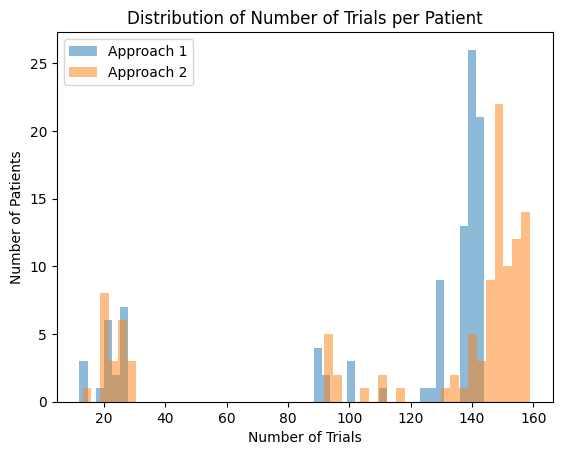

In [32]:
# group by patientId and count the number of trials
approach_1_results_grouped = approach_1_results_df.groupby('patientId').size()
approach_2_results_grouped = approach_2_results_df.groupby('patientId').size()

# approach_1_results_grouped, approach_2_results_grouped

import matplotlib.pyplot as plt

plt.hist(approach_1_results_grouped, bins=50, alpha=0.5, label='Approach 1')
plt.hist(approach_2_results_grouped, bins=50, alpha=0.5, label='Approach 2')
plt.xlabel('Number of Trials')
plt.ylabel('Number of Patients')
plt.title('Distribution of Number of Trials per Patient')
plt.legend()
plt.show()

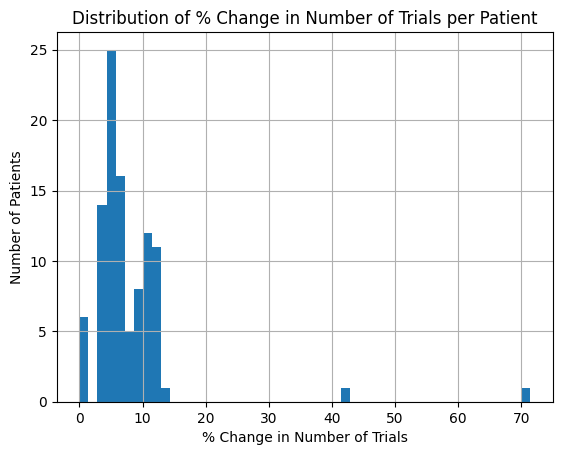

In [30]:
# i want to draw a histogram of the % change in the number of trials matched
# between approach 1 and approach 2
import matplotlib.pyplot as plt

# calculate the % change
approach_1_results_grouped = approach_1_results_grouped.reset_index()
approach_2_results_grouped = approach_2_results_grouped.reset_index()

approach_1_results_grouped.columns = ['patientId', 'approach_1']
approach_2_results_grouped.columns = ['patientId', 'approach_2']

approach_1_results_grouped['approach_2'] = approach_2_results_grouped['approach_2']

approach_1_results_grouped['% change'] = (approach_1_results_grouped['approach_2'] - approach_1_results_grouped['approach_1']) / approach_1_results_grouped['approach_1'] * 100

approach_1_results_grouped['% change'].hist(bins=50)
plt.xlabel('% Change in Number of Trials')
plt.ylabel('Number of Patients')

plt.title('Distribution of % Change in Number of Trials per Patient')

plt.show()

# Takeaways

Here are some areas for improvement and challenges faced - 
 1. Challenges
    - SciSpaCy NER model accuracy
    - Lack of a validation set
    - Criteria could be more consistently structured either through scraping the webpage directly or using LLMs to extract information into JSON.

Advantages Note: I used the large model from scispacy. I noticed the umls linker has a wider range of NER (keeping all other parameters unchanged) than the rxnorm which I believe targets drug identification rather explicitly. I could be wrong but I went with this assumption without testing (due to time constraints atm). The results were supportive of my choice.

 2. Areas for improvement
    - **RAG:** Scope to create a Q&A set based on this synthetic data, create a vector DB and show the model similar cases based on embeddings to enable a few shot approach as opposed to purely relying in prompt engineering.
    - **Fine-Tuning:** It would be interesting to fine-tune the SciSpaCy models to our free text dataset of (exclusion/inclusion criteria, patient conditions/medications, etc.). Once again, we could levarage our results from approach 2, use an LLM with more medical experience to enhance our accuracy (BioGPT, huggingface for eg). However, an ideally scenario would include human validation of results to reliable training outcomes. Personally, I believe the SciSpaCy models show a lot of hope. 
    - **Fine-Tune LLMs:** Our RAG Q&A validated set could be used to train the weights of an LLM. It would be crucial that our dataset covers various edgecases as fine-tuning is primarily used to guide the model in its decision making process and instruction following.

Overall, we should compare the cost vs. quality of RAG/Few-Shot prompting to Fine-Tuning before we take a decision of which path to settle.